# EDA Course Project
- Team ID: Team 6
- Sem: 4th
- Div: D
- Batch: D1
- Dept: Computer Science and Engineering
- Title ID: 4DEDA_CP_08
- Project Title: Relapsed patients data analysis
- Problem Statement: Exploratory data analysis on relapsed patients data using KDD Process
- Team Members:
- Michael Rohan Swaminathan 417 01FE20BCS201
- Utkarsh Khot 410 01FE20BCS194
- Naveen Ballari 406 01FE20BCS190
- Azeem Jalageri 407 01FE20BCS191

# Importing all the required libraries

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
from scipy.stats import skew
import pylab as p 
import matplotlib.cm as cm
%matplotlib inline
%pylab inline
import re
import warnings
warnings.filterwarnings('ignore')

Populating the interactive namespace from numpy and matplotlib


# Extracting the data from the excel sheets provided

In [1617]:
data = pd.read_excel('Relapse Patient Details.xlsx')
data2 = pd.read_excel('Relapse Patient Details.xlsx',header=[1,2])
data3 = pd.read_excel('Relapse Patient Details.xlsx',header=[0,1,2])

In [1618]:
data.shape # Identify the number of rows and columns present in the data

(205, 399)

In [1619]:
data.info #Brief overview of the data

<bound method DataFrame.info of     Unnamed: 0 Unnamed: 1 Unnamed: 2                 Unnamed: 3  \
0          NaN        NaN        NaN                        NaN   
1          S.N        Age        Sex                  Community   
2            1         48       Male                    Marathi   
3            2         31       Male                      Gowda   
4            3         34       Male                Vishwakarma   
5            4         35       Male                  Vokkaliga   
6            5         41       Male             Okkaliga gowda   
7            6         30       Male                    Valmiki   
8            7         45       Male                     Kunabi   
9            8         49       Male                  Lingayath   
10           9         50       Male                     Kuruba   
11          10         33       Male                        S.C   
12          11         46       Male                   Cristian   
13          12         38     

# Data slicing to include single level columns

In [1620]:
column_header1 = data.iloc[1:2,0:54].copy()
column_header1 = column_header1.values.tolist()
data_copy1 = data.iloc[2:,0:54].copy()
data_copy1.columns = column_header1
data_copy1.columns = data_copy1.columns.get_level_values(0)
data_copy1.index = range(len(data_copy1.index))
data_copy1.head()

,S.N,Age,Sex,Community,Education in year,Occupation,Annual Income,Marital Status,Living arrangement,Referral,Alcohol,AAO for alcohol in year,duration of use of alcohol,duration of excessive use of alcohol,avarage units used in last 30days,Last drink_Date,Assessment Date,quantity of last drink,Reason for starting alcohol,Reasons for continued use of alcohol,Nicotine (yes/NO),smoking/smokeless,Quantity/day,Last Use,Stressors,impression of Camp officer about the patient,Denial of substance use related problems,Motivation factor,Willingness for treatment,Action Taken,Weight while admission (In Kg),Weight while discharge (In Kg),Height(In Ft),Sugar(mg),Other Issues,Withdrawal symptoms experienced when the patient stopped,Medical Problem experienced(Past ),Medical Problem experienced(Present),Chronic health problem,Psychiatric complication_Past,Psychiatric complication_Present,"History of previous head injureies, if any",Knowledge of allergy to specific drugs(if known),"Family history of alcoholism / drug abuse, if any (who and which type of drug)",If any SpecV(Who and which type of drug,"Family history of psychiatric illness in family, if any specify (who)",Any untoward incident occurred during treatment(Yes/No):\nIf Yes Then Describe:,Action Taken,Past deaddiction treatments received/not,Name of the Hospital/ Deaddiction Center,year of Treated,Period of Treatment,Period of sober,Remarks
0,1,48,Male,Marathi,9th,Printer(in company),"15,000/-",Yes,Family,Family,Whisky,30year,17year,2month,360ml,2021-01-30 00:00:00,2021-01-02 00:00:00,180ml,Someone in family or friends were using,Work relared stress,Yes,Vimal,2pack,31.01.2021,Work related stress,Moderate,Moderate,Moderate,Willing,Admitted,48kg,52kg,5.5ft,Normal,Seizure,"Sweating, Tremors, Fits",Seizure,Seizure,Pancreatitis problem,Seizure during withdrawal,Seizure during withdrawal,No,No,No,No,No,No,Admitted,Received,"SDM Deaddiction center, K.S. Hegde Hospital",2018,8days,3months,-
1,2,31,Male,Gowda,9th,Coolie,"80,000/-",Yes,Family,Nava Jeevana Samithi Member,"OC, Whisky",16year,15year,3year,540ml,2021-01-01 00:00:00,2021-01-02 00:00:00,180ml,Someone in family or friends were using,"Liked the effect and wanted more of it, Friend...",Yes,Madu,1pack,2021-01-31 00:00:00,"Family or relationship issues, Financial stress",Moderate,Moderate,Moderate,Ambivalent,Admitted,47KG,50KG,5.3FT,Normal,Tremors,"Tremors, Insomnia",Jaundice,No,No,Confusion,Confusion,No,No,No,No,No,No,Admitted,Received,GHS Sullia,2020,4days,1.05months,Economical \nproblems
2,3,34,Male,Vishwakarma,Diploma,Video Editor,"60,000/-",No,Family,Family,Whisky,24year,10year,3year,540ml,2021-02-01 00:00:00,2021-01-02 00:00:00,180ml,Someone in family or friends were using,Love failure,Yes,Madu,1pack,2021-01-31 00:00:00,Family or relationship issues,Moderate,Moderate,Moderate,Willing,Admitted,45kg,47kg,5.6ft,Normal,No,"Tremors, Insomnia, Anxiety",Nerve related pains in extremities,Nerve related pains in extremities,No,No,No,No,No,No,No,No,No,Admitted,Received,Jagruthi soudha,2year before,8days,1.03year,Tension
3,4,35,Male,Vokkaliga,Diploma,Own-Buisness,"75,000/-",Yes,Family,Nava Jeevana Samithi Member,Admiral,27 year,8 year,2 year,270ml,30/1/2021,2021-01-02 00:00:00,360ml,Someone in family or friends were using,"Liked the effect and wanted more of it, Craving",No,-,-,-,"Family or relationship issues, Financial stress",Moderate,Moderate,Moderate,Willing,Admitted,75kg,75kg,5.9ft,Normal,No,"Tremors, Insomnia, Auuditory hallucinations",No,No,No,"Confusion, Depression, Aggressive outbursts, H...","Depression, Aggressive outbursts, Hallucinatio...",No,No,"Yes, alcoholism",Father & Brother,No,No,Admitted,Received,Spandana,2020,8 Days,1 Month,-
4,5,41,Male,Okkaliga gowda,10th,Farmer,"10,000/-",Yes,Family,Employer,MC Whisky,33year,1year,1year,360ml,2021-01-31 00:00:00,2021-01-02 00:00:00,270ml,"Someone in family or friends were using, To fe...",Vomiting at meal time,No,-,-,-,"Family or relationship issues, Financial Stress",Mild,Mild,Mild,Wi

In [1621]:
for key in data_copy1.loc[0].keys(): #Run through the columns in the data copy1 dataframe
    print(key)

S.N
Age
Sex
Community
Education in year
Occupation
Annual Income
Marital Status
Living arrangement
Referral
Alcohol
AAO for alcohol in year
duration of use of alcohol
duration of excessive use of alcohol
avarage units used in last 30days
Last drink_Date
Assessment Date
quantity of last drink
Reason for starting alcohol
Reasons for continued use of alcohol
Nicotine (yes/NO)
smoking/smokeless
Quantity/day
Last Use
Stressors
impression of Camp officer about the patient
Denial of substance use related problems
Motivation factor
Willingness for treatment
Action Taken
Weight while admission (In Kg)
Weight while discharge (In Kg)
Height(In Ft)
Sugar(mg)
Other Issues
Withdrawal symptoms experienced when the patient stopped
Medical Problem experienced(Past )
Medical Problem experienced(Present)
Chronic health problem
Psychiatric complication_Past
Psychiatric complication_Present
History of previous head injureies, if any
Knowledge of allergy to specific drugs(if known)
Family history of alcohol

In [1622]:
data_copy1.dtypes #Identification of Data types of the attributes

S.N                                                                                object
Age                                                                                object
Sex                                                                                object
Community                                                                          object
Education in year                                                                  object
Occupation                                                                         object
Annual Income                                                                      object
Marital Status                                                                     object
Living arrangement                                                                 object
Referral                                                                           object
Alcohol                                                                            object
AAO for al

In [1623]:
data_copy1.isna().sum()

S.N                                                                                0
Age                                                                                3
Sex                                                                                0
Community                                                                          0
Education in year                                                                  0
Occupation                                                                         0
Annual Income                                                                      0
Marital Status                                                                     0
Living arrangement                                                                 0
Referral                                                                           0
Alcohol                                                                            0
AAO for alcohol in year                                          

In [1624]:
len(data_copy1)

203

In [1625]:
percent_missing = (data_copy1.isnull().sum() * 100) / len(data_copy1)
missing_value_df = pd.DataFrame({'column_name': data_copy1.columns,
                                 'percent_missing': percent_missing})

In [1626]:
missing_value_df
#missing_value_df.to_excel("missing_1.xlsx")

,column_name,percent_missing
S.N,S.N,0.000000
Age,Age,1.477833
Sex,Sex,0.000000
Community,Community,0.000000
Education in year,Education in year,0.000000
Occupation,Occupation,0.000000
Annual Income,Annual Income,0.000000
Marital Status,Marital Status,0.000000
Living arrangement,Living arrangement,0.000000
Referral,Referral,0.000000


In [1627]:
data_copy1.columns.values[29] = "temp"
data_copy1 = data_copy1.drop("temp",axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Sex', 'Community', 'Education in year', 'Occupation',
       'Annual Income', 'Marital Status', 'Living arrangement', 'Referral',
       'Alcohol', 'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date', 'quantity of last drink',
       'Reason for starting alcohol', 'Reasons for continued use of alcohol',
       'Nicotine (yes/NO)', 'smoking/smokeless', 'Quantity/day', 'Last Use',
       'Stressors', 'impression of Camp officer about the patient',
       'Denial of substance use related problems', 'Motivation factor',
       'Willingness for treatment', 'Weight while admission (In Kg)',
       'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)',
       'Other Issues',
       'Withdrawal symptoms experienced when the patient stopped',
       'Medical Problem experienced(Past )',
       'Medical Problem experienced(Pres

In [1628]:
data_copy1['Age'].value_counts()
#data_copy1['Age'].isna().sum()

42    12
38    12
36    11
45    10
34     9
32     9
33     9
40     9
39     8
43     8
37     8
53     7
31     7
52     6
47     6
46     6
41     6
50     5
49     5
35     5
44     5
48     4
29     4
30     4
27     4
51     3
25     3
59     2
26     2
28     2
23     2
62     1
61     1
65     1
56     1
17     1
55     1
68     1
Name: Age, dtype: int64

In [1629]:
data_copy1.columns

Index(['S.N', 'Age', 'Sex', 'Community', 'Education in year', 'Occupation',
       'Annual Income', 'Marital Status', 'Living arrangement', 'Referral',
       'Alcohol', 'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date', 'quantity of last drink',
       'Reason for starting alcohol', 'Reasons for continued use of alcohol',
       'Nicotine (yes/NO)', 'smoking/smokeless', 'Quantity/day', 'Last Use',
       'Stressors', 'impression of Camp officer about the patient',
       'Denial of substance use related problems', 'Motivation factor',
       'Willingness for treatment', 'Weight while admission (In Kg)',
       'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)',
       'Other Issues',
       'Withdrawal symptoms experienced when the patient stopped',
       'Medical Problem experienced(Past )',
       'Medical Problem experienced(Pres

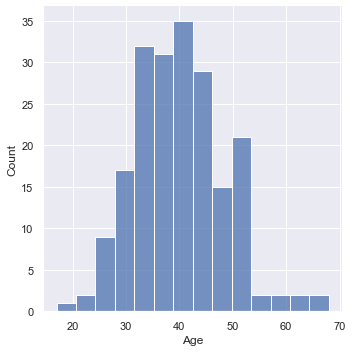

In [1630]:
sns.displot(data_copy1['Age'])

In [1631]:
data_copy1['Age'].skew()

0.36009047510141456

In [1632]:
data_copy1['Age'].kurtosis()

0.24407262545956465

In [1633]:
age_med = data_copy1['Age'].median()
age_med = 39
age_med

39

In [1634]:
data_copy1['Age'] = data_copy1['Age'].fillna(value = age_med)
data_copy1['Age'].isna().sum()

0

In [1635]:
data_copy1['Age'].value_counts()

42    12
38    12
39    11
36    11
45    10
34     9
32     9
33     9
40     9
43     8
37     8
53     7
31     7
52     6
47     6
46     6
41     6
50     5
49     5
35     5
44     5
48     4
29     4
30     4
27     4
51     3
25     3
59     2
26     2
28     2
23     2
62     1
61     1
65     1
56     1
17     1
55     1
68     1
Name: Age, dtype: int64

In [1636]:
data_copy1['Age'] = data_copy1['Age'].astype('int64')

In [1637]:
data_copy1['Age'].value_counts()

42    12
38    12
39    11
36    11
45    10
34     9
32     9
33     9
40     9
43     8
37     8
53     7
31     7
52     6
47     6
46     6
41     6
50     5
49     5
35     5
44     5
48     4
29     4
30     4
27     4
51     3
25     3
59     2
26     2
28     2
23     2
62     1
61     1
65     1
56     1
17     1
55     1
68     1
Name: Age, dtype: int64

In [1638]:
data_copy1['Sex'].value_counts()
data_copy1['Sex'].isna().sum()

0

In [1639]:
data_copy1 = data_copy1.drop(data_copy1.columns[2:4],axis = 1)

In [1640]:
data_copy1['Education in year'].value_counts()

S.S.L.C                   34
7th                       26
PUC                       23
SSLC                      12
10th                      11
8th                       10
B.Com                      9
5th                        9
9th                        8
4th                        7
P.U.C                      6
6th                        5
ITI                        5
10th                       4
B.A                        4
Nil                        3
Diploma                    3
B.E                        3
2nd                        2
Jain                       1
M.B.A                      1
PUC, ITI                   1
B A                        1
3rd                        1
BBM                        1
Diploma Civil Engineer     1
No                         1
L.L.B                      1
puc                        1
BE                         1
Graduvate                  1
B.COM                      1
B.Sc                       1
IIPUC                      1
Diploma Engine

In [1641]:
data_copy1['Education in year'] = data_copy1['Education in year'].replace(['puc','PUC','IIPUC'],'P.U.C')
data_copy1['Education in year'] = data_copy1['Education in year'].replace('-',np.nan)
data_copy1['Education in year'] = data_copy1['Education in year'].replace('SSLC','S.S.L.C')
data_copy1['Education in year'] = data_copy1['Education in year'].replace('B.COM','B.Com')
data_copy1['Education in year'] = data_copy1['Education in year'].replace('BE','B.E')
data_copy1['Education in year'] = data_copy1['Education in year'].replace('B A','B.A')
data_copy1['Education in year'] = data_copy1['Education in year'].replace('Nil','No')
data_copy1['Education in year'] = data_copy1['Education in year'].str.strip()
data_copy1['Education in year'].value_counts()

S.S.L.C                   46
P.U.C                     31
7th                       26
10th                      15
8th                       10
B.Com                     10
5th                        9
9th                        8
4th                        7
B.A                        5
ITI                        5
6th                        5
No                         4
B.E                        4
Diploma                    3
2nd                        2
Diploma Civil Engineer     1
Jain                       1
PUC, ITI                   1
3rd                        1
BBM                        1
Diploma Engineering        1
M.B.A                      1
Graduvate                  1
B.Sc                       1
L.L.B                      1
B.Sc Nursing               1
M.A                        1
Name: Education in year, dtype: int64

In [1642]:
edu_mod = data_copy1['Education in year'].mode()
data_copy1['Education in year'] = data_copy1['Education in year'].fillna(value = edu_mod[0])
data_copy1['Education in year'].value_counts()

S.S.L.C                   47
P.U.C                     31
7th                       26
10th                      15
8th                       10
B.Com                     10
5th                        9
9th                        8
4th                        7
B.A                        5
ITI                        5
6th                        5
No                         4
B.E                        4
Diploma                    3
2nd                        2
Diploma Civil Engineer     1
Jain                       1
PUC, ITI                   1
3rd                        1
BBM                        1
Diploma Engineering        1
M.B.A                      1
Graduvate                  1
B.Sc                       1
L.L.B                      1
B.Sc Nursing               1
M.A                        1
Name: Education in year, dtype: int64

In [1643]:
data_copy1['Education in year'].unique()

array(['9th', 'Diploma', '10th', 'P.U.C', 'S.S.L.C', 'B.E',
       'B.Sc Nursing', 'B.A', '7th', 'ITI', '5th', 'B.Com', '2nd', '6th',
       'Diploma Engineering', '4th', 'L.L.B', 'B.Sc', '8th', 'Graduvate',
       'M.B.A', 'No', 'BBM', '3rd', 'PUC, ITI', 'Jain',
       'Diploma Civil Engineer', 'M.A'], dtype=object)

In [1644]:
data_copy1['Education in year'].isna().sum()

0

In [1645]:
postgraduateStage =  ['M.A', 'M.B.A']

undergraduateStage =  ['B.Com',
'Diploma Civil Engineer',
'Graduvate',
'L.L.B',
'B.Sc Nursing',
 'B.A',
 'B.E',
 'B.Sc',
 'BBM',
 'Diploma Engineering']


SeniorSecondaryStage  = ['10th',
 'ITI',
 'P.U.C',
 'Diploma',
 'PUC, ITI']


SecondaryStage = ['9th',
 '8th',
 '10th',
 'S.S.L.C',
]



middleStage = ['6th', '7th','5th']

primaryStage = ['3rd', '4th', '2nd', '1st','No','Jain']



In [1646]:
data_copy1['Education Level'] = 0

for i in data_copy1.index:
    if data_copy1['Education in year'][i] in primaryStage:
        data_copy1['Education Level'][i] = 1
    elif data_copy1['Education in year'][i] in middleStage:
        data_copy1['Education Level'][i] = 2
    elif data_copy1['Education in year'][i] in SecondaryStage:
        data_copy1['Education Level'][i] = 3
    elif data_copy1['Education in year'][i] in SeniorSecondaryStage:
        data_copy1['Education Level'][i] = 4
    elif data_copy1['Education in year'][i] in undergraduateStage:
        data_copy1['Education Level'][i] = 5
    elif data_copy1['Education in year'][i] in postgraduateStage:
        data_copy1['Education Level'][i] = 6

In [1647]:
data_copy1['Education Level'].value_counts()

3    80
4    40
2    40
5    26
1    15
6     2
Name: Education Level, dtype: int64

In [1648]:
data_copy1 = data_copy1.drop('Education in year',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Occupation', 'Annual Income', 'Marital Status',
       'Living arrangement', 'Referral', 'Alcohol', 'AAO for alcohol in year',
       'duration of use of alcohol', 'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date', 'quantity of last drink',
       'Reason for starting alcohol', 'Reasons for continued use of alcohol',
       'Nicotine (yes/NO)', 'smoking/smokeless', 'Quantity/day', 'Last Use',
       'Stressors', 'impression of Camp officer about the patient',
       'Denial of substance use related problems', 'Motivation factor',
       'Willingness for treatment', 'Weight while admission (In Kg)',
       'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)',
       'Other Issues',
       'Withdrawal symptoms experienced when the patient stopped',
       'Medical Problem experienced(Past )',
       'Medical Problem experienced(Present)', 'Chronic health problem',
       'Psychia

In [1649]:
data_copy1['Occupation'] = data_copy1['Occupation'].replace(['Agricultuer','Agriculturist','Farmer','Agriculture\nBuisness'],'Agriculture')
data_copy1['Occupation'] = data_copy1['Occupation'].replace(['Cooly','cooli','Collie'],'Coolie')
data_copy1['Occupation'] = data_copy1['Occupation'].replace(['Own Buisness','Buisness','Bussines'],'Own-Buisness')
data_copy1['Occupation'] = data_copy1['Occupation'].replace('Engineering','Engineer')
data_copy1['Occupation'] = data_copy1['Occupation'].replace('Police Department','Police')
data_copy1['Occupation'] = data_copy1['Occupation'].replace('Cooking','Cook')
data_copy1['Occupation'] = data_copy1['Occupation'].replace('Cooking','Cook')
data_copy1['Occupation'] = data_copy1['Occupation'].replace('nill','No Work')
data_copy1['Occupation'] = data_copy1['Occupation'].str.strip()
data_copy1['Occupation'].value_counts()

Agriculture                    64
Coolie                         34
Own-Buisness                   14
Driver                         12
Auto Driver                     3
Mechanic                        3
No Work                         3
Carpenter                       3
Company                         3
Cook                            3
Police                          2
Auto Dirver                     2
Painting                        2
Painter                         2
Electrician                     2
Contractor                      2
Welding                         2
Engineer                        2
KEB                             2
Self Employee                   1
Tailoring                       1
Water Supply                    1
Automobile Service              1
Forester                        1
Printer(in company)             1
Boat                            1
Electician                      1
Private Compnay                 1
Mobile Technician               1
Forest Officer

In [1650]:
data_copy1['Occupation'].unique()

array(['Printer(in company)', 'Coolie', 'Video Editor', 'Own-Buisness',
       'Agriculture', 'Engineer', 'School Work', 'Hotel Manager', 'Shop',
       'Driver', 'Kola Seve', 'Company', 'Electrician',
       'Coolie , Plumber', 'Mechanic', 'Ex. Service man', 'IBM', 'Saloon',
       'Carpenter', 'DRFO', 'Painting', 'Gas Engineer', 'No Work',
       'Police', 'Auto Driver', 'S D A', 'Cook',
       'Pharmacetical Distributions', 'Business (poultry shop)',
       'Computer Operator', 'Business', 'KEB Line', 'Farmer', 'Bussines',
       'Contractor', 'Machine Operator', 'Own Hotel', 'Real Estate',
       'Employer', 'Mobile Technician', 'Vehicle Seizure', 'KEB',
       'Welding', 'Automobile Service', 'Water Supply', 'Self Employee',
       'Tailoring', 'Forester', 'Auto Dirver', 'Electician',
       'Private Compnay', 'Boat', 'Painter', 'Forest Officer', 'Medical',
       'Hair Dresser', 'Civil Contractor', 'Panchayath Secreatory',
       'Barber', 'Student', 'Govt Teacher', 'Hair Dresses

In [1651]:
data_copy1['Occupation'].isna().sum()

0

/anaconda/bin/python -m pip install wordcloud

from wordcloud import WordCloud
text = ' '.join(map(str,data_copy1['Occupation'].values))
wrd = WordCloud(width = 700,height = 480,margin =0,collocations=False)
wordcloud = wrd.generate(text)

plt.figure(figsize=(10,10))
plt.imshow(wordcloud,interpolation='bilinear')
plt.axis("off")
plt.margins(x=0, y=0)

In [1653]:
data_copy1 = data_copy1.drop('Occupation',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status', 'Living arrangement',
       'Referral', 'Alcohol', 'AAO for alcohol in year',
       'duration of use of alcohol', 'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date', 'quantity of last drink',
       'Reason for starting alcohol', 'Reasons for continued use of alcohol',
       'Nicotine (yes/NO)', 'smoking/smokeless', 'Quantity/day', 'Last Use',
       'Stressors', 'impression of Camp officer about the patient',
       'Denial of substance use related problems', 'Motivation factor',
       'Willingness for treatment', 'Weight while admission (In Kg)',
       'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)',
       'Other Issues',
       'Withdrawal symptoms experienced when the patient stopped',
       'Medical Problem experienced(Past )',
       'Medical Problem experienced(Present)', 'Chronic health problem',
       'Psychiatric complicat

In [1654]:
data_copy1['Annual Income'].value_counts()

50,000/-         24
20,000/-         17
1,00,000/-       15
10,000/-         13
15,000/-         12
30,000/-         12
2,00,000/-       10
25,000/-          7
50000             6
1,20,000/-        6
80,000/-          4
11,000/-          4
3,00,000/-        4
1,50,000/-        4
60,000/-          3
75,000/-          3
40,000/-          3
1,80,000/-        2
18000             2
25000             2
20000             2
2,50,000/-        2
10000             2
11000             2
100000            2
30000             2
-                 2
90,000/-          2
35,000/-          2
Not mentioned     2
4,00,000/-        1
6,000/-           1
1lakh             1
11000/-           1
2 lakh            1
1000000           1
15000             1
5,00,000/-        1
180000            1
1,10,000/-        1
Nil               1
12,000/-          1
1 LAKH            1
9,00,000/-        1
30,00,000/-       1
6,00,000          1
6,00,000/-        1
95,000/-          1
200000            1
35000             1


In [1655]:
data_copy1['Annual Income'] = data_copy1['Annual Income'].replace(['/-',','],'',regex = True)
data_copy1['Annual Income'] = data_copy1['Annual Income'].replace(['Not Mentioned','-','Nil','Not mentioned','nill'],np.nan,regex = True)
data_copy1['Annual Income'] = data_copy1['Annual Income'].replace('1.50 LAKH','150000',regex = True)
data_copy1['Annual Income'] = data_copy1['Annual Income'].replace([' Lakh','lakh','Laksha','LAKH'],'00000',regex = True)
data_copy1['Annual Income'] = data_copy1['Annual Income'].replace(' ','',regex = True)
data_copy1['Annual Income'] = data_copy1['Annual Income'].astype('float64')
data_copy1['Annual Income'].value_counts()

50000.0      30
100000.0     20
20000.0      19
10000.0      15
30000.0      14
15000.0      13
200000.0     12
25000.0       9
11000.0       7
120000.0      6
150000.0      5
300000.0      4
80000.0       4
60000.0       4
75000.0       3
35000.0       3
180000.0      3
40000.0       3
500000.0      3
250000.0      2
600000.0      2
90000.0       2
18000.0       2
6000.0        1
1000000.0     1
12000.0       1
400000.0      1
95000.0       1
900000.0      1
9000.0        1
270000.0      1
3000000.0     1
350000.0      1
110000.0      1
Name: Annual Income, dtype: int64

In [1656]:
data_copy1['Annual Income'].isna().sum()

7

In [1657]:
data_copy1['Annual Income'].skew()

8.73973029955775

In [1658]:
income_med = data_copy1['Annual Income'].median()
data_copy1['Annual Income'] = data_copy1['Annual Income'].fillna(value = income_med)
data_copy1['Annual Income'].value_counts()

50000.0      37
100000.0     20
20000.0      19
10000.0      15
30000.0      14
15000.0      13
200000.0     12
25000.0       9
11000.0       7
120000.0      6
150000.0      5
300000.0      4
80000.0       4
60000.0       4
75000.0       3
35000.0       3
180000.0      3
40000.0       3
500000.0      3
250000.0      2
600000.0      2
90000.0       2
18000.0       2
6000.0        1
1000000.0     1
12000.0       1
400000.0      1
95000.0       1
900000.0      1
9000.0        1
270000.0      1
3000000.0     1
350000.0      1
110000.0      1
Name: Annual Income, dtype: int64

In [1659]:
data_copy1['Annual Income'].isna().sum()

0

In [1660]:
data_copy1['Marital Status'] = data_copy1['Marital Status'].replace('no','No')
data_copy1['Marital Status'].value_counts()

Yes    162
No      41
Name: Marital Status, dtype: int64

In [1661]:
for i in data_copy1.index:
    if(data_copy1['Marital Status'][i] == 'Yes'):
        data_copy1['Marital Status'][i] = 1
    else:
        data_copy1['Marital Status'][i] = 0
data_copy1['Marital Status'].value_counts()

1    162
0     41
Name: Marital Status, dtype: int64

In [1662]:
data_copy1['Marital Status'].isna().sum()

0

In [1663]:
data_copy1['Living arrangement'] = data_copy1['Living arrangement'].replace('Famiy','Family')
data_copy1['Living arrangement'] = data_copy1['Living arrangement'].replace('SINGLE','Alone')
data_copy1['Living arrangement'].value_counts()

Family       186
Relatives     11
Friends        4
Alone          2
Name: Living arrangement, dtype: int64

In [1664]:
data_copy1['Living arrangement'].isna().sum()

0

In [1665]:
data_copy1 = data_copy1.drop('Living arrangement',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status', 'Referral', 'Alcohol',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date', 'quantity of last drink',
       'Reason for starting alcohol', 'Reasons for continued use of alcohol',
       'Nicotine (yes/NO)', 'smoking/smokeless', 'Quantity/day', 'Last Use',
       'Stressors', 'impression of Camp officer about the patient',
       'Denial of substance use related problems', 'Motivation factor',
       'Willingness for treatment', 'Weight while admission (In Kg)',
       'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)',
       'Other Issues',
       'Withdrawal symptoms experienced when the patient stopped',
       'Medical Problem experienced(Past )',
       'Medical Problem experienced(Present)', 'Chronic health problem',
       'Psychiatric complication_Past', 'Psychiatri

In [1666]:
data_copy1['Referral'] = data_copy1['Referral'].replace(['Nava Jeevan Samithi Member','Navajeevana samithi Member','Nava Jeevana Samithi member','Nava Jeevana Sanithi Member','Nava Jeevana samithi Member','Navajeevana Samithi Member'],'Nava Jeevana Samithi Member',regex = True)
data_copy1['Referral'] = data_copy1['Referral'].replace('Familky','Family',regex = True)
data_copy1['Referral'] = data_copy1['Referral'].replace(['Nirantara','Niranthara magazine'],'Niranthara',regex = True)
data_copy1['Referral'] = data_copy1['Referral'].replace(['/',' \n'],[', ',' '],regex = True)
data_copy1['Referral'].value_counts()

Nava Jeevana Samithi Member             91
Family                                  23
SKDRDP                                  13
Friends                                 12
Employer                                12
Niranthara                               6
Self                                     6
Internet                                 5
Doctors                                  3
Through awareness Programme              3
Niranthara magazine                      2
Wife                                     2
Brother                                  2
Media                                    2
Sevapatinidhi                            2
Family, Nava Jeevana Samithi Member      2
friends                                  1
News Paper                               1
Ayush TV                                 1
SKDRDp                                   1
Camp Officer                             1
Through awarness programme ,  Family     1
Nava Jeevana Samithi Member, SKDRDP      1
NILL       

In [1667]:
data_copy1 = data_copy1.drop('Referral',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status', 'Alcohol',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date', 'quantity of last drink',
       'Reason for starting alcohol', 'Reasons for continued use of alcohol',
       'Nicotine (yes/NO)', 'smoking/smokeless', 'Quantity/day', 'Last Use',
       'Stressors', 'impression of Camp officer about the patient',
       'Denial of substance use related problems', 'Motivation factor',
       'Willingness for treatment', 'Weight while admission (In Kg)',
       'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)',
       'Other Issues',
       'Withdrawal symptoms experienced when the patient stopped',
       'Medical Problem experienced(Past )',
       'Medical Problem experienced(Present)', 'Chronic health problem',
       'Psychiatric complication_Past', 'Psychiatric complicati

In [1668]:
data_copy1['Alcohol'] = data_copy1['Alcohol'].str.strip() 
data_copy1['Alcohol'] = data_copy1['Alcohol'].replace(['Orley','Prestige','DSP','8 P.M','Black Pepper','O.C, B.P','ML','MCB','M.L','DSP Black','\nWhisky','whisky','M.C\nO.C','OC, Whisky','BP Whiskey','MC/BP','B.P','M.C.B','O.C','O T','Wiskey','Whisky','MC Whisky','Wiskhy','O.T','B.P, O.T','M.C','OT'],'Whisky')
data_copy1['Alcohol'] = data_copy1['Alcohol'].replace(['Old monk','M.C Rum'],'Rum')
data_copy1['Alcohol'] = data_copy1['Alcohol'].replace(['M H','Admiral','M.H Brandy','M.H','Hywords','Hyward','Local Brandy'],'Brandy')
data_copy1['Alcohol'] = data_copy1['Alcohol'].replace('Chills','Beer')
data_copy1['Alcohol'].value_counts()

Whisky      107
Any          33
Brandy       19
Choice       14
Rum           9
Any type      6
Beer          5
All type      4
Vodka         2
All Type      2
Any one       2
Name: Alcohol, dtype: int64

from wordcloud import WordCloud
text = ' '.join(map(str,data_copy1['Alcohol'].values))
wrd = WordCloud(width = 700,height = 480,margin =0,collocations=False)
wordcloud = wrd.generate(text)

plt.figure(figsize=(10,10))
plt.imshow(wordcloud,interpolation='bilinear')
plt.axis("off")
plt.margins(x=0, y=0)

In [1686]:
data_copy1['Alcohol'].isna().sum()

0

In [1687]:
data_copy1['AAO for alcohol in year'] = [re.sub(r'[yYears\r]*','', str(x)) for x in data_copy1['AAO for alcohol in year']]
data_copy1['AAO for alcohol in year'] = data_copy1['AAO for alcohol in year'].astype('int64')
data_copy1['AAO for alcohol in year'].value_counts()

25    29
20    27
18    22
22    15
16    14
21    11
30    10
24    10
26     9
23     8
17     7
27     5
29     4
31     4
35     3
12     3
33     3
15     3
13     3
14     2
28     2
32     1
37     1
38     1
53     1
34     1
19     1
42     1
45     1
36     1
Name: AAO for alcohol in year, dtype: int64

In [1688]:
data_copy1['AAO for alcohol in year'].isna().sum()

0

In [1689]:
data_copy1['duration of use of alcohol'] = [re.sub(r'[yYears\r]*','', str(x)) for x in data_copy1['duration of use of alcohol']]
data_copy1['duration of use of alcohol'] = data_copy1['duration of use of alcohol'].str.strip()
data_copy1['duration of use of alcohol'] = data_copy1['duration of use of alcohol'].replace(['4 Month','4month'],0.4)
data_copy1['duration of use of alcohol'] = data_copy1['duration of use of alcohol'].replace('08month',0.8)
data_copy1['duration of use of alcohol'] = data_copy1['duration of use of alcohol'].replace('6 Month',0.6)
data_copy1['duration of use of alcohol'] = data_copy1['duration of use of alcohol'].astype('float64')
data_copy1['duration of use of alcohol'].value_counts()

20.0    20
12.0    16
10.0    15
15.0    13
6.0      9
8.0      8
17.0     8
22.0     7
9.0      7
23.0     7
5.0      6
25.0     6
24.0     6
18.0     6
14.0     6
19.0     6
26.0     5
16.0     5
7.0      4
31.0     4
29.0     4
11.0     3
30.0     3
2.0      3
1.0      3
21.0     2
36.0     2
32.0     2
4.0      2
13.0     2
33.0     2
28.0     2
0.4      2
27.0     2
35.0     1
0.8      1
48.0     1
0.6      1
37.0     1
Name: duration of use of alcohol, dtype: int64

In [1690]:
data_copy1['duration of use of alcohol'].unique()

array([17. , 15. , 10. ,  8. ,  1. ,  5. , 25. , 27. , 20. ,  9. , 23. ,
       18. , 12. ,  6. ,  7. , 19. , 29. , 24. , 21. , 16. , 14. , 11. ,
       30. , 26. , 31. ,  0.4, 28. , 22. , 33. , 35. , 36. , 13. ,  4. ,
        2. , 32. ,  0.8, 48. ,  0.6, 37. ])

In [1691]:
data_copy1['duration of use of alcohol'].isna().sum()

0

In [1692]:
def extract_duration(string):
    try:
        if type(string) == int or type(string) == float :
            return string
        else:
            temp = [i for i in string if i.isdigit()]
            num = ''.join(temp)
            num = float(num)
            if ('months'.casefold() in string) or ('month'.casefold() in string):
                return num/12
            elif ('year'.casefold() in string) or ('years'.casefold() in string) or ('yeaer'.casefold() in string):
                return num
            elif ('days'.casefold() in string) or ('day'.casefold() in string):
                return num/365
            else:
                return num
    except:
        pass
for i in range(len(data_copy1)):
    data_copy1['duration of excessive use of alcohol'][i] = extract_duration(data_copy1['duration of excessive use of alcohol'][i])

In [1693]:
data_copy1['duration of excessive use of alcohol'].value_counts()

2.000000     42
1.000000     42
3.000000     20
10.000000    20
4.000000     16
6.000000     13
5.000000     12
15.000000     5
8.000000      4
16.000000     4
0.333333      3
0.166667      2
18.000000     2
12.000000     2
13.000000     1
7.000000      1
0.008219      1
0.083333      1
0.041096      1
9.000000      1
14.000000     1
0.666667      1
25.000000     1
19.000000     1
0.500000      1
Name: duration of excessive use of alcohol, dtype: int64

In [1694]:
data_copy1['duration of excessive use of alcohol'].unique()

array([0.16666666666666666, 3.0, 2.0, 1.0, 5.0, 6.0, None, 10.0, 18.0,
       4.0, 7.0, 15.0, 13.0, 8.0, 0.3333333333333333, 0.00821917808219178,
       0.08333333333333333, 0.0410958904109589, 9.0, 16.0, 14.0,
       0.6666666666666666, 25.0, 19.0, 0.5, 12.0], dtype=object)

In [1695]:
data_copy1['duration of excessive use of alcohol'].isna().sum()

5

In [1696]:
data_copy1['duration of excessive use of alcohol'].skew()

1.6422225695060535

In [1697]:
alc_med = data_copy1['duration of excessive use of alcohol'].median()
data_copy1['duration of excessive use of alcohol'] = data_copy1['duration of excessive use of alcohol'].fillna(alc_med)

In [1698]:
data_copy1['duration of excessive use of alcohol'].value_counts()

2.000000     42
1.000000     42
3.000000     25
10.000000    20
4.000000     16
6.000000     13
5.000000     12
15.000000     5
8.000000      4
16.000000     4
0.333333      3
0.166667      2
18.000000     2
12.000000     2
13.000000     1
7.000000      1
0.008219      1
0.083333      1
0.041096      1
9.000000      1
14.000000     1
0.666667      1
25.000000     1
19.000000     1
0.500000      1
Name: duration of excessive use of alcohol, dtype: int64

In [1699]:
data_copy1['duration of excessive use of alcohol'].isna().sum()

0

In [1700]:
data_copy1['avarage units used in last 30days'] = data_copy1['avarage units used in last 30days'].replace('ml','',regex = True)
data_copy1['avarage units used in last 30days'] = data_copy1['avarage units used in last 30days'].astype('int64')
data_copy1['avarage units used in last 30days'].value_counts()

360     54
540     51
720     44
270      9
180      7
900      7
1080     6
450      5
1260     3
630      3
90       2
240      2
1800     1
225      1
750      1
790      1
3600     1
1440     1
1040     1
2100     1
2600     1
300      1
Name: avarage units used in last 30days, dtype: int64

In [1701]:
density = 0.789
for ind,row in data_copy1.iterrows():
    if data_copy1['Alcohol'][ind]=='Vodka':
        data_copy1.loc[ind,"abv_risk"] = (0.675 * row['avarage units used in last 30days'] * density)
    elif data_copy1['Alcohol'][ind] == 'Rum':
        data_copy1.loc[ind,"abv_risk"] = (0.43 * row['avarage units used in last 30days'] * density)
    elif data_copy1['Alcohol'][ind]=='Whisky':
        data_copy1.loc[ind,"abv_risk"] = (0.43 * row['avarage units used in last 30days'] * density)
    elif data_copy1['Alcohol'][ind]=='Brandy':
        data_copy1.loc[ind,"abv_risk"] = (0.475 * row['avarage units used in last 30days'] * density)
    elif data_copy1['Alcohol'][ind]=='Beer':
        data_copy1.loc[ind,"abv_risk"] = (0.06 * row['avarage units used in last 30days'] * density)
    else:
        data_copy1.loc[ind,"abv_risk"] = (0.355 * row['avarage units used in last 30days'] * density)

In [1702]:
data_copy1['abv_risk'].value_counts()

122.13720    29
244.27440    29
183.20580    29
100.83420    18
151.25130    16
201.66840    10
134.91900     6
91.60290      6
202.37850     5
305.34300     4
50.41710      3
61.06860      3
252.08550     3
269.83800     3
366.41160     3
152.67150     3
30.53430      2
75.62565      2
352.91970     2
176.45985     2
302.50260     2
610.68600     1
268.02330     1
210.07125     1
383.45400     1
67.45950      1
81.42480      1
10.65150      1
89.94600      1
488.54880     1
352.84080     1
427.48020     1
404.75700     1
126.04275     1
34.08480      1
170.42400     1
712.46700     1
123.08400     1
168.64875     1
213.74010     1
287.59050     1
17.04240      1
101.18925     1
84.02850      1
Name: abv_risk, dtype: int64

In [1703]:
for ind,row in data_copy1.iterrows():
    if data_copy1['abv_risk'][ind]<1:
        data_copy1.loc[ind,"Risk Level"] = "None"
    elif data_copy1['abv_risk'][ind]>=1 and data_copy1['abv_risk'][ind]<=40:
        data_copy1.loc[ind,"Risk Level"] = "Low Risk"
    elif data_copy1['abv_risk'][ind]>40 and data_copy1['abv_risk'][ind]<=60:
        data_copy1.loc[ind,"Risk Level"] = "Medium Risk"
    elif data_copy1['abv_risk'][ind]>60 and data_copy1['abv_risk'][ind]<=100:
        data_copy1.loc[ind,"Risk Level"] = "High Risk"
    elif data_copy1['abv_risk'][ind]>100:
        data_copy1.loc[ind,"Risk Level"] = "Very High Risk"

In [1704]:
data_copy1['Risk Level'].value_counts()

Very High Risk    180
High Risk          15
Low Risk            5
Medium Risk         3
Name: Risk Level, dtype: int64

In [1705]:
for i in data_copy1.index:
    if data_copy1['Risk Level'][i] == 'Low Risk':
        data_copy1['Risk Level'][i] = 1
    elif data_copy1['Risk Level'][i] == 'Medium Risk':
        data_copy1['Risk Level'][i] = 2
    elif data_copy1['Risk Level'][i] == 'High Risk':
        data_copy1['Risk Level'][i] = 3
    else:
        data_copy1['Risk Level'][i] = 4
data_copy1['Risk Level'].value_counts()

4    180
3     15
1      5
2      3
Name: Risk Level, dtype: int64

In [1706]:
data_copy1 = data_copy1.drop('Alcohol',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date', 'quantity of last drink',
       'Reason for starting alcohol', 'Reasons for continued use of alcohol',
       'Nicotine (yes/NO)', 'smoking/smokeless', 'Quantity/day', 'Last Use',
       'Stressors', 'impression of Camp officer about the patient',
       'Denial of substance use related problems', 'Motivation factor',
       'Willingness for treatment', 'Weight while admission (In Kg)',
       'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)',
       'Other Issues',
       'Withdrawal symptoms experienced when the patient stopped',
       'Medical Problem experienced(Past )',
       'Medical Problem experienced(Present)', 'Chronic health problem',
       'Psychiatric complication_Past', 'Psychiatric complication_Present'

In [1707]:
data_copy1['Last drink_Date'] = data_copy1['Last drink_Date'].apply(lambda x: pd.to_datetime(x, errors = 'coerce'))
data_copy1['Last drink_Date'].value_counts()

2021-07-11    26
2021-10-17    19
2021-03-14    16
2021-05-12    15
2021-02-14    14
2021-02-28    13
2021-01-31    10
2022-02-07     9
2021-11-21     9
2021-10-10     8
2021-02-13     6
2021-11-22     6
2021-12-19     5
2021-01-30     5
2021-02-15     4
2021-03-15     3
2021-04-19     3
2021-04-04     2
2021-04-18     2
2021-12-18     2
2021-11-18     2
2021-01-02     2
2021-08-11     2
2021-05-04     2
2021-04-17     1
2021-01-01     1
2021-12-20     1
2021-12-17     1
2021-12-12     1
2021-02-01     1
2021-01-29     1
2021-02-04     1
2021-01-21     1
2021-06-02     1
2021-06-11     1
2021-04-11     1
2021-04-05     1
2021-02-27     1
2021-12-02     1
2021-09-27     1
2021-03-10     1
2021-01-03     1
Name: Last drink_Date, dtype: int64

In [1708]:
data_copy1['Last drink_Date'].dtypes

dtype('<M8[ns]')

In [1709]:
data_copy1['Last drink_Date'].isna().sum()

0

In [1710]:
data_copy1['Assessment Date'] = data_copy1['Assessment Date'].apply(lambda x: pd.to_datetime(x, errors = 'coerce'))
data_copy1['Assessment Date'].value_counts()

2021-08-11    30
2021-02-15    28
2021-03-15    20
2021-01-02    19
2021-10-18    19
2021-06-12    15
2021-01-03    14
2021-11-22    12
2021-11-10    10
2021-12-20    10
2022-02-15     9
2021-04-19     6
2021-05-04     5
2022-11-22     3
2021-04-05     1
2023-11-22     1
Name: Assessment Date, dtype: int64

In [1711]:
data_copy1.iloc[165,9] = data_copy1['Assessment Date'].mode()

In [1712]:
data_copy1['Assessment Date'][165]

Timestamp('2021-08-11 00:00:00')

In [1713]:
data_copy1['Assessment Date'].isna().sum()

0

In [1714]:
data_copy1['Assessment Date'].value_counts()

2021-08-11    31
2021-02-15    28
2021-03-15    20
2021-01-02    19
2021-10-18    19
2021-06-12    15
2021-01-03    14
2021-11-22    12
2021-11-10    10
2021-12-20    10
2022-02-15     9
2021-04-19     6
2021-05-04     5
2022-11-22     3
2021-04-05     1
2023-11-22     1
Name: Assessment Date, dtype: int64

In [1715]:
data_copy1['quantity of last drink'] = data_copy1['quantity of last drink'].replace('ml','',regex = True)
data_copy1['quantity of last drink'] = data_copy1['quantity of last drink'].astype('int64')
data_copy1['quantity of last drink'].value_counts()

180     66
360     48
270     19
540     19
90      19
720      9
450      7
630      2
750      2
900      2
330      1
300      1
1260     1
1500     1
350      1
1440     1
1080     1
600      1
560      1
260      1
Name: quantity of last drink, dtype: int64

In [1716]:
data_copy1['quantity of last drink'].isna().sum()

0

In [1717]:
data_copy1['Reason for starting alcohol'] = data_copy1['Reason for starting alcohol'].replace(['Some one','some one','someone'],'Someone',regex = True)
data_copy1['Reason for starting alcohol'] = data_copy1['Reason for starting alcohol'].replace('  ',' ',regex = True)
data_copy1['Reason for starting alcohol'] = data_copy1['Reason for starting alcohol'].replace(['Toavoid problems and sadness','To avoid Problems and sadness','To avoid problems & Sadness'],'To avoid problems and sadness',regex = True)
data_copy1['Reason for starting alcohol'] = data_copy1['Reason for starting alcohol'].replace(['Someone in family and friends were using','Someone in friends were using'],'Someone in family or friends were using',regex = True)
data_copy1['Reason for starting alcohol'] = data_copy1['Reason for starting alcohol'].replace('Friends','friends',regex = True)
data_copy1['Reason for starting alcohol'] = data_copy1['Reason for starting alcohol'].replace('to','To',regex = True)
data_copy1['Reason for starting alcohol'] = data_copy1['Reason for starting alcohol'].replace('Better','better',regex = True)
data_copy1['Reason for starting alcohol'] = data_copy1['Reason for starting alcohol'].replace('prblem','problems',regex = True)
data_copy1['Reason for starting alcohol'] = data_copy1['Reason for starting alcohol'].replace('Mainded','Minded',regex = True)
data_copy1['Reason for starting alcohol'] = data_copy1['Reason for starting alcohol'].replace('sadess','sadness',regex = True)
data_copy1['Reason for starting alcohol'] = data_copy1['Reason for starting alcohol'].str.strip()
data_copy1['Reason for starting alcohol'].value_counts()

Someone in family or friends were using                                                                          124
Someone in family or friends were using, To feel better and confident or happy                                    16
friends were using                                                                                                13
To feel better and confident or happy                                                                             12
To avoid problems and sadness                                                                                     11
To feel better and confident or happy, To avoid problems and sadness                                               4
Someone in family or friends were using, To avoid problems and sadness                                             4
friends were using, To feel better and confident or happy                                                          1
Weak Minded & Weak personality                                  

In [1718]:
data_copy1['Reason for starting alcohol'].unique()

array(['Someone in family or friends were using',
       'Someone in family or friends were using, To feel better and confident or happy',
       'To avoid problems and sadness',
       'To feel better and confident or happy, To avoid problems and sadness',
       'Someone in family or friends were using , To feel better and confident or happy',
       'Someone in family or friends were using , To avoid problems and sadness',
       'To feel better and confident or happy',
       'Heavy Cold in his working place', 'Other reasons',
       'Someone in family or friends were using,',
       'Someone in family or friends were using,To feel better and confident or happy',
       'Someone in family or friends were using, To feel better and confident or happy, To avoid problems and sadness',
       'To Try, Someone in family or friends were using',
       'Other reason-Accident', 'friends were using', 'happiness',
       'friends were using, To feel better and confident or happy',
       'Som

In [1719]:
data_copy1['Reason for starting alcohol'] = data_copy1['Reason for starting alcohol'].fillna(value= 'Someone in family or friends were using')
unique_reasons_to_start = []
reasons_to_start = []
reasons_to_start_stripped = []
for i in data_copy1.index:
    s = data_copy1['Reason for starting alcohol'].iloc[i]
    reasons_to_start = s.split(sep=',')
    for reason in reasons_to_start:
        reasons_to_start_stripped.append(reason.strip())
    for reason in reasons_to_start_stripped :
        if reason.casefold() not in unique_reasons_to_start :
            unique_reasons_to_start.append(reason.casefold())

print(len(unique_reasons_to_start))
print(unique_reasons_to_start)

17
['someone in family or friends were using', 'to feel better and confident or happy', 'to avoid problems and sadness', 'heavy cold in his working place', 'other reasons', '', 'to try', 'other reason-accident', 'friends were using', 'happiness', 'friendship issues', 'to avoid problem and sadness', 'work related stress', 'other', 'wife problem', 'function', 'weak minded & weak personality']


In [1720]:
def add_reason(reason,i):
    if reason in data_copy1['Reason for starting alcohol'].iloc[i].casefold():
        return 1
    else:
        return 0

for reason in unique_reasons_to_start:
    data_copy1['RSA_' + reason] = 0
    for i in data_copy1.index:
        if add_reason(reason.casefold(),i):
            data_copy1['RSA_'+ reason].iloc[i] = 1
        else:
            data_copy1['RSA_'+ reason].iloc[i] = 0


In [1721]:
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date', 'quantity of last drink',
       'Reason for starting alcohol', 'Reasons for continued use of alcohol',
       'Nicotine (yes/NO)', 'smoking/smokeless', 'Quantity/day', 'Last Use',
       'Stressors', 'impression of Camp officer about the patient',
       'Denial of substance use related problems', 'Motivation factor',
       'Willingness for treatment', 'Weight while admission (In Kg)',
       'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)',
       'Other Issues',
       'Withdrawal symptoms experienced when the patient stopped',
       'Medical Problem experienced(Past )',
       'Medical Problem experienced(Present)', 'Chronic health problem',
       'Psychiatric complication_Past', 'Psychiatric complication_Present'

In [1722]:
data_copy1['RSA_'].value_counts()

1    203
Name: RSA_, dtype: int64

In [1723]:
data_copy1 = data_copy1.drop('RSA_',axis = 1)
data_copy1['RSA_to avoid problems and sadness'] = data_copy1['RSA_to avoid problems and sadness'] + data_copy1['RSA_to avoid problem and sadness']
data_copy1 = data_copy1.drop('RSA_to avoid problem and sadness',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date', 'quantity of last drink',
       'Reason for starting alcohol', 'Reasons for continued use of alcohol',
       'Nicotine (yes/NO)', 'smoking/smokeless', 'Quantity/day', 'Last Use',
       'Stressors', 'impression of Camp officer about the patient',
       'Denial of substance use related problems', 'Motivation factor',
       'Willingness for treatment', 'Weight while admission (In Kg)',
       'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)',
       'Other Issues',
       'Withdrawal symptoms experienced when the patient stopped',
       'Medical Problem experienced(Past )',
       'Medical Problem experienced(Present)', 'Chronic health problem',
       'Psychiatric complication_Past', 'Psychiatric complication_Present'

In [1724]:
data_copy1 = data_copy1.drop('Reason for starting alcohol',axis = 1)

In [1725]:
 data_copy1['RSA_someone in family or friends were using'].value_counts()

1    152
0     51
Name: RSA_someone in family or friends were using, dtype: int64

In [1726]:
data_copy1['Reasons for continued use of alcohol'].value_counts()

Liked the effect and wanted more of it                                                                                 50
Liked the effect and wanted more of it, Craving                                                                        23
Liked the effect and wanted more of it, Friends forced                                                                 13
Craving                                                                                                                12
Friends forced                                                                                                         11
Liked the effect and wanted more of it, Gave Confidence                                                                 6
Liked the effect and wanted more of it, Felt relaxed and reduced physical exertion                                      5
Friends forced, Craving                                                                                                 5
Liked the effect and wan

In [1727]:
data_copy1['Reasons for continued use of alcohol'].unique()

array(['Work relared stress',
       'Liked the effect and wanted more of it, Friends forced',
       'Love failure', 'Liked the effect and wanted more of it, Craving',
       'Vomiting at meal time ',
       'Craving, Felt relaxed and reduced physical exertion',
       'Liked the effect and wanted more of it',
       'Liked the effect and wanted more of it, Gave Confidence',
       'Liked the effect and wanted more of it, Love Failure',
       'Liked the effect and wanted more of it, Gave Confidence, Craving',
       'Liked the effcet and wanted more of it',
       'Liked the effcet and wanted more of it, Gave Confidence',
       'Friends forced', 'LIked the effect and wanted more of it',
       'Liked he teffect and wanted more of it, Gave Confidence',
       'Craving', 'Friends forced, Craving',
       'Liked the effect and wanted more of it, Friends forced, Gave Confidence',
       'Gave Confidence', 'Gave confidence',
       'Liked the effect and wanted more of it,Friends forced/G

In [1728]:
data_copy1['Reasons for continued use of alcohol'].isna().sum()

0

In [1729]:
unique_reasons_to_continue = []
reasons_to_continue = []
reasons_to_continue_stripped = []
for i in data_copy1.index:
    s = data_copy1['Reasons for continued use of alcohol'].iloc[i]
    reasons_to_continue = s.split(sep=',')
    for reason in reasons_to_continue:
        reasons_to_continue_stripped.append(reason.strip())
    for reason in reasons_to_continue_stripped :
        if reason.casefold() not in unique_reasons_to_continue :
            unique_reasons_to_continue.append(reason.casefold())

print(len(unique_reasons_to_continue))
print(unique_reasons_to_continue)

29
['work relared stress', 'liked the effect and wanted more of it', 'friends forced', 'love failure', 'craving', 'vomiting at meal time', 'felt relaxed and reduced physical exertion', 'gave confidence', 'liked the effcet and wanted more of it', 'liked he teffect and wanted more of it', 'friends forced/gave confidence', '', 'liked the effect and wanted more of it/craving', 'felt relaxed and reduced pysical exertion', 'unrest in the family', 'liked the effect  and wanted more of it', 'sleeping problem', 'friends force/craving', 'friends force', 'felt relaxed and reduced physica exertion', 'family issues', 'mothers death', 'friends forced craving', 'felt relaxed and reduced', 'work related', 'friens forced', 'caraving', 'tenssion', 'felt relaxed due to physical exertion']


In [1730]:
data_copy1 = data_copy1.drop('Reasons for continued use of alcohol',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date', 'quantity of last drink', 'Nicotine (yes/NO)',
       'smoking/smokeless', 'Quantity/day', 'Last Use', 'Stressors',
       'impression of Camp officer about the patient',
       'Denial of substance use related problems', 'Motivation factor',
       'Willingness for treatment', 'Weight while admission (In Kg)',
       'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)',
       'Other Issues',
       'Withdrawal symptoms experienced when the patient stopped',
       'Medical Problem experienced(Past )',
       'Medical Problem experienced(Present)', 'Chronic health problem',
       'Psychiatric complication_Past', 'Psychiatric complication_Present',
       'History of previous head injureies, if any',
       'Knowledge of al

In [1731]:
data_copy1['Nicotine (yes/NO)'] = data_copy1['Nicotine (yes/NO)'].str.strip()
data_copy1['Nicotine (yes/NO)'] = data_copy1['Nicotine (yes/NO)'].replace('/','',regex = True)
data_copy1['Nicotine (yes/NO)'] = data_copy1['Nicotine (yes/NO)'].replace('no','No')
data_copy1['Nicotine (yes/NO)'] = data_copy1['Nicotine (yes/NO)'].replace(['YesMadhu','yes'],'Yes')
data_copy1['Nicotine (yes/NO)'] = data_copy1['Nicotine (yes/NO)'].replace('-','Yes')
data_copy1['Nicotine (yes/NO)'].value_counts()

Yes    125
No      78
Name: Nicotine (yes/NO), dtype: int64

In [1732]:
for i in data_copy1.index:
    if data_copy1['Nicotine (yes/NO)'][i] == 'Yes':
        data_copy1['Nicotine (yes/NO)'][i] = 1
    else:
        data_copy1['Nicotine (yes/NO)'][i] = 0
data_copy1['Nicotine (yes/NO)'].value_counts()

1    125
0     78
Name: Nicotine (yes/NO), dtype: int64

In [1733]:
data_copy1['Nicotine (yes/NO)'].isna().sum()

0

In [1734]:
data_copy1['smoking/smokeless'] = data_copy1['smoking/smokeless'].str.strip()
data_copy1['smoking/smokeless']  = data_copy1['smoking/smokeless'].replace('-',np.nan)
data_copy1['smoking/smokeless']  = data_copy1['smoking/smokeless'].replace(['/','\n'],',',regex = True)
data_copy1['smoking/smokeless']  = data_copy1['smoking/smokeless'].replace(['cigarate','cigratte','Cigarate','Cigerate','King Cigarate','King Cigarette','Cigaratte','Cigratte'],'Cigarette' , regex = True)
data_copy1['smoking/smokeless']  = data_copy1['smoking/smokeless'].replace('Madu','Madhu')
data_copy1['smoking/smokeless']  = data_copy1['smoking/smokeless'].replace(['Leaf nut tobacco','Tambacco'],'Tobacco',regex = True)
data_copy1['smoking/smokeless'].value_counts()

No                  67
Cigarette           30
Beedi               27
Gutka               14
Vimal                7
Beedi,Cigarette      5
Madhu                5
Beedi, Cigarette     2
Tambaku              2
Tobacco              2
Tobaco,pan           1
Gutka, all           1
King Cigarette       1
Siddu                1
Madhu ,Tobaco        1
Cigarette ,Beedi     1
Madhu all            1
beedi,vimal          1
Beedi,tobacco        1
vimal,maruthi        1
tobacoo,beedi        1
gutka                1
R.M.D                1
Cigarette,Gutka      1
Cigarette,Vimal      1
Chewing              1
Cigarette,Beedi      1
Name: smoking/smokeless, dtype: int64

In [1735]:
for i in data_copy1.index:
    if data_copy1['smoking/smokeless'][i] == 'No':
        data_copy1['smoking/smokeless'][i] = 0
    else:
        data_copy1['smoking/smokeless'][i] = 1
data_copy1['smoking/smokeless'].value_counts()

1    136
0     67
Name: smoking/smokeless, dtype: int64

In [1736]:
data_copy1['Quantity/day'].value_counts()

-                       92
1 Pack                  22
2 Pack                  10
1 packet                 4
1pack/day                3
10 Pack                  3
4 Piece                  3
2 pack                   3
6 Pack                   3
5 Piece                  3
2pack/day                3
10 Piece                 2
25 Piece                 2
3 Piece                  2
2packet                  2
3 Pack                   2
10pack                   2
Half Pack                2
1 Piece                  1
3 Piece\n8 Piece         1
2pack                    1
1 Pack\n10 Piece         1
15 Piece                 1
3-4 Piece                1
25 Piece\n1 Piece        1
30packet                 1
5-6 Piece                1
3packet                  1
10pic                    1
2pic                     1
3pic                     1
6paket                   1
1 Pack\n1 Pack           1
2 Piece                  1
6 Piece                  1
full day                 1
16 piece/1 pack          1
8

In [1737]:
data_copy1 = data_copy1.drop('Quantity/day',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date', 'quantity of last drink', 'Nicotine (yes/NO)',
       'smoking/smokeless', 'Last Use', 'Stressors',
       'impression of Camp officer about the patient',
       'Denial of substance use related problems', 'Motivation factor',
       'Willingness for treatment', 'Weight while admission (In Kg)',
       'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)',
       'Other Issues',
       'Withdrawal symptoms experienced when the patient stopped',
       'Medical Problem experienced(Past )',
       'Medical Problem experienced(Present)', 'Chronic health problem',
       'Psychiatric complication_Past', 'Psychiatric complication_Present',
       'History of previous head injureies, if any',
       'Knowledge of allergy to specifi

In [1738]:
data_copy1['Last Use']  = data_copy1['Last Use'].replace('-',np.nan)
data_copy1['Last Use'] = data_copy1['Last Use'].apply(lambda x: pd.to_datetime(x, errors = 'coerce'))
data_copy1['Last Use'].value_counts()

2021-02-14    19
2021-03-14    14
2021-02-28    11
2021-11-21     9
2021-08-11     8
2021-10-17     8
2021-01-31     7
2021-07-12     4
2021-05-04     3
2021-04-19     3
2021-05-12     3
2021-03-15     2
2021-08-12     2
2021-12-19     2
2021-12-05     2
2021-11-22     2
2021-07-11     2
2021-02-15     1
2021-04-04     1
2021-02-22     1
2021-02-13     1
2021-01-30     1
2021-01-03     1
2021-05-05     1
2021-12-20     1
2022-02-07     1
2022-02-08     1
2022-07-02     1
Name: Last Use, dtype: int64

In [1739]:
lastuse_mod = data_copy1['Last Use'].mode()
data_copy1['Last Use'] = data_copy1['Last Use'].fillna(value = lastuse_mod[0])
data_copy1['Last Use'].value_counts()

2021-02-14    110
2021-03-14     14
2021-02-28     11
2021-11-21      9
2021-08-11      8
2021-10-17      8
2021-01-31      7
2021-07-12      4
2021-05-04      3
2021-04-19      3
2021-05-12      3
2021-03-15      2
2021-08-12      2
2021-12-19      2
2021-12-05      2
2021-11-22      2
2021-07-11      2
2021-02-13      1
2021-04-04      1
2021-02-22      1
2021-01-30      1
2021-02-15      1
2021-01-03      1
2021-05-05      1
2021-12-20      1
2022-02-07      1
2022-02-08      1
2022-07-02      1
Name: Last Use, dtype: int64

In [1740]:
data_copy1['Last Use'].isna().sum()

0

In [1741]:
mod = data_copy1['Stressors'].mode()
data_copy1['Stressors'] = data_copy1['Stressors'].str.strip()
data_copy1['Stressors'] = data_copy1['Stressors'].replace(['(Wife death)'],'',regex = True)
data_copy1['Stressors'] = [re.sub(r'[()]', '', str(x))for x in data_copy1['Stressors'] ] 
data_copy1['Stressors'] = data_copy1['Stressors'].replace(['Other reason','Mother Health issues','Family Problem','Family or relationship ssues','Prasent/Family or relationship','Family isues','Family or  relationship issues','Family or relatinship issues'],'Family or relationship issues',regex = True)
data_copy1['Stressors'] = data_copy1['Stressors'].replace(['Financian stress'],'Financial stress',regex = True)
data_copy1['Stressors'] = data_copy1['Stressors'].replace(['Prasent'],'Present')
data_copy1['Stressors'] = data_copy1['Stressors'].replace('Mentally Stress','mental pressure')
data_copy1['Stressors'] = data_copy1['Stressors'].replace(['Present','Other','Other issues'],'Others')
data_copy1['Stressors'] = data_copy1['Stressors'].replace('-',mod[0])
data_copy1['Stressors'].value_counts()

Absent                                                                            80
Family or relationship issues                                                     29
Financial stress                                                                  14
Reports stressed but doesn't know where or what                                   13
Others                                                                            13
Work related stress                                                               12
Family or relationship issues, Financial stress                                   10
Family or relationship issues, Work related stress                                 7
Family or relationship issues, Reports stressed but doesn't know where or what     4
Work Related stress                                                                4
Family or relationship issues, Financial stress, Work related stress               3
work related stress                                              

In [1742]:
unique_stressors = []
reasons_stressors =  []
reasons_stressors_stripped = []
for i in data_copy1.index:
    s = data_copy1['Stressors'].iloc[i]
    reasons_stressors = s.split(sep=',')
    for reason in reasons_stressors :
        reasons_stressors_stripped.append(reason.strip())
    for reason in reasons_stressors_stripped :
        if reason.casefold() not in unique_stressors :
            unique_stressors.append(reason.casefold())

print(len(unique_stressors))
print(unique_stressors)

11
['work related stress', 'family or relationship issues', 'financial stress', 'others', 'absent', "reports stressed but doesn't know where or what", 'love problem', 'lonelyness', 'gave confidence', 'felt relaxed and reduced physical exertion', 'mental pressure']


In [1743]:
def add_reason(reason,i):
    if reason in data_copy1['Stressors'].iloc[i].casefold():
        return 1
    else:
        return 0

for reason in unique_stressors:
    data_copy1['Stress_' + reason] = 0
    for i in data_copy1.index:
        if add_reason(reason.casefold(),i):
            data_copy1['Stress_'+ reason].iloc[i] = 1
        else:
            data_copy1['Stress_'+ reason].iloc[i] = 0
data_copy1['Stress_family or relationship issues'].value_counts()

0    149
1     54
Name: Stress_family or relationship issues, dtype: int64

In [1744]:
data_copy1 = data_copy1.drop('Stressors',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date', 'quantity of last drink', 'Nicotine (yes/NO)',
       'smoking/smokeless', 'Last Use',
       'impression of Camp officer about the patient',
       'Denial of substance use related problems', 'Motivation factor',
       'Willingness for treatment', 'Weight while admission (In Kg)',
       'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)',
       'Other Issues',
       'Withdrawal symptoms experienced when the patient stopped',
       'Medical Problem experienced(Past )',
       'Medical Problem experienced(Present)', 'Chronic health problem',
       'Psychiatric complication_Past', 'Psychiatric complication_Present',
       'History of previous head injureies, if any',
       'Knowledge of allergy to specific drugs(if kn

In [1745]:
data_copy1['impression of Camp officer about the patient'].value_counts()

Good             192
Moderate           8
Mild               2
No Motivation      1
Name: impression of Camp officer about the patient, dtype: int64

In [1746]:
data_copy1 = data_copy1.drop('impression of Camp officer about the patient',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date', 'quantity of last drink', 'Nicotine (yes/NO)',
       'smoking/smokeless', 'Last Use',
       'Denial of substance use related problems', 'Motivation factor',
       'Willingness for treatment', 'Weight while admission (In Kg)',
       'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)',
       'Other Issues',
       'Withdrawal symptoms experienced when the patient stopped',
       'Medical Problem experienced(Past )',
       'Medical Problem experienced(Present)', 'Chronic health problem',
       'Psychiatric complication_Past', 'Psychiatric complication_Present',
       'History of previous head injureies, if any',
       'Knowledge of allergy to specific drugs(if known)',
       'Family history of alcoholism / drug abus

In [1747]:
data_copy1['Denial of substance use related problems'] = data_copy1['Denial of substance use related problems'].replace('moderate','Moderate')
data_copy1['Denial of substance use related problems'].value_counts()

Mild        126
Moderate     66
Severe       11
Name: Denial of substance use related problems, dtype: int64

In [1748]:
temp = pd.get_dummies(data_copy1['Denial of substance use related problems'])
temp.columns = ['DSP_Mild','DSP_Moderate','DSP_Severe']
data_copy1 = data_copy1.join(other = temp)

In [1749]:
data_copy1 = data_copy1.drop('Denial of substance use related problems',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date', 'quantity of last drink', 'Nicotine (yes/NO)',
       'smoking/smokeless', 'Last Use', 'Motivation factor',
       'Willingness for treatment', 'Weight while admission (In Kg)',
       'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)',
       'Other Issues',
       'Withdrawal symptoms experienced when the patient stopped',
       'Medical Problem experienced(Past )',
       'Medical Problem experienced(Present)', 'Chronic health problem',
       'Psychiatric complication_Past', 'Psychiatric complication_Present',
       'History of previous head injureies, if any',
       'Knowledge of allergy to specific drugs(if known)',
       'Family history of alcoholism / drug abuse, if any (who and which type of drug)',
       'If

In [1750]:
data_copy1['Motivation factor'] = data_copy1['Motivation factor'].replace('mild','Mild')
data_copy1['Motivation factor'] = data_copy1['Motivation factor'].replace('moderate','Moderate')
data_copy1['Motivation factor'].value_counts()

Mild          102
Moderate       73
Severe         27
Ambivalent      1
Name: Motivation factor, dtype: int64

In [1751]:
temp = pd.get_dummies(data_copy1['Motivation factor'])
temp.columns = ['MF_Ambivalent','MF_Mild','MF_Moderate','MF_Severe']
data_copy1 = data_copy1.join(other = temp)

In [1752]:
data_copy1 = data_copy1.drop('Motivation factor',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date', 'quantity of last drink', 'Nicotine (yes/NO)',
       'smoking/smokeless', 'Last Use', 'Willingness for treatment',
       'Weight while admission (In Kg)', 'Weight while discharge (In Kg)',
       'Height(In Ft)', 'Sugar(mg)', 'Other Issues',
       'Withdrawal symptoms experienced when the patient stopped',
       'Medical Problem experienced(Past )',
       'Medical Problem experienced(Present)', 'Chronic health problem',
       'Psychiatric complication_Past', 'Psychiatric complication_Present',
       'History of previous head injureies, if any',
       'Knowledge of allergy to specific drugs(if known)',
       'Family history of alcoholism / drug abuse, if any (who and which type of drug)',
       'If any SpecV(Who and which typ

In [1753]:
data_copy1['Willingness for treatment'] = data_copy1['Willingness for treatment'].replace('willing','Willing')
data_copy1['Willingness for treatment'].value_counts()

Willing       174
Ambivalent     20
Unwilling       9
Name: Willingness for treatment, dtype: int64

In [1754]:
data_copy1 = data_copy1.drop('Willingness for treatment',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date', 'quantity of last drink', 'Nicotine (yes/NO)',
       'smoking/smokeless', 'Last Use', 'Weight while admission (In Kg)',
       'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)',
       'Other Issues',
       'Withdrawal symptoms experienced when the patient stopped',
       'Medical Problem experienced(Past )',
       'Medical Problem experienced(Present)', 'Chronic health problem',
       'Psychiatric complication_Past', 'Psychiatric complication_Present',
       'History of previous head injureies, if any',
       'Knowledge of allergy to specific drugs(if known)',
       'Family history of alcoholism / drug abuse, if any (who and which type of drug)',
       'If any SpecV(Who and which type of drug',
       'Family hi

In [1755]:
data_copy1['Weight while admission (In Kg)'] = data_copy1['Weight while admission (In Kg)'].replace(['kg','KG','g'],'',regex = True)
data_copy1['Weight while admission (In Kg)'] = data_copy1['Weight while admission (In Kg)'].astype('int64')
data_copy1['Weight while admission (In Kg)'].value_counts()

60     21
55     10
70     10
62     10
75      9
50      8
65      8
45      7
68      7
67      6
58      6
47      5
61      5
54      5
64      5
69      5
49      5
52      5
48      4
57      4
51      4
72      3
53      3
76      3
71      3
66      3
85      3
82      2
56      2
73      2
84      2
80      2
77      2
44      2
74      2
40      2
91      2
94      1
115     1
43      1
108     1
78      1
95      1
89      1
63      1
46      1
41      1
83      1
59      1
90      1
87      1
79      1
101     1
Name: Weight while admission (In Kg), dtype: int64

In [1756]:
data_copy1['Weight while admission (In Kg)'].unique()

array([ 48,  47,  45,  75,  50,  62,  49,  69,  58,  82,  85,  51,  70,
        79,  57,  65,  72,  55,  68,  67,  61,  60,  87,  76,  71,  90,
        78,  54,  40,  59,  83,  41,  53,  46,  64,  84,  73,  56,  66,
        63,  89,  95,  44, 108,  52,  94,  77,  80,  74,  91,  43, 115,
       101], dtype=int64)

In [1757]:
data_copy1['Weight while discharge (In Kg)'] = data_copy1['Weight while discharge (In Kg)'].replace(['kg','KG'],'',regex = True)
data_copy1['Weight while discharge (In Kg)'] = data_copy1['Weight while discharge (In Kg)'].astype('float64')
data_copy1['Weight while discharge (In Kg)'].value_counts()

65.0     11
60.0     11
50.0      9
70.0      8
56.0      7
64.0      7
66.0      7
55.0      6
62.0      6
61.0      6
51.0      6
58.0      6
71.0      6
54.0      6
53.0      5
77.0      5
72.0      5
76.0      5
68.0      5
67.0      5
74.0      4
52.0      4
63.0      4
75.0      4
57.0      3
45.0      3
69.0      3
59.0      3
87.0      2
47.0      2
73.0      2
48.0      2
82.0      2
95.0      2
90.0      2
79.0      2
49.0      2
84.0      2
85.0      2
78.0      2
80.0      2
46.0      2
86.0      2
10.0      1
64.5      1
67.5      1
44.0      1
97.0      1
39.0      1
78.5      1
91.0      1
57.5      1
46.5      1
110.0     1
101.0     1
111.0     1
Name: Weight while discharge (In Kg), dtype: int64

In [1758]:
data_copy1['Weight while discharge (In Kg)'].unique()

array([ 52. ,  50. ,  47. ,  75. ,  54. ,  65. ,  70. ,  60. ,  84. ,
        68. ,  86. ,  80. ,  77. ,  53. ,  55. ,  72. ,  57. ,  51. ,
        67. ,  61. ,  62. ,  87. ,  76. ,  71. ,  90. ,  78. ,  58. ,
        45. ,  63. ,  85. ,  69. ,  46. ,  66. ,  59. ,  64. ,  74. ,
        56. ,  79. ,  97. , 111. ,  95. ,  10. ,  82. ,  64.5,  67.5,
        44. ,  48. ,  39. ,  73. ,  78.5,  91. ,  57.5,  46.5, 110. ,
       101. ,  49. ])

In [1759]:
data_copy1['Height(In Ft)'] = [re.sub(r'[FftTcmKg\r]*','', str(x)) for x in data_copy1['Height(In Ft)']]
data_copy1['Height(In Ft)'] = data_copy1['Height(In Ft)'].astype('float64')
data_copy1['Height(In Ft)'] = data_copy1['Height(In Ft)'].replace(502.00,5.02)
for i in data_copy1.index:
    if data_copy1['Height(In Ft)'][i] > 10:
        data_copy1['Height(In Ft)'][i] = data_copy1['Height(In Ft)'][i] / 30.48
data_copy1['Height(In Ft)'].value_counts()

5.600000    34
5.700000    28
5.900000    24
5.500000    19
5.800000    18
5.400000    15
5.100000    10
5.110000     9
5.300000     9
5.000000     5
5.249344     4
6.000000     4
5.380577     3
5.200000     3
5.216535     2
7.500000     1
5.282152     1
5.413386     1
5.774278     1
4.757218     1
5.314961     1
8.200000     1
6.900000     1
5.170000     1
7.000000     1
6.100000     1
5.650000     1
5.020000     1
5.750000     1
8.900000     1
5.183727     1
Name: Height(In Ft), dtype: int64

In [1760]:
data_copy1['Height(In Ft)'] = data_copy1['Height(In Ft)'].round(2)
data_copy1['Height(In Ft)'].value_counts()

5.60    34
5.70    28
5.90    24
5.50    19
5.80    18
5.40    15
5.10    10
5.11     9
5.30     9
5.00     5
5.25     4
6.00     4
5.38     3
5.20     3
5.22     2
7.50     1
5.28     1
5.41     1
5.77     1
4.76     1
5.31     1
8.20     1
6.90     1
5.17     1
7.00     1
6.10     1
5.65     1
5.02     1
5.75     1
8.90     1
5.18     1
Name: Height(In Ft), dtype: int64

In [1761]:
data_copy1['Sugar(mg)'] = data_copy1['Sugar(mg)'].replace(['Diabetis','Diabetes','Yes'],'Diabetic',regex  = True)
data_copy1['Sugar(mg)'] = data_copy1['Sugar(mg)'].replace([370,'395mg/day'],'Diabetic')
data_copy1['Sugar(mg)'] = data_copy1['Sugar(mg)'].replace(['normal','-','91mg/day','96mg/day','90mg/day','94mg/day'],'Normal')
data_copy1['Sugar(mg)'].value_counts()

Normal      186
Diabetic     17
Name: Sugar(mg), dtype: int64

In [1762]:
for i in data_copy1.index:
    if data_copy1['Sugar(mg)'][i] == 'Normal':
        data_copy1['Sugar(mg)'][i] = 0
    else:
        data_copy1['Sugar(mg)'][i] = 1
data_copy1['Sugar(mg)'].value_counts()        

0    186
1     17
Name: Sugar(mg), dtype: int64

In [1763]:
data_copy1['Other Issues'].value_counts()

No                  176
B.P                   7
no                    5
Tremors               2
Seizure               1
Accident              1
Skin alergy           1
Stress                1
Alergy                1
Gastric\nTremors      1
B.P, Fits             1
-                     1
Asthama               1
Asthma                1
Diabetic              1
Psoriasis             1
Cardiac problems      1
Name: Other Issues, dtype: int64

In [1764]:
data_copy1['Withdrawal symptoms experienced when the patient stopped']

0                                Sweating, Tremors, Fits
1                                      Tremors, Insomnia
2                             Tremors, Insomnia, Anxiety
3            Tremors, Insomnia, Auuditory hallucinations
4      Sweating, Tremors, Nausea, Anxiety, Restlessne...
5      Sweating, Tremors, Nausea, Aches and Pains, Tr...
6                                                     No
7                    Sweating, Tremors, Insomnia, Nausea
8                                Tremors, Insomnia, Fits
9       Tremors, Insomnia, Aches and pains, Restlessness
10                            Tremors, Insomnia, Anxiety
11     Tremors, Insomnia, Anxiety, Nausea, auditory h...
12          Tremors, Fits, Nausea, Anxiety, Restlessness
13     Palpitation, Tremors, Insomnia, Aches and pain...
14                                               Tremors
15                           Sweating, Tremors, Insomnia
16                                              Insomnia
17                             

In [1765]:
data_copy1 = data_copy1.drop('Other Issues',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date', 'quantity of last drink', 'Nicotine (yes/NO)',
       'smoking/smokeless', 'Last Use', 'Weight while admission (In Kg)',
       'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)',
       'Withdrawal symptoms experienced when the patient stopped',
       'Medical Problem experienced(Past )',
       'Medical Problem experienced(Present)', 'Chronic health problem',
       'Psychiatric complication_Past', 'Psychiatric complication_Present',
       'History of previous head injureies, if any',
       'Knowledge of allergy to specific drugs(if known)',
       'Family history of alcoholism / drug abuse, if any (who and which type of drug)',
       'If any SpecV(Who and which type of drug',
       'Family history of psychiatric il

In [1766]:
data_copy1['Withdrawal symptoms experienced when the patient stopped'] = data_copy1['Withdrawal symptoms experienced when the patient stopped'].replace('InsomniaAnxiety','Insomnia,Anxiety',regex = True)
data_copy1['Withdrawal symptoms experienced when the patient stopped'] = data_copy1['Withdrawal symptoms experienced when the patient stopped'].replace('/',',',regex = True)
data_copy1['Withdrawal symptoms experienced when the patient stopped'].value_counts()

No                                                                                                                                                                      31
Insomnia                                                                                                                                                                21
Tremors, Insomnia                                                                                                                                                       16
Tremors                                                                                                                                                                 15
Tremors, Insomnia, Anxiety                                                                                                                                               4
Sweating                                                                                                                                         

In [1767]:
temp = data_copy1['Withdrawal symptoms experienced when the patient stopped'].unique()

In [1768]:
temp = pd.DataFrame(temp)
temp

,0
0,"Sweating, Tremors, Fits"
1,"Tremors, Insomnia"
2,"Tremors, Insomnia, Anxiety"
3,"Tremors, Insomnia, Auuditory hallucinations"
4,"Sweating, Tremors, Nausea, Anxiety, Restlessne..."
5,"Sweating, Tremors, Nausea, Aches and Pains, Tr..."
6,No
7,"Sweating, Tremors, Insomnia, Nausea"
8,"Tremors, Insomnia, Fits"
9,"Tremors, Insomnia, Aches and pains, Restlessness"


In [1769]:
temp.to_excel('temp2.xlsx',index = False)

In [1770]:
data_withdrawal = data_copy1['Withdrawal symptoms experienced when the patient stopped'].str.split(pat=',',expand=True)
data_withdrawal

,0,1,2,3,4,5,6,7
0,Sweating,Tremors,Fits,None,None,None,None,None
1,Tremors,Insomnia,None,None,None,None,None,None
2,Tremors,Insomnia,Anxiety,None,None,None,None,None
3,Tremors,Insomnia,Auuditory hallucinations,None,None,None,None,None
4,Sweating,Tremors,Nausea,Anxiety,Restlessness,Transient visual,None,None
5,Sweating,Tremors,Nausea,Aches and Pains,Transient Visual,Auditory Hallucinations,None,None
6,No,None,None,None,None,None,None,None
7,Sweating,Tremors,Insomnia,Nausea,None,None,None,None
8,Tremors,Insomnia,Fits,None,None,None,None,None
9,Tremors,Insomnia,Aches and pains,Restlessness,None,None,None,None


In [1771]:
data_withdrawal[0] = data_withdrawal[0].str.strip()
data_withdrawal[0] = data_withdrawal[0].replace(['Palpitaion','Palpitation or feeling of ones own heart beat with HR more than 100bpm','palpitation or feeling of ones own heart beat with HR more than 100bpm'],'Palpitation')
data_withdrawal[0] = data_withdrawal[0].replace(['swetting','sweating'],'Sweating')
data_withdrawal[0] = data_withdrawal[0].replace('tremors','Tremors')
data_withdrawal[0] = data_withdrawal[0].replace('Aches and Pains','Aches and pains')
data_withdrawal[0].value_counts()

Tremors            68
Sweating           52
No                 31
Insomnia           28
Palpitation        13
Anxiety             3
Restlessness        3
Aches and pains     2
Fits                2
Weakness            1
Name: 0, dtype: int64

In [1772]:
data_withdrawal[0].isna().sum()

0

In [1773]:
#data_withdrawal[1] = data_withdrawal[1].replace([' Insomnia',' insomnia'],'Insomnia')
#data_withdrawal[1] = data_withdrawal[1].replace([' Tremors',' insomnia'],'Tremors')
data_withdrawal[1] = data_withdrawal[1].str.strip()
data_withdrawal[1] = data_withdrawal[1].replace(['insomnia','insomnea'],'Insomnia')
data_withdrawal[1] = data_withdrawal[1].replace("Palpitaion or feeling of one's own heart beat eith HR\n more than 100bpm",'Palpitation')
data_withdrawal[1] = data_withdrawal[1].replace('Tactile','Transient visual or tactile')
#data_withdrawal[1].loc[data_withdrawal[1].str.contains(r'^[Palpitation or]+',case = False)] = 'Palpitation'
data_withdrawal[1] = data_withdrawal[1].replace('anxiety','Anxiety')
data_withdrawal[1] = data_withdrawal[1].replace('nausea','Nausea')
data_withdrawal[1] = data_withdrawal[1].replace(['aches and pains','Aches and Pains'],'Aches and pains')
data_withdrawal[1].value_counts()

Insomnia                                57
Tremors                                 39
Restlessness                             7
Anxiety                                  7
Palpitation                              5
Transient visual or tactile              4
Nausea                                   3
Aches and pains                          3
Fits                                     2
Auditory hallucinations or illusions     1
Name: 1, dtype: int64

In [1774]:
data_withdrawal[1].isna().sum()

75

In [1775]:
data_withdrawal[2] = data_withdrawal[2].str.strip()
data_withdrawal[2] = data_withdrawal[2].replace(['Illusions','Illussions','Ilusions','Auuditory hallucinations','auditory hallucinations or illusions','auditory'],'Auditory hallucinations or illusions')
data_withdrawal[2] = data_withdrawal[2].replace('Tactile','Transient visual or tactile')
data_withdrawal[2] = data_withdrawal[2].replace('Palpilatation or feeling of ones won heart beat with HR more than 100bpm','Palpitation')
data_withdrawal[2] = data_withdrawal[2].replace('Aches and Pains','Aches and pains')
data_withdrawal[2] = data_withdrawal[2].replace('Nause','Nausea')
data_withdrawal[2] = data_withdrawal[2].replace(['restlessness','Restessness'],'Restlessness')
data_withdrawal[2] = data_withdrawal[2].replace('anxiety','Anxiety')
data_withdrawal[2].value_counts()

Insomnia                                22
Anxiety                                 18
Nausea                                  13
Restlessness                            11
Auditory hallucinations or illusions     8
Fits                                     3
Aches and pains                          3
Transient visual or tactile              3
Tremors                                  2
Palpitation                              1
Name: 2, dtype: int64

In [1776]:
data_withdrawal[2].isna().sum()

119

In [1777]:
data_withdrawal[3] = data_withdrawal[3].str.strip()
data_withdrawal[3] = data_withdrawal[3].replace('Aches and Pains','Aches and pains')
data_withdrawal[3] = data_withdrawal[3].replace(['Illusion','Hallucinations','Illusions','auditory hallucinations or illusions.','auditory hallucinations or illusions'],'Auditory hallucinations or illusions')
data_withdrawal[3] = data_withdrawal[3].replace(['Tactile','Transient visual ot tactile'],'Transient visual or tactile')
data_withdrawal[3] = data_withdrawal[3].replace('nausea','Nausea')
data_withdrawal[3] = data_withdrawal[3].replace('','No')
data_withdrawal[3].value_counts()

Anxiety                                 12
Restlessness                            10
Nausea                                   7
Auditory hallucinations or illusions     7
Aches and pains                          6
Transient visual or tactile              5
Fits                                     4
Insomnia                                 1
No                                       1
Name: 3, dtype: int64

In [1778]:
data_withdrawal[3].isna().sum()

150

In [1779]:
data_withdrawal[4] = data_withdrawal[4].str.strip()
data_withdrawal[4] = data_withdrawal[4].replace(['Tactile','Transient Visual'],'Transient visual or tactile')
data_withdrawal[4] = data_withdrawal[4].replace(['Illussions','Illusions','auditory hallucinations or illusions'],'Auditory hallucinations or illusions')
data_withdrawal[4] = data_withdrawal[4].replace('restlessness','Restlessness')
data_withdrawal[4] = data_withdrawal[4].replace('swetting','Sweating')
data_withdrawal[4] = data_withdrawal[4].replace('Aches and Pains','Aches and pains')
data_withdrawal[4].value_counts()

Restlessness                            9
Auditory hallucinations or illusions    8
Anxiety                                 8
Transient visual or tactile             5
Nausea                                  2
Sweating                                1
Aches and pains                         1
Name: 4, dtype: int64

In [1780]:
data_withdrawal[5] = data_withdrawal[5].str.strip()
data_withdrawal[5] = data_withdrawal[5].replace('','No')
data_withdrawal[5] = data_withdrawal[5].replace('Aches and Pains','Aches and pains')
data_withdrawal[5] = data_withdrawal[5].replace('Transient visual','Transient visual or tactile')
data_withdrawal[5] = data_withdrawal[5].replace(['auditory hallucinations or illusions','auditory hallucinations','Auditory Hallucinations','Illusions'],'Auditory hallucinations or illusions')
data_withdrawal[5] = data_withdrawal[5].replace('Tcatile','Transient visual or tactile')
data_withdrawal[5].value_counts()

Auditory hallucinations or illusions    6
Transient visual or tactile             2
Aches and pains                         2
Restlessness                            2
No                                      1
Name: 5, dtype: int64

In [1781]:
data_withdrawal[6] = data_withdrawal[6].str.strip()
data_withdrawal[6] = data_withdrawal[6].replace('Tactile','Transient visual or tactile')
data_withdrawal[6] = data_withdrawal[6].replace('Illusions','Auditory hallucinations or illusions')
data_withdrawal[6].value_counts()

Anxiety                                 1
Transient visual or tactile             1
Auditory hallucinations or illusions    1
Name: 6, dtype: int64

In [1782]:
data_withdrawal[7] = data_withdrawal[7].str.strip()
data_withdrawal[7] = data_withdrawal[7].replace('Illusiona','Auditory hallucinations or illusions')
data_withdrawal[7].value_counts()

Transient visual or tactile             1
Auditory hallucinations or illusions    1
Name: 7, dtype: int64

In [1783]:
data_withdrawal = data_withdrawal.fillna('No',axis = 1)
data_withdrawal.isna().sum()

0    0
1    0
2    0
3    0
4    0
5    0
6    0
7    0
dtype: int64

In [1784]:
temp = pd.get_dummies(data_withdrawal)
temp

,0_Aches and pains,0_Anxiety,0_Fits,0_Insomnia,0_No,0_Palpitation,0_Restlessness,0_Sweating,0_Tremors,0_Weakness,1_Aches and pains,1_Anxiety,1_Auditory hallucinations or illusions,1_Fits,1_Insomnia,1_Nausea,1_No,1_Palpitation,1_Restlessness,1_Transient visual or tactile,1_Tremors,2_Aches and pains,2_Anxiety,2_Auditory hallucinations or illusions,2_Fits,2_Insomnia,2_Nausea,2_No,2_Palpitation,2_Restlessness,2_Transient visual or tactile,2_Tremors,3_Aches and pains,3_Anxiety,3_Auditory hallucinations or illusions,3_Fits,3_Insomnia,3_Nausea,3_No,3_Restlessness,3_Transient visual or tactile,4_Aches and pains,4_Anxiety,4_Auditory hallucinations or illusions,4_Nausea,4_No,4_Restlessness,4_Sweating,4_Transient visual or tactile,5_Aches and pains,5_Auditory hallucinations or illusions,5_No,5_Restlessness,5_Transient visual or tactile,6_Anxiety,6_Auditory hallucinations or illusions,6_No,6_Transient visual or tactile,7_Auditory hallucinations or illusions,7_No,7_Transient visual or tactile
0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0
1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0
2,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0
3,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0
4,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,1,0
5,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,1,0
6,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0
7,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0
8,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0
9,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0


In [1785]:
temp["Aches and pains"] = temp["0_Aches and pains"] + temp["1_Aches and pains"] + temp["2_Aches and pains"] + temp["3_Aches and pains"] +  temp["4_Aches and pains"] + temp["5_Aches and pains"]
temp["Anxiety"] = temp["0_Anxiety"] + temp["1_Anxiety"] + temp["2_Anxiety"] + temp["3_Anxiety"] + temp["4_Anxiety"] + temp["6_Anxiety"]
temp["Auditory hallucinations or illusions"] = temp["1_Auditory hallucinations or illusions"] + temp["2_Auditory hallucinations or illusions"] + temp["3_Auditory hallucinations or illusions"] + temp["4_Auditory hallucinations or illusions"] + temp["5_Auditory hallucinations or illusions"] + temp["6_Auditory hallucinations or illusions"] + temp["7_Auditory hallucinations or illusions"]
temp["Fits"] = temp["0_Fits"] + temp["1_Fits"] + temp["2_Fits"] + temp["3_Fits"]
temp["Insomnia"] = temp["0_Insomnia"] + temp["1_Insomnia"] + temp["2_Insomnia"] + temp["3_Insomnia"] 
temp["Nausea"] = temp["1_Nausea"] + temp["2_Nausea"] + temp["3_Nausea"] + temp["4_Nausea"]
temp["Palpitation"] = temp["0_Palpitation"] + temp["1_Palpitation"] + temp["2_Palpitation"]
temp["Restlessness"] = temp["0_Restlessness"] + temp["1_Restlessness"] + temp["2_Restlessness"] + temp["3_Restlessness"] + temp["4_Restlessness"] + temp["5_Restlessness"]
temp["Sweating"] = temp["0_Sweating"] + temp["4_Sweating"]
temp["Transient visual or tactile"] = temp["1_Transient visual or tactile"] + temp["2_Transient visual or tactile"] + temp["3_Transient visual or tactile"] + temp["4_Transient visual or tactile"] + temp["5_Transient visual or tactile"] + temp["6_Transient visual or tactile"] + temp["7_Transient visual or tactile"]
temp["Tremors"] = temp["0_Tremors"] + temp["1_Tremors"] + temp["2_Tremors"]
temp["Weakness"] = temp["0_Weakness"]
temp["No"] = temp["0_No"] + temp["1_No"] + temp["2_No"] + temp["3_No"] + temp["4_No"] + temp["5_No"] + temp["6_No"] + temp["7_No"]

In [1786]:
#temp["Aches and pains"] = temp["Aches and pains"].replace("000000",0)
#temp["Aches and pains"] = [re.sub(r'0*.1|1.0*','1',str(x)) for x in temp["Aches and pains"]]
#temp["Aches and pains"] = [re.sub(r'0*.1|1.0*','1',str(x)) for x in temp["Aches and pains"]]
temp["Aches and pains"].value_counts()

0    186
1     17
Name: Aches and pains, dtype: int64

In [1787]:
temp["Anxiety"].value_counts()

0    154
1     49
Name: Anxiety, dtype: int64

In [1788]:
temp["Auditory hallucinations or illusions"].value_counts()

0    171
1     32
Name: Auditory hallucinations or illusions, dtype: int64

In [1789]:
temp["Fits"].value_counts()

0    192
1     11
Name: Fits, dtype: int64

In [1790]:
temp["Insomnia"].value_counts()

1    108
0     95
Name: Insomnia, dtype: int64

In [1791]:
temp["Nausea"].value_counts()

0    178
1     25
Name: Nausea, dtype: int64

In [1792]:
temp["Palpitation"].value_counts()

0    184
1     19
Name: Palpitation, dtype: int64

In [1793]:
temp["Restlessness"].value_counts()

0    161
1     42
Name: Restlessness, dtype: int64

In [1794]:
temp["Sweating"].value_counts()

0    150
1     53
Name: Sweating, dtype: int64

In [1795]:
temp["Transient visual or tactile"].value_counts()

0    182
1     21
Name: Transient visual or tactile, dtype: int64

In [1796]:
temp["Tremors"].value_counts()

1    109
0     94
Name: Tremors, dtype: int64

In [1797]:
temp["No"] = temp["No"].replace([1,2,3,4,5,6,7],0)
temp["No"] = temp["No"].replace(8,1)
#temp["No"] = [re.sub(r'1*.0|0.1*','0',str(x)) for x in temp["No"]]
#temp["No"] = [re.sub(r'1*.0|0.1*','0',str(x)) for x in temp["No"]]
#temp["No"] = [re.sub(r'1*.0|0.1*','0',str(x)) for x in temp["No"]]
temp["No"].value_counts()

0    172
1     31
Name: No, dtype: int64

In [1798]:
temp = temp.drop(temp.iloc[:, 0:61], axis = 1)
temp

,Aches and pains,Anxiety,Auditory hallucinations or illusions,Fits,Insomnia,Nausea,Palpitation,Restlessness,Sweating,Transient visual or tactile,Tremors,Weakness,No
0,0,0,0,1,0,0,0,0,1,0,1,0,0
1,0,0,0,0,1,0,0,0,0,0,1,0,0
2,0,1,0,0,1,0,0,0,0,0,1,0,0
3,0,0,1,0,1,0,0,0,0,0,1,0,0
4,0,1,0,0,0,1,0,1,1,1,1,0,0
5,1,0,1,0,0,1,0,0,1,1,1,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,1
7,0,0,0,0,1,1,0,0,1,0,1,0,0
8,0,0,0,1,1,0,0,0,0,0,1,0,0
9,1,0,0,0,1,0,0,1,0,0,1,0,0


In [1799]:
temp.to_excel("temp3.xlsx",index = False)

In [1800]:
temp.isna().sum()

Aches and pains                         0
Anxiety                                 0
Auditory hallucinations or illusions    0
Fits                                    0
Insomnia                                0
Nausea                                  0
Palpitation                             0
Restlessness                            0
Sweating                                0
Transient visual or tactile             0
Tremors                                 0
Weakness                                0
No                                      0
dtype: int64

In [1801]:
temp.shape

(203, 13)

In [1802]:
temp.dtypes

Aches and pains                         uint8
Anxiety                                 uint8
Auditory hallucinations or illusions    uint8
Fits                                    uint8
Insomnia                                uint8
Nausea                                  uint8
Palpitation                             uint8
Restlessness                            uint8
Sweating                                uint8
Transient visual or tactile             uint8
Tremors                                 uint8
Weakness                                uint8
No                                      int64
dtype: object

In [1803]:
data_copy1 = data_copy1.join(other = temp)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date', 'quantity of last drink', 'Nicotine (yes/NO)',
       'smoking/smokeless', 'Last Use', 'Weight while admission (In Kg)',
       'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)',
       'Withdrawal symptoms experienced when the patient stopped',
       'Medical Problem experienced(Past )',
       'Medical Problem experienced(Present)', 'Chronic health problem',
       'Psychiatric complication_Past', 'Psychiatric complication_Present',
       'History of previous head injureies, if any',
       'Knowledge of allergy to specific drugs(if known)',
       'Family history of alcoholism / drug abuse, if any (who and which type of drug)',
       'If any SpecV(Who and which type of drug',
       'Family history of psychiatric il

In [1804]:
temp

,Aches and pains,Anxiety,Auditory hallucinations or illusions,Fits,Insomnia,Nausea,Palpitation,Restlessness,Sweating,Transient visual or tactile,Tremors,Weakness,No
0,0,0,0,1,0,0,0,0,1,0,1,0,0
1,0,0,0,0,1,0,0,0,0,0,1,0,0
2,0,1,0,0,1,0,0,0,0,0,1,0,0
3,0,0,1,0,1,0,0,0,0,0,1,0,0
4,0,1,0,0,0,1,0,1,1,1,1,0,0
5,1,0,1,0,0,1,0,0,1,1,1,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,1
7,0,0,0,0,1,1,0,0,1,0,1,0,0
8,0,0,0,1,1,0,0,0,0,0,1,0,0
9,1,0,0,0,1,0,0,1,0,0,1,0,0


In [1805]:
data_copy1 = data_copy1.drop('Withdrawal symptoms experienced when the patient stopped',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date', 'quantity of last drink', 'Nicotine (yes/NO)',
       'smoking/smokeless', 'Last Use', 'Weight while admission (In Kg)',
       'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)',
       'Medical Problem experienced(Past )',
       'Medical Problem experienced(Present)', 'Chronic health problem',
       'Psychiatric complication_Past', 'Psychiatric complication_Present',
       'History of previous head injureies, if any',
       'Knowledge of allergy to specific drugs(if known)',
       'Family history of alcoholism / drug abuse, if any (who and which type of drug)',
       'If any SpecV(Who and which type of drug',
       'Family history of psychiatric illness in family, if any specify (who)',
       'Any untoward incide

In [1806]:
data_copy1['Withdrawal Stage'] = 0
for i in data_copy1.index:
    if (data_copy1['Auditory hallucinations or illusions'][i]) | (data_copy1['Transient visual or tactile'][i]) | (data_copy1['Fits'][i]):
        data_copy1['Withdrawal Stage'][i] = 3
    elif (data_copy1['Restlessness'][i]) | (data_copy1['Sweating'][i]):
        data_copy1['Withdrawal Stage'][i] = 2
    else:
        data_copy1['Withdrawal Stage'][i] = 1
data_copy1['Withdrawal Stage'].value_counts()

1    107
3     48
2     48
Name: Withdrawal Stage, dtype: int64

In [1807]:
df = data_copy1.iloc[:,48:].melt(value_vars=data_copy1.iloc[:,48:].columns)
df

,variable,value
0,RSA_happiness,0
1,RSA_happiness,0
2,RSA_happiness,0
3,RSA_happiness,0
4,RSA_happiness,0
5,RSA_happiness,0
6,RSA_happiness,0
7,RSA_happiness,0
8,RSA_happiness,0
9,RSA_happiness,0


In [1808]:
data_copy1['Medical Problem experienced(Past )'] = data_copy1['Medical Problem experienced(Past )'].replace('-','No')
data_copy1['Medical Problem experienced(Past )'] = data_copy1['Medical Problem experienced(Past )'].replace(['Nerve related paains in extremities','nerve related pains','Nerve related  pains in extremities','Nerve realted pains in extremities'],'Nerve related pains in extremities',regex = True)
data_copy1['Medical Problem experienced(Past )'] = data_copy1['Medical Problem experienced(Past )'].replace(['Skin Problmes','skin problem'],'Skin problems',regex = True)
data_copy1['Medical Problem experienced(Past )'].value_counts()

No                                                                           107
Accidents                                                                     23
Jaundice                                                                       7
Accident                                                                       5
Accidents, Nerve related pains in extremities                                  4
Seizure                                                                        3
Head Injury                                                                    3
Jaundice, Accidents                                                            3
Nerve related pains in extremities                                             3
accident                                                                       2
Head Injury, Accidents                                                         2
Skin Problems                                                                  2
Bleeding piles              

In [1809]:
for i in data_copy1.index:
    if data_copy1['Medical Problem experienced(Past )'][i] == 'No':
        data_copy1['Medical Problem experienced(Past )'][i] = 0
    else:
        data_copy1['Medical Problem experienced(Past )'][i] = 1
data_copy1['Medical Problem experienced(Past )'].value_counts()

0    107
1     96
Name: Medical Problem experienced(Past ), dtype: int64

In [1810]:
data_copy1['Medical Problem experienced(Past )'].isna().sum()

0

In [1811]:
data_copy1['Medical Problem experienced(Present)'] = data_copy1['Medical Problem experienced(Present)'].replace(['-','N'],'No')
data_copy1['Medical Problem experienced(Present)'].value_counts()

No                                                                152
Nerve related pains in extremities                                  7
Seizure                                                             6
Skin Problems                                                       6
Accidents                                                           5
Accident                                                            3
Skin problems                                                       3
Abscesses                                                           2
Bleeding piles                                                      2
Gastric                                                             2
Loss of apataites                                                   1
Head Injury                                                         1
Accidents,Bleeding files,Sikn problems Nerve                        1
Tierdness                                                           1
Jaundice, Accident  

In [1812]:
for i in data_copy1.index:
    if data_copy1['Medical Problem experienced(Present)'][i] == 'No':
        data_copy1['Medical Problem experienced(Present)'][i] = 0
    else:
        data_copy1['Medical Problem experienced(Present)'][i] = 1
data_copy1['Medical Problem experienced(Present)'].value_counts()

0    152
1     51
Name: Medical Problem experienced(Present), dtype: int64

In [1813]:
data_copy1['Chronic health problem'] = data_copy1['Chronic health problem'].str.strip()
data_copy1['Chronic health problem'] = data_copy1['Chronic health problem'].replace(['no','-'],'No')
data_copy1['Chronic health problem'] = data_copy1['Chronic health problem'].replace(['/','\n'],',',regex = True)
data_copy1['Chronic health problem'] = data_copy1['Chronic health problem'].replace(['Diabetis','Diabetic','Diabetes,HTN'],'Diabetes',regex = True)
data_copy1['Chronic health problem'] = data_copy1['Chronic health problem'].replace(['b.p.','B P'],'B.p')
data_copy1['Chronic health problem'] = data_copy1['Chronic health problem'].replace(['Liver Disroders','Liver disorders'],'Liver disorder',regex = True)
data_copy1['Chronic health problem'] = data_copy1['Chronic health problem'].replace(['Stomach Pain','Gastic'],'Gastric')
data_copy1['Chronic health problem'] = data_copy1['Chronic health problem'].replace('Asthama','Bronchial Asthma')
data_copy1['Chronic health problem'].value_counts()

No                                                                           149
Diabetes                                                                      15
Gastric                                                                        4
Liver disorder                                                                 4
B.P                                                                            4
Infections                                                                     3
B.p                                                                            3
Pulmonary T.B                                                                  2
Bronchial Asthma                                                               2
Chronic Bronchitis, Infections                                                 2
Diabetes,Liver disorder                                                        1
Respiratory Problem                                                            1
Chronic Bronchitis          

In [1814]:
unique_withdrawal_symptoms = []
withdrawal_symptoms = []
withdrawal_symptoms_stripped = []
for i in range(len(data_copy1)):
    s = data_copy1['Chronic health problem'].iloc[i]
    withdrawal_symptoms = s.split(sep=',')
    for symptom in withdrawal_symptoms:
        withdrawal_symptoms_stripped.append(symptom.strip())
    for symptom in withdrawal_symptoms_stripped :
        if symptom.casefold() not in unique_withdrawal_symptoms :
            unique_withdrawal_symptoms.append(symptom.casefold())

print(len(unique_withdrawal_symptoms))

15


In [1815]:
unique_withdrawal_symptoms

['pancreatitis problem',
 'no',
 'diabetes',
 'liver disorder',
 'respiratory problem',
 'chronic bronchitis',
 'bronchial asthma',
 'infections',
 'epilepsy',
 'b.p',
 'dust allergy',
 'aggressive outbursts',
 'gastric',
 'skin problems',
 'pulmonary t.b']

In [1816]:
def add_symptoms(symptom,i):
    if symptom in data_copy1['Chronic health problem'].iloc[i].casefold():
        return 1
    else:
         return 0

for symptom in unique_withdrawal_symptoms:
    data_copy1['CHP_' + symptom] = 0
    for i in range(len(data_copy1)):
        if add_symptoms(symptom.casefold(),i):
            data_copy1['CHP_'+ symptom].iloc[i]=1
        else:
            data_copy1['CHP_'+ symptom].iloc[i]=0

In [1817]:
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date',
       ...
       'CHP_chronic bronchitis', 'CHP_bronchial asthma', 'CHP_infections',
       'CHP_epilepsy', 'CHP_b.p', 'CHP_dust allergy',
       'CHP_aggressive outbursts', 'CHP_gastric', 'CHP_skin problems',
       'CHP_pulmonary t.b'],
      dtype='object', length=102)

In [1818]:
data_copy1 = data_copy1.drop('Chronic health problem',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date',
       ...
       'CHP_chronic bronchitis', 'CHP_bronchial asthma', 'CHP_infections',
       'CHP_epilepsy', 'CHP_b.p', 'CHP_dust allergy',
       'CHP_aggressive outbursts', 'CHP_gastric', 'CHP_skin problems',
       'CHP_pulmonary t.b'],
      dtype='object', length=101)

In [1819]:
data_copy1['Psychiatric complication_Past'] = data_copy1['Psychiatric complication_Past'].str.strip()
data_copy1['Psychiatric complication_Past'] = data_copy1['Psychiatric complication_Past'].replace(['no','None'],'No')
data_copy1['Psychiatric complication_Past'] = data_copy1['Psychiatric complication_Past'].replace('/',',',regex = True)
data_copy1['Psychiatric complication_Past'] = data_copy1['Psychiatric complication_Past'].replace('Aggressive outburst','Aggressive outbursts')
data_copy1['Psychiatric complication_Past'] = data_copy1['Psychiatric complication_Past'].replace('confusion,aggressive','confusion,Aggressive outbursts')
data_copy1['Psychiatric complication_Past'] = data_copy1['Psychiatric complication_Past'].replace('Confusion,Depression,suicidal ideation or attempts,Aggressive','Confusion,Depression,suicidal ideation or attempts,Aggressive outbursts')
data_copy1['Psychiatric complication_Past'] = data_copy1['Psychiatric complication_Past'].replace(['Suicidal ideation ot attempts','Suicidal ideation or attemts','sucide attempt'],'Suicidal ideation or attempts',regex = True)
data_copy1['Psychiatric complication_Past'] = data_copy1['Psychiatric complication_Past'].replace('Confussion','Confusion',regex = True)
data_copy1['Psychiatric complication_Past'] = data_copy1['Psychiatric complication_Past'].replace('Confusion, Hallucination','Confusion, Hallucinations')
data_copy1['Psychiatric complication_Past'] = data_copy1['Psychiatric complication_Past'].replace('Seizure during withdrawl','Seizure during withdrawal',regex = True)
data_copy1['Psychiatric complication_Past'].value_counts()

No                                                                                 112
Depression                                                                          13
Aggressive outbursts                                                                12
Confusion                                                                            8
Suicidal ideation or attempts                                                        7
Confusion, Depression                                                                5
Hallucinations                                                                       4
Suicidal ideation or attempts, Aggressive outbursts                                  3
Confusion, Hallucinations                                                            3
Confusion, Aggressive outbursts                                                      3
Depression, Suicidal ideation or attempts                                            2
Depression, Aggressive outbursts           

In [1820]:
unique_withdrawal_symptoms = []
withdrawal_symptoms = []
withdrawal_symptoms_stripped = []
for i in range(len(data_copy1)):
    s = data_copy1['Psychiatric complication_Past'].iloc[i]
    withdrawal_symptoms = s.split(sep=',')
    for symptom in withdrawal_symptoms:
        withdrawal_symptoms_stripped.append(symptom.strip())
    for symptom in withdrawal_symptoms_stripped :
        if symptom.casefold() not in unique_withdrawal_symptoms :
            unique_withdrawal_symptoms.append(symptom.casefold())

print(len(unique_withdrawal_symptoms))
unique_withdrawal_symptoms

10


['seizure during withdrawal',
 'confusion',
 'no',
 'depression',
 'aggressive outbursts',
 'hallucinations',
 'paranoid ideas',
 'suicidal ideation or attempts',
 'yes',
 'tension']

In [1821]:
def add_symptoms(symptom,i):
    if symptom in data_copy1['Psychiatric complication_Past'].iloc[i].casefold():
        return 1
    else:
         return 0


for symptom in unique_withdrawal_symptoms:
    data_copy1['PCP_' + symptom] = 0
    for i in range(len(data_copy1)):
        if add_symptoms(symptom.casefold(),i):
            data_copy1['PCP_'+ symptom].iloc[i]=1
        else:
                data_copy1['PCP_'+ symptom].iloc[i]=0

In [1822]:
data_copy1 = data_copy1.drop('Psychiatric complication_Past',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date',
       ...
       'PCP_seizure during withdrawal', 'PCP_confusion', 'PCP_no',
       'PCP_depression', 'PCP_aggressive outbursts', 'PCP_hallucinations',
       'PCP_paranoid ideas', 'PCP_suicidal ideation or attempts', 'PCP_yes',
       'PCP_tension'],
      dtype='object', length=110)

In [1823]:
data_copy1['Psychiatric complication_Present'] = data_copy1['Psychiatric complication_Present'].str.strip()
data_copy1['Psychiatric complication_Present'] = data_copy1['Psychiatric complication_Present'].replace(['no','None'],'No')
data_copy1['Psychiatric complication_Present'] = data_copy1['Psychiatric complication_Present'].replace('Suicidal ideation ot attempts','Suicidal ideation or attempts')
data_copy1['Psychiatric complication_Present'] = data_copy1['Psychiatric complication_Present'].replace('Suicidal ideation or attemts','Suicidal ideation or attempts',regex = True)
data_copy1['Psychiatric complication_Present'] = data_copy1['Psychiatric complication_Present'].replace('Seizure during withdrawl','Seizure during withdrawal',regex = True)
data_copy1['Psychiatric complication_Present'] = data_copy1['Psychiatric complication_Present'].replace('Aggressive outburts','Aggressive outbursts',regex = True)
data_copy1['Psychiatric complication_Present'] = data_copy1['Psychiatric complication_Present'].replace('Confussion','Confusion',regex = True)
data_copy1['Psychiatric complication_Present'].value_counts()

No                                                                                131
Depression                                                                         15
Aggressive outbursts                                                               13
Confusion                                                                           8
Confusion, Depression                                                               7
Confusion, Aggressive outbursts                                                     3
Suicidal ideation or attempts                                                       3
Aggressive outbursts, Paranoid ideas                                                2
Depression, Aggressive outbursts                                                    2
Paranoid ideas                                                                      2
Confusion, Depression, Hallucinations                                               1
Confusion, Suicidal ideation or attempts              

In [1824]:
unique_withdrawal_symptoms = []
withdrawal_symptoms = []
withdrawal_symptoms_stripped = []
for i in range(len(data_copy1)):
    s = data_copy1['Psychiatric complication_Present'].iloc[i]
    withdrawal_symptoms = s.split(sep=',')
    for symptom in withdrawal_symptoms:
        withdrawal_symptoms_stripped.append(symptom.strip())
    for symptom in withdrawal_symptoms_stripped :
        if symptom.casefold() not in unique_withdrawal_symptoms :
            unique_withdrawal_symptoms.append(symptom.casefold())

print(len(unique_withdrawal_symptoms))
unique_withdrawal_symptoms

9


['seizure during withdrawal',
 'confusion',
 'no',
 'depression',
 'aggressive outbursts',
 'hallucinations',
 'paranoid ideas',
 'suicidal ideation or attempts',
 'tension']

In [1825]:
def add_symptoms(symptom,i):
    if symptom in data_copy1['Psychiatric complication_Present'].iloc[i].casefold():
        return 1
    else:
         return 0


for symptom in unique_withdrawal_symptoms:
    data_copy1['PCPR_' + symptom] = 0
    for i in range(len(data_copy1)):
        if add_symptoms(symptom.casefold(),i):
            data_copy1['PCPR_'+ symptom].iloc[i]=1
        else:
            data_copy1['PCPR_'+ symptom].iloc[i]=0

In [1826]:
data_copy1 = data_copy1.drop('Psychiatric complication_Present',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date',
       ...
       'PCP_tension', 'PCPR_seizure during withdrawal', 'PCPR_confusion',
       'PCPR_no', 'PCPR_depression', 'PCPR_aggressive outbursts',
       'PCPR_hallucinations', 'PCPR_paranoid ideas',
       'PCPR_suicidal ideation or attempts', 'PCPR_tension'],
      dtype='object', length=118)

In [1827]:
data_copy1['History of previous head injureies, if any'].value_counts()

No                                                                        176
Yes                                                                        21
yes                                                                         2
Brain Tumer                                                                 1
4 year ago he fell from the building with a head injury and 2 stiches.      1
Depression, Aggressive outbursts                                            1
Confussion, Aggressive outbursts                                            1
Name: History of previous head injureies, if any, dtype: int64

In [1828]:
for i in data_copy1.index:
    if data_copy1['History of previous head injureies, if any'][i] == 'No':
        data_copy1['History of previous head injureies, if any'][i] = 0
    else:
        data_copy1['History of previous head injureies, if any'][i] = 1
data_copy1['History of previous head injureies, if any'].value_counts()

0    176
1     27
Name: History of previous head injureies, if any, dtype: int64

In [1829]:
data_copy1['Knowledge of allergy to specific drugs(if known)'].value_counts()

No     200
Yes      3
Name: Knowledge of allergy to specific drugs(if known), dtype: int64

In [1830]:
data_copy1 = data_copy1.drop('Knowledge of allergy to specific drugs(if known)',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date',
       ...
       'PCP_tension', 'PCPR_seizure during withdrawal', 'PCPR_confusion',
       'PCPR_no', 'PCPR_depression', 'PCPR_aggressive outbursts',
       'PCPR_hallucinations', 'PCPR_paranoid ideas',
       'PCPR_suicidal ideation or attempts', 'PCPR_tension'],
      dtype='object', length=117)

In [1831]:
data_copy1['Family history of alcoholism / drug abuse, if any (who and which type of drug)'] = data_copy1['Family history of alcoholism / drug abuse, if any (who and which type of drug)'].replace('no','No')
data_copy1['Family history of alcoholism / drug abuse, if any (who and which type of drug)'] = data_copy1['Family history of alcoholism / drug abuse, if any (who and which type of drug)'].replace(['Yes\nGrandma, Uncle, Father','Yes/Alcohol','Yes/Father','Yes(Drugs)','Yes, alcoholism ','Yes, alcoholism','Yes, Alcoholism','Yes(Alcohol)','Yes(alcohol)'],'Yes')
data_copy1['Family history of alcoholism / drug abuse, if any (who and which type of drug)'].value_counts()

No     140
Yes     63
Name: Family history of alcoholism / drug abuse, if any (who and which type of drug), dtype: int64

In [1832]:
for i in data_copy1.index:
    if data_copy1['Family history of alcoholism / drug abuse, if any (who and which type of drug)'][i] == 'No':
        data_copy1['Family history of alcoholism / drug abuse, if any (who and which type of drug)'][i] = 0
    else:
        data_copy1['Family history of alcoholism / drug abuse, if any (who and which type of drug)'][i] = 1
data_copy1['Family history of alcoholism / drug abuse, if any (who and which type of drug)'].value_counts()

0    140
1     63
Name: Family history of alcoholism / drug abuse, if any (who and which type of drug), dtype: int64

In [1833]:
data_copy1['If any SpecV(Who and which type of drug'] = data_copy1['If any SpecV(Who and which type of drug'].replace('no','No')
data_copy1['If any SpecV(Who and which type of drug'] = data_copy1['If any SpecV(Who and which type of drug'].replace(['&','/'],',',regex = True)
data_copy1['If any SpecV(Who and which type of drug'] = data_copy1['If any SpecV(Who and which type of drug'].replace(' ','',regex = True)
data_copy1['If any SpecV(Who and which type of drug'] = data_copy1['If any SpecV(Who and which type of drug'].replace('Yes,Father','Father')
data_copy1['If any SpecV(Who and which type of drug'] = data_copy1['If any SpecV(Who and which type of drug'].replace('\nB','B',regex = True)
data_copy1['If any SpecV(Who and which type of drug'] = data_copy1['If any SpecV(Who and which type of drug'].replace('FatherBrother','Father,Brother') 
data_copy1['If any SpecV(Who and which type of drug'].value_counts()

No                       142
Father                    29
Brother                   18
Father,Brother             5
Father,Mother,Brother      2
BrotherinLaw               1
Brother,Father             1
Brother,Relatives          1
Father,YoungerBrother      1
YoungerBrother             1
Father,Uncle               1
Mother                     1
Name: If any SpecV(Who and which type of drug, dtype: int64

In [1834]:
data_copy1 = data_copy1.drop('If any SpecV(Who and which type of drug',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date',
       ...
       'PCP_tension', 'PCPR_seizure during withdrawal', 'PCPR_confusion',
       'PCPR_no', 'PCPR_depression', 'PCPR_aggressive outbursts',
       'PCPR_hallucinations', 'PCPR_paranoid ideas',
       'PCPR_suicidal ideation or attempts', 'PCPR_tension'],
      dtype='object', length=116)

In [1835]:
data_copy1['Family history of psychiatric illness in family, if any specify (who)'] = data_copy1['Family history of psychiatric illness in family, if any specify (who)'].replace('no','No')
data_copy1['Family history of psychiatric illness in family, if any specify (who)'].value_counts()

No              200
Yes (Son)         1
Yes\nBrother      1
Yes               1
Name: Family history of psychiatric illness in family, if any specify (who), dtype: int64

In [1836]:
data_copy1 = data_copy1.drop('Family history of psychiatric illness in family, if any specify (who)',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date',
       ...
       'PCP_tension', 'PCPR_seizure during withdrawal', 'PCPR_confusion',
       'PCPR_no', 'PCPR_depression', 'PCPR_aggressive outbursts',
       'PCPR_hallucinations', 'PCPR_paranoid ideas',
       'PCPR_suicidal ideation or attempts', 'PCPR_tension'],
      dtype='object', length=115)

In [1837]:
data_copy1['Any untoward incident occurred during treatment(Yes/No):\nIf Yes Then Describe:'].value_counts()

No                 194
no                   7
Yes, Aggressive      1
-                    1
Name: Any untoward incident occurred during treatment(Yes/No):\nIf Yes Then Describe:, dtype: int64

In [1838]:
data_copy1 = data_copy1.drop('Any untoward incident occurred during treatment(Yes/No):\nIf Yes Then Describe:',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date',
       ...
       'PCP_tension', 'PCPR_seizure during withdrawal', 'PCPR_confusion',
       'PCPR_no', 'PCPR_depression', 'PCPR_aggressive outbursts',
       'PCPR_hallucinations', 'PCPR_paranoid ideas',
       'PCPR_suicidal ideation or attempts', 'PCPR_tension'],
      dtype='object', length=114)

In [1839]:
data_copy1['Action Taken'].value_counts()

Admitted                 113
No                        88
Given Serenec e.slept      1
Yes                        1
Name: Action Taken, dtype: int64

In [1840]:
data_copy1 = data_copy1.drop('Action Taken',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date',
       ...
       'PCP_tension', 'PCPR_seizure during withdrawal', 'PCPR_confusion',
       'PCPR_no', 'PCPR_depression', 'PCPR_aggressive outbursts',
       'PCPR_hallucinations', 'PCPR_paranoid ideas',
       'PCPR_suicidal ideation or attempts', 'PCPR_tension'],
      dtype='object', length=113)

In [1841]:
data_copy1['Past deaddiction treatments received/not'].value_counts()

Received    202
yes           1
Name: Past deaddiction treatments received/not, dtype: int64

In [1842]:
data_copy1 = data_copy1.drop('Past deaddiction treatments received/not',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date',
       ...
       'PCP_tension', 'PCPR_seizure during withdrawal', 'PCPR_confusion',
       'PCPR_no', 'PCPR_depression', 'PCPR_aggressive outbursts',
       'PCPR_hallucinations', 'PCPR_paranoid ideas',
       'PCPR_suicidal ideation or attempts', 'PCPR_tension'],
      dtype='object', length=112)

In [1843]:
data_copy1['Name of the Hospital/ Deaddiction Center'].value_counts()

Jagruthi Soudha                                                               18
VIP Camp\nJagruthi Soudha                                                     13
Jagruthi Soudha Camp                                                           6
Jagruthi soudha                                                                5
VIP Camp                                                                       4
Vip Jagruthi Soudha                                                            4
VIP Camp Jagruthi Soudha                                                       4
Kankanadi Hospital                                                             2
S.D.M                                                                          2
K.S Hegde Hospital                                                             2
Local Camp                                                                     2
Bangalore Family Doctor                                                        1
Baliga Hospital Udupi       

In [1844]:
data_copy1 = data_copy1.drop('Name of the Hospital/ Deaddiction Center',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date',
       ...
       'PCP_tension', 'PCPR_seizure during withdrawal', 'PCPR_confusion',
       'PCPR_no', 'PCPR_depression', 'PCPR_aggressive outbursts',
       'PCPR_hallucinations', 'PCPR_paranoid ideas',
       'PCPR_suicidal ideation or attempts', 'PCPR_tension'],
      dtype='object', length=111)

In [1845]:
data_copy1['year of Treated'].value_counts()

2017                                27
2018                                24
2020                                23
2019                                20
2015                                16
2021                                13
2016                                11
2011                                 9
2012                                 7
2013                                 5
2009                                 4
2010                                 3
2014                                 3
2005                                 2
8 Days                               2
2016 Year                            2
2012\n2020                           1
2011\n2021                           1
2020\n2021                           1
2019\n2020                           1
2004                                 1
2year before                         1
2018-19                              1
2018\n2016                           1
1.2 Month                            1
8 Year                   

In [1846]:
data_copy1['year of Treated'] = data_copy1['year of Treated'].replace(['8 Days','1.2 Month',20],2020)
data_copy1['year of Treated'] = data_copy1['year of Treated'].replace('2year before',2018)
data_copy1['year of Treated'] = data_copy1['year of Treated'].replace('8 Year',2012)
data_copy1['year of Treated'] = data_copy1['year of Treated'].replace(['feb','-oct','-nov'],'',regex = True)
data_copy1['year of Treated'] = data_copy1['year of Treated'].replace([' Year','year'],'',regex = True)
data_copy1['year of Treated'] = data_copy1['year of Treated'].replace(['Dontknow','-'],np.nan)
data_copy1['year of Treated'] = data_copy1['year of Treated'].replace(['\n','                        ','-'],' , ',regex = True)
nums = [re.findall(r'\b\d{1,4}(?:,\d{3})*(?:\.\d+)?(?!\d)', str(x)) for x in data_copy1['year of Treated']]
data_copy1['year of Treated'].value_counts()
nums1 = pd.DataFrame(nums)
nums1 = nums1.fillna(0,axis = 1)
nums1 = nums1.astype('int64')
nums1 = nums1.replace(' ',0)

In [1847]:
data_copy1['year of Treated'][113]

'2018 , 19'

In [1848]:
data_copy1['year of Treated'].isna().sum()

2

In [1849]:
conditions = [
    (nums1[0] == 0)  & (nums1[1] == 0) & (nums1[2] == 0),
    ((nums1[0] == 0) & (nums1[1] == 0)) | ((nums1[0] == 0) & (nums1[2] == 0)) | ((nums1[1] == 0) & (nums1[2] == 0)),
    (nums1[0] == 0)  | (nums1[1] == 0) | (nums1[2] == 0),
    (nums1[0] != 0)  & (nums1[1] != 0) & (nums1[2] != 0)
]
values = [0,1,2,3]
data_copy1['Number of relapses (based on treatment year)'] = np.select(conditions,values)
data_copy1['Number of relapses (based on treatment year)'].value_counts()

1    184
2     16
0      2
3      1
Name: Number of relapses (based on treatment year), dtype: int64

In [1850]:
nums1[0].value_counts()

2020    31
2018    30
2017    30
2019    23
2015    16
2021    15
2016    14
2011    11
2012    10
2013     5
2014     4
2009     4
2010     3
0        2
2005     2
2008     1
2004     1
2007     1
Name: 0, dtype: int64

In [1851]:
nums1[1] = nums1[1].replace(19,2019)
nums1[1].value_counts()

0       186
2020      5
2018      3
2019      3
2021      2
2017      1
2014      1
2016      1
2001      1
Name: 1, dtype: int64

In [1852]:
nums1[2].value_counts()

0       202
2021      1
Name: 2, dtype: int64

In [1853]:
nums1.isna().sum()

0    0
1    0
2    0
dtype: int64

In [1854]:
nums1 = nums1.replace(0,10000)
data_copy1['Year of Treatment (First time)'] = nums1.min(axis = 1)
data_copy1['Year of Treatment (First time)'].value_counts()

2018     31
2017     30
2020     30
2019     21
2015     16
2016     15
2021     15
2011     10
2012     10
2013      5
2014      5
2009      4
2010      3
10000     2
2005      2
2001      1
2008      1
2004      1
2007      1
Name: Year of Treatment (First time), dtype: int64

In [1855]:
data_copy1['Year of Treatment (First time)'] = data_copy1['Year of Treatment (First time)'].replace(10000,0)
data_copy1['Year of Treatment (First time)'].value_counts()

2018    31
2017    30
2020    30
2019    21
2015    16
2016    15
2021    15
2011    10
2012    10
2013     5
2014     5
2009     4
2010     3
0        2
2005     2
2001     1
2008     1
2004     1
2007     1
Name: Year of Treatment (First time), dtype: int64

In [1856]:
nums2 = nums1.iloc[:,0:2]
data_copy1['Year of Treatment (Second time)'] = nums2.max(axis = 1)
data_copy1['Year of Treatment (Second time)'].value_counts()

10000    186
2020       6
2019       5
2018       2
2021       2
2017       1
2011       1
Name: Year of Treatment (Second time), dtype: int64

In [1857]:
data_copy1['Year of Treatment (Second time)'] = data_copy1['Year of Treatment (Second time)'].replace(10000,0)
data_copy1['Year of Treatment (Second time)'].value_counts()

0       186
2020      6
2019      5
2018      2
2021      2
2017      1
2011      1
Name: Year of Treatment (Second time), dtype: int64

In [1858]:
data_copy1['Year of Treatment (Third time)'] = 0
data_copy1['Year of Treatment (Third time)'][190] = nums1[2][190]
data_copy1['Year of Treatment (Third time)'].value_counts()

0       202
2021      1
Name: Year of Treatment (Third time), dtype: int64

In [1859]:
nums1[nums1[2] != 10000]

,0,1,2
190,2018,2019,2021


In [1860]:
data_copy1['Period of Treatment'].value_counts()

8 Days                       83
8days                        16
8 days                        9
2 Month                       5
1 Month                       5
3 Month                       5
2 Days                        4
3 Days                        4
15 Days                       4
1 month                       4
1 Day                         3
8 Days\n8 Days                3
5 Days                        3
1month                        3
25days                        2
10 Days                       2
1 day                         2
-                             1
02year                        1
19 Days                       1
1 .6 Year                     1
28\n25                        1
24 Days                       1
8 Dyas                        1
30days                        1
1 Dya                         1
4 Month                       1
4 Days                        1
3month                        1
3 Days\n8 Days                1
80 days                       1
1month\n

In [1861]:
data_copy1['Period of Treatment'].unique()

array(['8days', '4days', '8 Days', '2 Days', '3 Days', '1 Day', '28\n25',
       '19 Days', '3 Month', '8 Days\n8 Days', '8 Days\n4 Months',
       '1 Month\n1 Month', '3 Month 3 days', '8 Days\n1 Days', '6 Days',
       '11 Day', '1 Week ', '-', '3 Days\n8 Days', '28 Days',
       '8 Days\n1 Month', 2.5, '28 day', '25days',
       '10 days           21 Days', '8 days', '1 month', '26 Days',
       '3months', '1month', '2 month', '1 day', '15day\n15day', '3day',
       '8days\n1month', '2 Month\n6 Days', 'Treatment Running', '21 Days',
       '10 Days', '1.6 Month\n1.6 Month', '15 Days', '5 Days', '1 Month',
       '1 .6 Year', '2 Month', '24 Days', '8 Dyas', '30days', '1 Dya',
       '4 Month', '4 Days', '02year', '3month', '80 days',
       '1month\n40days', '8year', '11 Days', '6 Days\n8 Days',
       '3 Month\n1 Weak\n1 Weak', '1 Days', '9 Year', '25 Days', '15days'],
      dtype=object)

In [1862]:
data_copy1['Period of Treatment'] = data_copy1['Period of Treatment'].replace(['\n','           '],',',regex = True)
data_copy1['Period of Treatment'] = data_copy1['Period of Treatment'].replace(['Treatment Running','Not mentioned','-'],0)
data_copy1['Period of Treatment'] = data_copy1['Period of Treatment'].replace('h 3','h,3',regex = True)
data_pertreat = data_copy1['Period of Treatment'].str.split(pat=',',expand=True)
data_pertreat = data_pertreat.fillna(0,axis = 1)
conditions2 = [
    (data_pertreat[0] == 0)  & (data_pertreat[1] == 0) & (data_pertreat[2] == 0),
    ((data_pertreat[0] == 0) & (data_pertreat[1] == 0)) | ((data_pertreat[0] == 0) & (data_pertreat[2] == 0)) | ((data_pertreat[1] == 0) & (data_pertreat[2] == 0)),
    (data_pertreat[0] == 0)  | (data_pertreat[1] == 0) | (data_pertreat[2] == 0),
    (data_pertreat[0] != 0)  & (data_pertreat[1] != 0) & (data_pertreat[2] != 0)
]
values2 = [0,1,2,3]
data_copy1['Number of relapses (based on period of treatment)'] = np.select(conditions2,values2)
data_copy1['Number of relapses (based on period of treatment)'].value_counts()
#data_copy1['Period of Treatment'].value_counts()

1    182
2     17
0      3
3      1
Name: Number of relapses (based on period of treatment), dtype: int64

In [1863]:
data_pertreat[0].value_counts()

8 Days       89
8days        17
8 days        9
3 Month       7
1 Month       6
2 Month       6
3 Days        5
2 Days        4
15 Days       4
1month        4
1 month       4
1 Day         3
5 Days        3
0             3
25days        2
10 Days       2
1 day         2
6 Days        2
10 days       1
24 Days       1
25 Days       1
9 Year        1
1 Days        1
11 Days       1
8year         1
80 days       1
3month        1
02year        1
4 Days        1
4 Month       1
1 Dya         1
30days        1
8 Dyas        1
1 .6 Year     1
28 day        1
28            1
19 Days       1
1.6 Month     1
21 Days       1
11 Day        1
3day          1
15day         1
4days         1
2 month       1
1 Week        1
3months       1
26 Days       1
28 Days       1
15days        1
Name: 0, dtype: int64

In [1864]:
data_pertreat[1].value_counts()

0            185
8 Days         5
1 Month        2
25             1
4 Months       1
3 days         1
1 Days         1
21 Days        1
15day          1
1month         1
6 Days         1
1.6 Month      1
40days         1
1 Weak         1
Name: 1, dtype: int64

In [1865]:
data_pertreat[2].value_counts()

0         202
1 Weak      1
Name: 2, dtype: int64

In [1866]:
data_treatdays0 = data_pertreat[0].loc[data_pertreat[0].str.contains("Day|days|Dya|Dyas", case = False,na = False)]
data_treatweek0 = data_pertreat[0].loc[data_pertreat[0].str.contains("Week|weeks", case = False,na = False)]
data_treatmonth0 = data_pertreat[0].loc[data_pertreat[0].str.contains("Month|months", case = False,na = False)] 
data_treatyear0 = data_pertreat[0].loc[data_pertreat[0].str.contains("Year|years", case = False,na = False)] 

In [1867]:
data_treatdays0.value_counts().sum()

162

In [1868]:
data_treatweek0.value_counts().sum()

1

In [1869]:
data_treatmonth0.value_counts().sum()

32

In [1870]:
data_treatyear0.value_counts().sum()

4

In [1871]:
data_treatdays0 = [re.sub(r'[dDays \r]*','', str(x)) for x in data_treatdays0]
data_treatdays0 = pd.DataFrame(data_treatdays0)
data_treatdays0.value_counts()

8     116
1       7
15      6
3       6
2       4
5       3
25      3
10      3
4       2
11      2
6       2
28      2
26      1
30      1
24      1
21      1
19      1
80      1
dtype: int64

In [1872]:
data_treatdays0 = data_treatdays0.astype('int64')
data_treatdays0.dtypes

0    int64
dtype: object

In [1873]:
data_treatweek0 = data_treatweek0.replace('1 Week',7,regex = True)
data_treatweek0

31    7
Name: 0, dtype: object

In [1874]:
data_treatweek0 = data_treatweek0.astype('int64')
data_treatweek0.dtypes

dtype('int64')

In [1875]:
data_treatmonth0 = [re.sub(r'[mMonths \r]*','', str(x)) for x in data_treatmonth0]
data_treatmonth0 = pd.DataFrame(data_treatmonth0)
data_treatmonth0.value_counts()

1      14
3       9
2       7
1.6     1
4       1
dtype: int64

In [1876]:
data_treatmonth0 = data_treatmonth0.astype('float64')
for i in data_treatmonth0:
    data_treatmonth0[i] = data_treatmonth0[i]*31.0
data_treatmonth0.value_counts()

31.0     14
93.0      9
62.0      7
49.6      1
124.0     1
dtype: int64

In [1877]:
data_treatmonth0.round(decimals = 0)
data_treatmonth0 = data_treatmonth0.astype('int64')
data_treatmonth0.value_counts()

31     14
93      9
62      7
49      1
124     1
dtype: int64

In [1878]:
data_treatyear0 = [re.sub(r'[Yyear \r]*','', str(x)) for x in data_treatyear0]
data_treatyear0 = pd.DataFrame(data_treatyear0)
#data_treatyear0 = data_treatyear0.astype('int64')
data_treatyear0.value_counts()

02     1
1.6    1
8      1
9      1
dtype: int64

In [1879]:
data_treatyear0 = data_treatyear0.astype('float64')
for i in data_treatyear0:
    data_treatyear0[i] = data_treatyear0[i]*365.0
data_treatyear0.value_counts()

584.0     1
730.0     1
2920.0    1
3285.0    1
dtype: int64

In [1880]:
data_treatyear0 = data_treatyear0.astype('int64')
data_treatyear0.value_counts()

584     1
730     1
2920    1
3285    1
dtype: int64

In [1881]:
data_pertreat[0] = data_pertreat[0].replace(0,'No')
data_pertreat[0].value_counts()

8 Days       89
8days        17
8 days        9
3 Month       7
1 Month       6
2 Month       6
3 Days        5
2 Days        4
15 Days       4
1month        4
1 month       4
1 Day         3
5 Days        3
No            3
25days        2
10 Days       2
1 day         2
6 Days        2
10 days       1
24 Days       1
25 Days       1
9 Year        1
1 Days        1
11 Days       1
8year         1
80 days       1
3month        1
02year        1
4 Days        1
4 Month       1
1 Dya         1
30days        1
8 Dyas        1
1 .6 Year     1
28 day        1
28            1
19 Days       1
1.6 Month     1
21 Days       1
11 Day        1
3day          1
15day         1
4days         1
2 month       1
1 Week        1
3months       1
26 Days       1
28 Days       1
15days        1
Name: 0, dtype: int64

In [1882]:
data_treatweek0

31    7
Name: 0, dtype: int64

In [1883]:
pd.options.mode.chained_assignment = None  # default='warn'

In [1884]:
m = 0
n = 0
o = 0

data_copy1['Period of Treatment1'] = 0
for i in data_pertreat[0].index:
    if re.search('Day|days|Dya|Dyas', data_pertreat[0][i],re.IGNORECASE):
        data_copy1['Period of Treatment1'][i] = data_treatdays0[0][m]
        m = m + 1
    elif re.search('Week|weeks', data_pertreat[0][i],re.IGNORECASE):
        data_copy1['Period of Treatment1'][i] = data_treatweek0[31]
    elif re.search('Month|months', data_pertreat[0][i],re.IGNORECASE):
        data_copy1['Period of Treatment1'][i] = data_treatmonth0[0][o]
        o = o + 1
    elif re.search('Year|years',data_pertreat[0][i],re.IGNORECASE):
        data_copy1['Period of Treatment1'][i] = data_treatyear0[0][n]
        n = n + 1
    else:
        data_copy1['Period of Treatment1'][i] = data_pertreat[0][i]
data_copy1['Period of Treatment1'].value_counts()

8       116
31       14
93        9
1         7
62        7
3         6
15        6
2         4
No        3
5         3
25        3
10        3
28        3
4         2
6         2
11        2
24        1
2920      1
80        1
730       1
124       1
30        1
7         1
584       1
49        1
21        1
19        1
26        1
3285      1
Name: Period of Treatment1, dtype: int64

In [1885]:
#data_copy1 = data_copy1.drop('Period of Treatment1',axis = 1)
#data_copy1.columns
data_copy1['Period of Treatment1'] = data_copy1['Period of Treatment1'].replace('No',0)
data_copy1['Period of Treatment1'].value_counts()

8       116
31       14
93        9
1         7
62        7
3         6
15        6
2         4
0         3
5         3
25        3
10        3
28        3
4         2
6         2
11        2
24        1
2920      1
80        1
730       1
124       1
30        1
7         1
584       1
49        1
21        1
19        1
26        1
3285      1
Name: Period of Treatment1, dtype: int64

In [1886]:
data_copy1['Period of Treatment1'] = data_copy1['Period of Treatment1'].astype('int64')
data_copy1['Period of Treatment1'].dtypes

dtype('int64')

In [1887]:
data_copy1['Period of Treatment1'].isna().sum()

0

In [1888]:
data_pertreat[1].value_counts()

0            185
8 Days         5
1 Month        2
25             1
4 Months       1
3 days         1
1 Days         1
21 Days        1
15day          1
1month         1
6 Days         1
1.6 Month      1
40days         1
1 Weak         1
Name: 1, dtype: int64

In [1889]:
data_treatdays1 = data_pertreat[1].loc[data_pertreat[1].str.contains("Day|days", case = False,na = False)]
data_treatmonth1 = data_pertreat[1].loc[data_pertreat[1].str.contains("Month|months", case = False,na = False)] 
data_treatweek1 = data_pertreat[1].loc[data_pertreat[1].str.contains("Weak", case = False,na = False)]

In [1890]:
data_treatdays1.value_counts().sum()

11

In [1891]:
data_treatmonth1.value_counts().sum()

5

In [1892]:
data_treatweek1.value_counts().sum()

1

In [1893]:
data_treatdays1 = [re.sub(r'[dDays \r]*','', str(x)) for x in data_treatdays1]
data_treatdays1 = pd.DataFrame(data_treatdays1)
data_treatdays1.value_counts()

8     5
1     1
15    1
21    1
3     1
40    1
6     1
dtype: int64

In [1894]:
data_treatdays1 = data_treatdays1.astype('int64')
data_treatdays1.dtypes

0    int64
dtype: object

In [1895]:
data_treatmonth1 = [re.sub(r'[mMonths \r]*','', str(x)) for x in data_treatmonth1]
data_treatmonth1 = pd.DataFrame(data_treatmonth1)
data_treatmonth1.value_counts()

1      3
1.6    1
4      1
dtype: int64

In [1896]:
data_treatmonth1 = data_treatmonth1.astype('float64')
for i in data_treatmonth1:
    data_treatmonth1[i] = data_treatmonth1[i]*31.0
data_treatmonth1.value_counts()

31.0     3
49.6     1
124.0    1
dtype: int64

In [1897]:
data_treatmonth1.round(decimals = 0)
data_treatmonth1 = data_treatmonth1.astype('int64')
data_treatmonth1.value_counts()

31     3
49     1
124    1
dtype: int64

In [1898]:
data_treatweek1 = data_treatweek1.replace('1 Weak',7)
data_treatweek1.value_counts()

7    1
Name: 1, dtype: int64

In [1899]:
data_treatweek1

190    7
Name: 1, dtype: int64

In [1900]:
data_pertreat[1] = data_pertreat[1].replace(0,'No')
data_pertreat[1].value_counts()

No           185
8 Days         5
1 Month        2
25             1
4 Months       1
3 days         1
1 Days         1
21 Days        1
15day          1
1month         1
6 Days         1
1.6 Month      1
40days         1
1 Weak         1
Name: 1, dtype: int64

In [1901]:
m = 0
o = 0

data_copy1['Period of Treatment2'] = 0
for i in data_pertreat[1].index:
    if re.search('Days|days|day|Day', data_pertreat[1][i]):
        data_copy1['Period of Treatment2'][i] = data_treatdays1[0][m]
        m = m + 1
    elif re.search('Month|month', data_pertreat[1][i]):
        data_copy1['Period of Treatment2'][i] = data_treatmonth1[0][o]
        o = o + 1
    elif re.search('Weak', data_pertreat[1][i]):
        data_copy1['Period of Treatment2'][i] = data_treatweek1[190]
    else:
        data_copy1['Period of Treatment2'][i] = data_pertreat[1][i]
data_copy1['Period of Treatment2'].value_counts()

No     185
8        5
31       3
25       1
124      1
3        1
1        1
21       1
15       1
6        1
49       1
40       1
7        1
Name: Period of Treatment2, dtype: int64

In [1902]:
data_copy1['Period of Treatment2'] = data_copy1['Period of Treatment2'].replace('No',0)
data_copy1['Period of Treatment2'].value_counts()

0      185
8        5
31       3
25       1
124      1
3        1
1        1
21       1
15       1
6        1
49       1
40       1
7        1
Name: Period of Treatment2, dtype: int64

In [1903]:
data_copy1['Period of Treatment2'] = data_copy1['Period of Treatment2'].astype('int64')
data_copy1['Period of Treatment2'].dtypes

dtype('int64')

In [1904]:
data_copy1['Period of Treatment2'].isna().sum()

0

In [1905]:
data_pertreat[2].value_counts()
data_copy1[data_pertreat[2] != 0]

,S.N,Age,Annual Income,Marital Status,AAO for alcohol in year,duration of use of alcohol,duration of excessive use of alcohol,avarage units used in last 30days,Last drink_Date,Assessment Date,quantity of last drink,Nicotine (yes/NO),smoking/smokeless,Last Use,Weight while admission (In Kg),Weight while discharge (In Kg),Height(In Ft),Sugar(mg),Medical Problem experienced(Past ),Medical Problem experienced(Present),"History of previous head injureies, if any","Family history of alcoholism / drug abuse, if any (who and which type of drug)",year of Treated,Period of Treatment,Period of sober,Remarks,Education Level,Period of Treatment1,abv_risk,Risk Level,RSA_someone in family or friends were using,RSA_to feel better and confident or happy,RSA_to avoid problems and sadness,RSA_heavy cold in his working place,RSA_other reasons,RSA_to try,RSA_other reason-accident,RSA_friends were using,RSA_happiness,RSA_friendship issues,RSA_work related stress,RSA_other,RSA_wife problem,RSA_function,RSA_weak minded & weak personality,Stress_work related stress,Stress_family or relationship issues,Stress_financial stress,Stress_others,Stress_absent,Stress_reports stressed but doesn't know where or what,Stress_love problem,Stress_lonelyness,Stress_gave confidence,Stress_felt relaxed and reduced physical exertion,Stress_mental pressure,DSP_Mild,DSP_Moderate,DSP_Severe,MF_Ambivalent,MF_Mild,MF_Moderate,MF_Severe,Aches and pains,Anxiety,Auditory hallucinations or illusions,Fits,Insomnia,Nausea,Palpitation,Restlessness,Sweating,Transient visual or tactile,Tremors,Weakness,No,Withdrawal Stage,CHP_pancreatitis problem,CHP_no,CHP_diabetes,CHP_liver disorder,CHP_respiratory problem,CHP_chronic bronchitis,CHP_bronchial asthma,CHP_infections,CHP_epilepsy,CHP_b.p,CHP_dust allergy,CHP_aggressive outbursts,CHP_gastric,CHP_skin problems,CHP_pulmonary t.b,PCP_seizure during withdrawal,PCP_confusion,PCP_no,PCP_depression,PCP_aggressive outbursts,PCP_hallucinations,PCP_paranoid ideas,PCP_suicidal ideation or attempts,PCP_yes,PCP_tension,PCPR_seizure during withdrawal,PCPR_confusion,PCPR_no,PCPR_depression,PCPR_aggressive outbursts,PCPR_hallucinations,PCPR_paranoid ideas,PCPR_suicidal ideation or attempts,PCPR_tension,Number of relapses (based on treatment year),Year of Treatment (First time),Year of Treatment (Second time),Year of Treatment (Third time),Number of relapses (based on period of treatment),Period of Treatment2
190,191,27,25000.0,1,21,6.0,4.0,540,2021-12-17,2021-12-20,450,1,0,2021-02-14,115,110.0,5.9,0,0,0,0,1,"2018 , 2019 , 2021","3 Month,1 Weak,1 Weak",3 Month\n1 Weak\n1 Weak,Motivation,4,93,183.2058,4,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,1,0,0,1,1,0,1,0,0,2,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,3,2018,2019,2021,3,7


In [1906]:
data_copy1['Period of Treatment3'] = 0
data_copy1['Period of Treatment3'][190] = 7
data_copy1['Period of Treatment3'].value_counts()

0    202
7      1
Name: Period of Treatment3, dtype: int64

In [1907]:
data_copy1['Period of sober'].value_counts()

6 Month                    13
3 Year                     12
1 Year                      9
2 Year                      8
6 Year                      8
4 Year                      7
1 Week                      5
-                           5
1 Day                       5
1.6 Year                    4
8 Days                      4
2 month                     3
4 Month                     3
10 Year                     3
3 Month                     3
8 Month                     3
5 Year                      3
6year                       2
1 year                      2
1month                      2
5 Months                    2
3.6 Year                    2
15 Days                     2
9 Year                      2
8 Year                      2
7 Year                      2
20 Days                     2
1 Year                      2
1.6 Month                   2
3 Months                    2
5 Years                     2
2.5 Year                    2
1 Month                     2
2 Months  

In [1908]:
data_copy1['Period of sober'] = data_copy1['Period of sober'].replace(['\n','         '],',',regex = True)
data_copy1['Period of sober'] = data_copy1['Period of sober'].replace(['-','Not mentioned','1 Hour','0 Days'],0)
data_copy1['Period of sober'] = data_copy1['Period of sober'].replace('2 Year 11 Month','1071')
data_copy1['Period of sober'] = data_copy1['Period of sober'].replace('2 Year 6 Month','916')
data_copy1['Period of sober'] = data_copy1['Period of sober'].replace('3 Year 6 Month','1281')
data_copy1['Period of sober'] = data_copy1['Period of sober'].replace('1 Year 6 Month','551')
data_copy1['Period of sober'].value_counts()
data_copy1['Period of sober'] = data_copy1['Period of sober'].fillna(0)
data_persober = data_copy1['Period of sober'].str.split(pat=',',expand=True)
data_persober = data_persober.fillna(0,axis = 1)
conditions2 = [
    (data_persober[0] == 0)  & (data_persober[1] == 0) & (data_persober[2] == 0),
    ((data_persober[0] == 0) & (data_persober[1] == 0)) | ((data_persober[0] == 0) & (data_persober[2] == 0)) | ((data_persober[1] == 0) & (data_persober[2] == 0)),
    (data_persober[0] == 0)  | (data_persober[1] == 0) | (data_persober[2] == 0),
    (data_persober[0] != 0)  & (data_persober[1] != 0) & (data_persober[2] != 0)
]
values2 = [0,1,2,3]
data_copy1['Number of relapses (based on period of sober)'] = np.select(conditions2,values2)
data_copy1['Number of relapses (based on period of sober)'].value_counts()
#data_copy1['Period of sober'].value_counts()
#data_persober

1    179
2     14
0      9
3      1
Name: Number of relapses (based on period of sober), dtype: int64

In [1909]:
data_persober

,0,1,2
0,3months,0,0
1,1.05months,0,0
2,1.03year,0,0
3,1 Month,0,0
4,1 Week,0,0
5,5 Month,0,0
6,10year,0,0
7,5year,0,0
8,3.6 Year,0,0
9,6 Month,0,0


In [1910]:
data_copy1['Period of sober'].isna().sum()

0

In [1911]:
data_persober[0].unique()

array(['3months', '1.05months', '1.03year', '1 Month', '1 Week',
       '5 Month', '10year', '5year', '3.6 Year', '6 Month', 0, '1 Year',
       '6 Year', '3 Month', '1 Day', '9 Month', '1071', '7 Year', '916',
       '4 Year', '10 Month', '1281', '7 Days', '1.6 Month', '5 Year',
       '3 Days', '8 Month', '2 Year', '8 Year', '4year', '1year',
       '8  month', '6year', '4month', '1 month', '2 month', '15days',
       '1 Year ', '1.6 Year', '1month', '2yr', '1week', '3 Year',
       '7 Month', '2 Month', '1 year', '3 month', '6 yr', '2 yr',
       '6 month', '1day', '8month', '1.5yr', '5yr', '28days', '15 day',
       '8 Days', '10 Year', '2.5 Year', '551', '25 Days', '3 Months',
       '8 days', '2 Yer', '5 year', '2 Months', '20 Days', '9 Year',
       '4 Month', '5 Months', '1.5month', '02year', '2 years', '2month',
       '6month', '2year', '04month', '15 days', '3year', '4 month',
       '8year', '8 year', '7year', '1.6year', '1.5 month', '5 Years',
       '8 Years', '2.6 Year',

In [1912]:
data_persober[data_persober[0]!= 0][0].value_counts().sum()

194

In [1913]:
data_persober[1].value_counts()

0            188
1 Month        2
3 Month        1
20 Days        1
6 Month        1
3 Days         1
8 Month        1
10 Months      1
3 month        1
2month         1
6month         1
1 Day          1
10 Years       1
15 Days        1
1 Weak         1
Name: 1, dtype: int64

In [1914]:
data_persober[2].value_counts()

0         202
1 Weak      1
Name: 2, dtype: int64

In [1915]:
data_treatdays1 = data_persober[0].loc[data_persober[0].str.contains("Day|days|Dyas", case = False,na = False)]
data_treatweek1 = data_persober[0].loc[data_persober[0].str.contains("Week|weeks", case = False,na = False)]
data_treatmonth1 = data_persober[0].loc[data_persober[0].str.contains("Month|months", case = False,na = False)] 
data_treatyear1 = data_persober[0].loc[data_persober[0].str.contains("Year|year|yer|yr", case = False,na = False)] 

In [1916]:
data_treatdays1.value_counts()

1 Day      5
8 Days     4
20 Days    2
15 Days    2
7 Days     1
3 Days     1
15days     1
1day       1
28days     1
15 day     1
25 Days    1
8 days     1
15 days    1
3 Dyas     1
Name: 0, dtype: int64

In [1917]:
data_treatdays1.value_counts().sum()

23

In [1918]:
data_treatweek1.value_counts()

1 Week    5
1week     1
Name: 0, dtype: int64

In [1919]:
data_treatweek1.value_counts().sum()

6

In [1920]:
data_treatmonth1.value_counts()

6 Month       14
3 Month        5
8 Month        3
1 Month        3
4 Month        3
1month         3
2 month        3
2 Month        2
5 Months       2
1.6 Month      2
3 Months       2
1.5month       1
3months        1
2month         1
6month         1
04month        1
4 month        1
1.5 month      1
2 Months       1
7 Month        1
8month         1
6 month        1
3 month        1
1.05months     1
1 month        1
4month         1
8  month       1
10 Month       1
9 Month        1
5 Month        1
11 Month       1
Name: 0, dtype: int64

In [1921]:
data_treatmonth1.value_counts().sum()

62

In [1922]:
data_treatyear1.value_counts() 

1 Year      12
3 Year      12
6 Year       8
2 Year       8
4 Year       7
1.6 Year     4
10 Year      3
7 Year       3
5 Year       3
1 Year       2
6year        2
2.5 Year     2
1 year       2
9 Year       2
5 Years      2
8 Year       2
3.6 Year     2
02year       1
1.6year      1
8 Years      1
7year        1
8 year       1
8year        1
3year        1
2.6 Year     1
2year        1
2 years      1
1.03year     1
2 yr         1
5 year       1
2 Yer        1
5yr          1
1.5yr        1
10year       1
6 yr         1
2yr          1
1year        1
4year        1
5year        1
2years       1
Name: 0, dtype: int64

In [1923]:
data_treatyear1.value_counts().sum()

99

In [1924]:
data_treatdays1 = [re.sub(r'[dDays \r]*','', str(x)) for x in data_treatdays1]
data_treatdays1 = pd.DataFrame(data_treatdays1)
data_treatdays1.value_counts()

1     6
15    5
8     5
20    2
3     2
25    1
28    1
7     1
dtype: int64

In [1925]:
data_treatdays1 = data_treatdays1.astype('int64')
data_treatdays1.dtypes

0    int64
dtype: object

In [1926]:
data_treatweek1 = data_treatweek1.replace(['1 Week','1week'],7,regex = True)
data_treatweek1 = pd.DataFrame(data_treatweek1)
data_treatweek1.value_counts()

7    6
dtype: int64

In [1927]:
data_treatweek1.index = pd.RangeIndex(start = 0,stop = len(data_treatweek1),step = 1)
data_treatweek1

,0
0,7
1,7
2,7
3,7
4,7
5,7


In [1928]:
data_treatweek1 = data_treatweek1.astype('int64')
data_treatweek1.dtypes

0    int64
dtype: object

In [1929]:
data_treatmonth1 = [re.sub(r'[mMonths \r]*','', str(x)) for x in data_treatmonth1]
data_treatmonth1 = pd.DataFrame(data_treatmonth1)
data_treatmonth1.value_counts()

6       16
3        9
1        7
2        7
4        5
8        5
5        3
1.5      2
1.6      2
04       1
1.05     1
10       1
11       1
7        1
9        1
dtype: int64

In [1930]:
data_treatmonth1 = data_treatmonth1.astype('float64')
for i in data_treatmonth1:
    data_treatmonth1[i] = data_treatmonth1[i]*31.0
data_treatmonth1.value_counts()

186.00    16
93.00      9
31.00      7
62.00      7
124.00     6
248.00     5
155.00     3
46.50      2
49.60      2
32.55      1
217.00     1
279.00     1
310.00     1
341.00     1
dtype: int64

In [1931]:
data_treatmonth1.round(decimals = 0)
data_treatmonth1 = data_treatmonth1.astype('int64')
data_treatmonth1.value_counts()

186    16
93      9
31      7
62      7
124     6
248     5
155     3
46      2
49      2
32      1
217     1
279     1
310     1
341     1
dtype: int64

In [1932]:
data_treatyear1 = [re.sub(r'[Yyears \r]*','', str(x)) for x in data_treatyear1]
#data_treatyear1 = data_treatyear1.astype('int64')
data_treatyear1 = pd.DataFrame(data_treatyear1)
data_treatyear1.value_counts()

1       17
2       14
3       13
6       11
4        8
5        8
8        5
1.6      5
7        4
10       4
9        2
2.5      2
3.6      2
02       1
1.5      1
1.03     1
2.6      1
dtype: int64

In [1933]:
data_treatyear1 = data_treatyear1.astype('float64')
for i in data_treatyear1:
    data_treatyear1[i] = data_treatyear1[i]*365.0
data_treatyear1.value_counts()

365.00     17
730.00     15
1095.00    13
2190.00    11
1460.00     8
1825.00     8
584.00      5
2920.00     5
2555.00     4
3650.00     4
912.50      2
1314.00     2
3285.00     2
375.95      1
547.50      1
949.00      1
dtype: int64

In [1934]:
data_treatyear1.round(decimals = 0)
data_treatyear1 = data_treatyear1.astype('int64')
data_treatyear1.value_counts()

365     17
730     15
1095    13
2190    11
1460     8
1825     8
584      5
2920     5
2555     4
3650     4
912      2
1314     2
3285     2
375      1
547      1
949      1
dtype: int64

In [1935]:
data_persober[0] = data_persober[0].replace(0,'No')
data_persober[0].value_counts()

6 Month       14
3 Year        12
1 Year        12
No             9
6 Year         8
2 Year         8
4 Year         7
3 Month        5
1 Day          5
1 Week         5
1.6 Year       4
8 Days         4
1month         3
8 Month        3
1 Month        3
2 month        3
10 Year        3
7 Year         3
4 Month        3
5 Year         3
1 year         2
1 Year         2
6year          2
5 Months       2
8 Year         2
2 Month        2
2.5 Year       2
9 Year         2
1.6 Month      2
20 Days        2
5 Years        2
3.6 Year       2
3 Months       2
15 Days        2
2 Months       1
1.5month       1
2 years        1
2 Yer          1
8 days         1
02year         1
5 year         1
3months        1
2month         1
7year          1
3 Dyas         1
11 Month       1
2.6 Year       1
8 Years        1
1.5 month      1
1.6year        1
8 year         1
6month         1
8year          1
25 Days        1
3year          1
15 days        1
04month        1
2year          1
4 month       

In [1936]:
m = 0
n = 0
o = 0
p = 0

data_copy1['Period of Sober1'] = 0
for i in data_persober[0].index:
    if re.search('Days|day|Dyas', data_persober[0][i],re.IGNORECASE):
        data_copy1['Period of Sober1'][i] = data_treatdays1[0][m]
        m = m + 1
    elif re.search('Week', data_persober[0][i],re.IGNORECASE):
        data_copy1['Period of Sober1'][i] = data_treatweek1[0][n]
        n = n + 1
    elif re.search('Month|months', data_persober[0][i],re.IGNORECASE):
        data_copy1['Period of Sober1'][i] = data_treatmonth1[0][o]
        o = o + 1
    elif re.search('Year|year|years|yr|yer',data_persober[0][i],re.IGNORECASE):
        data_copy1['Period of Sober1'][i] = data_treatyear1[0][p]
        p = p + 1
    else:
        data_copy1['Period of Sober1'][i] = data_copy1['Period of sober'][i]
data_copy1['Period of Sober1'].value_counts()

365     17
186     16
730     15
1095    13
2190    11
93       9
0        9
1825     8
1460     8
31       7
7        7
62       7
124      6
1        6
8        5
584      5
15       5
248      5
2920     5
2555     4
3650     4
155      3
20       2
912      2
3285     2
46       2
49       2
3        2
1314     2
32       1
1281     1
310      1
217      1
547      1
28       1
916      1
1071     1
551      1
25       1
279      1
375      1
949      1
341      1
Name: Period of Sober1, dtype: int64

In [1937]:
#data_copy1['Period of Treatment1'] = data_copy1['Period of Treatment1'].astype('int64')
data_copy1['Period of Sober1'].dtypes

dtype('int64')

In [1938]:
data_persober[1].value_counts()

0            188
1 Month        2
3 Month        1
20 Days        1
6 Month        1
3 Days         1
8 Month        1
10 Months      1
3 month        1
2month         1
6month         1
1 Day          1
10 Years       1
15 Days        1
1 Weak         1
Name: 1, dtype: int64

In [1939]:
data_treatdays2 = data_persober[1].loc[data_persober[1].str.contains("Day|days", case = False,na = False)]
data_treatmonth2 = data_persober[1].loc[data_persober[1].str.contains("Month|months", case = False,na = False)] 
data_treatyears2  = data_persober[1].loc[data_persober[1].str.contains("Years", case = False,na = False)]
data_treatweek2  = data_persober[1].loc[data_persober[1].str.contains("weak", case = False,na = False)]

In [1940]:
data_treatdays2.value_counts()

20 Days    1
3 Days     1
1 Day      1
15 Days    1
Name: 1, dtype: int64

In [1941]:
data_treatdays2.value_counts().sum()

4

In [1942]:
data_treatmonth2.value_counts()

1 Month      2
3 Month      1
6 Month      1
8 Month      1
10 Months    1
3 month      1
2month       1
6month       1
Name: 1, dtype: int64

In [1943]:
data_treatmonth2.value_counts().sum()

9

In [1944]:
data_treatweek2.value_counts()

1 Weak    1
Name: 1, dtype: int64

In [1945]:
data_treatweek2.value_counts().sum()

1

In [1946]:
data_treatyears2.value_counts()

10 Years    1
Name: 1, dtype: int64

In [1947]:
data_treatyears2.value_counts().sum()

1

In [1948]:
data_treatdays2 = [re.sub(r'[dDays \r]*','', str(x)) for x in data_treatdays2]
data_treatdays2 = pd.DataFrame(data_treatdays2)
data_treatdays2.value_counts()

1     1
15    1
20    1
3     1
dtype: int64

In [1949]:
data_treatdays2 = data_treatdays2.astype('int64')
data_treatdays2.dtypes

0    int64
dtype: object

In [1950]:
data_treatmonth2 = [re.sub(r'[mMonths \r]*','', str(x)) for x in data_treatmonth2]
data_treatmonth2 = pd.DataFrame(data_treatmonth2)
data_treatmonth2.value_counts()

1     2
3     2
6     2
10    1
2     1
8     1
dtype: int64

In [1951]:
data_treatmonth2 = data_treatmonth2.astype('int64')
for i in data_treatmonth2:
    data_treatmonth2[i] = data_treatmonth2[i]*31
data_treatmonth2.value_counts()

31     2
93     2
186    2
62     1
248    1
310    1
dtype: int64

In [1952]:
data_treatweek2 = data_treatweek2.replace('1 Weak',7)
data_treatweek2.value_counts()

7    1
Name: 1, dtype: int64

In [1953]:
data_treatyears2 = data_treatyears2.replace('10 Years',3650)
data_treatyears2.value_counts()

3650    1
Name: 1, dtype: int64

In [1954]:
data_persober[1] = data_persober[1].replace(0,'No')
data_persober[1].value_counts()

No           188
1 Month        2
3 Month        1
20 Days        1
6 Month        1
3 Days         1
8 Month        1
10 Months      1
3 month        1
2month         1
6month         1
1 Day          1
10 Years       1
15 Days        1
1 Weak         1
Name: 1, dtype: int64

In [1955]:
m = 0
o = 0

data_copy1['Period of Sober2'] = 0
for i in data_persober[1].index:
    if re.search('Days|days|day|Day', data_persober[1][i]):
        data_copy1['Period of Sober2'][i] = data_treatdays2[0][m]
        m = m + 1
    elif re.search('Weak',data_persober[1][i]):
        data_copy1['Period of Sober2'][i] = data_treatweek2[190]
    elif re.search('Month|months|month', data_persober[1][i]):
        data_copy1['Period of Sober2'][i] = data_treatmonth2[0][o]
        o = o + 1
    elif re.search('Years', data_persober[1][i]):
        data_copy1['Period of Sober2'][i] = data_treatyears2[107]
    else:
        data_copy1['Period of Sober2'][i] = 0
        
data_copy1['Period of Sober2'].value_counts()

0       188
93        2
31        2
186       2
20        1
3         1
248       1
310       1
62        1
1         1
3650      1
15        1
7         1
Name: Period of Sober2, dtype: int64

In [1956]:
#data_copy1['Period of Treatment1'] = data_copy1['Period of Treatment1'].astype('int64')
data_copy1['Period of Sober2'].dtypes

dtype('int64')

In [1957]:
data_copy1['Period of Sober3'] = 0
data_copy1['Period of Sober3'][190] = 7
data_copy1['Period of Sober3'].value_counts()

0    202
7      1
Name: Period of Sober3, dtype: int64

In [1958]:
data_persober[data_persober[2] == '1 Weak'][2]

190    1 Weak
Name: 2, dtype: object

In [1959]:
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date',
       ...
       'Year of Treatment (First time)', 'Year of Treatment (Second time)',
       'Year of Treatment (Third time)',
       'Number of relapses (based on period of treatment)',
       'Period of Treatment2', 'Period of Treatment3',
       'Number of relapses (based on period of sober)', 'Period of Sober1',
       'Period of Sober2', 'Period of Sober3'],
      dtype='object', length=122)

In [1960]:
data_copy1['Period of Sober1'].value_counts()

365     17
186     16
730     15
1095    13
2190    11
93       9
0        9
1825     8
1460     8
31       7
7        7
62       7
124      6
1        6
8        5
584      5
15       5
248      5
2920     5
2555     4
3650     4
155      3
20       2
912      2
3285     2
46       2
49       2
3        2
1314     2
32       1
1281     1
310      1
217      1
547      1
28       1
916      1
1071     1
551      1
25       1
279      1
375      1
949      1
341      1
Name: Period of Sober1, dtype: int64

In [1961]:
data_copy1['Period of Sober2'].value_counts()

0       188
93        2
31        2
186       2
20        1
3         1
248       1
310       1
62        1
1         1
3650      1
15        1
7         1
Name: Period of Sober2, dtype: int64

In [1962]:
data_copy1['Period of Sober3'].value_counts()

0    202
7      1
Name: Period of Sober3, dtype: int64

<AxesSubplot:xlabel='Number of relapses (based on period of treatment)', ylabel='count'>

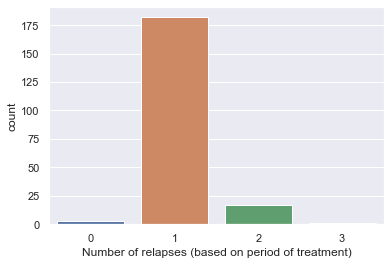

In [1963]:
sns.countplot(data = data_copy1,x = 'Number of relapses (based on period of treatment)')

<AxesSubplot:xlabel='Number of relapses (based on period of sober)', ylabel='count'>

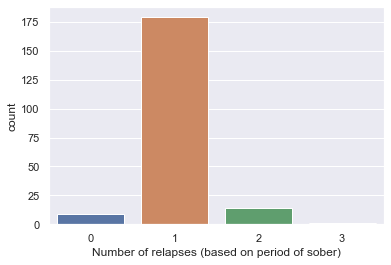

In [1964]:
sns.countplot(data = data_copy1,x = 'Number of relapses (based on period of sober)')

In [1965]:
data_copy1['Remarks'].value_counts()

-                                                                                 61
No                                                                                13
Motivation                                                                        10
Influence Camp                                                                    10
Influence of Camp                                                                  8
Influence Of Camp                                                                  7
Influence of Treatment                                                             7
Influence of camp                                                                  6
Influence of treatment                                                             6
Motivation skill                                                                   5
Friendship issues                                                                  4
Camp effect                                                      

In [1966]:
data_copy1['Remarks'] = data_copy1['Remarks'].replace('-','No')
data_copy1['Remarks'] = data_copy1['Remarks'].replace('\\n','', regex=True)
data_copy1['Remarks'].value_counts()

No                                                                            74
Motivation                                                                    10
Influence Camp                                                                10
Influence of Camp                                                              8
Influence Of Camp                                                              7
Influence of Treatment                                                         7
Influence of camp                                                              6
Influence of treatment                                                         6
Motivation skill                                                               5
Friendship issues                                                              4
Camp effect                                                                    2
Camp Effect                                                                    2
Influence of Hospital Treatm

In [1967]:
data_copy1 = data_copy1.drop('Remarks',axis = 1)
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date',
       ...
       'Year of Treatment (First time)', 'Year of Treatment (Second time)',
       'Year of Treatment (Third time)',
       'Number of relapses (based on period of treatment)',
       'Period of Treatment2', 'Period of Treatment3',
       'Number of relapses (based on period of sober)', 'Period of Sober1',
       'Period of Sober2', 'Period of Sober3'],
      dtype='object', length=121)

In [1968]:
data_copy1 = data_copy1.drop('year of Treated',axis = 1)
data_copy1 = data_copy1.drop('Period of Treatment',axis = 1)
data_copy1 = data_copy1.drop('Period of sober',axis = 1) 
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date',
       ...
       'Year of Treatment (First time)', 'Year of Treatment (Second time)',
       'Year of Treatment (Third time)',
       'Number of relapses (based on period of treatment)',
       'Period of Treatment2', 'Period of Treatment3',
       'Number of relapses (based on period of sober)', 'Period of Sober1',
       'Period of Sober2', 'Period of Sober3'],
      dtype='object', length=118)

In [1969]:
pd.set_option("display.max_rows", None)

In [1970]:
data_copy1.isna().sum()

S.N                                                                               0
Age                                                                               0
Annual Income                                                                     0
Marital Status                                                                    0
AAO for alcohol in year                                                           0
duration of use of alcohol                                                        0
duration of excessive use of alcohol                                              0
avarage units used in last 30days                                                 0
Last drink_Date                                                                   0
Assessment Date                                                                   0
quantity of last drink                                                            0
Nicotine (yes/NO)                                                           

In [1971]:
data_copy1['S.N'] = data_copy1['S.N'].astype('int64')
data_copy1.dtypes

S.N                                                                                        int64
Age                                                                                        int64
Annual Income                                                                            float64
Marital Status                                                                            object
AAO for alcohol in year                                                                    int64
duration of use of alcohol                                                               float64
duration of excessive use of alcohol                                                     float64
avarage units used in last 30days                                                          int64
Last drink_Date                                                                   datetime64[ns]
Assessment Date                                                                   datetime64[ns]
quantity of last drink        

In [1972]:
data_copy1['Marital Status'] = data_copy1['Marital Status'].astype('int64')
data_copy1['Nicotine (yes/NO)'] = data_copy1['Nicotine (yes/NO)'].astype('int64')
data_copy1['smoking/smokeless'] = data_copy1['smoking/smokeless'].astype('int64')
data_copy1['Sugar(mg) '] = data_copy1['Sugar(mg)'].astype('int64')
data_copy1['Medical Problem experienced(Past )'] = data_copy1['Medical Problem experienced(Past )'].astype('int64')
data_copy1['Medical Problem experienced(Present)'] = data_copy1['Medical Problem experienced(Present)'].astype('int64')
data_copy1['History of previous head injureies, if any'] = data_copy1['History of previous head injureies, if any'].astype('int64')
data_copy1['Family history of alcoholism / drug abuse, if any (who and which type of drug)'] = data_copy1['Family history of alcoholism / drug abuse, if any (who and which type of drug)'].astype('int64')
data_copy1.dtypes

S.N                                                                                        int64
Age                                                                                        int64
Annual Income                                                                            float64
Marital Status                                                                             int64
AAO for alcohol in year                                                                    int64
duration of use of alcohol                                                               float64
duration of excessive use of alcohol                                                     float64
avarage units used in last 30days                                                          int64
Last drink_Date                                                                   datetime64[ns]
Assessment Date                                                                   datetime64[ns]
quantity of last drink        

In [1973]:
#for i in data_copy1.index
 #   data_copy1

In [1974]:
print(data_copy1['Age'].max(),data_copy1['Age'].min())

68 17


In [1975]:
# max = 68 , min = 17
# range = 51
# n = 1 + 3.2log(203) = 9
# width = range/n = 51/9 = 6
bins= [17,23,29,35,41,47,53,59,65,71]
label = ['17-23','23-29','29-35','35-41','41-47','47-53','53-59','59-65','65-71']
data_copy1['AgeGroup'] = pd.cut(data_copy1['Age'], bins=bins, labels=label, right=False)

In [1976]:
data_copy1['AgeGroup'].value_counts()

35-41    56
41-47    47
29-35    42
47-53    29
23-29    13
53-59     9
59-65     4
65-71     2
17-23     1
Name: AgeGroup, dtype: int64

In [1977]:
data_copy1['Period of Sober1'].max()

3650

In [1978]:
data_copy1['Period of Sober2'].max()

3650

In [1979]:
data_copy1['Period of Sober2'] = data_copy1['Period of Sober2'].replace(0,10000)
data_copy1['Period of Sober3'] = data_copy1['Period of Sober3'].replace(0,10000)

In [1980]:
data_copy1['Critical Period of Sober'] = data_copy1[['Period of Sober1','Period of Sober2','Period of Sober3']].min(axis=1)

In [1981]:
data_copy1['Critical Period of Sober']

0        93
1        32
2       375
3        31
4         7
5       155
6      3650
7      1825
8      1314
9       186
10        0
11      365
12     2190
13       93
14        7
15        7
16        1
17        7
18      279
19     1071
20      186
21        7
22       31
23       20
24      186
25      916
26     1460
27        3
28     1281
29        7
30        1
31       49
32        0
33      248
34     1825
35      186
36     1825
37        3
38      248
39      186
40       31
41       93
42      365
43      730
44     2190
45     2920
46     1460
47     1460
48      365
49      248
50        0
51     2190
52      124
53       31
54       62
55       15
56      365
57     2190
58      584
59        1
60      730
61       31
62      730
63        7
64      186
65     1095
66      217
67       62
68      365
69       62
70       93
71     2190
72      730
73      186
74       31
75        1
76      186
77      547
78     1825
79       28
80       31
81       15
82      365
83  

In [2217]:
bins= [0,15,30,90,180,365,3651]
label = ['0-15','15-30','30-90','90-180','180-365','365-3651']
data_copy1['Period of Sober Group'] = pd.cut(data_copy1['Critical Period of Sober'], bins=bins, labels=label, right=False)

In [1983]:
data_copy1['Period of Sober Group'].value_counts()

365-3651    99
0-15        32
180-365     25
30-90       20
90-180      17
15-30       10
Name: Period of Sober Group, dtype: int64

In [1984]:
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date',
       ...
       'Period of Treatment2', 'Period of Treatment3',
       'Number of relapses (based on period of sober)', 'Period of Sober1',
       'Period of Sober2', 'Period of Sober3', 'Sugar(mg) ', 'AgeGroup',
       'Critical Period of Sober', 'Period of Sober Group'],
      dtype='object', length=122)

In [1985]:
from platform import python_version
print(python_version())

3.9.7


In [1986]:
import sys
print(sys.executable)
print(sys.version)

C:\Users\acer\anaconda3\python.exe
3.9.7 (default, Sep 16 2021, 16:59:28) [MSC v.1916 64 bit (AMD64)]


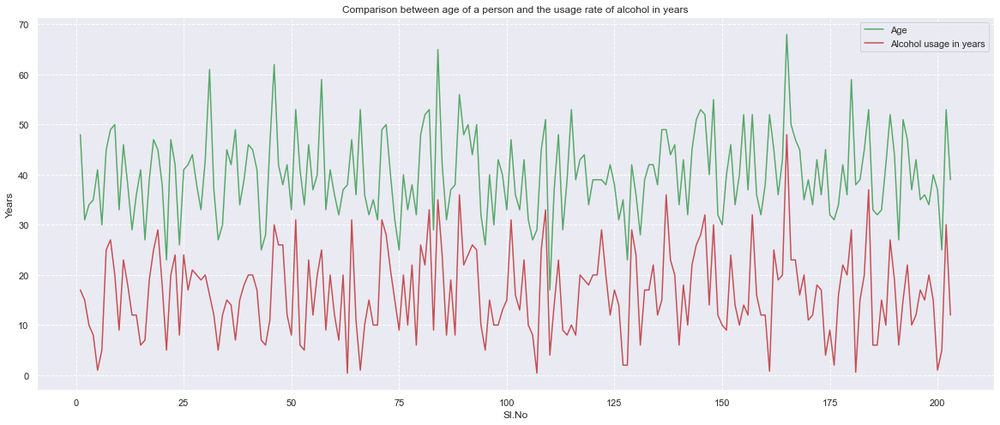

In [1987]:
sns.set(rc = {'figure.figsize':(20,8)})
plt.plot(data_copy1['S.N'], data_copy1['Age'], color='g', label='Age')
plt.plot(data_copy1['S.N'], data_copy1['duration of use of alcohol'], color='r', label='Alcohol usage in years')
plt.title('Comparison between age of a person and the usage rate of alcohol in years')
plt.xlabel('Sl.No')
plt.ylabel('Years')
plt.grid(True, linewidth= 1, linestyle="--")
plt.legend()
plt.show()

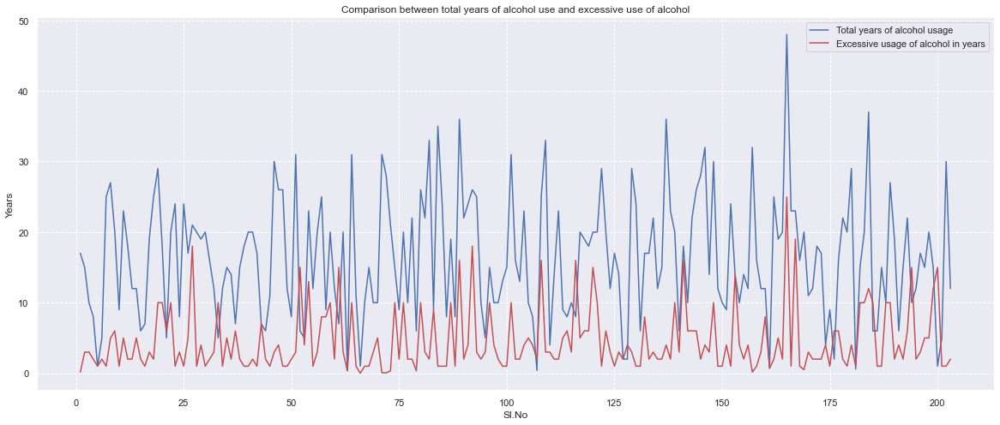

In [1988]:
plt.plot(data_copy1['S.N'], data_copy1['duration of use of alcohol'], color='b', label='Total years of alcohol usage')
plt.plot(data_copy1['S.N'], data_copy1['duration of excessive use of alcohol'], color='r', label='Excessive usage of alcohol in years')
plt.title('Comparison between total years of alcohol use and excessive use of alcohol')
plt.xlabel('Sl.No')
plt.ylabel('Years')
plt.grid(True, linewidth= 1, linestyle="--")
plt.legend()
plt.show()

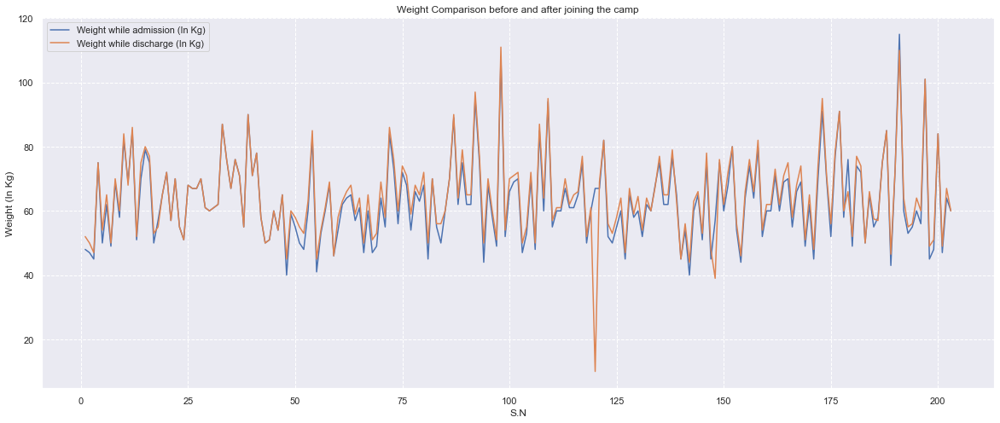

In [1989]:
fig, ax = plt.subplots()
data_copy1.plot(x = 'S.N', y = 'Weight while admission (In Kg)', ax = ax) 
data_copy1.plot(x = 'S.N', y = 'Weight while discharge (In Kg)', ax = ax)
plt.title('Weight Comparison before and after joining the camp')
plt.ylabel('Weight (In Kg)')
plt.grid(True, linewidth= 1, linestyle="--")

In [1990]:
# fig, (ax1,ax2) = plt.subplots(1,2,figsize=(20,6))
# mfact = data_copy1['Motivation factor'].value_counts()
# mfact = mfact.tolist()
# mylabels = ['Mild','Moderate','Severe','Ambivalent']
# ax1.pie(mfact,labels = mylabels,autopct='%1.1f%%', startangle=90)
# ax1.set_title('Motivation Factor towards Substance use')
# ax1.axis('equal')
# mfact = data_copy1['Family history of alcoholism / drug abuse, if any (who and which type of drug)'].value_counts()
# mfact = mfact.tolist()
# mylabels = ['No','Yes']
# ax2.pie(mfact,labels = mylabels,autopct='%1.1f%%', startangle=90)
# ax2.set_title('Family history of alcoholism')
# ax2.axis('equal')
# fig, (ax3,ax4) = plt.subplots(1,2,figsize=(20,8))
# mfact = data_copy1['If any SpecV(Who and which type of drug'].value_counts()
# mfact = mfact.tolist()
# mylabels = ['No','Father','Brother','','','','','','','','','']
# def my_autopct(pct):
#     return ('%.2f' % pct) if pct > 8 else ''
# ax3.pie(mfact,labels = mylabels,autopct=my_autopct, startangle=90)
# ax3.set_title('If any person introduced them to any type of drug')
# ax3.axis('equal')
# mreason = data_copy1['Reason for starting alcohol'].value_counts()
# mreason = mreason.tolist()
# mreason
# mylabels = ['Someone in family or friends were using ','Someone in family or friends were using, To feel better and confident or happy','friends were using','To feel better and confident or happy','To avoid problems and sadness','','','','','','','','','','','','','','','','','','','','','']
# def my_autopct(pct):
#     return ('%.2f' % pct) if pct > 5 else ''
# ax4.pie(mreason,labels = mylabels,autopct=my_autopct, startangle=90)
# ax4.set_title('Reasons for starting Alcohol')
# ax4.axis('equal')
# plt.show()

[Text(0.5, 1.0, 'Nicotine consumption V/S units of alcohol consumed')]

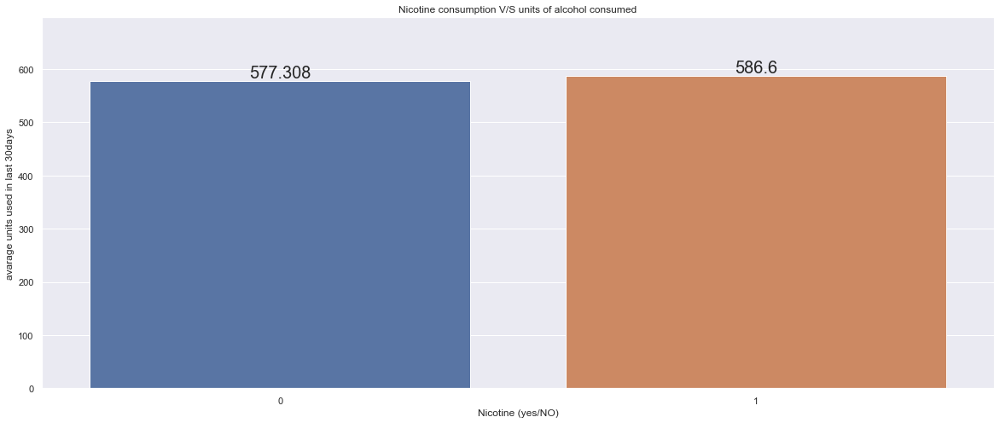

In [1991]:
ax = sns.barplot(x = 'Nicotine (yes/NO)',y = 'avarage units used in last 30days', errwidth=0,data = data_copy1)
ax.bar_label(ax.containers[0],size = 20)
ax.set(title = 'Nicotine consumption V/S units of alcohol consumed')

<AxesSubplot:xlabel='Age', ylabel='avarage units used in last 30days'>

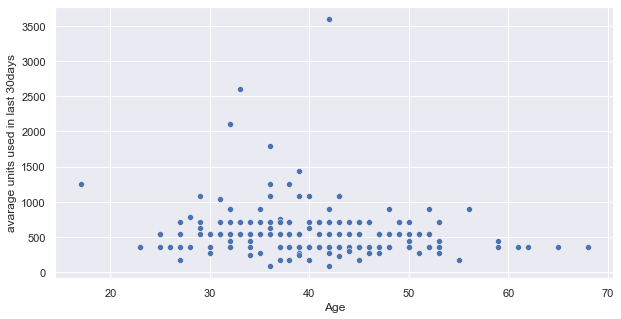

In [1992]:
sns.set(rc = {'figure.figsize':(10,5)})
sns.scatterplot(x = 'Age',y = 'avarage units used in last 30days',data = data_copy1)

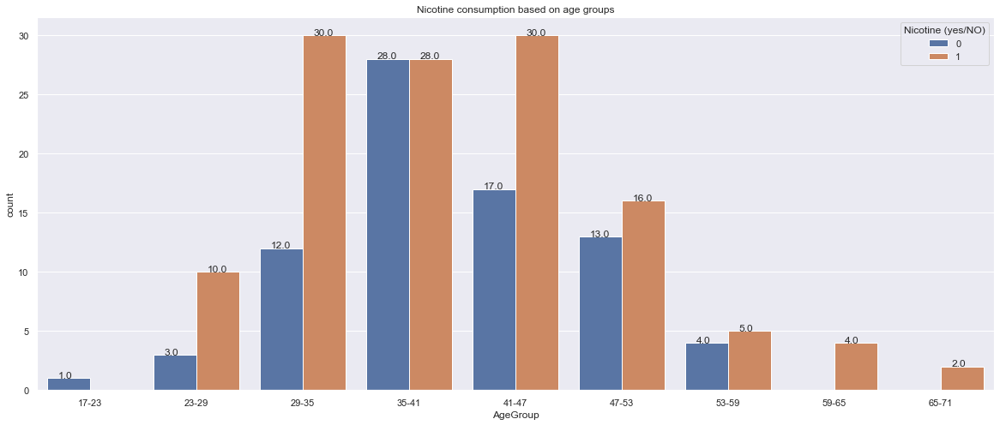

In [1993]:
sns.set(rc = {'figure.figsize':(20,8)})
ax2 = sns.countplot(data=data_copy1, x="AgeGroup", hue="Nicotine (yes/NO)")
ax2.set(title = 'Nicotine consumption based on age groups')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.1, p.get_height()+0.01))

[Text(0.5, 1.0, 'AAO for alcohol in year wrt age groups')]

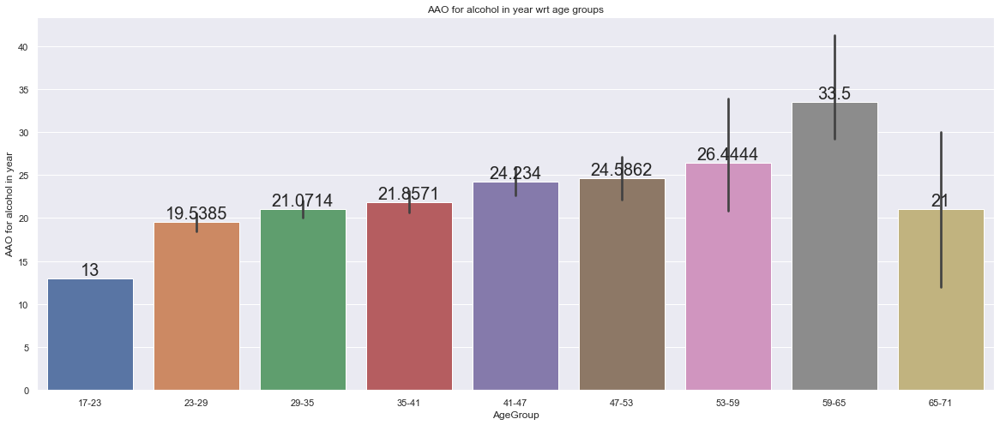

In [1994]:
ax1 = sns.barplot(x = 'AgeGroup',y = 'AAO for alcohol in year', data = data_copy1)
ax1.bar_label(ax1.containers[0],size = 20)
ax1.set(title = 'AAO for alcohol in year wrt age groups')

[Text(0.5, 1.0, 'avarage units used in last 30days wrt Age groups')]

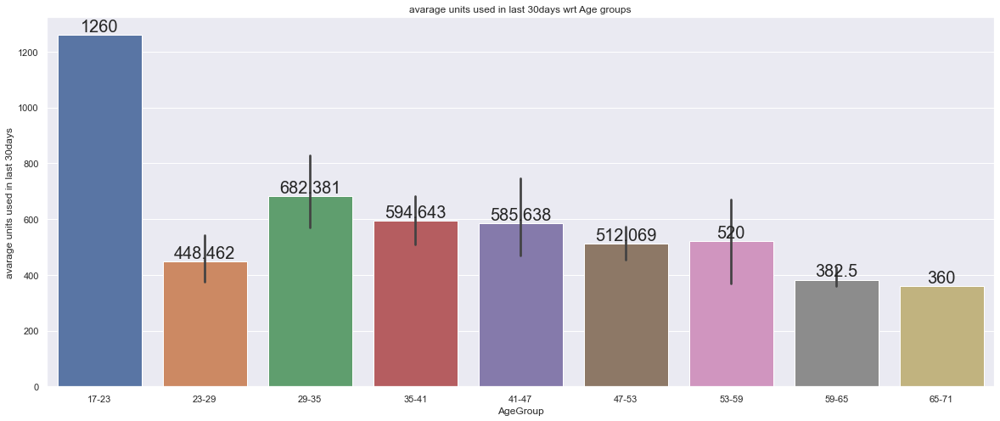

In [1995]:
ax2 = sns.barplot(x = 'AgeGroup',y = 'avarage units used in last 30days', data = data_copy1)
ax2.bar_label(ax2.containers[0],size = 20)
ax2.set(title = 'avarage units used in last 30days wrt Age groups')

In [1996]:
# sns.countplot(x = 'AgeGroup',hue = 'Education in year',data = data_copy1)
# sns.set(rc = {'figure.figsize':(20,8)})
# plt.legend(loc = 'upper left')

In [1997]:
#sns.countplot(x = 'AgeGroup',hue = 'Occupation',data = data_copy1)
#sns.set(rc = {'figure.figsize':(20,8)})
#plt.legend(loc = 'upper left')

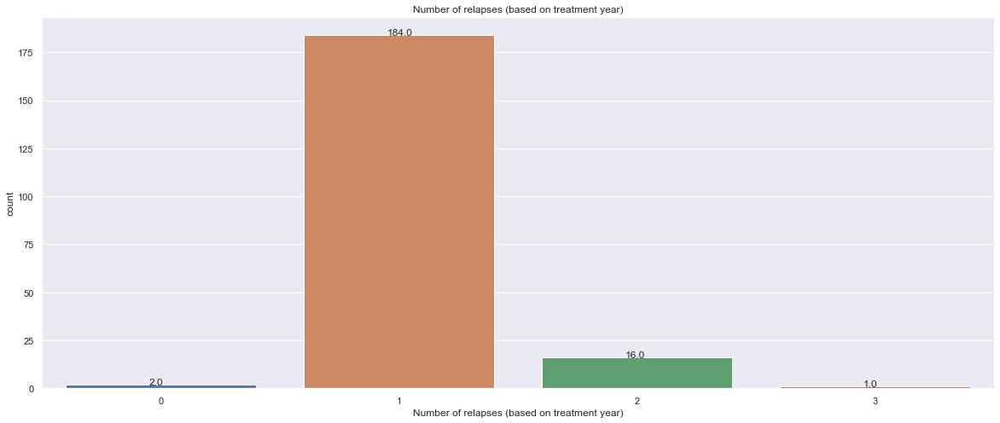

In [1998]:
ax2 = sns.countplot(data = data_copy1,x = 'Number of relapses (based on treatment year)')
ax2.set(title = 'Number of relapses (based on treatment year)')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.35, p.get_height()+0.01))

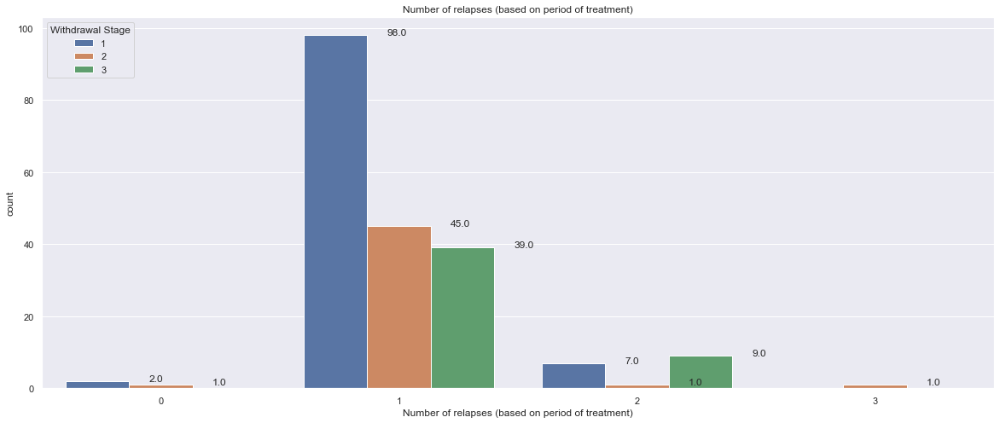

In [1999]:
ax2 = sns.countplot(data = data_copy1,x = 'Number of relapses (based on period of treatment)',hue = 'Withdrawal Stage')
ax2.set(title = 'Number of relapses (based on period of treatment)')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.35, p.get_height()+0.01))

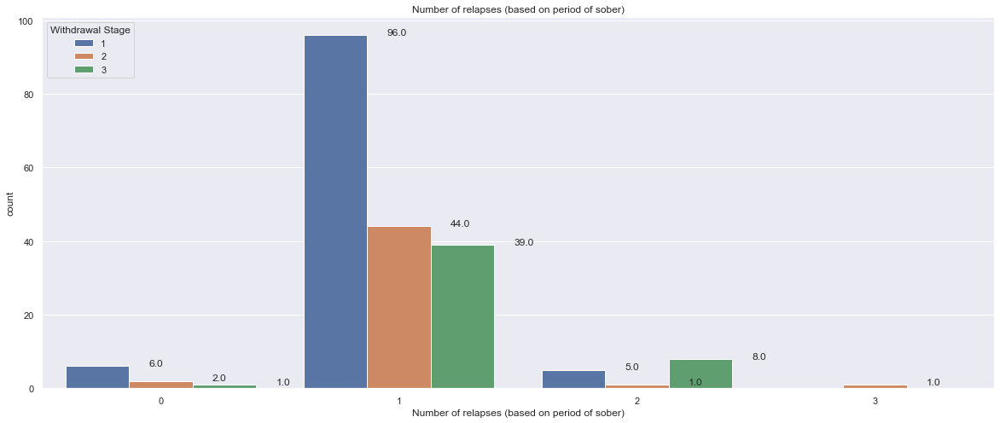

In [2000]:
ax2 = sns.countplot(data = data_copy1,x = 'Number of relapses (based on period of sober)',hue = 'Withdrawal Stage')
ax2.set(title = 'Number of relapses (based on period of sober)')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.35, p.get_height()+0.01))

[Text(0.5, 1.0, 'Number of relapse based on treatment year wrt Age groups')]

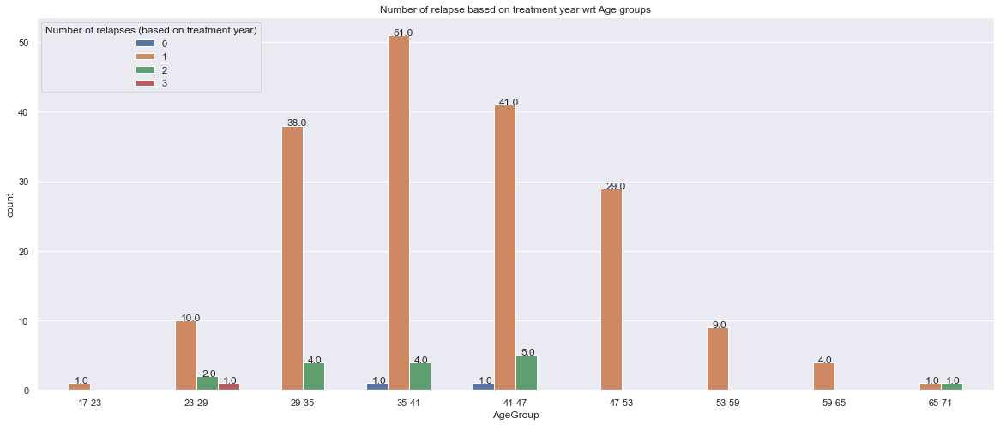

In [2001]:
ax2 = sns.countplot(x = 'AgeGroup',hue = 'Number of relapses (based on treatment year)', data = data_copy1)
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
ax2.set(title = 'Number of relapse based on treatment year wrt Age groups')

[Text(0.5, 1.0, 'Number of relapse based on period of treatment wrt Age groups')]

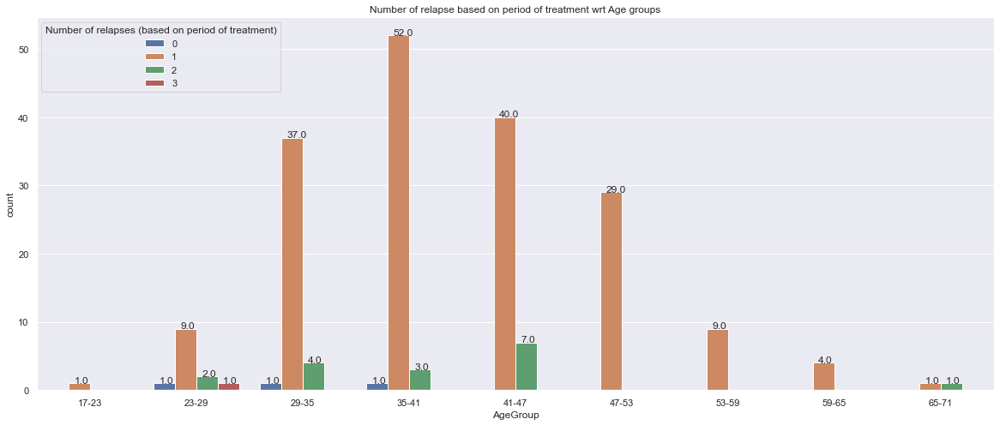

In [2002]:
ax2 = sns.countplot(x = 'AgeGroup',hue = 'Number of relapses (based on period of treatment)', data = data_copy1)
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
ax2.set(title = 'Number of relapse based on period of treatment wrt Age groups')

[Text(0.5, 1.0, 'Number of relapse based on period of sober wrt Age groups')]

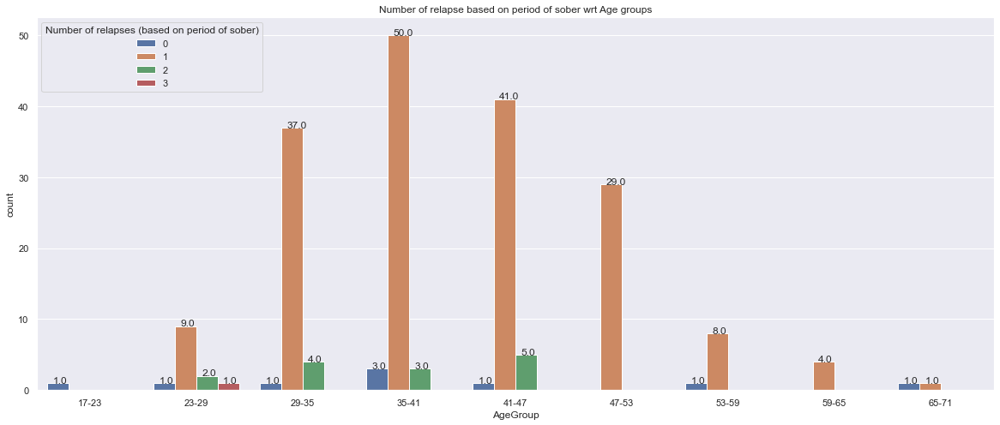

In [2003]:
ax2 = sns.countplot(x = 'AgeGroup',hue = 'Number of relapses (based on period of sober)', data = data_copy1)
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
ax2.set(title = 'Number of relapse based on period of sober wrt Age groups')

[Text(0.5, 1.0, 'Withdrawal Stages wrt Age groups')]

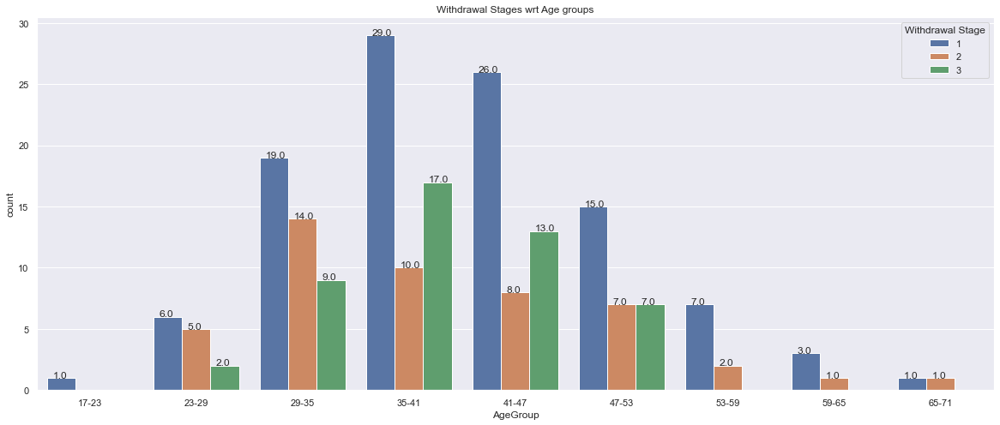

In [2004]:
ax2 = sns.countplot(x = 'AgeGroup',hue = 'Withdrawal Stage', data = data_copy1)
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
ax2.set(title = 'Withdrawal Stages wrt Age groups')

In [2005]:
# sns.set(rc = {'figure.figsize':(50,30)},font_scale = 2)
# ax2 = sns.countplot(data = df,x = "variable",hue = "value")
# for p in ax2.patches:
#    ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
# ax2.set(title = 'Count of Withdrawal symptoms faced by patients')

<AxesSubplot:xlabel='Period of Treatment1', ylabel='Density'>

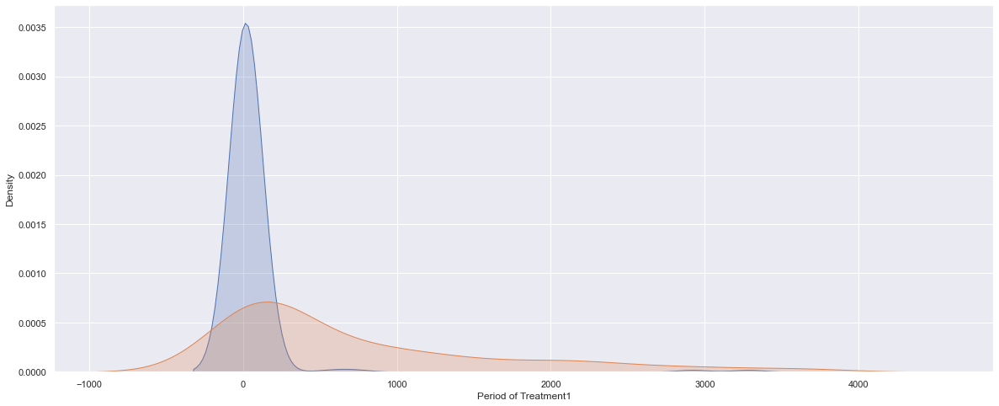

In [2006]:
sns.kdeplot(data = data_copy1,x = 'Period of Treatment1',fill = True)
sns.kdeplot(data = data_copy1,x = 'Period of Sober1',fill = True)

<AxesSubplot:xlabel='Period of Treatment1', ylabel='Density'>

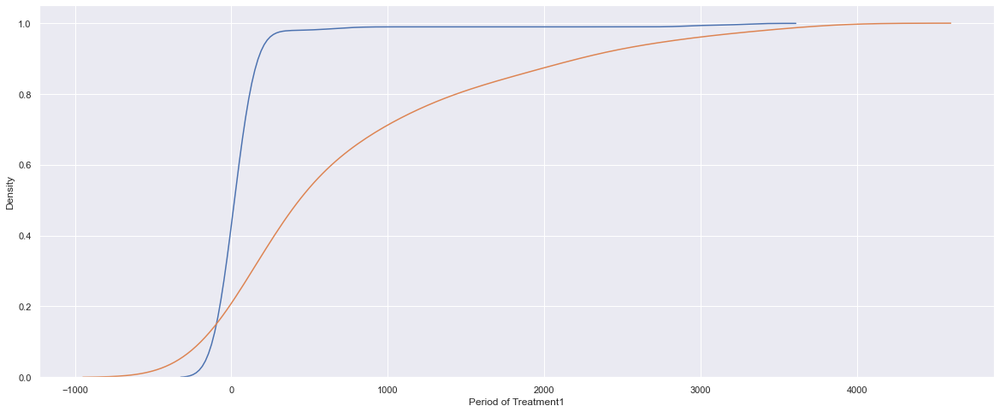

In [2007]:
sns.kdeplot(data = data_copy1,x = 'Period of Treatment1',cumulative=True, common_norm=False, common_grid=True,)
sns.kdeplot(data = data_copy1,x = 'Period of Sober1',cumulative=True, common_norm=False, common_grid=True,)

In [2008]:
for key in data_copy1.loc[0].keys():
    print(key)

S.N
Age
Annual Income
Marital Status
AAO for alcohol in year
duration of use of alcohol
duration of excessive use of alcohol
avarage units used in last 30days
Last drink_Date
Assessment Date
quantity of last drink
Nicotine (yes/NO)
smoking/smokeless
Last Use
Weight while admission (In Kg)
Weight while discharge (In Kg)
Height(In Ft)
Sugar(mg)
Medical Problem experienced(Past )
Medical Problem experienced(Present)
History of previous head injureies, if any
Family history of alcoholism / drug abuse, if any (who and which type of drug)
Education Level
Period of Treatment1
abv_risk
Risk Level
RSA_someone in family or friends were using
RSA_to feel better and confident or happy
RSA_to avoid problems and sadness
RSA_heavy cold in his working place
RSA_other reasons
RSA_to try
RSA_other reason-accident
RSA_friends were using
RSA_happiness
RSA_friendship issues
RSA_work related stress
RSA_other
RSA_wife problem
RSA_function
RSA_weak minded & weak personality
Stress_work related stress
Stress_f

In [2009]:
data_copy1.describe()

,S.N,Age,Annual Income,Marital Status,AAO for alcohol in year,duration of use of alcohol,duration of excessive use of alcohol,avarage units used in last 30days,quantity of last drink,Nicotine (yes/NO),smoking/smokeless,Weight while admission (In Kg),Weight while discharge (In Kg),Height(In Ft),Medical Problem experienced(Past ),Medical Problem experienced(Present),"History of previous head injureies, if any","Family history of alcoholism / drug abuse, if any (who and which type of drug)",Education Level,Period of Treatment1,abv_risk,RSA_someone in family or friends were using,RSA_to feel better and confident or happy,RSA_to avoid problems and sadness,RSA_heavy cold in his working place,RSA_other reasons,RSA_to try,RSA_other reason-accident,RSA_friends were using,RSA_happiness,RSA_friendship issues,RSA_work related stress,RSA_other,RSA_wife problem,RSA_function,RSA_weak minded & weak personality,Stress_work related stress,Stress_family or relationship issues,Stress_financial stress,Stress_others,Stress_absent,Stress_reports stressed but doesn't know where or what,Stress_love problem,Stress_lonelyness,Stress_gave confidence,Stress_felt relaxed and reduced physical exertion,Stress_mental pressure,DSP_Mild,DSP_Moderate,DSP_Severe,MF_Ambivalent,MF_Mild,MF_Moderate,MF_Severe,Aches and pains,Anxiety,Auditory hallucinations or illusions,Fits,Insomnia,Nausea,Palpitation,Restlessness,Sweating,Transient visual or tactile,Tremors,Weakness,No,Withdrawal Stage,CHP_pancreatitis problem,CHP_no,CHP_diabetes,CHP_liver disorder,CHP_respiratory problem,CHP_chronic bronchitis,CHP_bronchial asthma,CHP_infections,CHP_epilepsy,CHP_b.p,CHP_dust allergy,CHP_aggressive outbursts,CHP_gastric,CHP_skin problems,CHP_pulmonary t.b,PCP_seizure during withdrawal,PCP_confusion,PCP_no,PCP_depression,PCP_aggressive outbursts,PCP_hallucinations,PCP_paranoid ideas,PCP_suicidal ideation or attempts,PCP_yes,PCP_tension,PCPR_seizure during withdrawal,PCPR_confusion,PCPR_no,PCPR_depression,PCPR_aggressive outbursts,PCPR_hallucinations,PCPR_paranoid ideas,PCPR_suicidal ideation or attempts,PCPR_tension,Number of relapses (based on treatment year),Year of Treatment (First time),Year of Treatment (Second time),Year of Treatment (Third time),Number of relapses (based on period of treatment),Period of Treatment2,Period of Treatment3,Number of relapses (based on period of sober),Period of Sober1,Period of Sober2,Period of Sober3,Sugar(mg),Critical Period of Sober
count,203.000000,203.000000,2.030000e+02,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.00000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.00000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000,203.000000
mean,102.000000,40.098522,1.058374e+05,0.798030,22.866995,16.350739,4.549915,583.029557,335.615764,0.615764,0.669951,63.113300,64.559113,5.597389,0.472906,0.251232,0.133005,0.310345,3.137931,53.699507,180.050577,0.748768,0.182266,0.108374,0.004926,0.004926,0.004926,0.00

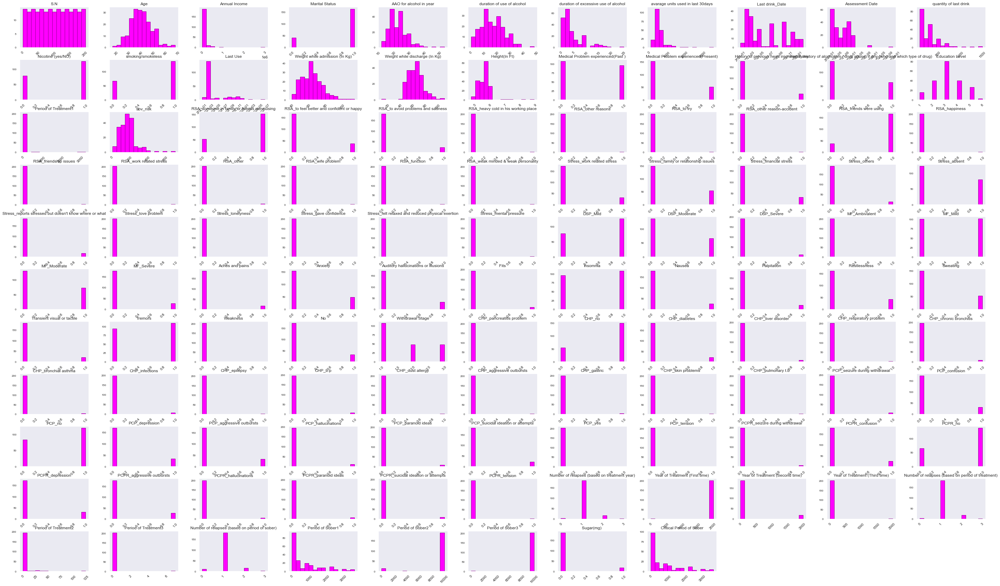

In [2010]:
fig = data_copy1.hist(bins = 15, color = 'fuchsia', edgecolor = 'darkmagenta', linewidth = 1.0, xlabelsize=10, ylabelsize=8, xrot=45, yrot=0, figsize=(50,30), grid=False)

In [2011]:
#data_copy3 = data.iloc[:,350:402].copy()
column_header3 = data.iloc[1:2,342:399].copy()
column_header3 = column_header3.values.tolist()
data_copy6 = data.iloc[2:,342:399].copy()
data_copy6.columns = column_header3
data_copy6.columns = data_copy6.columns.get_level_values(0)
data_copy6.index = range(len(data_copy6.index))
data_copy6.head()
#data_copy3

,Arranged Marriage/Love marriage,Number of year of marriage,multiple marriages,Have you been separated from your spouse due to your addiction,Are you suspicious of your wife,any instance of family violence,Specify nature of current work,At what age did you start working?,How long have you been working?,"Have you received any special award, recognization, merit certificates or promotions",Did you change Your job frequently due to addiction?,Did you have any period of unemployment?\nIf yes how long and for what reasons?,Occupational damage,Details of Debts to be cleared. If any mention the amount,Legal complications yes/no\nIf yes mention,Describe your childhood / teenage year? Did you experience the following,Behaviour problem identified in Childhood/ Adolescence,Achievements in the Education,year of Education,High achiever in extracurricular activities,Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent,Past Treatment History,Psychological factors of substances use continuation and relapse,Maximum period of abstinence and possible factors for abstinence,Significant Psychosocial problems,Final Diagnosis Full,Clinical Global Impression,Global Assessment of Funtioning,Doctors Initial,Rligious beliefs and behaviourQn 1,Rligious beliefs and behaviourQn 2,Rligious beliefs and behaviourQn3,Rligious beliefs and behaviourQn4,Rligious beliefs and behaviourQn5,DSM5CCQn1,DSM5CCQn2,DSM5CCQn3,DSM5CCQn4,DSM5CCQn5,DSM5CCQn6,DSM5CCQn7,DSM5CCQn8,DSM5CCQn9,DSM5CCQn10,DSM5CCQn11,DSM5CCQn12,DSM5CCQn13,DSM5CCQn14,DSM5CCQn15,DSM5CCQn16,DSM5CCQn17,DSM5CCQn18,DSM5CCQn19,DSM5CCQn20,DSM5CCQn21,DSM5CCQn22,DSM5CCQn23
0,Love marriage,2009,No,No,No,No,Company,16year,32year,No,No,No,No,1000/-,No,None,None,No,9year,No,A believer,No,No,2months,No,Alcohol withdrawal- ADS- Seizure \nSeizure dis...,Moderately ill,60\n|\n81,K.S. Hegde hospital mangalore,Never,Never,Never,Never,Not at all important,4,3,3,2,3,4,0,0,0,0,0,0,0,0,0,3,3,3,3,0,0,4,0
1,Arranged Marriage,2016,No,No,No,Nil,Agriculture,15year,16year,No,No,No,No,Yes,No,None,None,No,9year,No,A believer,No,No,1wk,No,Alcohol dependence syndrom\nnicotine dependenc...,Mildly ill,90\n|\n81,Nil,Often,Very often,Sometimes,Sometimes,Not at all important,1,1,3,3,4,2,2,3,1,2,0,2,3,2,1,3,3,1,1,2,4,4,0
2,-,-,-,-,-,-,Coolie,23year,11year,No,No,No,No,"10,000/-","yes, Fined for drunken drive, assault",Poverty or severe debts,"Running from home, alcohol",No,13year,Video Editor,Non believer,No,Love failure,2.05year,No,Alcohol dependence syndrom\nnicotine dependenc...,Moderately ill,100\n|\n91,Nil,Often,Very often,Never,Never,Not at all important,1,2,3,1,1,2,2,1,0,0,1,1,1,2,1,2,0,0,0,0,4,4,0
3,Love marriage,12year,Yes,No,Yes,Yes\nPhysical violence directed towards family...,Own- Buisness,23 ys,12year,No,Yes,Yes,Attend work under the influence of alcohol,"80,000/- from money borrowed from family and f...","Yes, Arrestef for drunken/ drug influenced beh...","Poverty or severe debts, Running away from hom...","Destruction of others property, Alcohol",No,13year,No,Non believer,Yes,Friendship issues,1 Month\nSpandana Treatment,No,Alcohol dependence syndrom,Severely ill,70\n|\n61,Nil,Often,Often,Never,Never,Not at all important,1,1,3,2,1,3,3,3,0,0,1,1,1,3,0,3,3,1,2,2,4,0,0
4,Arranged Marriage,16 year,No,No,No,No,Agriculture,12year,29year,No,No,No,No,Nil,No,Poverty or severe debts,None,No,7year,No,Non believer,Yes,Friendship issues,1 Week\nChannaeayapatna Sparsha Hospital,No,ADS,Moderately ill,90\n|\n81,Nil,Sometimes,Very often,Never,Rarely,Not at all important,2,2,2,0,0,2,2,1,0,0,1,1,2,2,0,1,0,0,1,1,3,4,0


In [2012]:
percent_missing = data_copy6.isnull().sum() * 100 / len(data_copy6)
missing_value_df = pd.DataFrame({'column_name': data_copy6.columns,
                                 'percent_missing': percent_missing})
missing_value_df.to_excel("missing_2.xlsx")

In [2013]:
data_copy6 = data_copy6.drop(data_copy6.columns[34:],axis = 1)

In [2014]:
data_copy6.columns

Index(['Arranged Marriage/Love marriage', 'Number of year of marriage',
       'multiple marriages',
       'Have you been separated from your spouse due to your addiction',
       'Are you suspicious of your wife', 'any instance of family violence',
       'Specify nature of current work', 'At what age did you start working?',
       'How long have you been working?',
       'Have you received any special award, recognization, merit certificates or promotions',
       'Did you change Your job frequently due to addiction?',
       'Did you have any period of unemployment?\nIf yes how long and for what reasons?',
       'Occupational damage',
       'Details of Debts to be cleared. If any mention the amount',
       'Legal complications yes/no\nIf yes mention',
       'Describe your childhood / teenage year? Did you experience the following ',
       'Behaviour problem identified in Childhood/ Adolescence',
       'Achievements in the Education', 'year of Education',
       'High achiev

In [2015]:
data_copy6['Number of year of marriage']=data_copy6['Number of year of marriage'].replace(2015,7,regex=True)
data_copy6['Number of year of marriage']=data_copy6['Number of year of marriage'].replace(2005,17,regex=True)
data_copy6['Number of year of marriage']=data_copy6['Number of year of marriage'].replace(2001,21,regex=True)
data_copy6['Number of year of marriage']=data_copy6['Number of year of marriage'].replace(2016,6,regex=True)
data_copy6['Number of year of marriage']=data_copy6['Number of year of marriage'].replace(2009,13,regex=True)
data_copy6['Number of year of marriage']=data_copy6['Number of year of marriage'].replace(['Arranged Marriage','-'],np.nan,regex=True)
data_copy6['Number of year of marriage']=data_copy6['Number of year of marriage'].replace('Love Marriage',np.nan,regex=True)
data_copy6['Number of year of marriage']=data_copy6['Number of year of marriage'].replace(np.nan,0,regex=True)
data_copy6['Number of year of marriage']=data_copy6['Number of year of marriage'].replace(['Year','year','yr','ys','s'],'',regex=True)
data_copy6['Number of year of marriage']=data_copy6['Number of year of marriage'].replace(['Month','year'],'',regex=True)
data_copy6['Number of year of marriage']=data_copy6['Number of year of marriage'].replace(2007,15,regex=True)
data_copy6['Number of year of marriage']=data_copy6['Number of year of marriage'].replace(1996,26,regex=True)
data_copy6['Number of year of marriage']=data_copy6['Number of year of marriage'].replace('s','',regex=True)
data_copy6['Number of year of marriage']=data_copy6['Number of year of marriage'].replace('No',np.nan,regex=True)
data_copy6['Number of year of marriage']=data_copy6['Number of year of marriage'].astype('float64')
data_copy6['Number of year of marriage']=data_copy6['Number of year of marriage'].replace(np.nan,0,regex=True)
data_copy6['Number of year of marriage']=data_copy6['Number of year of marriage'].astype('int64')
mean=data_copy6['Number of year of marriage'].median()
data_copy6['Number of year of marriage']=data_copy6['Number of year of marriage'].replace(0,mean,regex=True)
data_copy6['Number of year of marriage'].value_counts()

13    52
15    17
16    14
20    10
6      8
17     8
7      8
11     7
9      6
4      6
10     6
26     5
5      4
19     4
23     4
21     4
24     4
18     4
14     4
22     4
25     4
2      3
12     3
3      2
8      2
1      2
50     1
29     1
27     1
28     1
34     1
37     1
39     1
40     1
Name: Number of year of marriage, dtype: int64

In [2016]:
data_copy6['Arranged Marriage/Love marriage']=data_copy6['Arranged Marriage/Love marriage'].replace('Love marriage','Love Marriage',regex=True)
data_copy6['Arranged Marriage/Love marriage']=data_copy6['Arranged Marriage/Love marriage'].replace(['arranged','Arranged marriage','Arranged','Arranged Marrige'],'Arranged Marriage',regex=True)
data_copy6['Arranged Marriage/Love marriage']=data_copy6['Arranged Marriage/Love marriage'].replace('Love Com Arrange Marriage','Love Come Arrange Marriage',regex=True)
data_copy6['Arranged Marriage/Love marriage']=data_copy6['Arranged Marriage/Love marriage'].replace('Arranged Marriage Marriage','Arranged Marriage',regex=True)
data_copy6['Arranged Marriage/Love marriage']=data_copy6['Arranged Marriage/Love marriage'].replace(['Arranged Marriage Marriage','Arranged Marriage','Arranged Marriage Marrige'],'Arranged',regex=True)
data_copy6['Arranged Marriage/Love marriage']=data_copy6['Arranged Marriage/Love marriage'].replace('Arranged Marrige','Arranged',regex=True)
data_copy6['Arranged Marriage/Love marriage']=data_copy6['Arranged Marriage/Love marriage'].replace('Arranged','Arranged Marriage',regex=True)
mode_sam=data_copy6['Arranged Marriage/Love marriage'].mode()
data_copy6['Arranged Marriage/Love marriage']=data_copy6['Arranged Marriage/Love marriage'].replace([np.nan,'-'],0,regex=True)
data_copy6['Arranged Marriage/Love marriage']=data_copy6['Arranged Marriage/Love marriage'].replace(0,'Arranged Marriage',regex=True)
data_copy6['Arranged Marriage/Love marriage'].value_counts()

Arranged Marriage             179
Love Marriage                  19
Love Come Arrange Marriage      4
Unmarried                       1
Name: Arranged Marriage/Love marriage, dtype: int64

In [2017]:
data_copy6 = data_copy6.drop('Arranged Marriage/Love marriage',axis = 1)

In [2018]:
data_copy6['multiple marriages']=data_copy6['multiple marriages'].replace('yes','Yes',regex=True)
data_copy6['multiple marriages']=data_copy6['multiple marriages'].replace(['NO',38,20],'No',regex=True)
data_copy6['multiple marriages']=data_copy6['multiple marriages'].replace(38,'Yes',regex=True)
data_copy6['multiple marriages']=data_copy6['multiple marriages'].replace(20,'Yes',regex=True)
data_copy6['multiple marriages']=data_copy6['multiple marriages'].replace([np.nan,'-'],'No',regex=True)
data_copy6['multiple marriages'].value_counts()

No     180
Yes     23
Name: multiple marriages, dtype: int64

In [2019]:
data_copy6 = data_copy6.drop('multiple marriages',axis = 1)

In [2020]:
data_copy6['Have you been separated from your spouse due to your addiction']=data_copy6['Have you been separated from your spouse due to your addiction'].replace('Yes\n1 Month','Yes',regex=True)
data_copy6['Have you been separated from your spouse due to your addiction']=data_copy6['Have you been separated from your spouse due to your addiction'].replace('10yr','Yes',regex=True)
data_copy6['Have you been separated from your spouse due to your addiction']=data_copy6['Have you been separated from your spouse due to your addiction'].replace(['Yes\n4.6 Year','Yes\n3 Months','Yes\n6 Months','Yes\n1.6 Year','Yes/1year','Yes\n3 Year','yes'],'Yes',regex=True)
data_copy6['Have you been separated from your spouse due to your addiction']=data_copy6['Have you been separated from your spouse due to your addiction'].replace('NO','No',regex=True)
data_copy6['Have you been separated from your spouse due to your addiction']=data_copy6['Have you been separated from your spouse due to your addiction'].replace([np.nan,'-'],'No',regex=True)
data_copy6['Have you been separated from your spouse due to your addiction'].value_counts()

No     187
Yes     16
Name: Have you been separated from your spouse due to your addiction, dtype: int64

In [2021]:
data_copy6 = data_copy6.drop('Have you been separated from your spouse due to your addiction',axis = 1)

In [2022]:
data_copy6['Are you suspicious of your wife']=data_copy6['Are you suspicious of your wife'].replace(['Yes\n6 Months','Yes\n15 years'],'Yes',regex=True)
data_copy6['Are you suspicious of your wife']=data_copy6['Are you suspicious of your wife'].replace('NO','No',regex=True)
data_copy6['Are you suspicious of your wife']=data_copy6['Are you suspicious of your wife'].replace([np.nan,'-'],'No',regex=True)
data_copy6['Are you suspicious of your wife'].value_counts()

No     192
Yes     11
Name: Are you suspicious of your wife, dtype: int64

In [2023]:
data_copy6 = data_copy6.drop('Are you suspicious of your wife',axis = 1)

In [2024]:
data_copy6['Specify nature of current work']=data_copy6['Specify nature of current work'].replace(['Agricultuer','Agriculture '],'Agriculture',regex=True)
data_copy6['Specify nature of current work']=data_copy6['Specify nature of current work'].replace('Areca Buisness','Buisness',regex=True)
data_copy6['Specify nature of current work']=data_copy6['Specify nature of current work'].replace('Farmer','Agriculture',regex=True)
data_copy6['Specify nature of current work']=data_copy6['Specify nature of current work'].replace(np.nan,'Agriculture',regex=True)
data_copy6['Specify nature of current work'].value_counts()

Agriculture                            57
Coolie                                 24
Buisness                                9
Driver                                  9
Auto Driver                             4
Unemployee                              4
Electrician                             4
Agriculturist                           3
Mechanic                                3
Contractor                              2
Welding                                 2
Hotel                                   2
Police                                  2
Own Buisness                            2
Painting                                2
Carpenter                               2
Company                                 2
Own- Buisness                           2
Engineer                                2
Water Factory work                      1
Cook                                    1
Architectuer                            1
Ayurvedic medical company               1
Water Supply                      

In [2025]:
data_copy6 = data_copy6.drop('Specify nature of current work',axis = 1)

In [2026]:
data_copy6['At what age did you start working?']=data_copy6['At what age did you start working?'].replace(['Year','year','yr','ys','s'],'',regex=True)
data_copy6['At what age did you start working?']=data_copy6['At what age did you start working?'].replace('-',np.nan)
data_copy6['At what age did you start working?']=data_copy6['At what age did you start working?'].replace(np.nan,0,regex=True)
data_copy6['At what age did you start working?']=data_copy6['At what age did you start working?'].astype('float64')
data_copy6['At what age did you start working?']=data_copy6['At what age did you start working?'].astype('int64')
data_copy6['At what age did you start working?'].skew()
median_sam=data_copy6['At what age did you start working?'].median()
data_copy6['At what age did you start working?']=data_copy6['At what age did you start working?'].replace(0,median_sam,regex=True)
data_copy6['At what age did you start working?'].value_counts()

16    31
18    26
20    21
15    18
17    15
12    14
14    10
19     9
21     9
13     8
25     7
10     7
23     6
24     4
30     4
22     4
27     3
11     3
28     1
9      1
40     1
33     1
Name: At what age did you start working?, dtype: int64

In [2027]:
data_copy6['How long have you been working?']=data_copy6['How long have you been working?'].replace(['Year','year','yr','ys','s'],'',regex=True)
data_copy6['How long have you been working?']=data_copy6['How long have you been working?'].replace(['No','-'],np.nan,regex=True)
data_copy6['How long have you been working?']=data_copy6['How long have you been working?'].astype('float64')
data_copy6['How long have you been working?'].skew()
median_how=data_copy6['How long have you been working?'].median()
data_copy6['How long have you been working?']=data_copy6['How long have you been working?'].replace(np.nan,median_how,regex=True)
data_copy6['How long have you been working?'].value_counts()

23.0    15
25.0    14
16.0    12
12.0    10
22.0     9
18.0     9
26.0     9
28.0     9
32.0     8
14.0     8
27.0     7
15.0     7
29.0     7
24.0     6
8.0      5
20.0     5
11.0     4
30.0     4
35.0     4
21.0     4
10.0     4
40.0     3
19.0     3
41.0     3
13.0     3
37.0     3
17.0     3
34.0     3
31.0     2
43.0     2
4.0      2
5.0      2
6.0      2
3.0      2
2.0      1
56.0     1
42.0     1
38.0     1
9.0      1
7.0      1
1.0      1
50.0     1
45.0     1
39.0     1
Name: How long have you been working?, dtype: int64

In [2028]:
data_copy6.drop('Details of Debts to be cleared. If any mention the amount',axis=1,inplace=True)

In [2029]:
data_copy6['High achiever in extracurricular activities']=data_copy6['High achiever in extracurricular activities'].replace(['Running champion in dharawada dist','Running Race,Kabaddi'],'Running',regex=True)
data_copy6['High achiever in extracurricular activities']=data_copy6['High achiever in extracurricular activities'].replace('None',np.nan,regex=True)
data_copy6['High achiever in extracurricular activities']=data_copy6['High achiever in extracurricular activities'].replace(np.nan,'No',regex=True)
data_copy6['High achiever in extracurricular activities'].value_counts()

No                      184
-                         9
Cricket                   3
Sports                    2
Running                   2
Video Editor              1
Sports & Dance            1
Valley Ball, Kho Kho      1
Name: High achiever in extracurricular activities, dtype: int64

In [2030]:
data_copy6.drop('High achiever in extracurricular activities',axis=1,inplace=True)

In [2031]:
data_copy6['Past Treatment History']=data_copy6['Past Treatment History'].replace(np.nan,'No',regex=True)
data_copy6['Past Treatment History'].value_counts()

No                                                                  37
Yes\nJagruthi Soudha                                                24
Yes                                                                 10
Yes, Jagruthi Soudha                                                 9
Yes\nVIP Jagruthi Soudha                                             8
-                                                                    3
Yes\nDeaddiction Camp                                                3
Yes\nLocal Camp                                                      3
yes                                                                  3
Nil                                                                  2
Yes\nVIP Camp Jagruthi Soudha                                        2
Asha Kirana Bhadravathi                                              2
Local Camp Keralapura                                                1
Local camp piriyapattana                                             1
Rehab 

In [2032]:
data_copy6 = data_copy6.drop('Past Treatment History',axis=1)

In [2033]:
data_copy6['year of Education']=data_copy6['year of Education'].replace(['Year','year','yr','ys','s','Yaer','th'],'',regex=True)
data_copy6['year of Education']=data_copy6['year of Education'].replace(['No','Illiterartion'],np.nan,regex=True)
data_copy6['year of Education']=data_copy6['year of Education'].replace('M.Tech',18,regex=True)
data_copy6['year of Education']=data_copy6['year of Education'].replace('B A',16,regex=True)
data_copy6['year of Education']=data_copy6['year of Education'].replace(['0','Nil','-'],np.nan,regex=True)
data_copy6['year of Education']=data_copy6['year of Education'].replace(np.nan,0,regex=True)
data_copy6['year of Education']=data_copy6['year of Education'].astype('float64')
data_copy6['year of Education'].skew()
mean_year=data_copy6['year of Education'].mean()
data_copy6['year of Education']=data_copy6['year of Education'].replace(0,mean_year,regex=True)
data_copy6['year of Education']=data_copy6['year of Education'].astype('int64')
data_copy6['year of Education'].value_counts()

7     77
12    32
15    17
9      9
8      9
16     8
10     7
5      7
4      6
18     5
11     4
13     4
3      3
19     3
14     3
17     3
6      3
2      2
21     1
Name: year of Education, dtype: int64

In [2034]:
#data_copy6['Maximum period of abstinence and possible factors for abstinence'] = data_copy6['Maximum period of abstinence and possible factors for abstinence'].str.split()
data_copy6['Maximum period of abstinence and possible factors for abstinence']=data_copy6['Maximum period of abstinence and possible factors for abstinence'].replace(np.nan,'Influence of camp',regex=True)
#data_copy6['Maximum period of abstinence and possible factors for abstinence']=data_copy6['Maximum period of abstinence and possible factors for abstinence'].replace(['\n','/'],',',regex = True)
#temp = data_copy6['Maximum period of abstinence and possible factors for abstinence'].str.split(pat = ',',expand = True)
data_copy6['Maximum period of abstinence and possible factors for abstinence'].value_counts()

No                                                       33
3 Year\nInfluence of camp                                 5
1 Year\nInfluence of camp                                 4
Influence of camp                                         4
1 Year\nInfluence of Camp                                 3
5 Year\nInfluence of camp                                 3
4 Year\nInfluence of camp                                 3
6 Month\nInfluence of Treatment                           2
2 Year\nInfluence of camp                                 2
4 Year\nInfluence of VIP Camp                             2
Motivation skill                                          2
6 Month\nInfluence of Camp                                2
1 Week medicine effect                                    2
2 Year\nInfluence of Camp                                 2
5 Month\nInfluence of camp                                2
9 Year\nInfluence of camp                                 2
1.6 Year\nInfluence of Camp             

In [2035]:
for i in data_copy6.index:
    if data_copy6['Maximum period of abstinence and possible factors for abstinence'][i] == 'No':
        data_copy6['Maximum period of abstinence and possible factors for abstinence'][i] = 0
    else:
        data_copy6['Maximum period of abstinence and possible factors for abstinence'][i] = 1

data_copy6['Maximum period of abstinence and possible factors for abstinence'].value_counts()

1    170
0     33
Name: Maximum period of abstinence and possible factors for abstinence, dtype: int64

In [2036]:
data_copy6['Doctors Initial']=data_copy6['Doctors Initial'].replace(np.nan,'No',regex=True)
data_copy6['Doctors Initial'].value_counts()

No                                        196
Nil                                         5
K.S. Hegde hospital  mangalore              1
Refer to KSHEMA for further management      1
Name: Doctors Initial, dtype: int64

In [2037]:
data_copy6 = data_copy6.drop('Doctors Initial',axis=1)
data_copy6

,Number of year of marriage,any instance of family violence,At what age did you start working?,How long have you been working?,"Have you received any special award, recognization, merit certificates or promotions",Did you change Your job frequently due to addiction?,Did you have any period of unemployment?\nIf yes how long and for what reasons?,Occupational damage,Legal complications yes/no\nIf yes mention,Describe your childhood / teenage year? Did you experience the following,Behaviour problem identified in Childhood/ Adolescence,Achievements in the Education,year of Education,Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent,Psychological factors of substances use continuation and relapse,Maximum period of abstinence and possible factors for abstinence,Significant Psychosocial problems,Final Diagnosis Full,Clinical Global Impression,Global Assessment of Funtioning,Rligious beliefs and behaviourQn 1,Rligious beliefs and behaviourQn 2,Rligious beliefs and behaviourQn3,Rligious beliefs and behaviourQn4,Rligious beliefs and behaviourQn5
0,13,No,16,32.0,No,No,No,No,No,None,None,No,9,A believer,No,1,No,Alcohol withdrawal- ADS- Seizure \nSeizure dis...,Moderately ill,60\n|\n81,Never,Never,Never,Never,Not at all important
1,6,Nil,15,16.0,No,No,No,No,No,None,None,No,9,A believer,No,1,No,Alcohol dependence syndrom\nnicotine dependenc...,Mildly ill,90\n|\n81,Often,Very often,Sometimes,Sometimes,Not at all important
2,13,-,23,11.0,No,No,No,No,"yes, Fined for drunken drive, assault",Poverty or severe debts,"Running from home, alcohol",No,13,Non believer,Love failure,1,No,Alcohol dependence syndrom\nnicotine dependenc...,Moderately ill,100\n|\n91,Often,Very often,Never,Never,Not at all important
3,12,Yes\nPhysical violence directed towards family...,23,12.0,No,Yes,Yes,Attend work under the influence of alcohol,"Yes, Arrestef for drunken/ drug influenced beh...","Poverty or severe debts, Running away from hom...","Destruction of others property, Alcohol",No,13,Non believer,Friendship issues,1,No,Alcohol dependence syndrom,Severely ill,70\n|\n61,Often,Often,Never,Never,Not at all important
4,16,No,12,29.0,No,No,No,No,No,Poverty or severe debts,None,No,7,Non believer,Friendship issues,1,No,ADS,Moderately ill,90\n|\n81,Sometimes,Very often,Never,Rarely,Not at all important
5,13,Yes\nPhysical violence directed towards family...,22,8.0,No,No,No,No,No,Poverty or severe debts or Broken home or sing...,None,No,13,Non believer,"Craving, Friendship issues",1,No,ADS\nNDS,Not assessed,90\n|\n81,Very often,Very often,Never,Rarely,Moderately important
6,25,No,20,25.0,No,No,No,No,No,None,None,No,4,A believer,No,0,No,ADS,Not assessed,80\n|\n71,Often,Very often,Never,Rarely,Not at all important
7,22,No,28,21.0,Certificates,No,Yes,Absenteeism,No,Poverty or severe debts,None,Master of Engineering,18,Non believer,Job issues,1,No,ADS,Mildly ill,70\n|\n61,Sometimes,Sometimes,Rarely,Rarely,Not at all important
8,17,No,18,32.0,No,No,No,Nil,No,None,None,No,7,A believer,Finance Issues,1,No,ADS\nNDS,Borderline Mentally ill,70\n|\n61,Often,Often,Rarely,Rarely,Not at all important
9,2,No,17,14.0,Yes,Yes,15 Days\nReason Not Mentioned,No,Arrested for drunkrn/drug influenced behaviour...,None,None,No,15,A believer,No,1,No,No,Moderately ill,80\n|\n71,Often,Very often,Never,Rarely,Slightly important


In [2040]:
data_copy6['Rligious beliefs and behaviourQn 1']=data_copy6['Rligious beliefs and behaviourQn 1'].replace(np.nan,'No',regex=True)
data_copy6['Rligious beliefs and behaviourQn 1'].value_counts()

No            184
Often           7
Sometimes       4
Sometimes       4
Often           2
Never           1
Very often      1
Name: Rligious beliefs and behaviourQn 1, dtype: int64

In [2041]:
data_copy6['Rligious beliefs and behaviourQn 2']=data_copy6['Rligious beliefs and behaviourQn 2'].replace(np.nan,'No',regex=True)
data_copy6['Rligious beliefs and behaviourQn 2'].value_counts()

No            184
Often           7
Very often      6
Sometimes       4
Never           1
Very Often      1
Name: Rligious beliefs and behaviourQn 2, dtype: int64

In [2043]:
data_copy6['Rligious beliefs and behaviourQn3']=data_copy6['Rligious beliefs and behaviourQn3'].replace(np.nan,'No',regex=True)
data_copy6['Rligious beliefs and behaviourQn3'].value_counts()

No           184
Never         13
Rarely         4
Sometimes      1
Rarely         1
Name: Rligious beliefs and behaviourQn3, dtype: int64

In [2044]:
data_copy6['Rligious beliefs and behaviourQn4']=data_copy6['Rligious beliefs and behaviourQn4'].replace(np.nan,'No',regex=True)
data_copy6['Rligious beliefs and behaviourQn4'].value_counts()

No           184
Rarely        13
Never          3
Sometimes      2
Often          1
Name: Rligious beliefs and behaviourQn4, dtype: int64

In [2046]:
data_copy6['Rligious beliefs and behaviourQn5']=data_copy6['Rligious beliefs and behaviourQn5'].replace(np.nan,'No',regex=True)
data_copy6['Rligious beliefs and behaviourQn5'].value_counts()

No                      184
Not at all important     10
Not at all Important      3
Slightly important        2
Slightly Important        2
Moderately important      1
moderately Imortant       1
Name: Rligious beliefs and behaviourQn5, dtype: int64

In [2047]:
data_copy6 = data_copy6.drop(data_copy6.columns[20:],axis=1)

In [2048]:
data_copy6['Occupational damage'].value_counts()

No                                                                                         152
Attend work under the influence of alcohol                                                  14
Absenteeism                                                                                 11
Absenteeism, Attend work under the influence of alcohol                                      4
Nil                                                                                          2
Attend work under the influence of alcohol                                                   2
Absenteeism, Warning or memos, Attend work under the influence of alcohol                    1
Accidents on job, Attend work under the influence of alcohol                                 1
Suspension order                                                                             1
40year                                                                                       1
Alcohol                                           

In [2049]:
for i in data_copy6.index:
    if data_copy6['Occupational damage'][i] == 'No':
        data_copy6['Occupational damage'][i] = 0
    else:
        data_copy6['Occupational damage'][i] = 1
data_copy6['Occupational damage'].value_counts()

0    152
1     51
Name: Occupational damage, dtype: int64

In [2050]:
data_copy6['Describe your childhood / teenage year? Did you experience the following ']=data_copy6['Describe your childhood / teenage year? Did you experience the following '].replace('/',',',regex=True)
temp = data_copy6['Describe your childhood / teenage year? Did you experience the following '].str.split(pat = ',',expand = True)
temp=temp.fillna('No')
temp=temp.replace('None','No',regex=True)
temp[0]=temp[0].str.strip()
temp[0]=temp[0].replace(['Poverty or server debts','Poverty or severe debts or Broken home or single parenting','Poverety or serever debts'],'Poverty or severe debts',regex=True)
temp[0]=temp[0].replace(['poverty','Povery or severe debts','poverty or severe debts'],'Poverty or severe debts',regex=True)
temp[0]=temp[0].replace('Early parental loss','Early Parental loss',regex=True)
temp[0]=temp[0].replace('violence','Violence',regex=True)
temp[0]=temp[0].replace('Poverty or severe debts or severe debts','Poverty or severe debts',regex=True)
temp[0]=temp[0].replace('Extra Marital affairs of Parents','Extra marital affairs of parents',regex=True)
temp[0].value_counts()

Poverty or severe debts             94
No                                  92
Violence                             5
Early Parental loss                  3
Extra marital affairs of parents     2
Nobody alcoholic in his family       2
Normal                               1
Father is alcoholic                  1
Single Parenting                     1
Hostel                               1
Noe                                  1
Name: 0, dtype: int64

In [2051]:
temp[1]=temp[1].str.strip()
temp[1]=temp[1].replace(['Single Praenting','Single parenting'],'Single Parenting',regex=True)
temp[1]=temp[1].replace(['Early parental loss','Early Parental Loss'],'Early Parental loss',regex=True)
temp[1]=temp[1].replace('extra narutak affairs of parents','Extra marital affairs of parents',regex=True)
temp[1].value_counts()

No                                  172
Single Parenting                     11
Violence                              8
Early Parental loss                   8
Broken home or single parenting       2
Running away from home                1
Extra marital affairs of parents      1
Name: 1, dtype: int64

In [2052]:
temp[2]=temp[2].str.strip()
temp[2]=temp[2].replace('Single parentig','Single Parenting',regex=True)
temp[2].value_counts()

No                                  195
Single Parenting                      3
Violence                              2
alcohol                               1
Running away from home                1
Extra marital affairs of parents      1
Name: 2, dtype: int64

In [2053]:
temp[3]=temp[3].str.strip()
temp[3].value_counts()

No                                       200
Frequent physical fights and violence      1
Violence                                   1
Single Parenting                           1
Name: 3, dtype: int64

In [2054]:
temp2=pd.get_dummies(temp)
temp2

,0_Early Parental loss,0_Extra marital affairs of parents,0_Father is alcoholic,0_Hostel,0_No,0_Nobody alcoholic in his family,0_Noe,0_Normal,0_Poverty or severe debts,0_Single Parenting,0_Violence,1_Broken home or single parenting,1_Early Parental loss,1_Extra marital affairs of parents,1_No,1_Running away from home,1_Single Parenting,1_Violence,2_Extra marital affairs of parents,2_No,2_Running away from home,2_Single Parenting,2_Violence,2_alcohol,3_Frequent physical fights and violence,3_No,3_Single Parenting,3_Violence
0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0
1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0
2,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0
3,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0
4,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0
5,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0
6,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0
7,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0
8,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0
9,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0


In [2055]:
temp2.iloc[:,:28]

,0_Early Parental loss,0_Extra marital affairs of parents,0_Father is alcoholic,0_Hostel,0_No,0_Nobody alcoholic in his family,0_Noe,0_Normal,0_Poverty or severe debts,0_Single Parenting,0_Violence,1_Broken home or single parenting,1_Early Parental loss,1_Extra marital affairs of parents,1_No,1_Running away from home,1_Single Parenting,1_Violence,2_Extra marital affairs of parents,2_No,2_Running away from home,2_Single Parenting,2_Violence,2_alcohol,3_Frequent physical fights and violence,3_No,3_Single Parenting,3_Violence
0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0
1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0
2,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0
3,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0
4,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0
5,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0
6,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0
7,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0
8,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0
9,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0


In [2056]:
temp2['Early Parental loss'] = temp2['0_Early Parental loss'] + temp2['1_Early Parental loss']

In [2057]:
temp2['Single Parenting']=temp2['0_Single Parenting']+temp2['1_Single Parenting']+temp2['2_Single Parenting']+temp2['3_Single Parenting']
temp2['Violence']=temp2['0_Violence']+temp2['1_Violence']+temp2['2_Violence']+temp2['3_Violence']
temp2['No1']=temp2['0_No']+temp2['1_No']+temp2['2_No']+temp2['3_No']
temp2['Poverty or severe debts']=temp2['0_Poverty or severe debts']
temp2['Nobody alcoholic in his family']=temp2['0_Nobody alcoholic in his family']
temp2['Extra marital affairs of parents']=temp2['0_Extra marital affairs of parents']+temp2['1_Extra marital affairs of parents']+temp2['2_Extra marital affairs of parents']
temp2['Normal']=temp2['0_Normal']
temp2['Father is alcoholic']=temp2['0_Father is alcoholic']

In [2058]:
temp2['No1']

0      4
1      4
2      3
3      1
4      3
5      3
6      4
7      3
8      4
9      4
10     4
11     4
12     4
13     4
14     2
15     4
16     3
17     2
18     3
19     4
20     4
21     4
22     2
23     2
24     2
25     3
26     3
27     4
28     2
29     0
30     3
31     3
32     3
33     1
34     3
35     4
36     2
37     3
38     4
39     4
40     1
41     1
42     4
43     1
44     2
45     2
46     4
47     2
48     4
49     3
50     4
51     3
52     3
53     4
54     4
55     3
56     2
57     4
58     0
59     3
60     4
61     3
62     4
63     3
64     4
65     4
66     2
67     3
68     3
69     4
70     2
71     4
72     3
73     3
74     3
75     2
76     4
77     3
78     4
79     4
80     3
81     4
82     4
83     3
84     3
85     3
86     3
87     4
88     4
89     3
90     2
91     2
92     4
93     4
94     2
95     4
96     3
97     4
98     4
99     4
100    3
101    3
102    3
103    4
104    3
105    3
106    4
107    4
108    3
109    3
110    3
1

In [2059]:
temp2['No1'] = temp2['No1'].replace([0,1,2,3],0)
temp2['No1'] = temp2['No1'].replace(4,1)

In [2060]:
temp2=temp2.drop(temp2.iloc[:,0:28],axis=1)
temp2

,Early Parental loss,Single Parenting,Violence,No1,Poverty or severe debts,Nobody alcoholic in his family,Extra marital affairs of parents,Normal,Father is alcoholic
0,0,0,0,1,0,0,0,0,0
1,0,0,0,1,0,0,0,0,0
2,0,0,0,0,1,0,0,0,0
3,0,0,0,0,1,0,0,0,0
4,0,0,0,0,1,0,0,0,0
5,0,0,0,0,1,0,0,0,0
6,0,0,0,1,0,0,0,0,0
7,0,0,0,0,1,0,0,0,0
8,0,0,0,1,0,0,0,0,0
9,0,0,0,1,0,0,0,0,0


In [2061]:
temp2['No1'].value_counts()

0    111
1     92
Name: No1, dtype: int64

In [2062]:
data_copy6 = data_copy6.join(other = temp2)

In [2063]:
data_copy6 = data_copy6.drop('Describe your childhood / teenage year? Did you experience the following ',axis = 1)

In [2064]:
data_copy6.columns

Index(['Number of year of marriage', 'any instance of family violence',
       'At what age did you start working?', 'How long have you been working?',
       'Have you received any special award, recognization, merit certificates or promotions',
       'Did you change Your job frequently due to addiction?',
       'Did you have any period of unemployment?\nIf yes how long and for what reasons?',
       'Occupational damage', 'Legal complications yes/no\nIf yes mention',
       'Behaviour problem identified in Childhood/ Adolescence',
       'Achievements in the Education', 'year of Education',
       'Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent',
       'Psychological factors of substances use continuation and relapse',
       'Maximum period of abstinence and possible factors for abstinence',
       'Significant Psychosocial problems', 'Final Diagnosis Full',
       'Clinical Global Impression', 'Global Assessment of Funtioning',
       'Early Pare

In [2065]:
vio_mode = data_copy6['any instance of family violence'].mode()
data_copy6['any instance of family violence'] = data_copy6['any instance of family violence'].replace(['-','NO','Nil'],vio_mode[0])
data_copy6['any instance of family violence'].value_counts()

No                                                                                                                         171
Yes\nViolent incidents with neighbours and outsiders                                                                         9
Yes\nViolent incidents with neighbours and outsiders, Breaking articles at home                                              5
Violent incidents with neighbours and outsiders                                                                              2
Yes\nPhysical violence directed towards family members, Verbally Abusive                                                     2
yes                                                                                                                          2
physical violence directed towards family members verbally abusive                                                           1
Violent incidents with neighbours and outsiders, Breaking articles at home                                     

In [2066]:
for i in data_copy6.index:
    if data_copy6['any instance of family violence'][i] == 'No':
        data_copy6['any instance of family violence'][i] = 0
    else:
        data_copy6['any instance of family violence'][i] = 1
data_copy6['any instance of family violence'].value_counts()

0    171
1     32
Name: any instance of family violence, dtype: int64

In [2067]:
data_copy6['Have you received any special award, recognization, merit certificates or promotions'].value_counts()

No               193
Yes                4
Recognition        2
Certificates       1
promotion          1
Recognization      1
-                  1
Name: Have you received any special award, recognization, merit certificates or promotions, dtype: int64

In [2068]:
data_copy6 = data_copy6.drop('Have you received any special award, recognization, merit certificates or promotions',axis = 1)

In [2069]:
data_copy6['Did you change Your job frequently due to addiction?'].value_counts()

No     197
Yes      5
-        1
Name: Did you change Your job frequently due to addiction?, dtype: int64

In [2070]:
data_copy6 = data_copy6.drop('Did you change Your job frequently due to addiction?',axis = 1)

In [2071]:
data_copy6['Did you have any period of unemployment?\nIf yes how long and for what reasons?'].value_counts()

No                                       192
Yes                                        3
15 Days\nReason Not Mentioned              1
Yes, 2 Year                                1
1.5 month                                  1
1yr                                        1
Yes\n1.6 Year                              1
Yes 6 Month\nCovid Time                    1
Yes\n3  Year, Weakness of heavy driks      1
-                                          1
Name: Did you have any period of unemployment?\nIf yes how long and for what reasons?, dtype: int64

In [2072]:
data_copy6 = data_copy6.drop('Did you have any period of unemployment?\nIf yes how long and for what reasons?',axis = 1)

In [2073]:
data_copy6['Legal complications yes/no\nIf yes mention'].value_counts()

No                                                                                                                                                           164
Other                                                                                                                                                          6
Fined for drunken drive                                                                                                                                        4
Assault                                                                                                                                                        4
Arrested for drunken/ drug influenced behaviour                                                                                                                3
Had an accident while driving under the influence of alcohol                                                                                                   2
drunken drive                     

In [2075]:
data_copy6 = data_copy6.drop('Legal complications yes/no\nIf yes mention',axis = 1)

In [2076]:
data_copy6['Behaviour problem identified in Childhood/ Adolescence'] =data_copy6['Behaviour problem identified in Childhood/ Adolescence'].str.strip()
data_copy6['Behaviour problem identified in Childhood/ Adolescence'] =data_copy6['Behaviour problem identified in Childhood/ Adolescence'].replace('\n','',regex= True)
data_copy6['Behaviour problem identified in Childhood/ Adolescence'] =data_copy6['Behaviour problem identified in Childhood/ Adolescence'].replace('/',',',regex= True)
data_copy6['Behaviour problem identified in Childhood/ Adolescence'] =data_copy6['Behaviour problem identified in Childhood/ Adolescence'].replace('Running from home','Running away from home',regex= True)
data_copy6['Behaviour problem identified in Childhood/ Adolescence'] =data_copy6['Behaviour problem identified in Childhood/ Adolescence'].replace('Running away from home,  Scholastic backwardness,','Running away from home,  Scholastic backwardness',regex= True)
data_copy6['Behaviour problem identified in Childhood/ Adolescence'] =data_copy6['Behaviour problem identified in Childhood/ Adolescence'].replace('exoerimeting with drugs','Experimenting with drugs',regex= True)
data_copy6['Behaviour problem identified in Childhood/ Adolescence'] =data_copy6['Behaviour problem identified in Childhood/ Adolescence'].replace('Frequent physical fights and violence , Destruction of others property, Scholastic backward','Frequent physical fights and violence , Destruction of others property, Scholastic backwardness')
data_copy6['Behaviour problem identified in Childhood/ Adolescence'] =data_copy6['Behaviour problem identified in Childhood/ Adolescence'].replace(['Frequent physical fights and violence','frequent phlysical fight'],'Frequently physical fights and violence',regex= True)
data_copy6['Behaviour problem identified in Childhood/ Adolescence'] =data_copy6['Behaviour problem identified in Childhood/ Adolescence'].replace('Poverty or sevre debts','Poverty or severe debts',regex= True)
data_copy6['Behaviour problem identified in Childhood/ Adolescence'] =data_copy6['Behaviour problem identified in Childhood/ Adolescence'].replace('gambilng','Gambling',regex= True)
data_copy6['Behaviour problem identified in Childhood/ Adolescence'].value_counts()

None                                                                                                                               124
Scholastic Backwardness                                                                                                             17
Scholastic backwardness                                                                                                             10
Running away from home                                                                                                               9
Running away from home, Frequently physical fights and violence                                                                      3
Poverty or severe debts                                                                                                              3
Scholastic Backwardness, Alcohol                                                                                                     3
Gambling                                               

In [2077]:
unique_withdrawal_symptoms = []
withdrawal_symptoms = []
withdrawal_symptoms_stripped = []
for i in range(len(data_copy6)):
    s = data_copy6['Behaviour problem identified in Childhood/ Adolescence'].iloc[i]
    withdrawal_symptoms = s.split(sep=',')
    for symptom in withdrawal_symptoms:
        withdrawal_symptoms_stripped.append(symptom.strip())
    for symptom in withdrawal_symptoms_stripped :
        if symptom.casefold() not in unique_withdrawal_symptoms :
            unique_withdrawal_symptoms.append(symptom.casefold())

print(len(unique_withdrawal_symptoms))
unique_withdrawal_symptoms

12


['none',
 'running away from home',
 'alcohol',
 'destruction of others property',
 'scholastic backwardness',
 'breaking articles at home',
 'frequently physical fights and violence',
 'gambling',
 'broken home or single parenting',
 'experimenting with drugs',
 'poverty or severe debts',
 'stealing']

In [2078]:
def add_symptoms(symptom,i):
    if symptom in data_copy6['Behaviour problem identified in Childhood/ Adolescence'].iloc[i].casefold():
        return 1
    else:
         return 0

for symptom in unique_withdrawal_symptoms:
    data_copy6['BCA_' + symptom] = 0
    for i in range(len(data_copy6)):
        if add_symptoms(symptom.casefold(),i):
            data_copy6['BCA_'+ symptom].iloc[i]=1
        else:
            data_copy6['BCA_'+ symptom].iloc[i]=0

In [2079]:
data_copy6 = data_copy6.drop('Behaviour problem identified in Childhood/ Adolescence',axis = 1)

In [2080]:
data_copy6['Achievements in the Education'].value_counts()

No                       174
10th                       5
Diploma                    3
B.Com                      3
ITI                        3
8th                        2
PUC                        1
B.E                        1
MBBS                       1
Civil Diploma              1
M.B.A                      1
9th                        1
puc                        1
Master of Engineering      1
7th                        1
L.L.B                      1
4th                        1
PUC/BBM                    1
no                         1
Name: Achievements in the Education, dtype: int64

In [2081]:
data_copy6 = data_copy6.drop('Achievements in the Education',axis = 1)

In [2082]:
data_copy6['Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent'] = data_copy6['Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent'].str.strip()
data_copy6['Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent'] = data_copy6['Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent'].replace(['Banks\n5,000/-','-','Yes','yes','believer','A belilever'],'A believer')
data_copy6['Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent'] = data_copy6['Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent'].replace('Nil','Non believer')
data_copy6['Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent'].value_counts()

A believer      160
Non believer     38
Indifferent       5
Name: Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent, dtype: int64

In [2083]:
for i in data_copy6.index:
    if data_copy6['Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent'][i] == 'A believer':
         data_copy6['Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent'][i] = 1
    elif data_copy6['Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent'][i] == 'Non believer':
         data_copy6['Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent'][i] = 2
    else:
        data_copy6['Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent'][i] = 3
data_copy6['Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent'].value_counts()

1    160
2     38
3      5
Name: Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent, dtype: int64

In [2084]:
data_copy6['Psychological factors of substances use continuation and relapse'].value_counts()

Friendship issues                                 47
No                                                36
Family issues                                     11
Buisness issues                                    3
Friends force                                      3
Buisness Loss                                      3
Family Problem                                     3
Mentally stress                                    2
Tension                                            2
Financial Problem                                  2
Death issues of mother                             2
Tenssion                                           2
Friends Issues                                     2
friends force                                      2
Work related issues                                2
Family Issues                                      2
Pressure, Tenssion                                 1
Death Issues of Son                                1
Pressure, Family issues                       

In [2085]:
data_copy6 = data_copy6.drop('Psychological factors of substances use continuation and relapse',axis = 1)

In [2086]:
data_copy6['Significant Psychosocial problems'].value_counts()

No                                                179
Family Problem                                      3
Work Stress                                         2
Depression                                          1
0                                                   1
Death issues of mother and work related issues      1
Friendhip issues                                    1
Family Tenssion                                     1
Psychiatric illness(Torcher of riyab center)        1
Psychiatric illness                                 1
Work tenssion                                       1
The children are anxious about the worry            1
Family problem                                      1
Tactile & Not interested in work                    1
Stress, Body Pain                                   1
Running away from home                              1
Mentally Upset for Money issues                     1
Family stress                                       1
To Fear                     

In [2087]:
data_copy6 = data_copy6.drop('Significant Psychosocial problems',axis = 1)

In [2088]:
data_copy6['Final Diagnosis Full'].value_counts()

No                                                         118
ADS                                                         31
ADS/NDS                                                     13
ADS\nTDS                                                    11
ADS\nNDS                                                     8
ADS+, HTN                                                    2
Alcohol dependence syndrom\nnicotine dependence syndrom      2
ADS, NDS                                                     1
ADS+\nAnxiety Disorder                                       1
ADS+\nDM2                                                    1
n                                                            1
ADS\nSubstance induced mood >/0 ( Dependance)                1
1                                                            1
ADS\nDM 2                                                    1
ADS\nALD\nNDS                                                1
Alcohol withdrawal- ADS- Seizure \nSeizure disorders   

In [2089]:
data_copy6 = data_copy6.drop('Final Diagnosis Full',axis = 1)

In [2090]:
data_copy6['Clinical Global Impression'].value_counts()

No                               87
Not assessed                     57
Normal, not at all ill           19
Moderately ill                   17
Mildly ill                       12
Markedly ill                      3
Severely ill                      2
ADS                               2
Borderline Mentally ill           1
ADS\nTDS\nReaction Depression     1
Borderline mentally ill           1
0                                 1
Name: Clinical Global Impression, dtype: int64

In [2091]:
data_copy6 = data_copy6.drop('Clinical Global Impression',axis = 1)

In [2092]:
data_copy6['Global Assessment of Funtioning'].value_counts()

No                                        182
90\n|\n81                                   6
70\n|\n61                                   5
80\n|\n71                                   3
60\n|\n51                                   3
60\n|\n81                                   1
100\n|\n91                                  1
Orthopardics i|v|o R/c ® Shoulder Pain      1
3                                           1
Name: Global Assessment of Funtioning, dtype: int64

In [2093]:
data_copy6 = data_copy6.drop('Global Assessment of Funtioning',axis = 1)

In [2094]:
data_copy6.columns

Index(['Number of year of marriage', 'any instance of family violence',
       'At what age did you start working?', 'How long have you been working?',
       'Occupational damage', 'year of Education',
       'Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent',
       'Maximum period of abstinence and possible factors for abstinence',
       'Early Parental loss', 'Single Parenting', 'Violence', 'No1',
       'Poverty or severe debts', 'Nobody alcoholic in his family',
       'Extra marital affairs of parents', 'Normal', 'Father is alcoholic',
       'BCA_none', 'BCA_running away from home', 'BCA_alcohol',
       'BCA_destruction of others property', 'BCA_scholastic backwardness',
       'BCA_breaking articles at home',
       'BCA_frequently physical fights and violence', 'BCA_gambling',
       'BCA_broken home or single parenting', 'BCA_experimenting with drugs',
       'BCA_poverty or severe debts', 'BCA_stealing'],
      dtype='object')

In [2095]:
data_copy6.dtypes

Number of year of marriage                                                           int64
any instance of family violence                                                     object
At what age did you start working?                                                   int64
How long have you been working?                                                    float64
Occupational damage                                                                 object
year of Education                                                                    int64
Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent     object
Maximum period of abstinence and possible factors for abstinence                    object
Early Parental loss                                                                  uint8
Single Parenting                                                                     uint8
Violence                                                                             uint8

In [2096]:
data_copy6['any instance of family violence'] = data_copy6['any instance of family violence'].astype('int64')
data_copy6['Occupational damage'] = data_copy6['Occupational damage'].astype('int64')
data_copy6['Maximum period of abstinence and possible factors for abstinence'] = data_copy6['Maximum period of abstinence and possible factors for abstinence'].astype('int64')
data_copy6.dtypes

Number of year of marriage                                                           int64
any instance of family violence                                                      int64
At what age did you start working?                                                   int64
How long have you been working?                                                    float64
Occupational damage                                                                  int64
year of Education                                                                    int64
Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent     object
Maximum period of abstinence and possible factors for abstinence                     int64
Early Parental loss                                                                  uint8
Single Parenting                                                                     uint8
Violence                                                                             uint8

In [2097]:
data_copy1 = data_copy1.join(other = data_copy6)

In [2098]:
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date',
       ...
       'BCA_alcohol', 'BCA_destruction of others property',
       'BCA_scholastic backwardness', 'BCA_breaking articles at home',
       'BCA_frequently physical fights and violence', 'BCA_gambling',
       'BCA_broken home or single parenting', 'BCA_experimenting with drugs',
       'BCA_poverty or severe debts', 'BCA_stealing'],
      dtype='object', length=151)

In [2099]:
data_copy1.to_excel('final.xlsx')

In [2100]:
critical_data = data_copy1[(data_copy1['AgeGroup'] == '35-41') | (data_copy1['AgeGroup'] == '41-47') ]
critical_data

,S.N,Age,Annual Income,Marital Status,AAO for alcohol in year,duration of use of alcohol,duration of excessive use of alcohol,avarage units used in last 30days,Last drink_Date,Assessment Date,quantity of last drink,Nicotine (yes/NO),smoking/smokeless,Last Use,Weight while admission (In Kg),Weight while discharge (In Kg),Height(In Ft),Sugar(mg),Medical Problem experienced(Past ),Medical Problem experienced(Present),"History of previous head injureies, if any","Family history of alcoholism / drug abuse, if any (who and which type of drug)",Education Level,Period of Treatment1,abv_risk,Risk Level,RSA_someone in family or friends were using,RSA_to feel better and confident or happy,RSA_to avoid problems and sadness,RSA_heavy cold in his working place,RSA_other reasons,RSA_to try,RSA_other reason-accident,RSA_friends were using,RSA_happiness,RSA_friendship issues,RSA_work related stress,RSA_other,RSA_wife problem,RSA_function,RSA_weak minded & weak personality,Stress_work related stress,Stress_family or relationship issues,Stress_financial stress,Stress_others,Stress_absent,Stress_reports stressed but doesn't know where or what,Stress_love problem,Stress_lonelyness,Stress_gave confidence,Stress_felt relaxed and reduced physical exertion,Stress_mental pressure,DSP_Mild,DSP_Moderate,DSP_Severe,MF_Ambivalent,MF_Mild,MF_Moderate,MF_Severe,Aches and pains,Anxiety,Auditory hallucinations or illusions,Fits,Insomnia,Nausea,Palpitation,Restlessness,Sweating,Transient visual or tactile,Tremors,Weakness,No,Withdrawal Stage,CHP_pancreatitis problem,CHP_no,CHP_diabetes,CHP_liver disorder,CHP_respiratory problem,CHP_chronic bronchitis,CHP_bronchial asthma,CHP_infections,CHP_epilepsy,CHP_b.p,CHP_dust allergy,CHP_aggressive outbursts,CHP_gastric,CHP_skin problems,CHP_pulmonary t.b,PCP_seizure during withdrawal,PCP_confusion,PCP_no,PCP_depression,PCP_aggressive outbursts,PCP_hallucinations,PCP_paranoid ideas,PCP_suicidal ideation or attempts,PCP_yes,PCP_tension,PCPR_seizure during withdrawal,PCPR_confusion,PCPR_no,PCPR_depression,PCPR_aggressive outbursts,PCPR_hallucinations,PCPR_paranoid ideas,PCPR_suicidal ideation or attempts,PCPR_tension,Number of relapses (based on treatment year),Year of Treatment (First time),Year of Treatment (Second time),Year of Treatment (Third time),Number of relapses (based on period of treatment),Period of Treatment2,Period of Treatment3,Number of relapses (based on period of sober),Period of Sober1,Period of Sober2,Period of Sober3,Sugar(mg),AgeGroup,Critical Period of Sober,Period of Sober Group,Number of year of marriage,any instance of family violence,At what age did you start working?,How long have you been working?,Occupational damage,year of Education,Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent,Maximum period of abstinence and possible factors for abstinence,Early Parental loss,Single Parenting,Violence,No1,Poverty or severe debts,Nobody alcoholic in his family,Extra marital affairs of parents,Normal,Father is alcoholic,BCA_none,BCA_running away from home,BCA_alcohol,BCA_destruction of others property,BCA_scholastic backwardness,BCA_breaking articles at home,BCA_frequently physical fights and violence,BCA_gambling,BCA_broken home or single parenting,BCA_experimenting with drugs,BCA_poverty or severe debts,BCA_stealing
3,4,35,75000.0,1,27,8.0,2.000000,270,2021-01-30,2021-01-02,360,0,1,2021-02-14,75,75.0,5.90,0,0,0,0,1,4,8,101.18925,4,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,1,0,0,3,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,0,0,0,0,0,1,1,1,1,1,0,0,1,2020,0,0,1,0,0,1,31,10000,10000,0,35-41,31,30-90,12,1,23,12.0,1,13,2,1,0,0,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0
4,5,41,10000.0,1,33,1.0,1.000000,360,2021-01-31,2021-01-02,270,0,1,2021-02-14,50,54.0,5.50,0,1,0,0,0,3,2,122.13720,4,1,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,1,0,1,1,1,1,0,0,3,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0

In [2101]:
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date',
       ...
       'BCA_alcohol', 'BCA_destruction of others property',
       'BCA_scholastic backwardness', 'BCA_breaking articles at home',
       'BCA_frequently physical fights and violence', 'BCA_gambling',
       'BCA_broken home or single parenting', 'BCA_experimenting with drugs',
       'BCA_poverty or severe debts', 'BCA_stealing'],
      dtype='object', length=151)

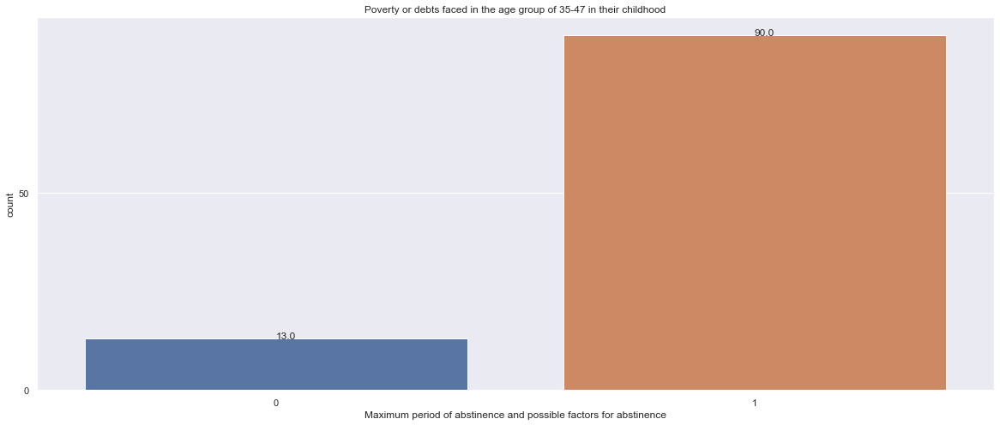

In [2102]:
ax2 = sns.countplot(data = critical_data,x = 'Maximum period of abstinence and possible factors for abstinence')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.4, p.get_height()+0.01))
ax2.set(title = 'Poverty or debts faced in the age group of 35-47 in their childhood')
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 5)

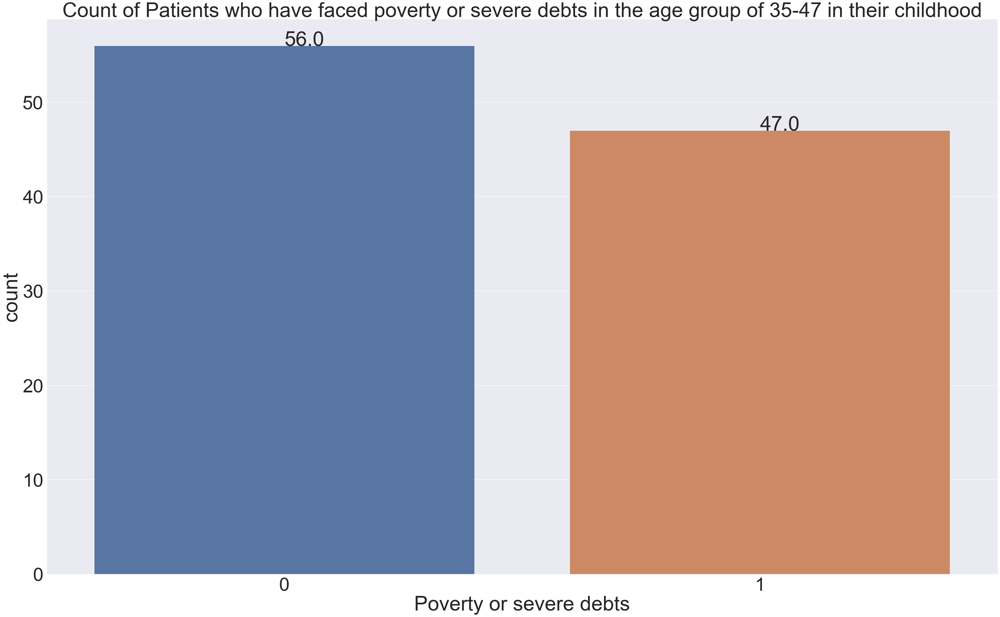

In [2103]:
ax2 = sns.countplot(data = critical_data,x = 'Poverty or severe debts')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.4, p.get_height()+0.01))
ax2.set(title = 'Count of Patients who have faced poverty or severe debts in the age group of 35-47 in their childhood')
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 5)

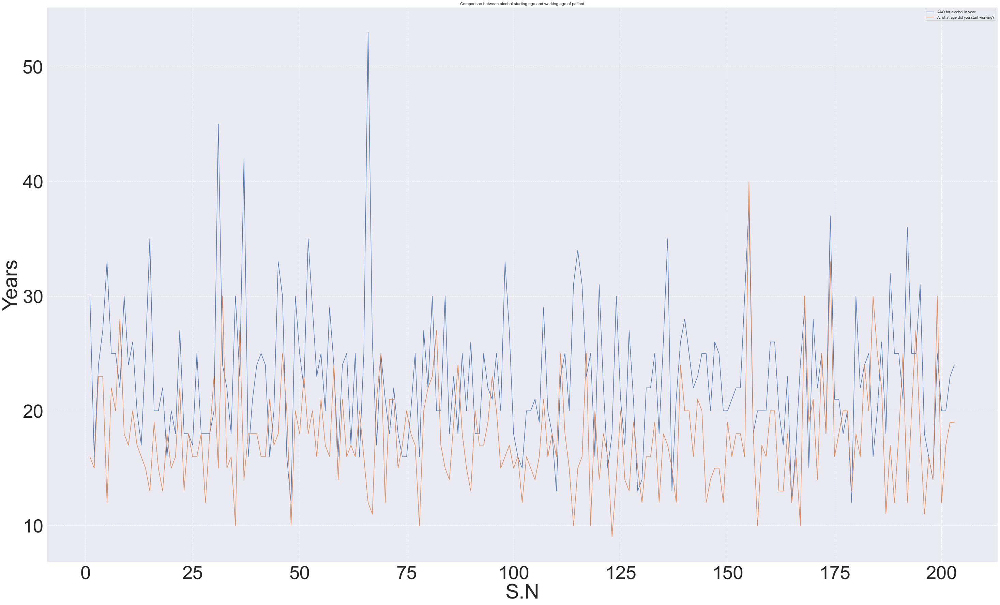

In [2104]:
fig, ax = plt.subplots()
sns.set(rc = {'figure.figsize':(20,8)})
data_copy1.plot(x = 'S.N', y = 'AAO for alcohol in year', ax = ax) 
data_copy1.plot(x = 'S.N', y = 'At what age did you start working?', ax = ax)
plt.title('Comparison between alcohol starting age and working age of patient')
plt.ylabel('Years')
plt.grid(True, linewidth= 1, linestyle="--")

In [2105]:
df = temp2.melt(value_vars=temp2.columns)
df

,variable,value
0,Early Parental loss,0
1,Early Parental loss,0
2,Early Parental loss,0
3,Early Parental loss,0
4,Early Parental loss,0
5,Early Parental loss,0
6,Early Parental loss,0
7,Early Parental loss,0
8,Early Parental loss,0
9,Early Parental loss,0


[Text(0.5, 1.0, 'Count of Withdrawal symptoms faced by patients')]

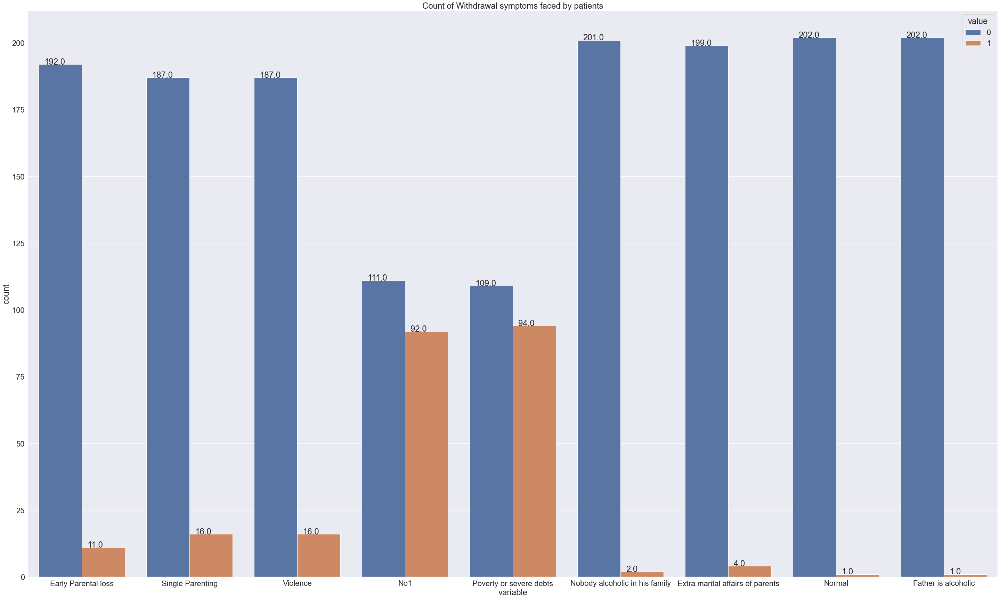

In [2106]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 2)
ax2 = sns.countplot(data = df,x = "variable",hue = "value")
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
ax2.set(title = 'Count of Withdrawal symptoms faced by patients')

In [2107]:
data_copy1.columns

Index(['S.N', 'Age', 'Annual Income', 'Marital Status',
       'AAO for alcohol in year', 'duration of use of alcohol',
       'duration of excessive use of alcohol',
       'avarage units used in last 30days', 'Last drink_Date',
       'Assessment Date',
       ...
       'BCA_alcohol', 'BCA_destruction of others property',
       'BCA_scholastic backwardness', 'BCA_breaking articles at home',
       'BCA_frequently physical fights and violence', 'BCA_gambling',
       'BCA_broken home or single parenting', 'BCA_experimenting with drugs',
       'BCA_poverty or severe debts', 'BCA_stealing'],
      dtype='object', length=151)

In [2108]:
data_copy1[data_copy1['Period of Sober Group'] == '0-15'].describe()

,S.N,Age,Annual Income,Marital Status,AAO for alcohol in year,duration of use of alcohol,duration of excessive use of alcohol,avarage units used in last 30days,quantity of last drink,Nicotine (yes/NO),smoking/smokeless,Weight while admission (In Kg),Weight while discharge (In Kg),Height(In Ft),Medical Problem experienced(Past ),Medical Problem experienced(Present),"History of previous head injureies, if any","Family history of alcoholism / drug abuse, if any (who and which type of drug)",Education Level,Period of Treatment1,abv_risk,RSA_someone in family or friends were using,RSA_to feel better and confident or happy,RSA_to avoid problems and sadness,RSA_heavy cold in his working place,RSA_other reasons,RSA_to try,RSA_other reason-accident,RSA_friends were using,RSA_happiness,RSA_friendship issues,RSA_work related stress,RSA_other,RSA_wife problem,RSA_function,RSA_weak minded & weak personality,Stress_work related stress,Stress_family or relationship issues,Stress_financial stress,Stress_others,Stress_absent,Stress_reports stressed but doesn't know where or what,Stress_love problem,Stress_lonelyness,Stress_gave confidence,Stress_felt relaxed and reduced physical exertion,Stress_mental pressure,DSP_Mild,DSP_Moderate,DSP_Severe,MF_Ambivalent,MF_Mild,MF_Moderate,MF_Severe,Aches and pains,Anxiety,Auditory hallucinations or illusions,Fits,Insomnia,Nausea,Palpitation,Restlessness,Sweating,Transient visual or tactile,Tremors,Weakness,No,Withdrawal Stage,CHP_pancreatitis problem,CHP_no,CHP_diabetes,CHP_liver disorder,CHP_respiratory problem,CHP_chronic bronchitis,CHP_bronchial asthma,CHP_infections,CHP_epilepsy,CHP_b.p,CHP_dust allergy,CHP_aggressive outbursts,CHP_gastric,CHP_skin problems,CHP_pulmonary t.b,PCP_seizure during withdrawal,PCP_confusion,PCP_no,PCP_depression,PCP_aggressive outbursts,PCP_hallucinations,PCP_paranoid ideas,PCP_suicidal ideation or attempts,PCP_yes,PCP_tension,PCPR_seizure during withdrawal,PCPR_confusion,PCPR_no,PCPR_depression,PCPR_aggressive outbursts,PCPR_hallucinations,PCPR_paranoid ideas,PCPR_suicidal ideation or attempts,PCPR_tension,Number of relapses (based on treatment year),Year of Treatment (First time),Year of Treatment (Second time),Year of Treatment (Third time),Number of relapses (based on period of treatment),Period of Treatment2,Period of Treatment3,Number of relapses (based on period of sober),Period of Sober1,Period of Sober2,Period of Sober3,Sugar(mg),Critical Period of Sober,Number of year of marriage,any instance of family violence,At what age did you start working?,How long have you been working?,Occupational damage,year of Education,Maximum period of abstinence and possible factors for abstinence,Early Parental loss,Single Parenting,Violence,No1,Poverty or severe debts,Nobody alcoholic in his family,Extra marital affairs of parents,Normal,Father is alcoholic,BCA_none,BCA_running away from home,BCA_alcohol,BCA_destruction of others property,BCA_scholastic backwardness,BCA_breaking articles at home,BCA_frequently physical fights and violence,BCA_gambling,BCA_broken home or single parenting,BCA_experimenting with drugs,BCA_poverty or severe debts,BCA_stealing
count,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.0,32.0,32.0,32.000000,32.0,32.000000,32.0,32.0,32.0,32.0,32.0,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.0,32.0,32.0,32.0,32.0,32.000000,32.000000,32.000000,32.0,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.0,32.000000,32.000000,32.0,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.0,32.0,32.0,32.0,32.000000,32.0,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.0,32.0,32.000000,32.000000,32.0000

In [2109]:
descriptive = pd.DataFrame(data_copy1[data_copy1['Period of Sober Group'] == '0-15'].describe())
descriptive.to_excel('descriptive.xlsx')

In [2110]:
sober = data_copy1["Critical Period of Sober"]
percentile = np.percentile(sober,50,)
print(percentile) # median

248.0


In [2111]:
# sns.set(font_scale=2.4)
# sns.heatmap(data_copy1.corr(),cmap = 'coolwarm',annot = True)
# #res.set_xticklabels(res.get_xmajorticklabels(), fontsize = 25)
# #res.set_yticklabels(res.get_ymajorticklabels(), fontsize = 25)
# sns.set(rc = {'figure.figsize':(50,25)})

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober group')]

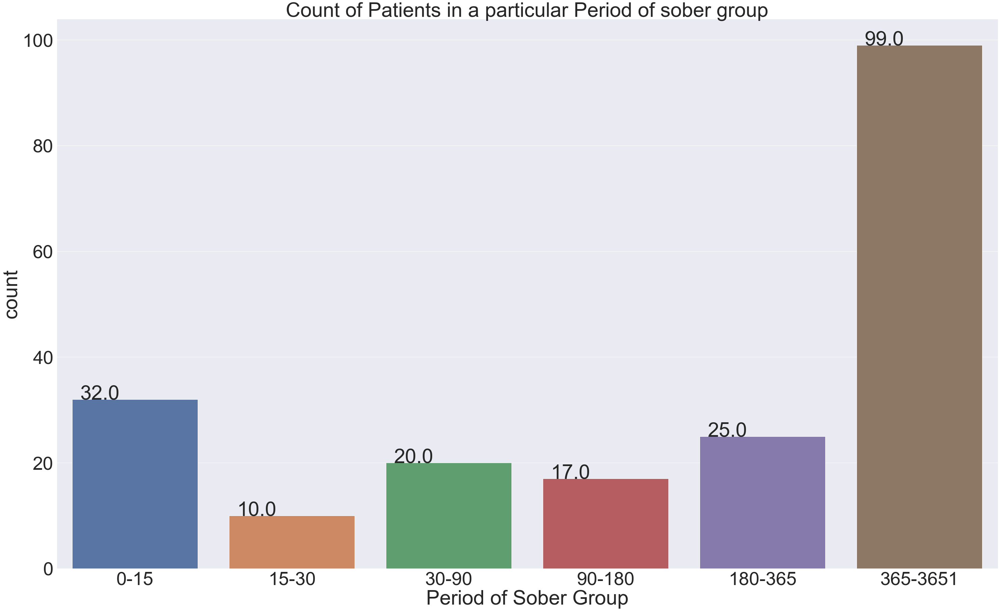

In [2112]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 5)
ax2 = sns.countplot(data = data_copy1,x = 'Period of Sober Group')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober group')

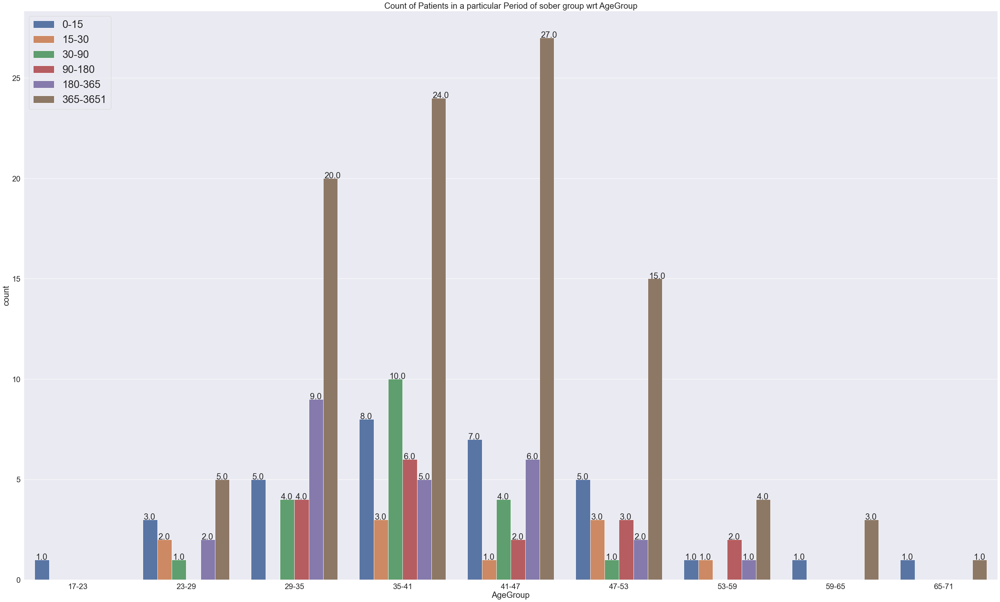

In [2113]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 2)
ax2 = sns.countplot(data = data_copy1,x = 'AgeGroup',hue = 'Period of Sober Group', )
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober group wrt AgeGroup')
plt.legend(loc = 'upper left',fontsize = 30)

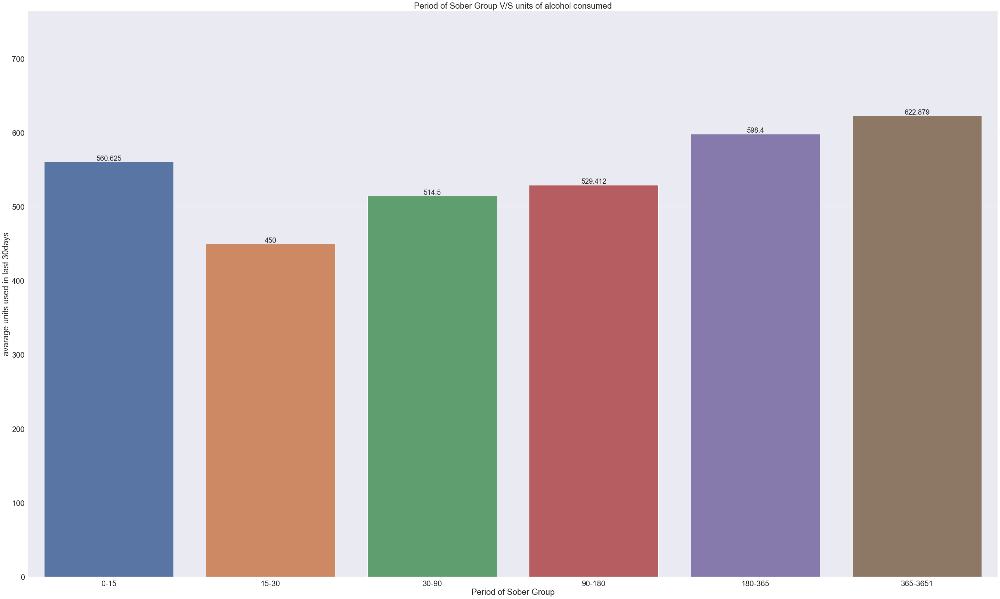

In [2114]:
ax = sns.barplot(x = 'Period of Sober Group',y = 'avarage units used in last 30days', errwidth=0,data = data_copy1)
ax.bar_label(ax.containers[0],size = 20)
ax.set(title = 'Period of Sober Group V/S units of alcohol consumed')
sns.set(rc = {'figure.figsize':(20,8)})

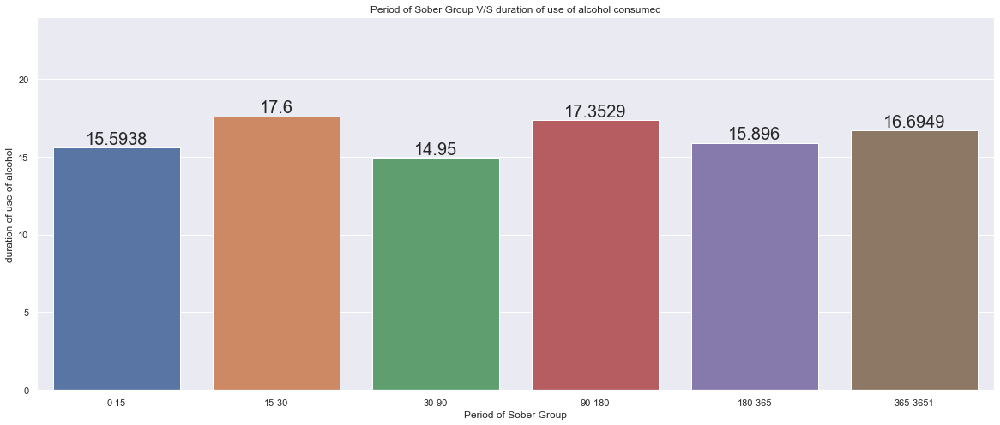

In [2115]:
ax = sns.barplot(x = 'Period of Sober Group',y = 'duration of use of alcohol', errwidth=0,data = data_copy1)
ax.bar_label(ax.containers[0],size = 20)
ax.set(title = 'Period of Sober Group V/S duration of use of alcohol consumed')
sns.set(rc = {'figure.figsize':(20,8)})

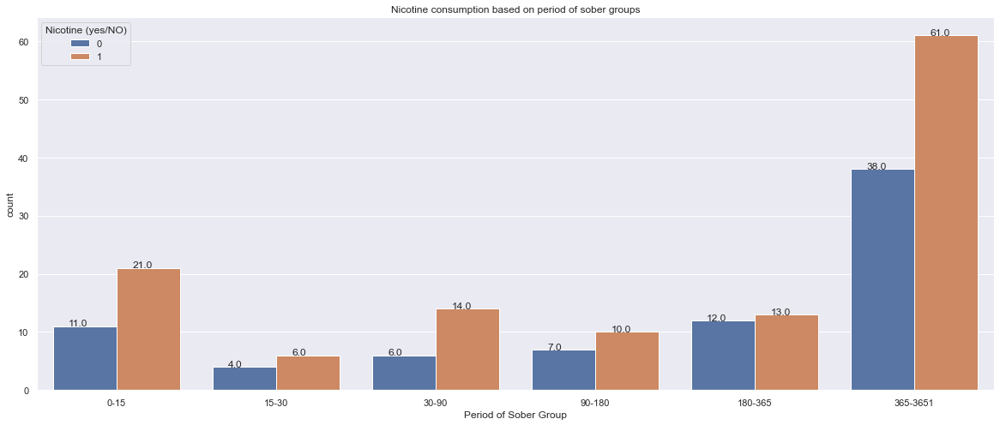

In [2116]:
ax2 = sns.countplot(data=data_copy1, x="Period of Sober Group", hue="Nicotine (yes/NO)")
ax2.set(title = 'Nicotine consumption based on period of sober groups')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.1, p.get_height()+0.01))
sns.set(rc = {'figure.figsize':(20,8)})

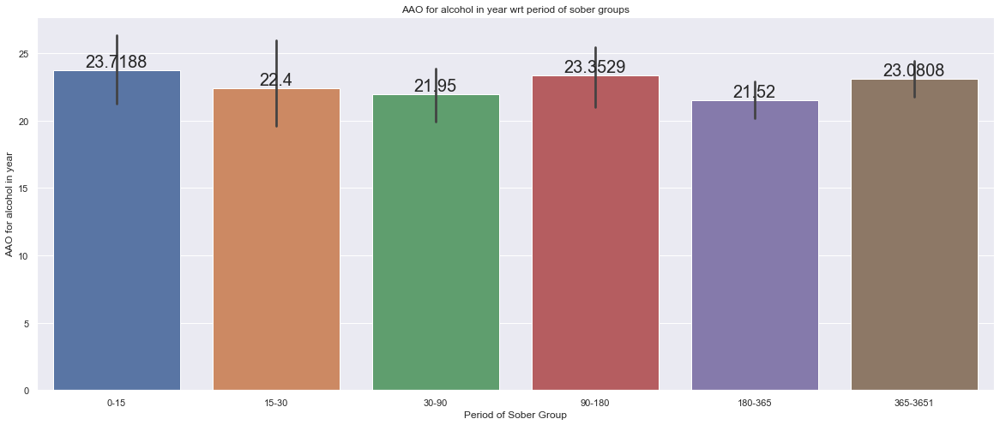

In [2117]:
ax1 = sns.barplot(x = 'Period of Sober Group',y = 'AAO for alcohol in year', data = data_copy1)
ax1.bar_label(ax1.containers[0],size = 20)
ax1.set(title = 'AAO for alcohol in year wrt period of sober groups')
sns.set(rc = {'figure.figsize':(20,8)})

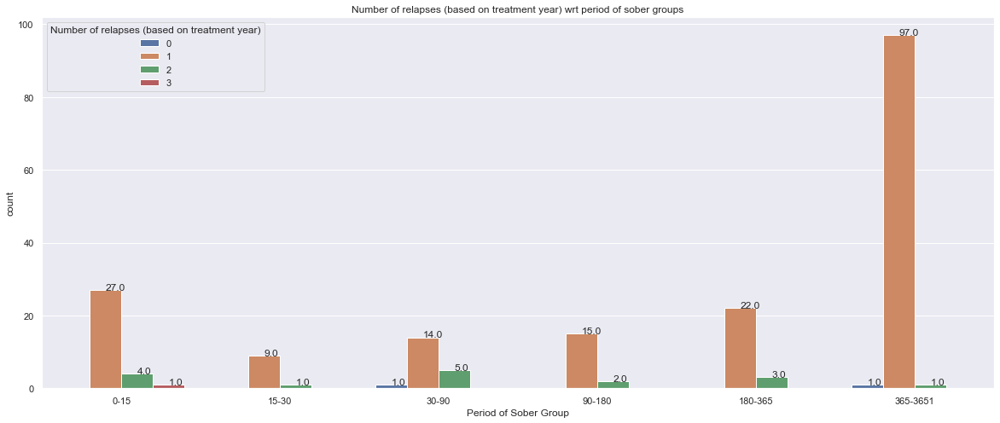

In [2118]:
ax2 = sns.countplot(data = data_copy1,x = 'Period of Sober Group',hue = 'Number of relapses (based on treatment year)')
ax2.set(title = 'Number of relapses (based on treatment year) wrt period of sober groups')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.1, p.get_height()+0.01))
sns.set(rc = {'figure.figsize':(20,8)})

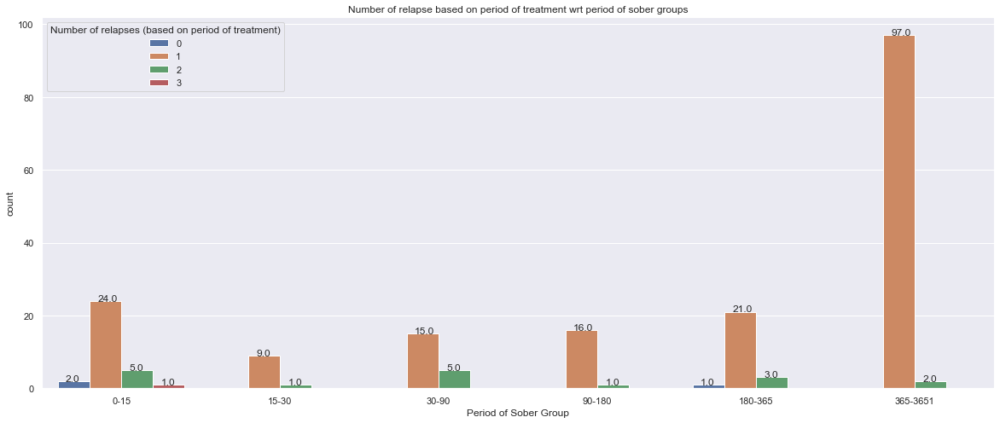

In [2119]:
ax2 = sns.countplot(x = 'Period of Sober Group',hue = 'Number of relapses (based on period of treatment)', data = data_copy1)
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
ax2.set(title = 'Number of relapse based on period of treatment wrt period of sober groups')
sns.set(rc = {'figure.figsize':(20,8)})

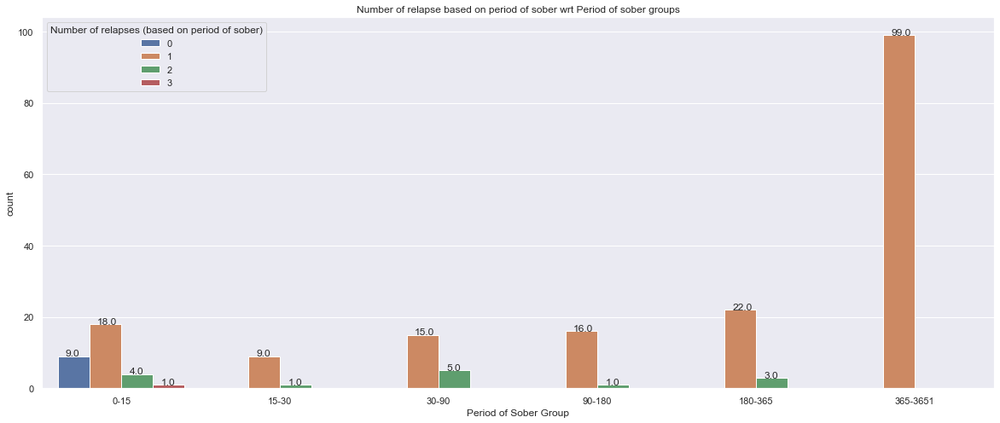

In [2120]:
ax2 = sns.countplot(x = 'Period of Sober Group',hue = 'Number of relapses (based on period of sober)', data = data_copy1)
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
ax2.set(title = 'Number of relapse based on period of sober wrt Period of sober groups')
sns.set(rc = {'figure.figsize':(20,8)})

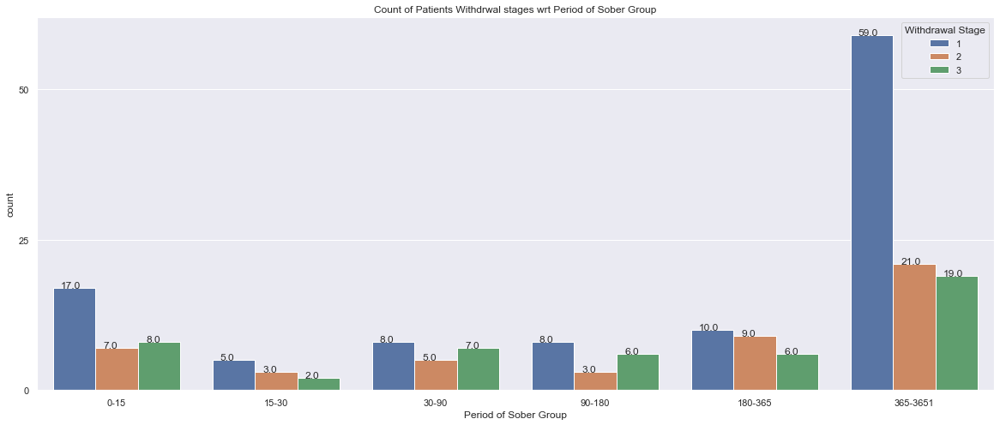

In [2121]:
ax2 = sns.countplot(data = data_copy1,x = 'Period of Sober Group', hue = 'Withdrawal Stage')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
ax2.set(title = 'Count of Patients Withdrwal stages wrt Period of Sober Group')
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 5)

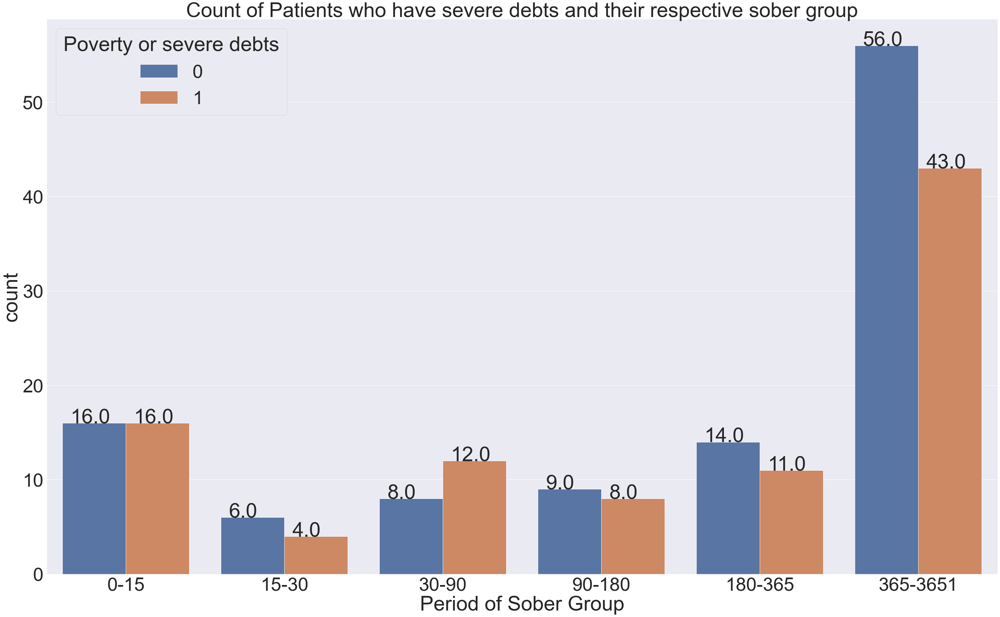

In [2122]:
ax2 = sns.countplot(data = data_copy1,x = 'Period of Sober Group', hue = 'Poverty or severe debts')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
ax2.set(title = 'Count of Patients who have severe debts and their respective sober group')
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 5)

In [2123]:
data = data_copy1[data_copy1['Period of Sober Group'] == '0-15']
data = data.select_dtypes(include='number')

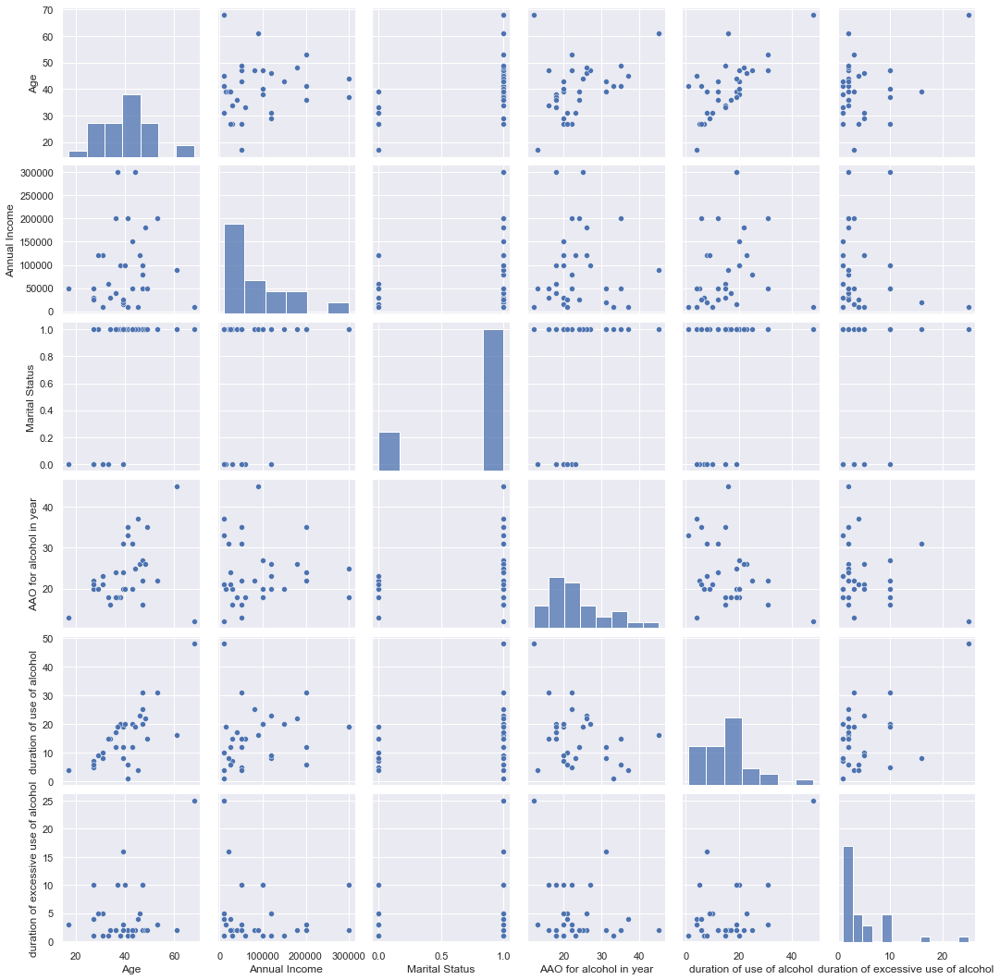

In [2124]:
sns.set(rc = {'figure.figsize':(20,8)},font_scale = 1)
sns.pairplot(data = data.iloc[:,1:7])

In [2125]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
print(data_copy1.columns.tolist())

['S.N', 'Age', 'Annual Income', 'Marital Status', 'AAO for alcohol in year', 'duration of use of alcohol', 'duration of excessive use of alcohol', 'avarage units used in last 30days', 'Last drink_Date', 'Assessment Date', 'quantity of last drink', 'Nicotine (yes/NO)', 'smoking/smokeless', 'Last Use', 'Weight while admission (In Kg)', 'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)', 'Medical Problem experienced(Past )', 'Medical Problem experienced(Present)', 'History of previous head injureies, if any', 'Family history of alcoholism / drug abuse, if any (who and which type of drug)', 'Education Level', 'Period of Treatment1', 'abv_risk', 'Risk Level', 'RSA_someone in family or friends were using', 'RSA_to feel better and confident or happy', 'RSA_to avoid problems and sadness', 'RSA_heavy cold in his working place', 'RSA_other reasons', 'RSA_to try', 'RSA_other reason-accident', 'RSA_friends were using', 'RSA_happiness', 'RSA_friendship issues', 'RSA_work related stress'

[Text(0.5, 1.0, 'Count of Patients who have relapsed')]

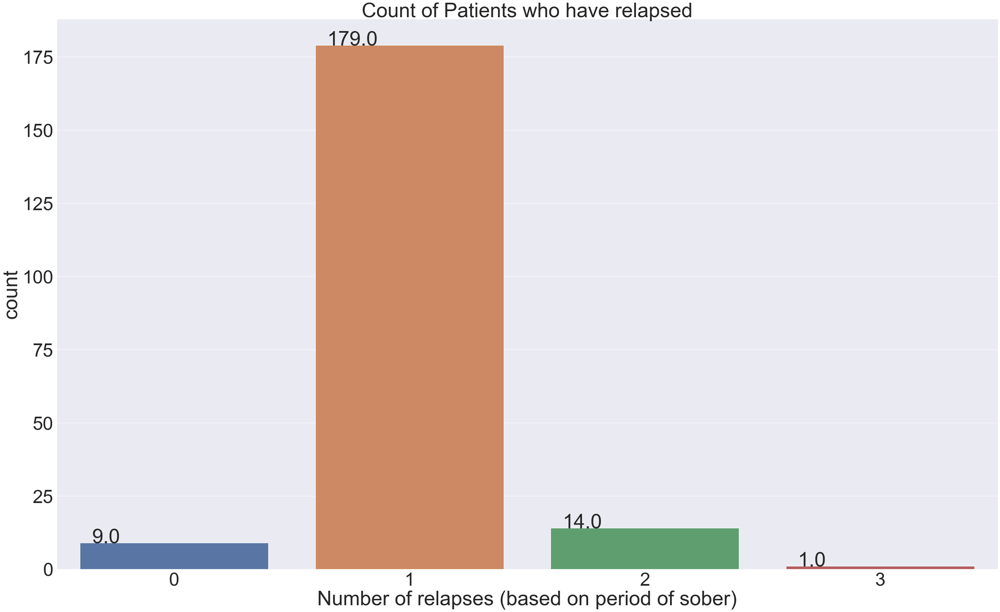

In [2126]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 5)
ax2 = sns.countplot(data = data_copy1,x = 'Number of relapses (based on period of sober)')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
ax2.set(title = 'Count of Patients who have relapsed')

In [2127]:
critical_data = data_copy1[data_copy1['Number of relapses (based on period of sober)'] == 1]
critical_data

,S.N,Age,Annual Income,Marital Status,AAO for alcohol in year,duration of use of alcohol,duration of excessive use of alcohol,avarage units used in last 30days,Last drink_Date,Assessment Date,quantity of last drink,Nicotine (yes/NO),smoking/smokeless,Last Use,Weight while admission (In Kg),Weight while discharge (In Kg),Height(In Ft),Sugar(mg),Medical Problem experienced(Past ),Medical Problem experienced(Present),"History of previous head injureies, if any","Family history of alcoholism / drug abuse, if any (who and which type of drug)",Education Level,Period of Treatment1,abv_risk,Risk Level,RSA_someone in family or friends were using,RSA_to feel better and confident or happy,RSA_to avoid problems and sadness,RSA_heavy cold in his working place,RSA_other reasons,RSA_to try,RSA_other reason-accident,RSA_friends were using,RSA_happiness,RSA_friendship issues,RSA_work related stress,RSA_other,RSA_wife problem,RSA_function,RSA_weak minded & weak personality,Stress_work related stress,Stress_family or relationship issues,Stress_financial stress,Stress_others,Stress_absent,Stress_reports stressed but doesn't know where or what,Stress_love problem,Stress_lonelyness,Stress_gave confidence,Stress_felt relaxed and reduced physical exertion,Stress_mental pressure,DSP_Mild,DSP_Moderate,DSP_Severe,MF_Ambivalent,MF_Mild,MF_Moderate,MF_Severe,Aches and pains,Anxiety,Auditory hallucinations or illusions,Fits,Insomnia,Nausea,Palpitation,Restlessness,Sweating,Transient visual or tactile,Tremors,Weakness,No,Withdrawal Stage,CHP_pancreatitis problem,CHP_no,CHP_diabetes,CHP_liver disorder,CHP_respiratory problem,CHP_chronic bronchitis,CHP_bronchial asthma,CHP_infections,CHP_epilepsy,CHP_b.p,CHP_dust allergy,CHP_aggressive outbursts,CHP_gastric,CHP_skin problems,CHP_pulmonary t.b,PCP_seizure during withdrawal,PCP_confusion,PCP_no,PCP_depression,PCP_aggressive outbursts,PCP_hallucinations,PCP_paranoid ideas,PCP_suicidal ideation or attempts,PCP_yes,PCP_tension,PCPR_seizure during withdrawal,PCPR_confusion,PCPR_no,PCPR_depression,PCPR_aggressive outbursts,PCPR_hallucinations,PCPR_paranoid ideas,PCPR_suicidal ideation or attempts,PCPR_tension,Number of relapses (based on treatment year),Year of Treatment (First time),Year of Treatment (Second time),Year of Treatment (Third time),Number of relapses (based on period of treatment),Period of Treatment2,Period of Treatment3,Number of relapses (based on period of sober),Period of Sober1,Period of Sober2,Period of Sober3,Sugar(mg),AgeGroup,Critical Period of Sober,Period of Sober Group,Number of year of marriage,any instance of family violence,At what age did you start working?,How long have you been working?,Occupational damage,year of Education,Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent,Maximum period of abstinence and possible factors for abstinence,Early Parental loss,Single Parenting,Violence,No1,Poverty or severe debts,Nobody alcoholic in his family,Extra marital affairs of parents,Normal,Father is alcoholic,BCA_none,BCA_running away from home,BCA_alcohol,BCA_destruction of others property,BCA_scholastic backwardness,BCA_breaking articles at home,BCA_frequently physical fights and violence,BCA_gambling,BCA_broken home or single parenting,BCA_experimenting with drugs,BCA_poverty or severe debts,BCA_stealing
0,1,48,15000.0,1,30,17.0,0.166667,360,2021-01-30,2021-01-02,180,1,1,2021-01-31,48,52.0,5.50,0,1,1,0,0,3,8,122.13720,4,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,1,0,0,3,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,2018,0,0,1,0,0,1,93,10000,10000,0,47-53,93,90-180,13,0,16,32.0,0,9,1,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
1,2,31,80000.0,1,16,15.0,3.000000,540,2021-01-01,2021-01-02,180,1,1,2021-01-31,47,50.0,5.30,0,1,0,0,0,3,4,183.20580,4,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0

In [2128]:
critical_data.drop(['Last drink_Date','Assessment Date','Last Use','Number of relapses (based on treatment year)','Year of Treatment (Second time)','Year of Treatment (Third time)','Number of relapses (based on period of treatment)','Period of Treatment2','Period of Treatment3','Number of relapses (based on period of sober)','Period of Sober2','Period of Sober3'],axis = 1,inplace = True)

In [2129]:
critical_data.shape

(179, 139)

In [2130]:
critical_data.head()

,S.N,Age,Annual Income,Marital Status,AAO for alcohol in year,duration of use of alcohol,duration of excessive use of alcohol,avarage units used in last 30days,quantity of last drink,Nicotine (yes/NO),smoking/smokeless,Weight while admission (In Kg),Weight while discharge (In Kg),Height(In Ft),Sugar(mg),Medical Problem experienced(Past ),Medical Problem experienced(Present),"History of previous head injureies, if any","Family history of alcoholism / drug abuse, if any (who and which type of drug)",Education Level,Period of Treatment1,abv_risk,Risk Level,RSA_someone in family or friends were using,RSA_to feel better and confident or happy,RSA_to avoid problems and sadness,RSA_heavy cold in his working place,RSA_other reasons,RSA_to try,RSA_other reason-accident,RSA_friends were using,RSA_happiness,RSA_friendship issues,RSA_work related stress,RSA_other,RSA_wife problem,RSA_function,RSA_weak minded & weak personality,Stress_work related stress,Stress_family or relationship issues,Stress_financial stress,Stress_others,Stress_absent,Stress_reports stressed but doesn't know where or what,Stress_love problem,Stress_lonelyness,Stress_gave confidence,Stress_felt relaxed and reduced physical exertion,Stress_mental pressure,DSP_Mild,DSP_Moderate,DSP_Severe,MF_Ambivalent,MF_Mild,MF_Moderate,MF_Severe,Aches and pains,Anxiety,Auditory hallucinations or illusions,Fits,Insomnia,Nausea,Palpitation,Restlessness,Sweating,Transient visual or tactile,Tremors,Weakness,No,Withdrawal Stage,CHP_pancreatitis problem,CHP_no,CHP_diabetes,CHP_liver disorder,CHP_respiratory problem,CHP_chronic bronchitis,CHP_bronchial asthma,CHP_infections,CHP_epilepsy,CHP_b.p,CHP_dust allergy,CHP_aggressive outbursts,CHP_gastric,CHP_skin problems,CHP_pulmonary t.b,PCP_seizure during withdrawal,PCP_confusion,PCP_no,PCP_depression,PCP_aggressive outbursts,PCP_hallucinations,PCP_paranoid ideas,PCP_suicidal ideation or attempts,PCP_yes,PCP_tension,PCPR_seizure during withdrawal,PCPR_confusion,PCPR_no,PCPR_depression,PCPR_aggressive outbursts,PCPR_hallucinations,PCPR_paranoid ideas,PCPR_suicidal ideation or attempts,PCPR_tension,Year of Treatment (First time),Period of Sober1,Sugar(mg),AgeGroup,Critical Period of Sober,Period of Sober Group,Number of year of marriage,any instance of family violence,At what age did you start working?,How long have you been working?,Occupational damage,year of Education,Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent,Maximum period of abstinence and possible factors for abstinence,Early Parental loss,Single Parenting,Violence,No1,Poverty or severe debts,Nobody alcoholic in his family,Extra marital affairs of parents,Normal,Father is alcoholic,BCA_none,BCA_running away from home,BCA_alcohol,BCA_destruction of others property,BCA_scholastic backwardness,BCA_breaking articles at home,BCA_frequently physical fights and violence,BCA_gambling,BCA_broken home or single parenting,BCA_experimenting with drugs,BCA_poverty or severe debts,BCA_stealing
0,1,48,15000.0,1,30,17.0,0.166667,360,180,1,1,48,52.0,5.5,0,1,1,0,0,3,8,122.13720,4,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,1,0,0,3,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,2018,93,0,47-53,93,90-180,13,0,16,32.0,0,9,1,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
1,2,31,80000.0,1,16,15.0,3.000000,540,180,1,1,47,50.0,5.3,0,1,0,0,0,3,4,183.20580,4,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,2020,32,0,29-35,32,30-90,6,0,15,16.0,0,9,1,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
2,3,34,60000.0,0,24,10.0,3.000000,540,180,1,1,45,47.0,5.6,0,1,1,0,0,4,8,183.20580,4,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,2018,375,0,29-35,375,365-3651,13,0,23,11.0,0,13,2,1,0,0,0,0,1,0,0,0,0,0,1,1,0

In [2131]:
test_data = critical_data.drop(['Period of Sober1','Period of Sober Group','AgeGroup'],axis = 1)

In [2132]:
test_data

,S.N,Age,Annual Income,Marital Status,AAO for alcohol in year,duration of use of alcohol,duration of excessive use of alcohol,avarage units used in last 30days,quantity of last drink,Nicotine (yes/NO),smoking/smokeless,Weight while admission (In Kg),Weight while discharge (In Kg),Height(In Ft),Sugar(mg),Medical Problem experienced(Past ),Medical Problem experienced(Present),"History of previous head injureies, if any","Family history of alcoholism / drug abuse, if any (who and which type of drug)",Education Level,Period of Treatment1,abv_risk,Risk Level,RSA_someone in family or friends were using,RSA_to feel better and confident or happy,RSA_to avoid problems and sadness,RSA_heavy cold in his working place,RSA_other reasons,RSA_to try,RSA_other reason-accident,RSA_friends were using,RSA_happiness,RSA_friendship issues,RSA_work related stress,RSA_other,RSA_wife problem,RSA_function,RSA_weak minded & weak personality,Stress_work related stress,Stress_family or relationship issues,Stress_financial stress,Stress_others,Stress_absent,Stress_reports stressed but doesn't know where or what,Stress_love problem,Stress_lonelyness,Stress_gave confidence,Stress_felt relaxed and reduced physical exertion,Stress_mental pressure,DSP_Mild,DSP_Moderate,DSP_Severe,MF_Ambivalent,MF_Mild,MF_Moderate,MF_Severe,Aches and pains,Anxiety,Auditory hallucinations or illusions,Fits,Insomnia,Nausea,Palpitation,Restlessness,Sweating,Transient visual or tactile,Tremors,Weakness,No,Withdrawal Stage,CHP_pancreatitis problem,CHP_no,CHP_diabetes,CHP_liver disorder,CHP_respiratory problem,CHP_chronic bronchitis,CHP_bronchial asthma,CHP_infections,CHP_epilepsy,CHP_b.p,CHP_dust allergy,CHP_aggressive outbursts,CHP_gastric,CHP_skin problems,CHP_pulmonary t.b,PCP_seizure during withdrawal,PCP_confusion,PCP_no,PCP_depression,PCP_aggressive outbursts,PCP_hallucinations,PCP_paranoid ideas,PCP_suicidal ideation or attempts,PCP_yes,PCP_tension,PCPR_seizure during withdrawal,PCPR_confusion,PCPR_no,PCPR_depression,PCPR_aggressive outbursts,PCPR_hallucinations,PCPR_paranoid ideas,PCPR_suicidal ideation or attempts,PCPR_tension,Year of Treatment (First time),Sugar(mg),Critical Period of Sober,Number of year of marriage,any instance of family violence,At what age did you start working?,How long have you been working?,Occupational damage,year of Education,Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent,Maximum period of abstinence and possible factors for abstinence,Early Parental loss,Single Parenting,Violence,No1,Poverty or severe debts,Nobody alcoholic in his family,Extra marital affairs of parents,Normal,Father is alcoholic,BCA_none,BCA_running away from home,BCA_alcohol,BCA_destruction of others property,BCA_scholastic backwardness,BCA_breaking articles at home,BCA_frequently physical fights and violence,BCA_gambling,BCA_broken home or single parenting,BCA_experimenting with drugs,BCA_poverty or severe debts,BCA_stealing
0,1,48,15000.0,1,30,17.0,0.166667,360,180,1,1,48,52.0,5.50,0,1,1,0,0,3,8,122.13720,4,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,1,0,0,3,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,2018,0,93,13,0,16,32.0,0,9,1,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
1,2,31,80000.0,1,16,15.0,3.000000,540,180,1,1,47,50.0,5.30,0,1,0,0,0,3,4,183.20580,4,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,2020,0,32,6,0,15,16.0,0,9,1,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
2,3,34,60000.0,0,24,10.0,3.000000,540,180,1,1,45,47.0,5.60,0,1,1,0,0,4,8,183.20580,4,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,2018,0,375,13,0,23,11.0,0,13,2,1,0,0,0,0,1,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0
3,4,35,75000.0,1,27,8.0,2.000000,270,360,0,1,75,75.0,5.90,0,0,0,0,1,4,8,101.18

In [2133]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
X = test_data.iloc[:,1:]  #independent columns   
y = critical_data["Period of Sober1"]   #target column

#apply SelectKBest class to extract top 10 best features
bestfeatures = SelectKBest(score_func=chi2, k=20)
fit = bestfeatures.fit(X,y)
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)
#concat two dataframes for better visualization 
featureScores = pd.concat([dfcolumns,dfscores],axis=1)
featureScores.columns = ['Specs','Score']  #naming the dataframe columns
print(featureScores.nlargest(30,'Score'))
features = featureScores.nlargest(30,'Score')
features.to_excel('feature.xlsx')

                                    Specs         Score
1                           Annual Income  7.328258e+06
105              Critical Period of Sober  1.924737e+05
19                   Period of Treatment1  6.357789e+04
6       avarage units used in last 30days  6.608901e+03
7                  quantity of last drink  5.761552e+03
20                               abv_risk  1.357443e+03
103        Year of Treatment (First time)  4.820481e+02
4              duration of use of alcohol  1.910649e+02
128         BCA_breaking articles at home  1.780000e+02
109       How long have you been working?  1.468842e+02
106            Number of year of marriage  1.306066e+02
5    duration of excessive use of alcohol  1.295516e+02
81                            CHP_gastric  1.227917e+02
10         Weight while admission (In Kg)  1.153478e+02
11         Weight while discharge (In Kg)  1.119704e+02
83                      CHP_pulmonary t.b  9.563636e+01
111                     year of Education  9.290

[1.87618251e-02 1.81723788e-02 8.87697286e-03 1.91948432e-02
 1.84675122e-02 1.81311904e-02 1.51413839e-02 1.77641599e-02
 1.46672633e-02 1.43929860e-02 2.18212731e-02 1.91672470e-02
 1.68951454e-02 4.64228421e-03 1.11465603e-02 1.10192225e-02
 6.39345748e-03 1.19130024e-02 1.90814979e-02 1.36419280e-02
 1.72509364e-02 7.44220563e-03 1.10395365e-02 1.00148442e-02
 6.01444571e-03 4.81373978e-04 3.44794899e-04 5.41264307e-04
 4.60098329e-05 7.09531581e-03 4.05621181e-04 1.70705975e-04
 2.59074651e-04 7.44048820e-04 5.74021171e-04 9.90997975e-04
 1.64865864e-03 7.97315497e-03 1.20741121e-02 9.53610890e-03
 3.90322814e-03 9.28835883e-03 5.63612022e-03 0.00000000e+00
 3.65285691e-04 1.24923667e-04 0.00000000e+00 5.39820910e-04
 9.39679281e-03 1.00607429e-02 3.54490463e-03 6.08015104e-04
 1.17291971e-02 9.40522425e-03 6.54537747e-03 4.53398363e-03
 1.17056126e-02 6.79787887e-03 1.75960748e-03 1.08297141e-02
 7.01975803e-03 5.86658774e-03 1.00404783e-02 1.10868881e-02
 6.58173130e-03 1.659116

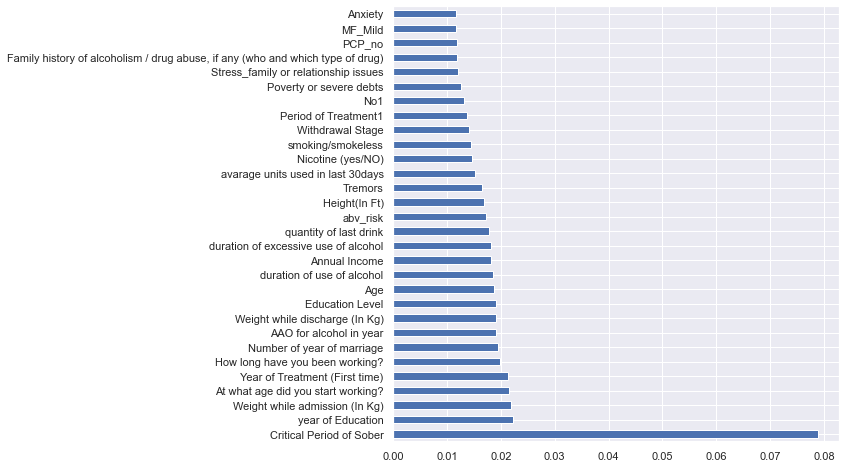

In [2134]:
sns.set(rc = {'figure.figsize':(8,8)},font_scale = 1)
X = test_data.iloc[:,1:]  #independent columns   
y = critical_data["Period of Sober1"]   #target column
from sklearn.ensemble import ExtraTreesClassifier
import matplotlib.pyplot as plt
model = ExtraTreesClassifier()
model.fit(X,y)
print(model.feature_importances_) #use inbuilt class feature_importances of tree based classifiers
#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(30).plot(kind='barh')
plt.show()

In [2135]:
cols = list(test_data.columns)

x= test_data[cols]
critical_data['Numeric Sober Group'] = 0
for i in critical_data.index:
    if critical_data['Period of Sober Group'][i] == '0-15':
        critical_data['Numeric Sober Group'][i] = 0
    elif critical_data['Period of Sober Group'][i] == '15-30':
        critical_data['Numeric Sober Group'][i] = 1
    elif critical_data['Period of Sober Group'][i] == '30-90':
        critical_data['Numeric Sober Group'][i] = 2
    elif critical_data['Period of Sober Group'][i] == '90-180':
        critical_data['Numeric Sober Group'][i] = 3
    elif critical_data['Period of Sober Group'][i] == '180-365':
        critical_data['Numeric Sober Group'][i] = 4
    else:
        critical_data['Numeric Sober Group'][i] = 5
critical_data['Numeric Sober Group'].value_counts()
y = critical_data['Period of Sober1']

In [2136]:
from sklearn.model_selection import train_test_split  
x_train, x_test, y_train, y_test= train_test_split(x, y, test_size= 1/3, random_state=0)  

In [2137]:
#RECURSIVE FEATURE ELIMINATION
#Feature ranking with recursive feature elimination and cross-validated selection of the best number of features

from sklearn.feature_selection import RFE
from sklearn.feature_selection import RFECV
from sklearn.linear_model import LinearRegression 
X = x_train
y = y_train
names=pd.DataFrame(x_train.columns)

#use linear regression as the model
lin_reg = LinearRegression()

#This is to select 5 variables: can be changed and checked in model for accuracy
rfe_mod = RFE(lin_reg, step=1) #RFECV(lin_reg, step=1, cv=5) 
myvalues=rfe_mod.fit(X,y) #to fit
myvalues.support_#The mask of selected features.
myvalues.ranking_ #The feature ranking, such that ranking_[i] corresponds to the ranking position of the i-th feature. Selected (i.e., estimated best) features are assigned rank 1.

rankings=pd.DataFrame(myvalues.ranking_) #Make it into data frame
rankings

,0
0,47
1,39
2,52
3,1
4,41
5,44
6,34
7,51
8,53
9,1


In [2138]:
#Concat and name columns
ranked=pd.concat([names,rankings], axis=1)
ranked.columns = ["Feature", "Rank"]
ranked

#Select most important (Only 1's)
most_important = ranked.loc[ranked['Rank'] <= 5]
print(most_important)

most_important['Rank'].count()

                                               Feature  Rank
3                                       Marital Status     1
9                                    Nicotine (yes/NO)     1
13                                       Height(In Ft)     1
16                Medical Problem experienced(Present)     1
17          History of previous head injureies, if any     1
22                                          Risk Level     1
24           RSA_to feel better and confident or happy     1
26                 RSA_heavy cold in his working place     1
27                                   RSA_other reasons     1
28                                          RSA_to try     1
31                                       RSA_happiness     1
32                               RSA_friendship issues     1
34                                           RSA_other     1
35                                    RSA_wife problem     1
38                          Stress_work related stress     1
39                Stress

72

In [2139]:
ranked

,Feature,Rank
0,S.N,47
1,Age,39
2,Annual Income,52
3,Marital Status,1
4,AAO for alcohol in year,41
5,duration of use of alcohol,44
6,duration of excessive use of alcohol,34
7,avarage units used in last 30days,51
8,quantity of last drink,53
9,Nicotine (yes/NO),1


In [2140]:
most_important['Rank'].count()

72

In [2141]:
rank = pd.DataFrame(most_important)
rank

,Feature,Rank
3,Marital Status,1
9,Nicotine (yes/NO),1
13,Height(In Ft),1
16,Medical Problem experienced(Present),1
17,"History of previous head injureies, if any",1
22,Risk Level,1
24,RSA_to feel better and confident or happy,1
26,RSA_heavy cold in his working place,1
27,RSA_other reasons,1
28,RSA_to try,1


In [2142]:
temp = rank.sort_values(by = 'Rank')
temp.to_excel('rank.xlsx')

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober group who have relapsed once')]

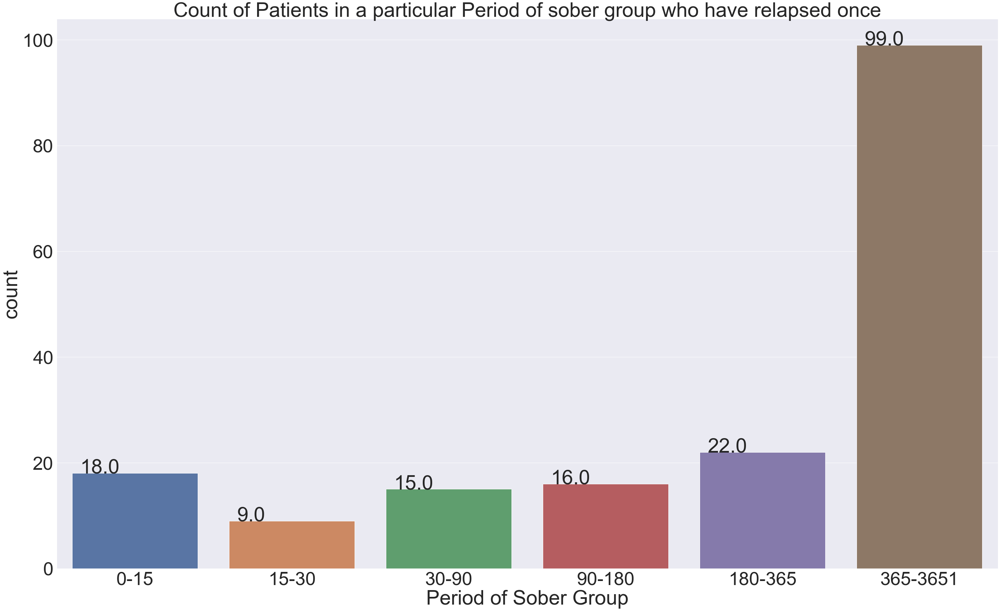

In [2143]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 5)
ax2 = sns.countplot(data = critical_data,x = 'Period of Sober Group')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober group who have relapsed once')

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober group with their appropriate withdrawal stage')]

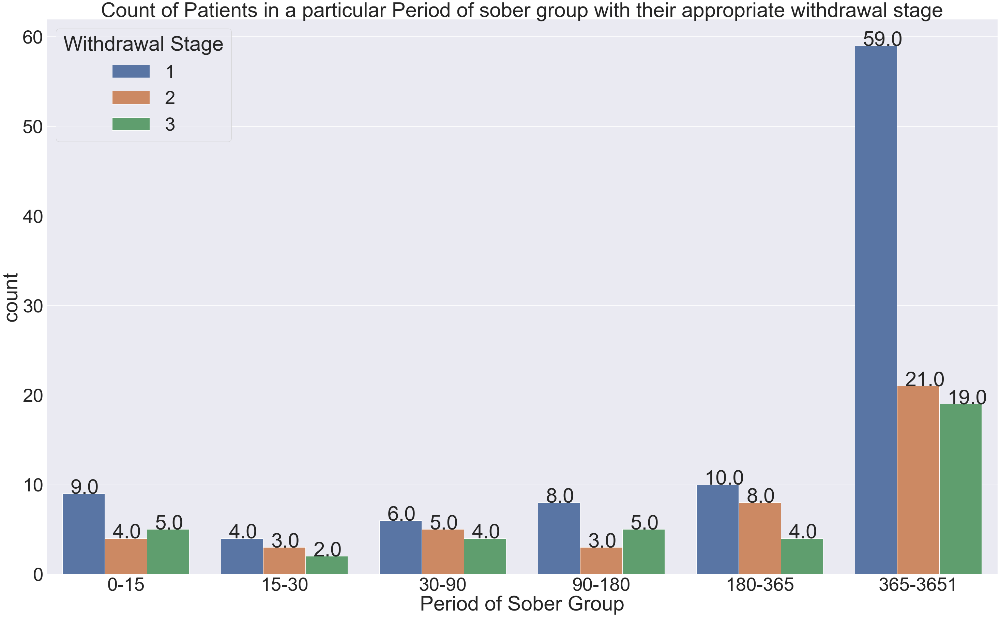

In [2144]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 5)
ax2 = sns.countplot(data = critical_data,x = 'Period of Sober Group',hue = 'Withdrawal Stage')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober group with their appropriate withdrawal stage')

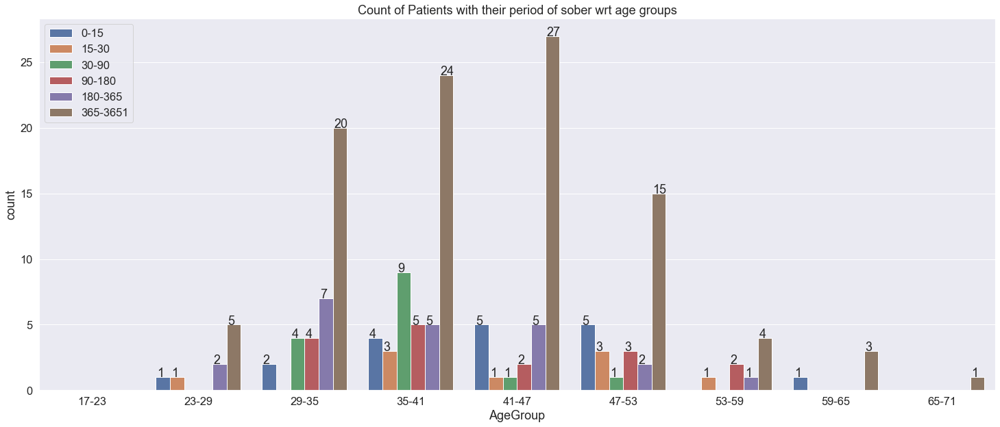

In [2145]:
sns.set(rc = {'figure.figsize':(25,10)},font_scale = 1.5)
ax2 = sns.countplot(data = critical_data,x = 'AgeGroup',hue = 'Period of Sober Group')
for p in ax2.patches:
   ax2.annotate('{:.0f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients with their period of sober wrt age groups')
plt.legend(loc='upper left')

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober who have started consuming alcohol because of their family or friends')]

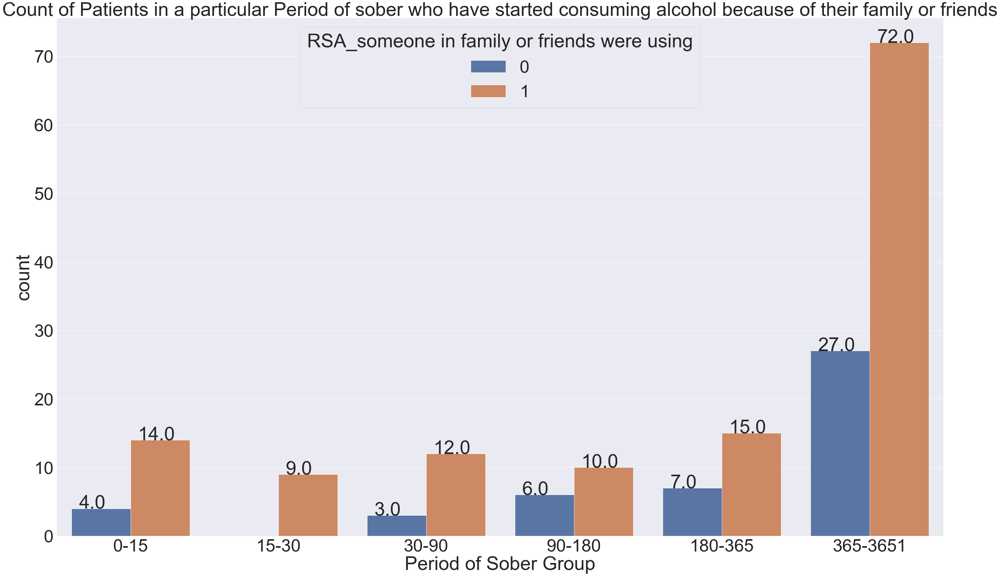

In [2146]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 5)
ax2 = sns.countplot(data = critical_data,x = 'Period of Sober Group',hue = 'RSA_someone in family or friends were using')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober who have started consuming alcohol because of their family or friends')

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober who have experienced poverty and severe debts in their childhood')]

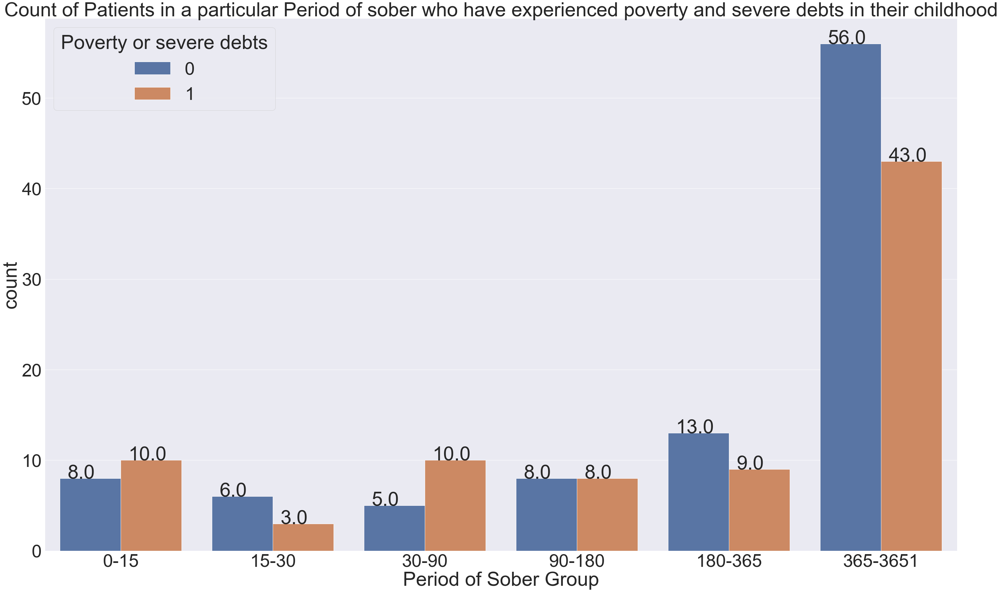

In [2147]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 5)
ax2 = sns.countplot(data = critical_data,x = 'Period of Sober Group',hue = 'Poverty or severe debts')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober who have experienced poverty and severe debts in their childhood')

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober and their educational level')]

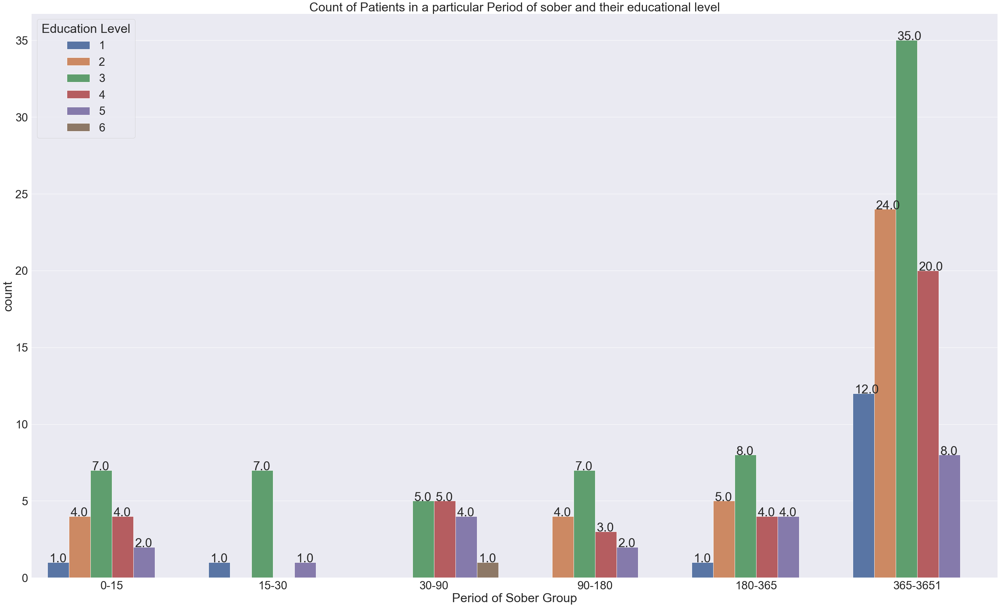

In [2148]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_data,x = 'Period of Sober Group',hue = 'Education Level')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober and their educational level')

  Using cached wordcloud-1.8.1.tar.gz (220 kB)
  Running setup.py clean for wordcloud
Failed to build wordcloud
    Running setup.py install for wordcloud: started
    Running setup.py install for wordcloud: finished with status 'error'
Note: you may need to restart the kernel to use updated packages.


  ERROR: Command errored out with exit status 1:
   command: 'C:\Users\acer\anaconda3\python.exe' -u -c 'import io, os, sys, setuptools, tokenize; sys.argv[0] = '"'"'C:\\Users\\acer\\AppData\\Local\\Temp\\pip-install-rayu944i\\wordcloud_dd1c75ddfb034e0f8fc69fa93c06e2b8\\setup.py'"'"'; __file__='"'"'C:\\Users\\acer\\AppData\\Local\\Temp\\pip-install-rayu944i\\wordcloud_dd1c75ddfb034e0f8fc69fa93c06e2b8\\setup.py'"'"';f = getattr(tokenize, '"'"'open'"'"', open)(__file__) if os.path.exists(__file__) else io.StringIO('"'"'from setuptools import setup; setup()'"'"');code = f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' bdist_wheel -d 'C:\Users\acer\AppData\Local\Temp\pip-wheel-j71x584u'
       cwd: C:\Users\acer\AppData\Local\Temp\pip-install-rayu944i\wordcloud_dd1c75ddfb034e0f8fc69fa93c06e2b8\
  Complete output (20 lines):
  running bdist_wheel
  running build
  running build_py
  creating build
  creating build\lib.win-amd64-3.9
  cr

[Text(0, 0, '1109.07'),
 Text(0, 0, '1015.14'),
 Text(0, 0, '792.406'),
 Text(0, 0, '633.944'),
 Text(0, 0, '613.286'),
 Text(0, 0, '49')]

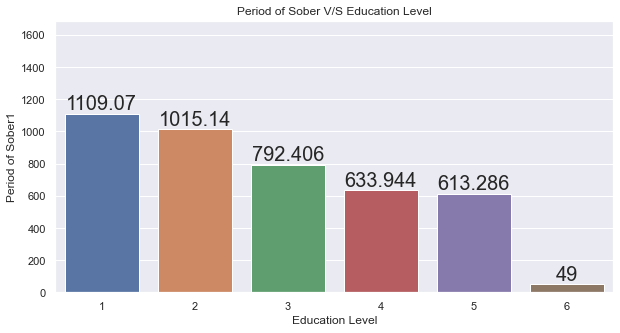

In [2149]:
sns.set(rc = {'figure.figsize':(10,5)})
ax = sns.barplot(x = 'Education Level',y = 'Period of Sober1',errwidth=0,data = critical_data)
ax.set(title = 'Period of Sober V/S Education Level')
ax.bar_label(ax.containers[0],size = 20)

[Text(0, 0, '515'),
 Text(0, 0, '460'),
 Text(0, 0, '494'),
 Text(0, 0, '528.75'),
 Text(0, 0, '610.455'),
 Text(0, 0, '622.879')]

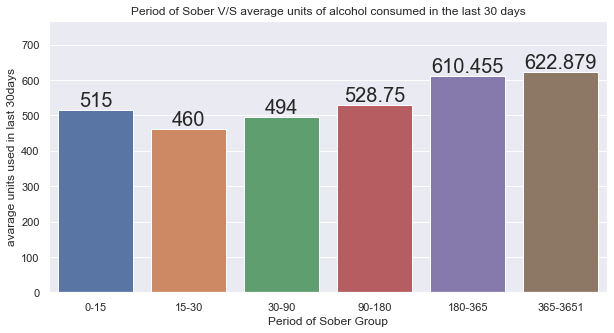

In [2150]:
sns.set(rc = {'figure.figsize':(10,5)})
ax = sns.barplot(x = 'Period of Sober Group',y = 'avarage units used in last 30days',errwidth=0,data = critical_data)
ax.set(title = 'Period of Sober V/S average units of alcohol consumed in the last 30 days')
ax.bar_label(ax.containers[0],size = 20)

[Text(0, 0, '14.2778'),
 Text(0, 0, '18.6667'),
 Text(0, 0, '13.5333'),
 Text(0, 0, '17.6875'),
 Text(0, 0, '15.9727'),
 Text(0, 0, '16.6949')]

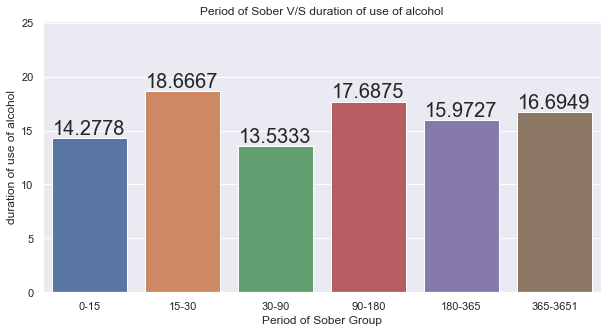

In [2151]:
sns.set(rc = {'figure.figsize':(10,5)})
ax = sns.barplot(x = 'Period of Sober Group',y = 'duration of use of alcohol',errwidth=0,data = critical_data)
ax.set(title = 'Period of Sober V/S duration of use of alcohol')
ax.bar_label(ax.containers[0],size = 20)

[Text(0, 0, '4.44444'),
 Text(0, 0, '4.88889'),
 Text(0, 0, '4.1'),
 Text(0, 0, '4.82812'),
 Text(0, 0, '4.96212'),
 Text(0, 0, '4.31026')]

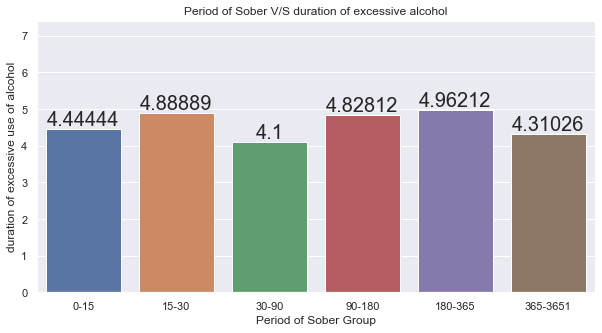

In [2152]:
sns.set(rc = {'figure.figsize':(10,5)})
ax = sns.barplot(x = 'Period of Sober Group',y = 'duration of excessive use of alcohol',errwidth=0,data = critical_data)
ax.set(title = 'Period of Sober V/S duration of excessive alcohol')
ax.bar_label(ax.containers[0],size = 20)

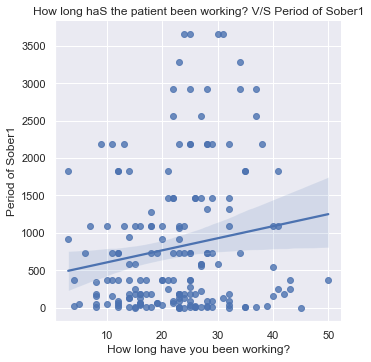

In [2153]:
sns.set(rc = {'figure.figsize':(30,20)})
ax = sns.lmplot(x="How long have you been working?", y="Period of Sober1", data=critical_data);
ax.set(title = 'How long haS the patient been working? V/S Period of Sober1')

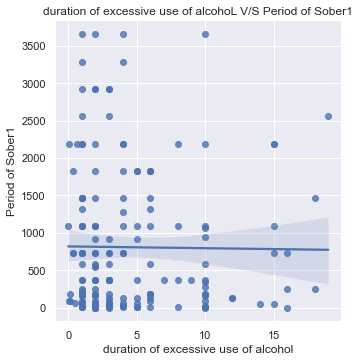

In [2154]:
sns.set(rc = {'figure.figsize':(30,20)})
ax = sns.lmplot(x="duration of excessive use of alcohol", y="Period of Sober1", data=critical_data);
ax.set(title = 'duration of excessive use of alcohoL V/S Period of Sober1')

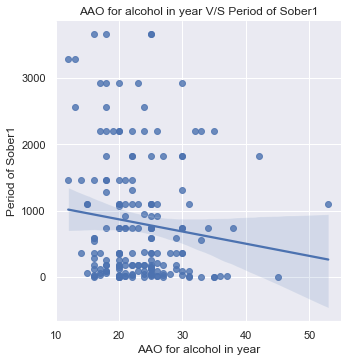

In [2155]:
sns.set(rc = {'figure.figsize':(30,20)})
ax = sns.lmplot(x="AAO for alcohol in year", y="Period of Sober1", data=critical_data);
ax.set(title = 'AAO for alcohol in year V/S Period of Sober1')

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober and whether they consume nicotine or not')]

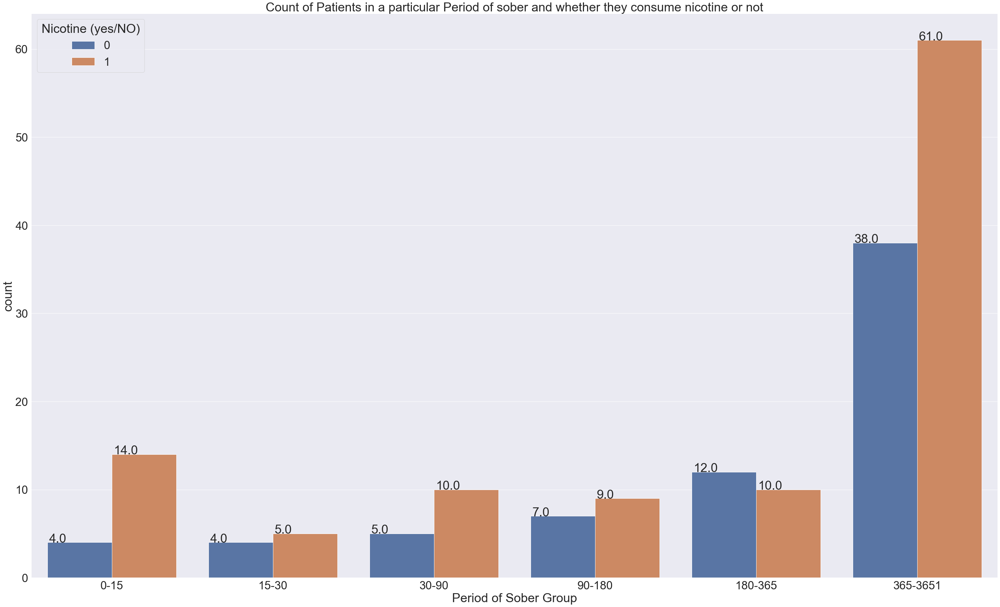

In [2156]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_data,x = 'Period of Sober Group',hue = 'Nicotine (yes/NO)')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober and whether they consume nicotine or not')

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober and whether they smoke or not')]

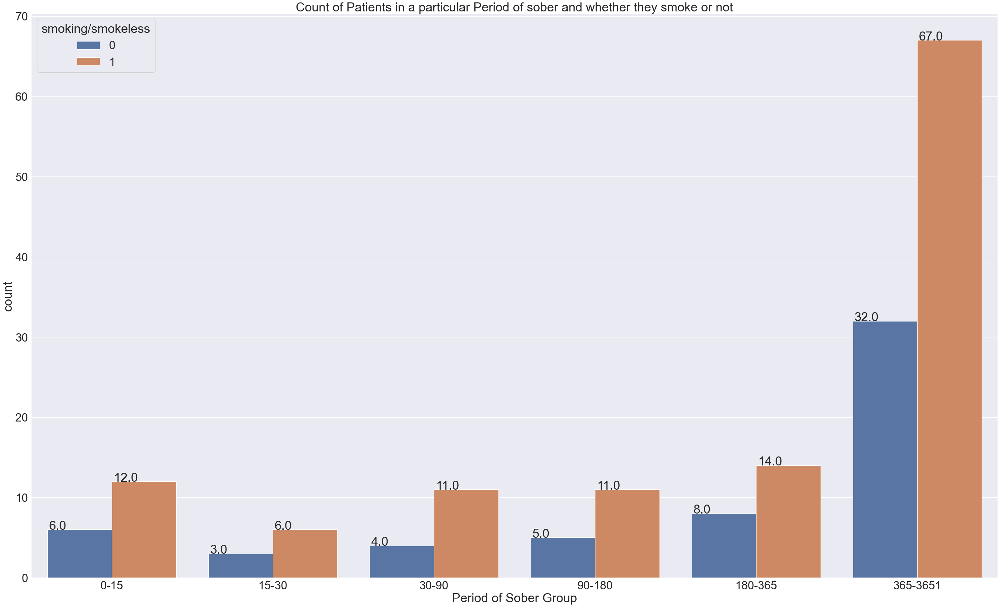

In [2157]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_data,x = 'Period of Sober Group',hue = 'smoking/smokeless')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober and whether they smoke or not')

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober and their medical problems experienced in the past')]

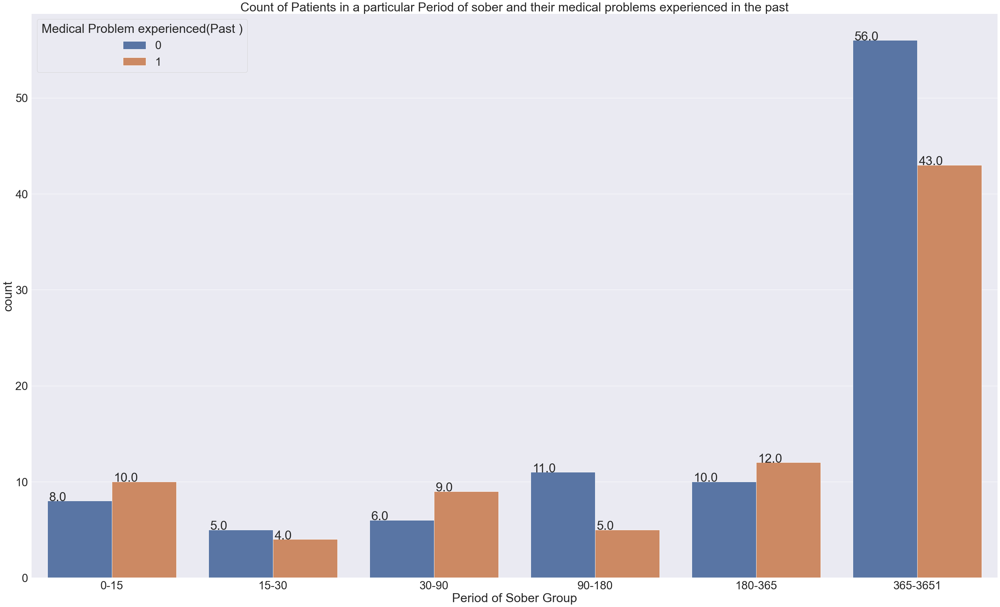

In [2158]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_data,x = 'Period of Sober Group',hue = 'Medical Problem experienced(Past )')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober and their medical problems experienced in the past')

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober and their stressors of family or relationship issues')]

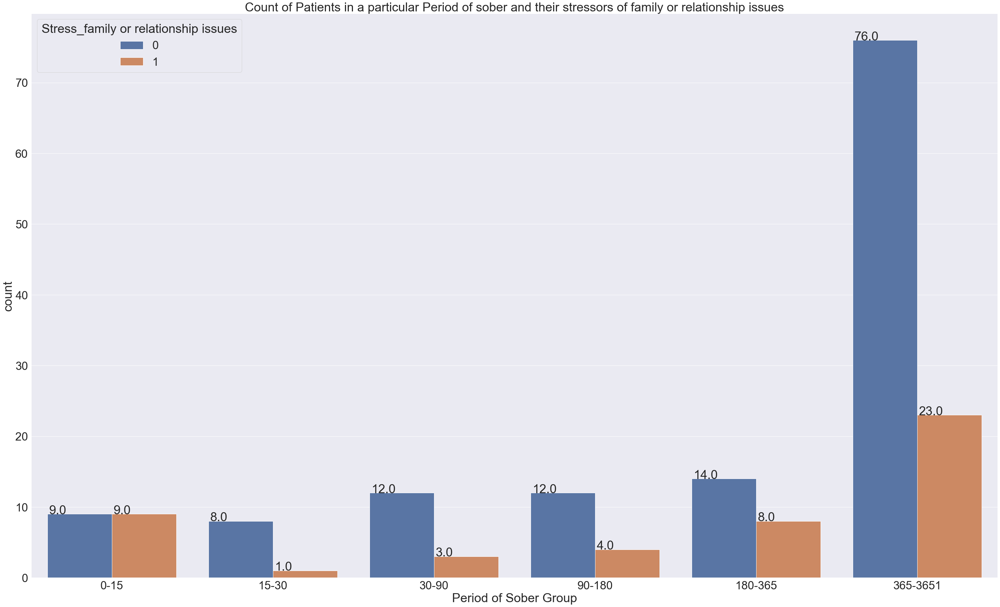

In [2159]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_data,x = 'Period of Sober Group',hue = 'Stress_family or relationship issues')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober and their stressors of family or relationship issues')

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober and their denial of substance use of moderate level')]

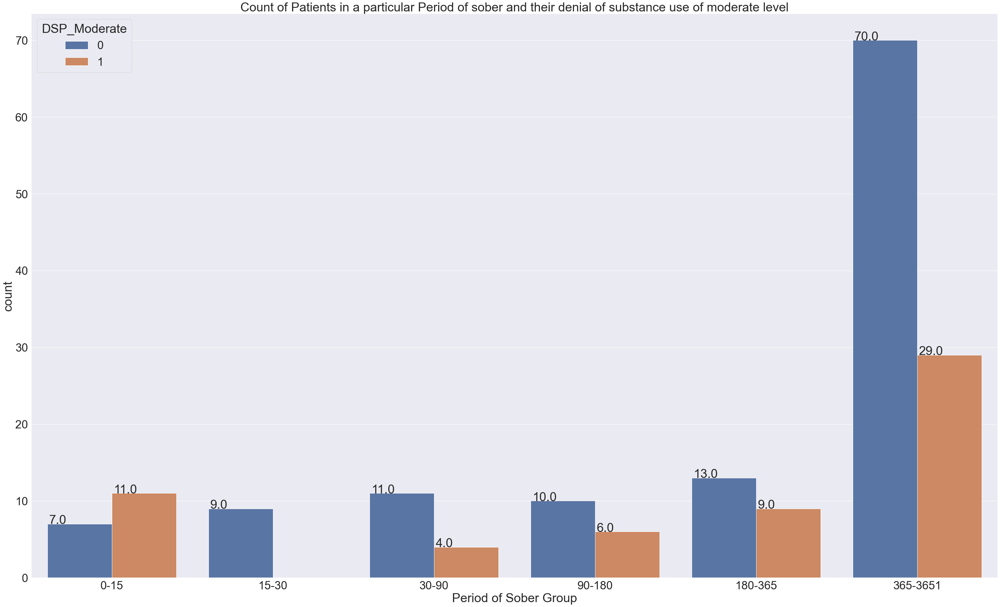

In [2160]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_data,x = 'Period of Sober Group',hue = 'DSP_Moderate')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober and their denial of substance use of moderate level')

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober and their motivation factor count at moderate level')]

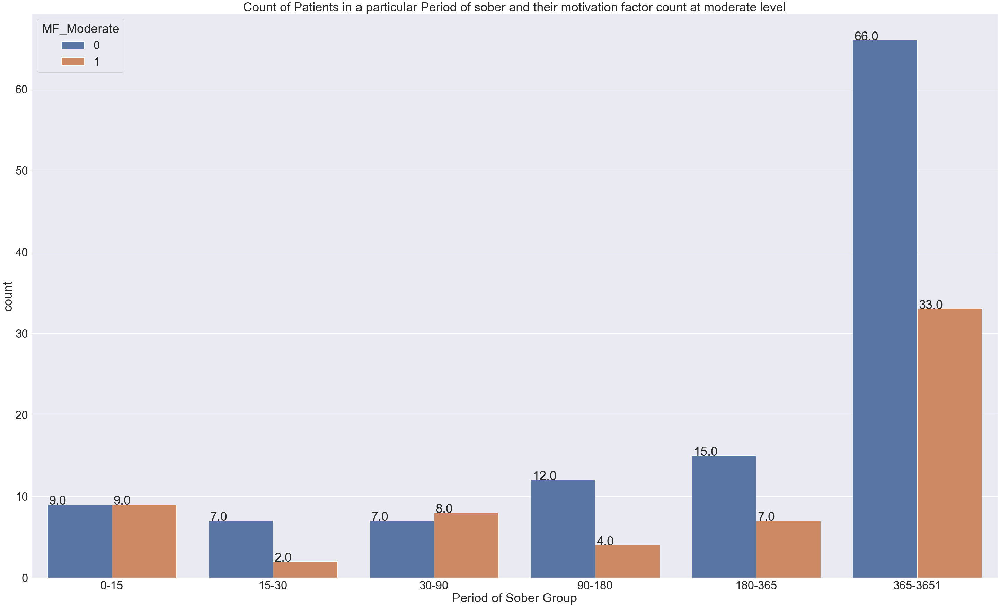

In [2161]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_data,x = 'Period of Sober Group',hue = 'MF_Moderate')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober and their motivation factor count at moderate level')

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober and count of impact of the camps on their abstinence')]

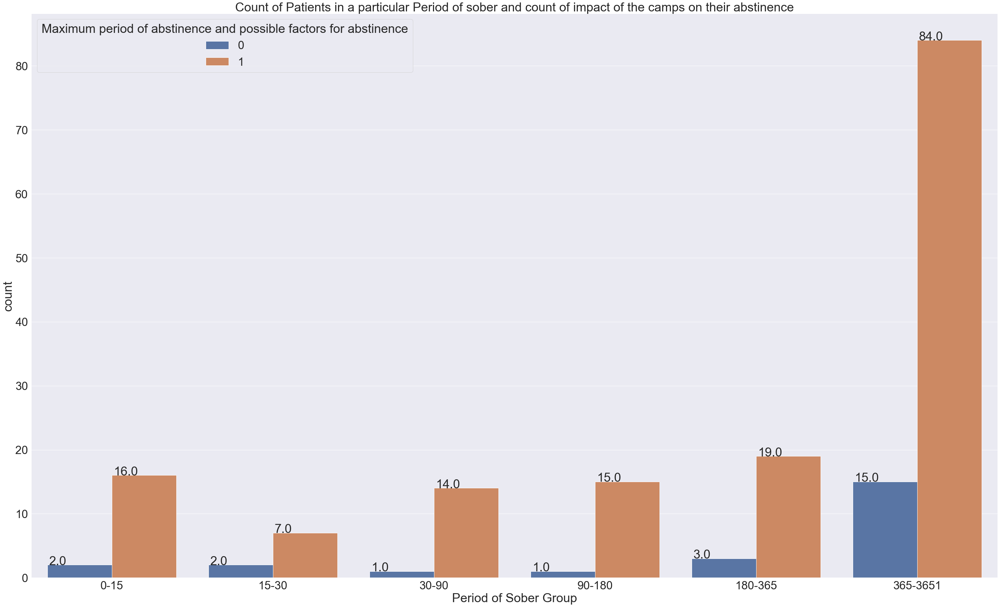

In [2162]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_data,x = 'Period of Sober Group',hue = 'Maximum period of abstinence and possible factors for abstinence')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober and count of impact of the camps on their abstinence')

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober and their Behaviour in Childhood of stealing')]

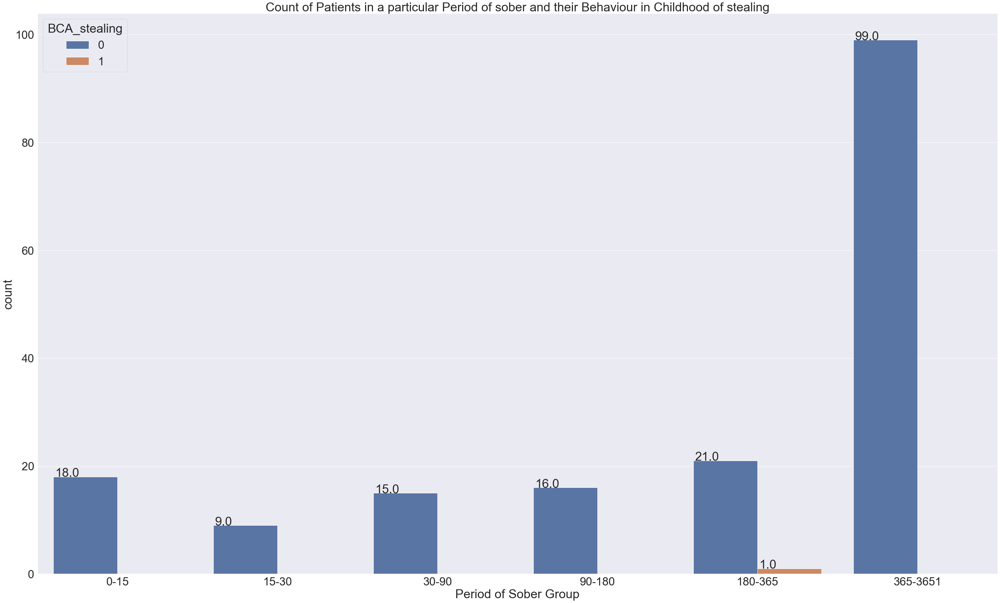

In [2163]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_data,x = 'Period of Sober Group',hue = 'BCA_stealing')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober and their Behaviour in Childhood of stealing')

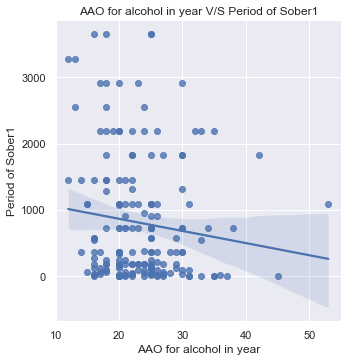

In [2164]:
sns.set(rc = {'figure.figsize':(30,20)})
ax = sns.lmplot(x="AAO for alcohol in year", y="Period of Sober1", data=critical_data);
ax.set(title = 'AAO for alcohol in year V/S Period of Sober1')

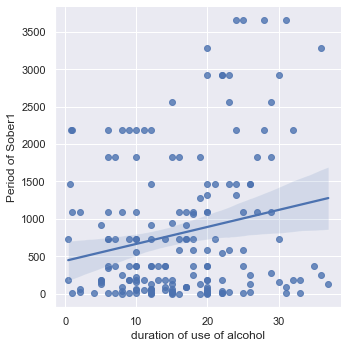

In [2165]:
sns.set(rc = {'figure.figsize':(20,10)})
sns.lmplot(x="duration of use of alcohol", y="Period of Sober1", data=critical_data);

In [2166]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
print(data_copy1.columns.tolist())

['S.N', 'Age', 'Annual Income', 'Marital Status', 'AAO for alcohol in year', 'duration of use of alcohol', 'duration of excessive use of alcohol', 'avarage units used in last 30days', 'Last drink_Date', 'Assessment Date', 'quantity of last drink', 'Nicotine (yes/NO)', 'smoking/smokeless', 'Last Use', 'Weight while admission (In Kg)', 'Weight while discharge (In Kg)', 'Height(In Ft)', 'Sugar(mg)', 'Medical Problem experienced(Past )', 'Medical Problem experienced(Present)', 'History of previous head injureies, if any', 'Family history of alcoholism / drug abuse, if any (who and which type of drug)', 'Education Level', 'Period of Treatment1', 'abv_risk', 'Risk Level', 'RSA_someone in family or friends were using', 'RSA_to feel better and confident or happy', 'RSA_to avoid problems and sadness', 'RSA_heavy cold in his working place', 'RSA_other reasons', 'RSA_to try', 'RSA_other reason-accident', 'RSA_friends were using', 'RSA_happiness', 'RSA_friendship issues', 'RSA_work related stress'

In [2167]:
critical_data2 = data_copy1[data_copy1['Number of relapses (based on period of sober)'] == 2]
critical_data2.drop(['Last drink_Date','Assessment Date','Last Use','Number of relapses (based on treatment year)','Year of Treatment (Third time)','Number of relapses (based on period of treatment)','Period of Treatment3','Number of relapses (based on period of sober)','Period of Sober3'],axis = 1,inplace = True)
critical_data2

,S.N,Age,Annual Income,Marital Status,AAO for alcohol in year,duration of use of alcohol,duration of excessive use of alcohol,avarage units used in last 30days,quantity of last drink,Nicotine (yes/NO),smoking/smokeless,Weight while admission (In Kg),Weight while discharge (In Kg),Height(In Ft),Sugar(mg),Medical Problem experienced(Past ),Medical Problem experienced(Present),"History of previous head injureies, if any","Family history of alcoholism / drug abuse, if any (who and which type of drug)",Education Level,Period of Treatment1,abv_risk,Risk Level,RSA_someone in family or friends were using,RSA_to feel better and confident or happy,RSA_to avoid problems and sadness,RSA_heavy cold in his working place,RSA_other reasons,RSA_to try,RSA_other reason-accident,RSA_friends were using,RSA_happiness,RSA_friendship issues,RSA_work related stress,RSA_other,RSA_wife problem,RSA_function,RSA_weak minded & weak personality,Stress_work related stress,Stress_family or relationship issues,Stress_financial stress,Stress_others,Stress_absent,Stress_reports stressed but doesn't know where or what,Stress_love problem,Stress_lonelyness,Stress_gave confidence,Stress_felt relaxed and reduced physical exertion,Stress_mental pressure,DSP_Mild,DSP_Moderate,DSP_Severe,MF_Ambivalent,MF_Mild,MF_Moderate,MF_Severe,Aches and pains,Anxiety,Auditory hallucinations or illusions,Fits,Insomnia,Nausea,Palpitation,Restlessness,Sweating,Transient visual or tactile,Tremors,Weakness,No,Withdrawal Stage,CHP_pancreatitis problem,CHP_no,CHP_diabetes,CHP_liver disorder,CHP_respiratory problem,CHP_chronic bronchitis,CHP_bronchial asthma,CHP_infections,CHP_epilepsy,CHP_b.p,CHP_dust allergy,CHP_aggressive outbursts,CHP_gastric,CHP_skin problems,CHP_pulmonary t.b,PCP_seizure during withdrawal,PCP_confusion,PCP_no,PCP_depression,PCP_aggressive outbursts,PCP_hallucinations,PCP_paranoid ideas,PCP_suicidal ideation or attempts,PCP_yes,PCP_tension,PCPR_seizure during withdrawal,PCPR_confusion,PCPR_no,PCPR_depression,PCPR_aggressive outbursts,PCPR_hallucinations,PCPR_paranoid ideas,PCPR_suicidal ideation or attempts,PCPR_tension,Year of Treatment (First time),Year of Treatment (Second time),Period of Treatment2,Period of Sober1,Period of Sober2,Sugar(mg),AgeGroup,Critical Period of Sober,Period of Sober Group,Number of year of marriage,any instance of family violence,At what age did you start working?,How long have you been working?,Occupational damage,year of Education,Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent,Maximum period of abstinence and possible factors for abstinence,Early Parental loss,Single Parenting,Violence,No1,Poverty or severe debts,Nobody alcoholic in his family,Extra marital affairs of parents,Normal,Father is alcoholic,BCA_none,BCA_running away from home,BCA_alcohol,BCA_destruction of others property,BCA_scholastic backwardness,BCA_breaking articles at home,BCA_frequently physical fights and violence,BCA_gambling,BCA_broken home or single parenting,BCA_experimenting with drugs,BCA_poverty or severe debts,BCA_stealing
13,14,36,50000.0,1,25,12.0,5.0,540,270,1,1,70,75.0,8.90,0,1,1,0,1,3,28,183.2058,4,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,1,1,0,1,0,1,0,0,0,1,0,0,3,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,1,1,0,0,0,1,1,1,0,0,1,0,0,2017,2020,25,93,93,0,35-41,93,90-180,6,0,15,22.0,0,7,1,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
22,23,42,20000.0,0,18,24.0,1.0,720,360,1,1,55,55.0,5.80,0,1,0,0,1,4,8,244.2744,4,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,1,1,0,1,0,0,1,1,1,1,0,0,3,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,2012,2020,8,2555,31,0,41-47,31,30-90,15,1,13,29.0,0,12,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
23,24,26,35000.0,0,18,8.0,3.0,360,90,1,1,51,51.0,5.80,0,0,0,0,0,3,8,100.8342,4,1,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober and impact of family history of alcoholism')]

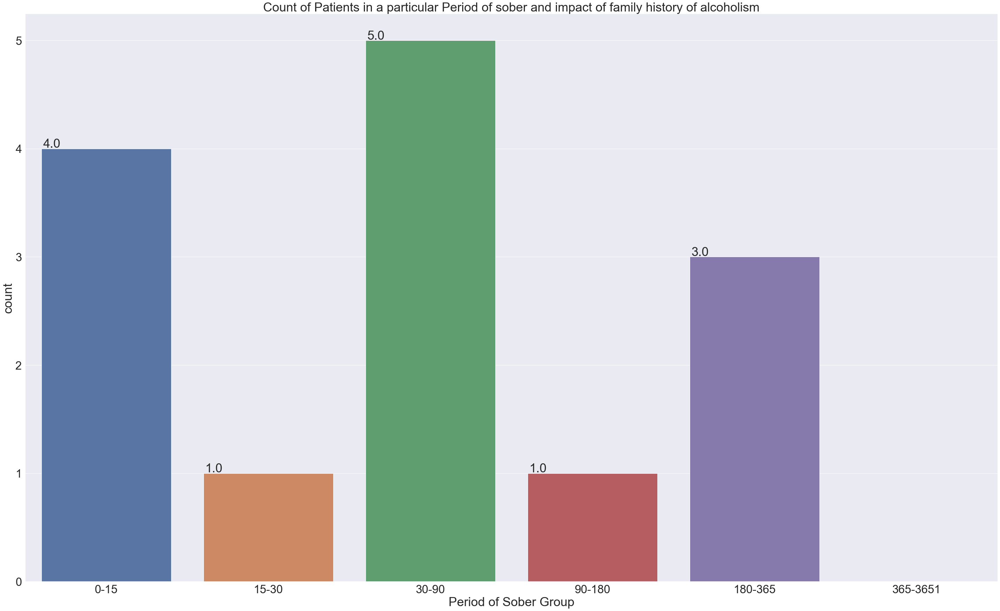

In [2168]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_data2,x = 'Period of Sober Group')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober and impact of family history of alcoholism')

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober and impact of family history of alcoholism')]

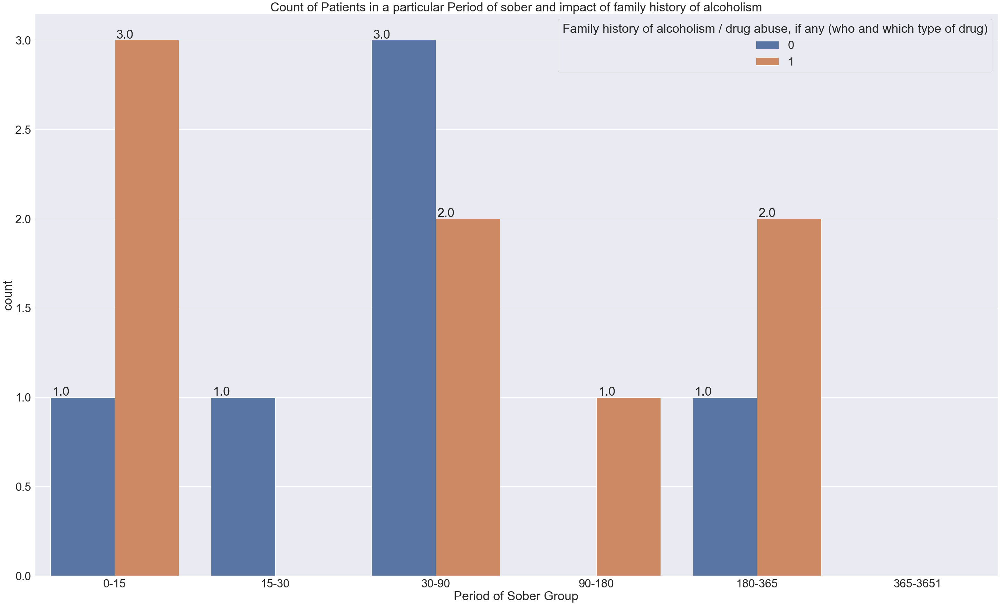

In [2169]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_data2,x = 'Period of Sober Group',hue = 'Family history of alcoholism / drug abuse, if any (who and which type of drug)')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober and impact of family history of alcoholism')

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober and their marital status')]

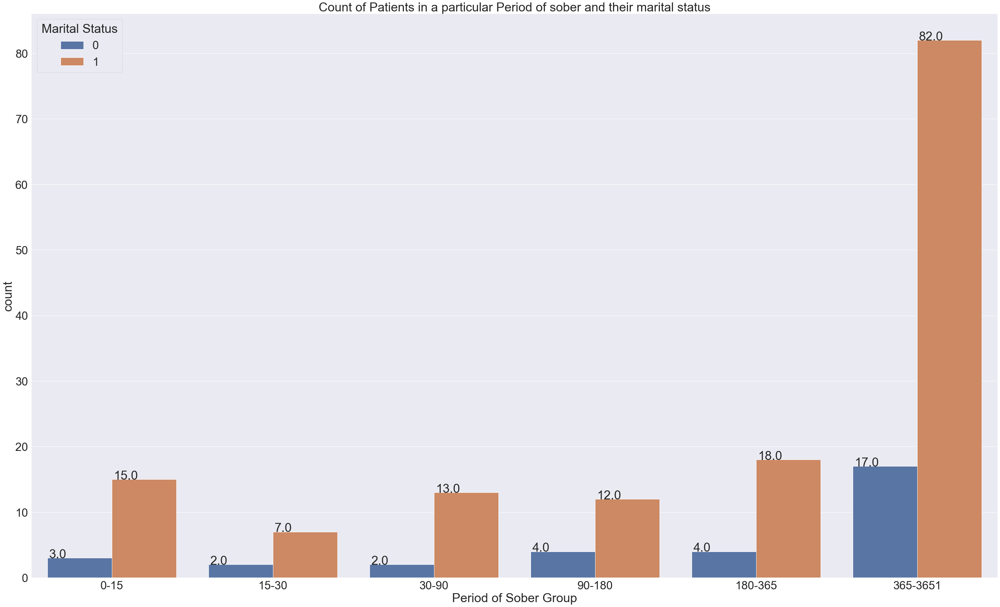

In [2170]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_data,x = 'Period of Sober Group',hue = 'Marital Status')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober and their marital status')

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober and their marital status')]

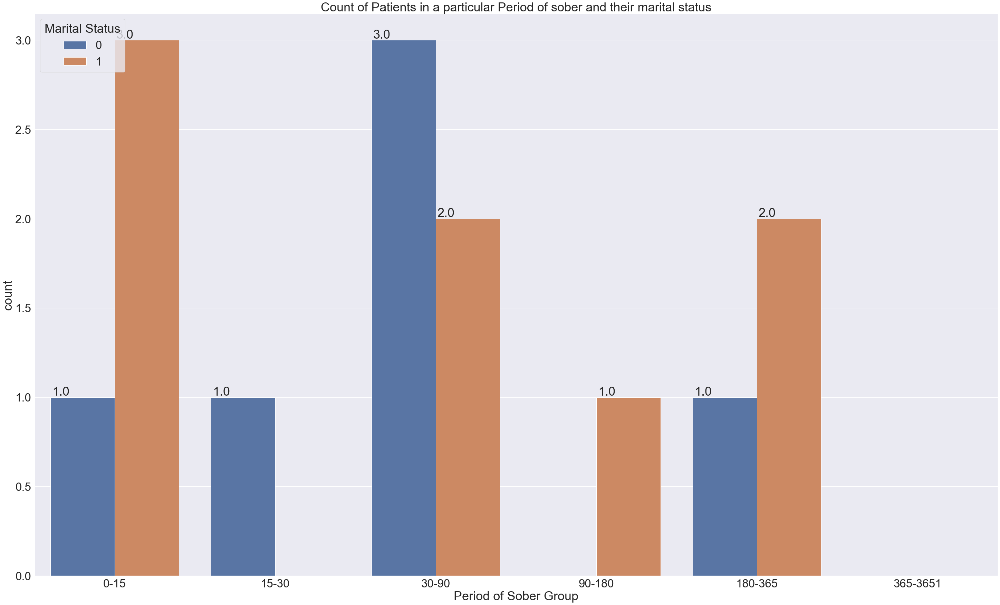

In [2171]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_data2,x = 'Period of Sober Group',hue = 'Marital Status')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober and their marital status')

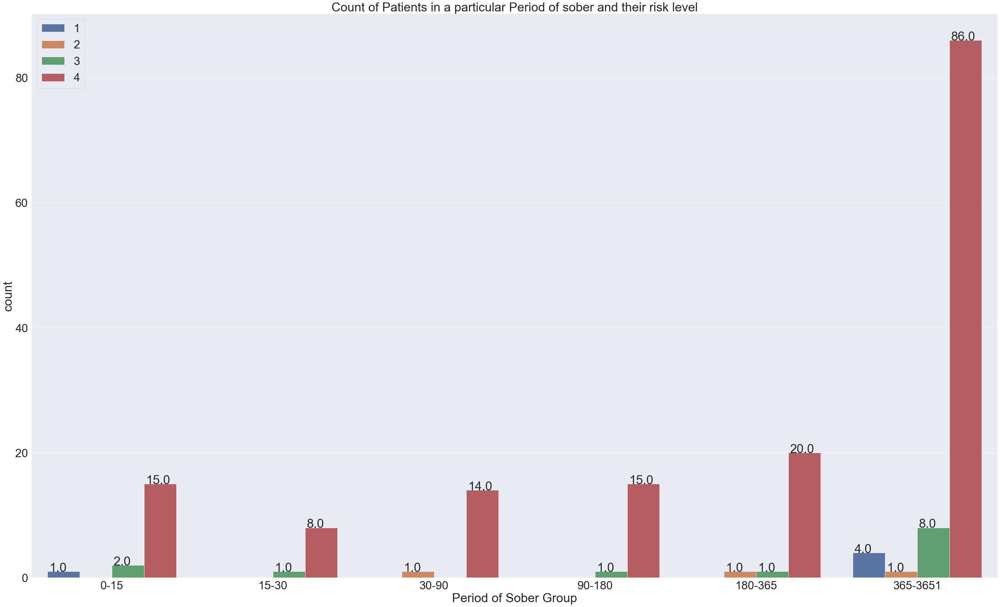

In [2172]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_data,x = 'Period of Sober Group',hue = 'Risk Level')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober and their risk level')
plt.legend(loc = 'upper left')
plt.show()

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober and their risk level')]

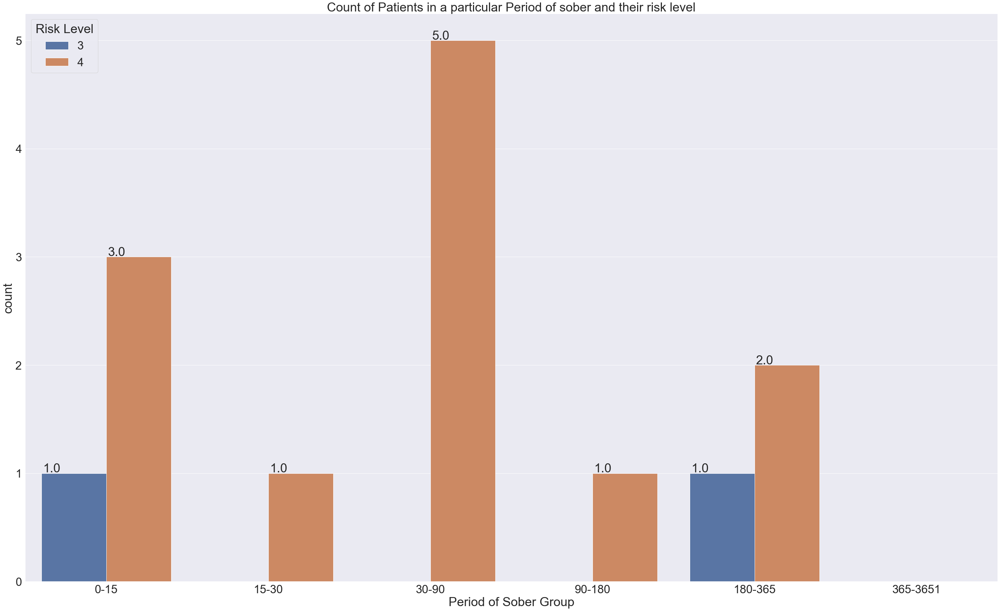

In [2173]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_data2,x = 'Period of Sober Group',hue = 'Risk Level')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober and their risk level')

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober and their religious beliefs')]

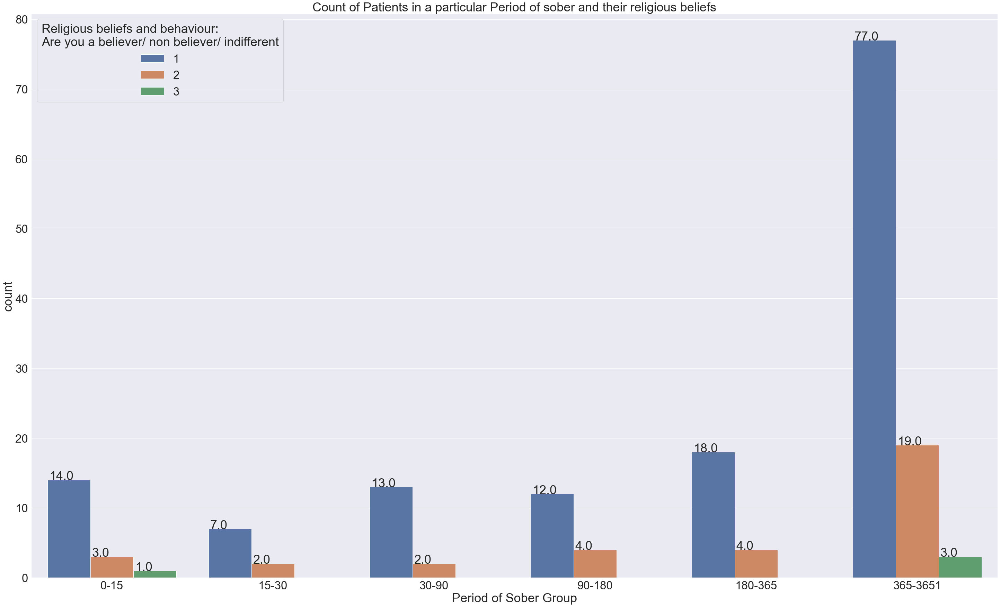

In [2174]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_data,x = 'Period of Sober Group',hue = 'Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober and their religious beliefs')

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober and their religious beliefs')]

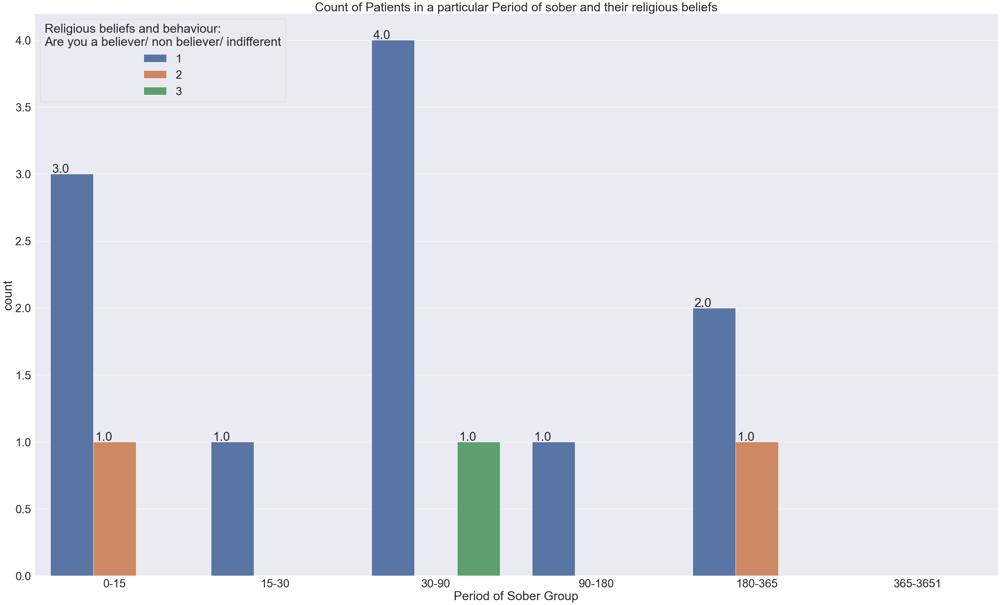

In [2175]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_data2,x = 'Period of Sober Group',hue = 'Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober and their religious beliefs')

In [2176]:
critical_15 = critical_data[critical_data['Period of Sober Group'] == '0-15']
# critical_30 = crtical_data[critical_data['Period of Sober Group'] == '15-30']
# critical_90 = critical_data[critical_data['Period of Sober Group'] == '30-90']
# critical_90 = critical_data[critical_data['Period of Sober Group'] == '30-90']
# critical_90 = critical_data[critical_data['Period of Sober Group'] == '30-90']

In [2177]:
critical_15 = critical_data[critical_data['Period of Sober Group'] == '0-15']
critical_15 = critical_15.drop('Period of Sober Group',axis = 1)

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober and their religious beliefs')]

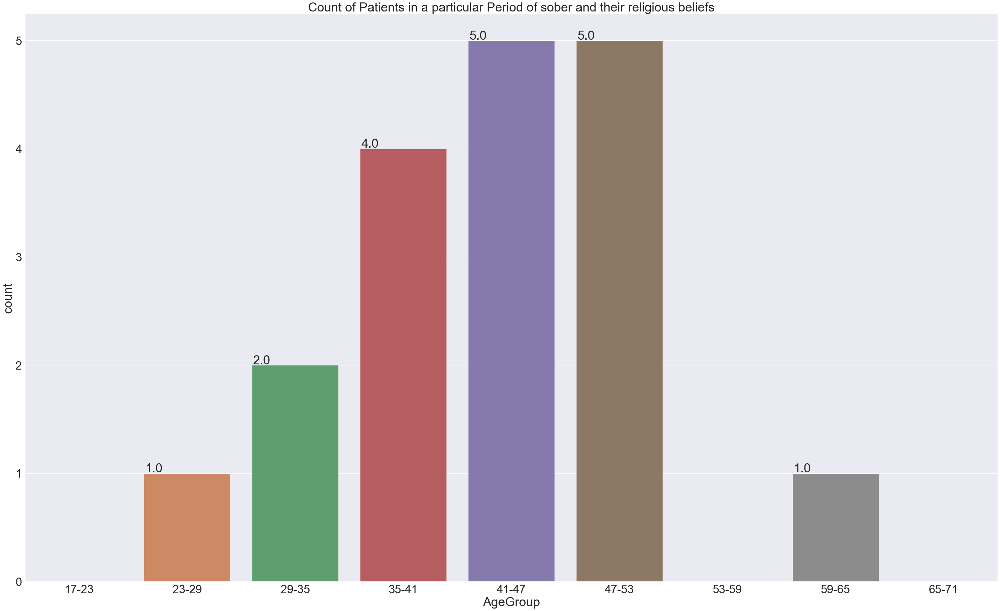

In [2178]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_15,x = 'AgeGroup')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober and their religious beliefs')

[Text(0.5, 1.0, 'Withdrawal Stages of Patients in the 0-15 period of sober range')]

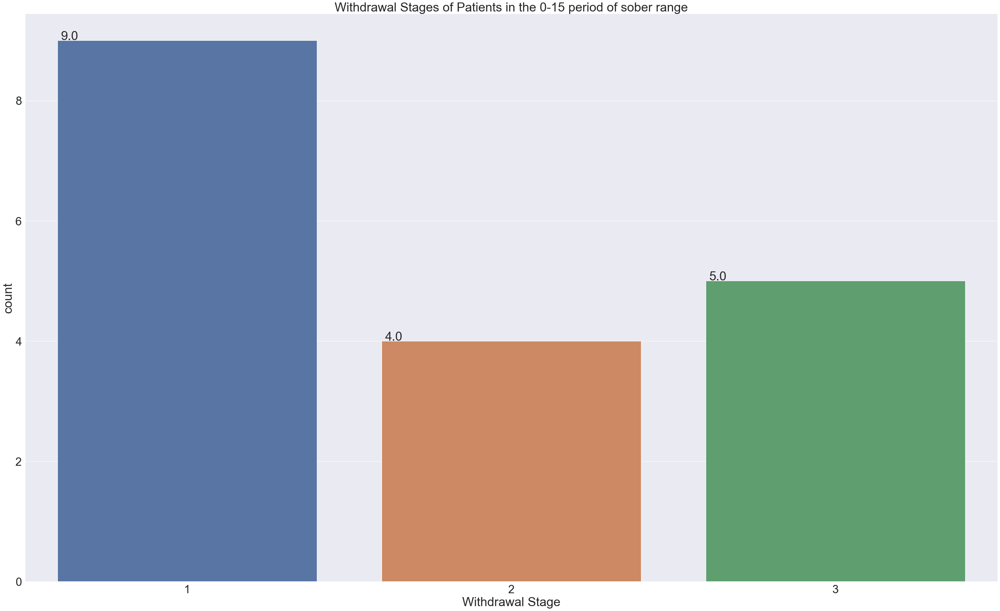

In [2179]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_15,x = 'Withdrawal Stage')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Withdrawal Stages of Patients in the 0-15 period of sober range')

[Text(0.5, 1.0, 'Risk Level of Patients in the 0-15 period of sober range')]

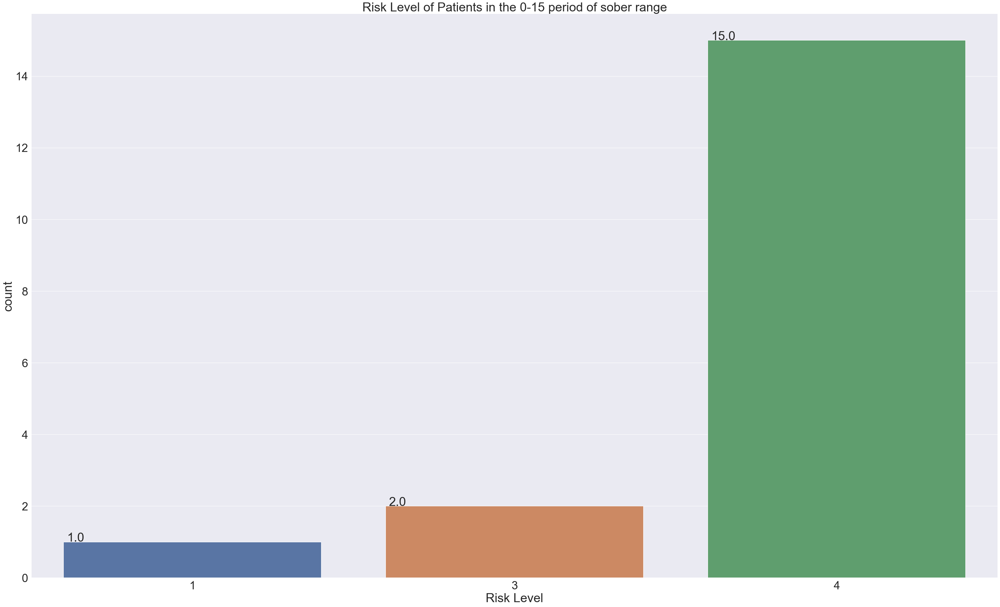

In [2180]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = critical_15,x = 'Risk Level')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Risk Level of Patients in the 0-15 period of sober range')

AttributeError: 'list' object has no attribute 'value_counts'

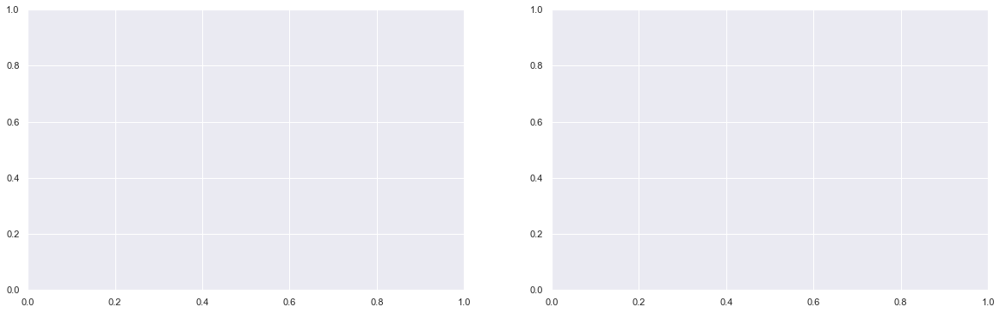

In [2181]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 1)
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(20,6))
mfact = ['Motivation factor'].value_counts()
mfact = mfact.tolist()
mylabels = ['Mild','Moderate','Severe']
ax1.pie(mfact,labels = mylabels,autopct='%1.1f%%', startangle=90)
ax1.set_title('Motivation Factor towards Substance use')
ax1.axis('equal')

KeyError: 'Motivation factor'

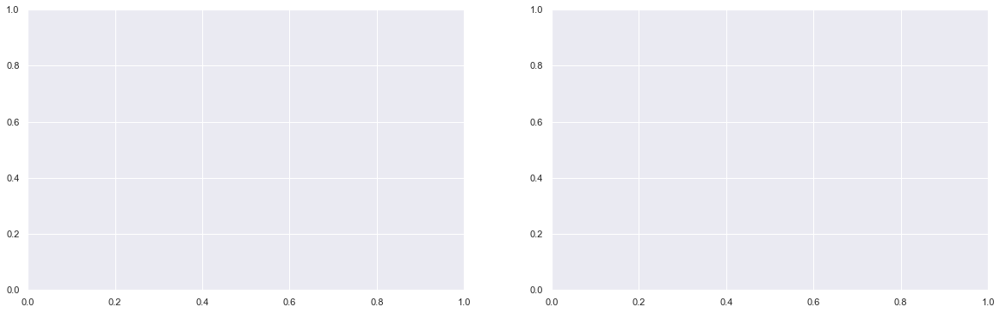

In [2182]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 1)
data = data_copy1[data_copy1['Period of Sober Group'] == '0-15']
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(20,6))
mfact = data['Motivation factor'].value_counts()
mfact = mfact.tolist()
mylabels = ['Mild','Moderate','Severe']
ax1.pie(mfact,labels = mylabels,autopct='%1.1f%%', startangle=90)
ax1.set_title('Motivation Factor towards Substance use')
ax1.axis('equal')
mfact = data['Family history of alcoholism / drug abuse, if any (who and which type of drug)'].value_counts()
mfact = mfact.tolist()
mylabels = ['No','Yes']
ax2.pie(mfact,labels = mylabels,autopct='%1.1f%%', startangle=90)
ax2.set_title('Family history of alcoholism')
ax2.axis('equal')
fig, (ax3,ax4) = plt.subplots(1,2,figsize=(20,6))
mfact = data['If any SpecV(Who and which type of drug'].value_counts()
mfact = mfact.tolist()
mylabels = ['No','Father','','','','']
def my_autopct(pct):
    return ('%.2f' % pct) if pct > 8 else ''
ax3.pie(mfact,labels = mylabels,autopct=my_autopct, startangle=90)
ax3.set_title('If any person introduced them to any type of drug')
ax3.axis('equal')
mreason = data['Reason for starting alcohol'].value_counts()
mreason = mreason.tolist()
mreason
mylabels = ['Someone in family or friends were using ','Someone in family or friends were using, To feel better and confident or happy','','','','','','']
def my_autopct(pct):
    return ('%.2f' % pct) if pct > 5 else ''
ax4.pie(mreason,labels = mylabels,autopct=my_autopct, startangle=90)
ax4.set_title('Reasons for starting Alcohol')
ax4.axis('equal')
plt.show()

Fitting 2 clusters
Fitting 4 clusters
Fitting 6 clusters
Fitting 8 clusters
Fitting 10 clusters
Fitting 12 clusters
Fitting 14 clusters
Fitting 16 clusters
Fitting 18 clusters
Fitting 20 clusters


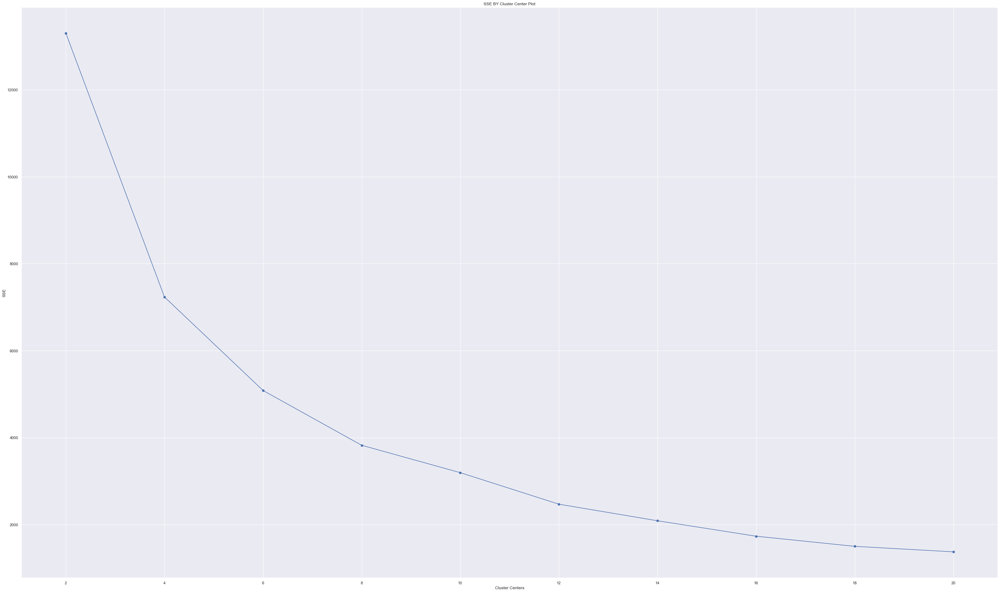

In [2183]:
from sklearn.cluster import MiniBatchKMeans
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

target = pd.concat([pd.DataFrame(data_copy1['Age']),pd.DataFrame(data_copy1['duration of use of alcohol']).astype('int64')],axis = 1)

def generate_optimal_clusters(data,max_k):
    iters = range(2,max_k+1,2)
    
    sse = []
    for k in iters:
        sse.append(MiniBatchKMeans(n_clusters = k, init_size = 1024, batch_size = 2048, random_state = 20).fit(data).inertia_)
        print('Fitting {} clusters'.format(k))
    f, ax = plt.subplots(1,1)
    ax.plot(iters,sse,marker = 'o')
    ax.set_xlabel('Cluster Centers')
    ax.set_xticks(iters)
    ax.set_xticklabels(iters)
    ax.set_ylabel('SSE')
    ax.set_title('SSE BY Cluster Center Plot')
    
generate_optimal_clusters(target,20)

# Optimal clusters is 4 by elbow theory

Text(0.5, 1.0, 'Generated TSNE Cluster Plot')

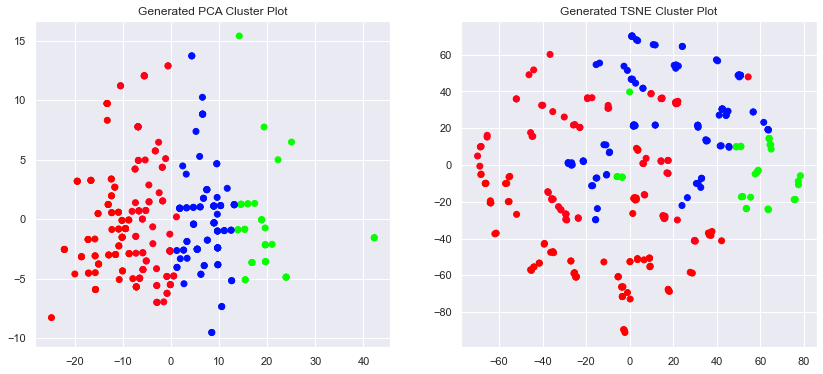

In [2184]:
clusters = MiniBatchKMeans(n_clusters = 4, init_size = 1024, batch_size = 2048, random_state = 20).fit_predict(target)

max_label = max(clusters)
max_items = np.random.choice(range(target.shape[0]),size = 3000, replace = True)
pca = PCA(n_components = 2).fit_transform(target.iloc[max_items,:])
tsne = TSNE().fit_transform(PCA(n_components = 2).fit_transform(target.iloc[max_items,:]))

idx = np.random.choice(range(pca.shape[0]),size = 300, replace = True)
label_subset = clusters[max_items]
label_subset = [cm.hsv(i/max_label) for i in label_subset[idx]]

f, ax = plt.subplots(1,2, figsize = (14,6))
ax[0].scatter(pca[idx,0],pca[idx,1],c = label_subset)
ax[0].set_title('Generated PCA Cluster Plot')
ax[1].scatter(tsne[idx,0],tsne[idx,1],c=label_subset)
ax[1].set_title('Generated TSNE Cluster Plot')

In [2185]:
df = data_copy1.groupby(clusters).mean()

In [2186]:
df

,S.N,Age,Annual Income,Marital Status,AAO for alcohol in year,duration of use of alcohol,duration of excessive use of alcohol,avarage units used in last 30days,quantity of last drink,Nicotine (yes/NO),smoking/smokeless,Weight while admission (In Kg),Weight while discharge (In Kg),Height(In Ft),Medical Problem experienced(Past ),Medical Problem experienced(Present),"History of previous head injureies, if any","Family history of alcoholism / drug abuse, if any (who and which type of drug)",Education Level,Period of Treatment1,abv_risk,RSA_someone in family or friends were using,RSA_to feel better and confident or happy,RSA_to avoid problems and sadness,RSA_heavy cold in his working place,RSA_other reasons,RSA_to try,RSA_other reason-accident,RSA_friends were using,RSA_happiness,RSA_friendship issues,RSA_work related stress,RSA_other,RSA_wife problem,RSA_function,RSA_weak minded & weak personality,Stress_work related stress,Stress_family or relationship issues,Stress_financial stress,Stress_others,Stress_absent,Stress_reports stressed but doesn't know where or what,Stress_love problem,Stress_lonelyness,Stress_gave confidence,Stress_felt relaxed and reduced physical exertion,Stress_mental pressure,DSP_Mild,DSP_Moderate,DSP_Severe,MF_Ambivalent,MF_Mild,MF_Moderate,MF_Severe,Aches and pains,Anxiety,Auditory hallucinations or illusions,Fits,Insomnia,Nausea,Palpitation,Restlessness,Sweating,Transient visual or tactile,Tremors,Weakness,No,Withdrawal Stage,CHP_pancreatitis problem,CHP_no,CHP_diabetes,CHP_liver disorder,CHP_respiratory problem,CHP_chronic bronchitis,CHP_bronchial asthma,CHP_infections,CHP_epilepsy,CHP_b.p,CHP_dust allergy,CHP_aggressive outbursts,CHP_gastric,CHP_skin problems,CHP_pulmonary t.b,PCP_seizure during withdrawal,PCP_confusion,PCP_no,PCP_depression,PCP_aggressive outbursts,PCP_hallucinations,PCP_paranoid ideas,PCP_suicidal ideation or attempts,PCP_yes,PCP_tension,PCPR_seizure during withdrawal,PCPR_confusion,PCPR_no,PCPR_depression,PCPR_aggressive outbursts,PCPR_hallucinations,PCPR_paranoid ideas,PCPR_suicidal ideation or attempts,PCPR_tension,Number of relapses (based on treatment year),Year of Treatment (First time),Year of Treatment (Second time),Year of Treatment (Third time),Number of relapses (based on period of treatment),Period of Treatment2,Period of Treatment3,Number of relapses (based on period of sober),Period of Sober1,Period of Sober2,Period of Sober3,Sugar(mg),Critical Period of Sober,Number of year of marriage,any instance of family violence,At what age did you start working?,How long have you been working?,Occupational damage,year of Education,Maximum period of abstinence and possible factors for abstinence,Early Parental loss,Single Parenting,Violence,No1,Poverty or severe debts,Nobody alcoholic in his family,Extra marital affairs of parents,Normal,Father is alcoholic,BCA_none,BCA_running away from home,BCA_alcohol,BCA_destruction of others property,BCA_scholastic backwardness,BCA_breaking articles at home,BCA_frequently physical fights and violence,BCA_gambling,BCA_broken home or single parenting,BCA_experimenting with drugs,BCA_poverty or severe debts,BCA_stealing
0,93.120000,30.260,88200.000000,0.480000,21.480000,7.428000,3.853333,627.400000,343.600000,0.680000,0.660000,61.900000,63.700000,5.666800,0.580000,0.240000,0.140000,0.380000,3.360000,19.260000,186.415452,0.840000,0.120000,0.020000,0.000000,0.000000,0.000000,0.02,0.960000,0.000000,0.02,0.000000,0.020000,0.020000,0.000000,0.000000,0.060000,0.280000,0.200000,0.040000,0.460000,0.060000,0.02,0.000000,0.02,0.02,0.000000,0.500000,0.420000,0.080000,0.000000,0.480000,0.360000,0.160000,0.080000,0.180000,0.120000,0.040000,0.480000,0.120000,0.040000,0.200000,0.300000,0.040000,0.560000,0.000000,0.200000,1.680000,0.000000,0.860000,0.000000,0.040000,0.000000,0.060000,0.000000,0.020000,0.000000,0.000000,0.000000,0.02,0.000000,0.02,0.020000,0.020000,0.100000,0.660000,0.140000,0.200000,0.020000,0.040000,0.100000,0.000000,0.000000,0.020000,0.080000,0

In [2187]:
data = data_copy1.select_dtypes(include='number')

In [2188]:
data

,S.N,Age,Annual Income,Marital Status,AAO for alcohol in year,duration of use of alcohol,duration of excessive use of alcohol,avarage units used in last 30days,quantity of last drink,Nicotine (yes/NO),smoking/smokeless,Weight while admission (In Kg),Weight while discharge (In Kg),Height(In Ft),Medical Problem experienced(Past ),Medical Problem experienced(Present),"History of previous head injureies, if any","Family history of alcoholism / drug abuse, if any (who and which type of drug)",Education Level,Period of Treatment1,abv_risk,RSA_someone in family or friends were using,RSA_to feel better and confident or happy,RSA_to avoid problems and sadness,RSA_heavy cold in his working place,RSA_other reasons,RSA_to try,RSA_other reason-accident,RSA_friends were using,RSA_happiness,RSA_friendship issues,RSA_work related stress,RSA_other,RSA_wife problem,RSA_function,RSA_weak minded & weak personality,Stress_work related stress,Stress_family or relationship issues,Stress_financial stress,Stress_others,Stress_absent,Stress_reports stressed but doesn't know where or what,Stress_love problem,Stress_lonelyness,Stress_gave confidence,Stress_felt relaxed and reduced physical exertion,Stress_mental pressure,DSP_Mild,DSP_Moderate,DSP_Severe,MF_Ambivalent,MF_Mild,MF_Moderate,MF_Severe,Aches and pains,Anxiety,Auditory hallucinations or illusions,Fits,Insomnia,Nausea,Palpitation,Restlessness,Sweating,Transient visual or tactile,Tremors,Weakness,No,Withdrawal Stage,CHP_pancreatitis problem,CHP_no,CHP_diabetes,CHP_liver disorder,CHP_respiratory problem,CHP_chronic bronchitis,CHP_bronchial asthma,CHP_infections,CHP_epilepsy,CHP_b.p,CHP_dust allergy,CHP_aggressive outbursts,CHP_gastric,CHP_skin problems,CHP_pulmonary t.b,PCP_seizure during withdrawal,PCP_confusion,PCP_no,PCP_depression,PCP_aggressive outbursts,PCP_hallucinations,PCP_paranoid ideas,PCP_suicidal ideation or attempts,PCP_yes,PCP_tension,PCPR_seizure during withdrawal,PCPR_confusion,PCPR_no,PCPR_depression,PCPR_aggressive outbursts,PCPR_hallucinations,PCPR_paranoid ideas,PCPR_suicidal ideation or attempts,PCPR_tension,Number of relapses (based on treatment year),Year of Treatment (First time),Year of Treatment (Second time),Year of Treatment (Third time),Number of relapses (based on period of treatment),Period of Treatment2,Period of Treatment3,Number of relapses (based on period of sober),Period of Sober1,Period of Sober2,Period of Sober3,Sugar(mg),Critical Period of Sober,Number of year of marriage,any instance of family violence,At what age did you start working?,How long have you been working?,Occupational damage,year of Education,Maximum period of abstinence and possible factors for abstinence,Early Parental loss,Single Parenting,Violence,No1,Poverty or severe debts,Nobody alcoholic in his family,Extra marital affairs of parents,Normal,Father is alcoholic,BCA_none,BCA_running away from home,BCA_alcohol,BCA_destruction of others property,BCA_scholastic backwardness,BCA_breaking articles at home,BCA_frequently physical fights and violence,BCA_gambling,BCA_broken home or single parenting,BCA_experimenting with drugs,BCA_poverty or severe debts,BCA_stealing
0,1,48,15000.0,1,30,17.0,0.166667,360,180,1,1,48,52.0,5.50,1,1,0,0,3,8,122.13720,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,1,0,0,3,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,2018,0,0,1,0,0,1,93,10000,10000,0,93,13,0,16,32.0,0,9,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
1,2,31,80000.0,1,16,15.0,3.000000,540,180,1,1,47,50.0,5.30,1,0,0,0,3,4,183.20580,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,2020,0,0,1,0,0,1,32,10000,10000,0,32,6,0,15,16.0,0,9,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
2,3,34,60000.0,0,24,10.0,3.000000,540,180,1,1,45,47.0,5.60,1,1,0,0,4,8,183.20580,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,1,0

In [2190]:
#df.to_csv('temp.csv',index = False)
data['relapse_label'] = 0
for i in data.index:
    if (i % 2) == 0:
        data['relapse_label'][i] = 'Yes'
    else:
        data['relapse_label'][i] = 'No'

In [2191]:
data['relapse_label'].value_counts()

Yes    102
No     101
Name: relapse_label, dtype: int64

In [2192]:
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import train_test_split,cross_validate
from sklearn.preprocessing import MinMaxScaler,StandardScaler, LabelEncoder
from sklearn.metrics import accuracy_score,precision_score,recall_score,f1_score

#Encoding of labels
label_quality = LabelEncoder()
data['relapse_label'] = label_quality.fit_transform(data['relapse_label'])

#split the datest into 70% training and 30% test data
x_train,x_test,y_train,y_test = train_test_split(data, data['relapse_label'], test_size = 0.3, random_state = 42)

#Model Creation
models = [LogisticRegression(),
         KNeighborsClassifier(),
         DecisionTreeClassifier(),
         GaussianNB()]
model_names = ['LogisticRegression','KNearestNeighbors','DecisionTree','GaussianNB']

#create model and evaluate accuracy
acc=[]
eval_acc={}

for model in range(len(models)):
    classification_model = models[model]
    classification_model.fit(x_train,y_train)
    pred = classification_model.predict(x_test)
    acc.append(accuracy_score(pred,y_test))
eval_acc = {'Modelling Algorithm':model_names,'Accuracy':acc}
eval_acc

{'Modelling Algorithm': ['LogisticRegression',
  'KNearestNeighbors',
  'DecisionTree',
  'GaussianNB'],
 'Accuracy': [0.39344262295081966,
  0.4426229508196721,
  1.0,
  0.4918032786885246]}

In [2193]:
acc_table = pd.DataFrame(eval_acc)
acc_table = acc_table.sort_values(by='Accuracy', ascending=[False])
acc_table

,Modelling Algorithm,Accuracy
2,DecisionTree,1.000000
3,GaussianNB,0.491803
1,KNearestNeighbors,0.442623
0,LogisticRegression,0.393443


<AxesSubplot:xlabel='Accuracy', ylabel='Modelling Algorithm'>

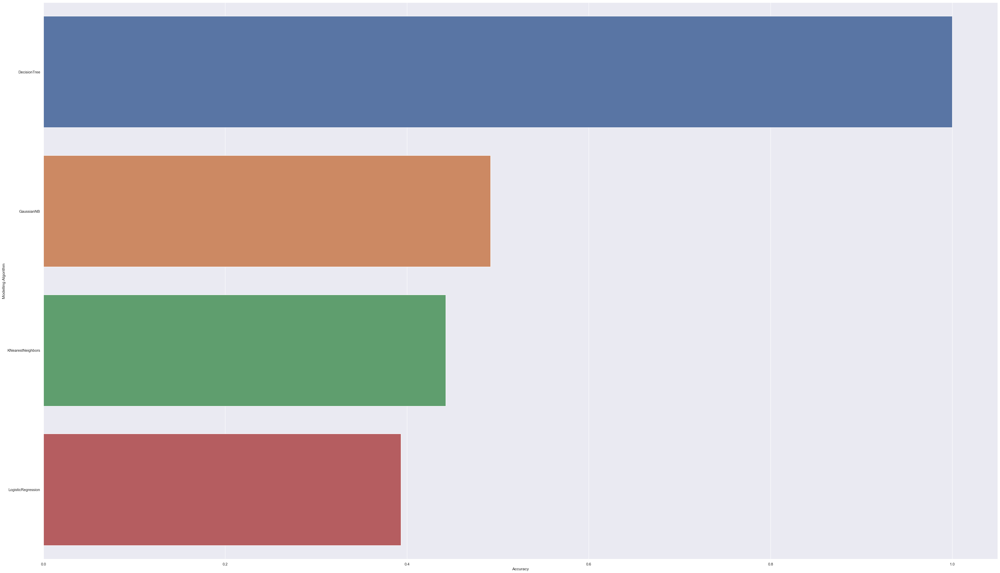

In [2194]:
sns.barplot(y = 'Modelling Algorithm',x = 'Accuracy',data = acc_table)

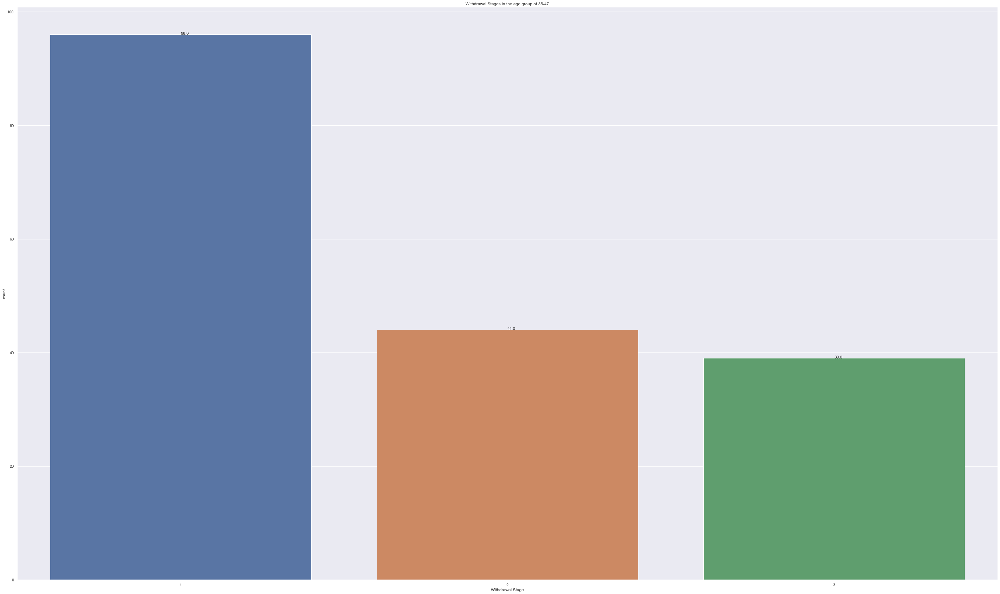

In [2195]:
ax2 = sns.countplot(data = critical_data,x = 'Withdrawal Stage')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.4, p.get_height()+0.01))
ax2.set(title = 'Withdrawal Stages in the age group of 35-47')
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 5)

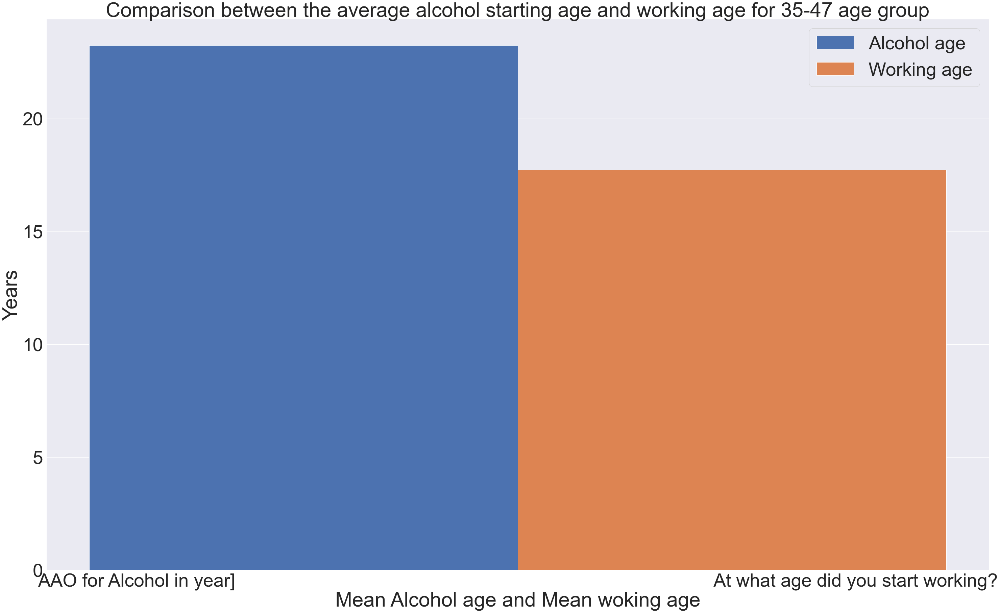

In [2196]:
X = ['AAO for Alcohol in year]                                                                                             At what age did you start working?']
Y_alc = critical_data['AAO for alcohol in year'].mean()
Y_work = critical_data['At what age did you start working?'].mean()

X_axis = np.arange(len(X))
plt.bar(X_axis - 0.2, Y_alc, 0.4, label = 'Alcohol age')
plt.bar(X_axis + 0.2, Y_work, 0.4, label = 'Working age')

plt.xticks(X_axis, X)
plt.xlabel("Mean Alcohol age and Mean woking age")
plt.ylabel("Years")
plt.title("Comparison between the average alcohol starting age and working age for 35-47 age group")
plt.legend()
plt.show()
sns.set(rc = {'figure.figsize':(20,8)})

In [2197]:
Y_alc = critical_data['AAO for alcohol in year'].mean()
Y_work = critical_data['At what age did you start working?'].mean()
print(Y_alc,Y_work)

23.24581005586592 17.71508379888268


In [2198]:
data_copy1['AAO for alcohol in year'] = data_copy1['AAO for alcohol in year'].astype('int64')

In [2199]:
data_copy6.columns

Index(['Number of year of marriage', 'any instance of family violence',
       'At what age did you start working?', 'How long have you been working?',
       'Occupational damage', 'year of Education',
       'Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent',
       'Maximum period of abstinence and possible factors for abstinence',
       'Early Parental loss', 'Single Parenting', 'Violence', 'No1',
       'Poverty or severe debts', 'Nobody alcoholic in his family',
       'Extra marital affairs of parents', 'Normal', 'Father is alcoholic',
       'BCA_none', 'BCA_running away from home', 'BCA_alcohol',
       'BCA_destruction of others property', 'BCA_scholastic backwardness',
       'BCA_breaking articles at home',
       'BCA_frequently physical fights and violence', 'BCA_gambling',
       'BCA_broken home or single parenting', 'BCA_experimenting with drugs',
       'BCA_poverty or severe debts', 'BCA_stealing'],
      dtype='object')

In [2200]:
data = data_copy1.select_dtypes(include='number')
# data.columns

In [2201]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
X = data.iloc[:,1:]  #independent columns   
y = data_copy1["Period of Sober Group"]   #target column

#apply SelectKBest class to extract top 10 best features
bestfeatures = SelectKBest(score_func=chi2, k=20)
fit = bestfeatures.fit(X,y)
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)
#concat two dataframes for better visualization 
featureScores = pd.concat([dfcolumns,dfscores],axis=1)
featureScores.columns = ['Specs','Score']  #naming the dataframe columns
print(featureScores.nlargest(30,'Score'))

                                 Specs         Score
1                        Annual Income  1.012235e+06
113           Critical Period of Sober  1.213769e+05
109                   Period of Sober1  1.117695e+05
103    Year of Treatment (Second time)  3.166320e+04
110                   Period of Sober2  1.401008e+04
18                Period of Treatment1  1.110149e+04
104     Year of Treatment (Third time)  1.079972e+04
7               quantity of last drink  9.614056e+02
6    avarage units used in last 30days  8.557794e+02
106               Period of Treatment2  7.467051e+02
111                   Period of Sober3  2.641709e+02
19                            abv_risk  1.364678e+02
102     Year of Treatment (First time)  8.282850e+01
107               Period of Treatment3  3.740625e+01
11      Weight while discharge (In Kg)  2.525449e+01
10      Weight while admission (In Kg)  2.308501e+01
119                  year of Education  2.021589e+01
117    How long have you been working?  2.0156

In [2202]:
feature = featureScores.nlargest(30,'Score')
feature.to_excel('feature1.xlsx')

[1.20070541e-02 1.20525940e-02 5.00603914e-03 1.12870581e-02
 1.20085157e-02 1.22594837e-02 9.70882622e-03 1.13255790e-02
 7.82077341e-03 8.54118735e-03 1.50933942e-02 1.43660354e-02
 1.20832827e-02 9.57066339e-03 6.24607008e-03 4.82225555e-03
 8.98712656e-03 1.24664824e-02 1.51211809e-02 1.02423956e-02
 7.05389453e-03 7.83633946e-03 5.56694128e-03 1.33935842e-03
 1.05108733e-04 2.07431326e-03 0.00000000e+00 5.44376379e-03
 1.21003744e-03 6.73748765e-04 7.39654048e-05 7.44823512e-04
 1.22416568e-03 2.74159878e-03 0.00000000e+00 6.99178426e-03
 9.09303732e-03 7.50503440e-03 3.26713931e-03 6.32262721e-03
 2.97549998e-03 7.84506503e-04 0.00000000e+00 1.94645802e-06
 0.00000000e+00 2.82955499e-03 7.89625053e-03 9.25526920e-03
 4.64684730e-03 0.00000000e+00 9.49620965e-03 1.17390236e-02
 7.61762230e-03 3.65956983e-03 8.99025661e-03 5.78063697e-03
 2.16889884e-03 6.88720327e-03 4.71759701e-03 3.75444345e-03
 6.98399482e-03 6.45800625e-03 4.93597759e-03 1.02685885e-02
 1.40144978e-05 4.162306

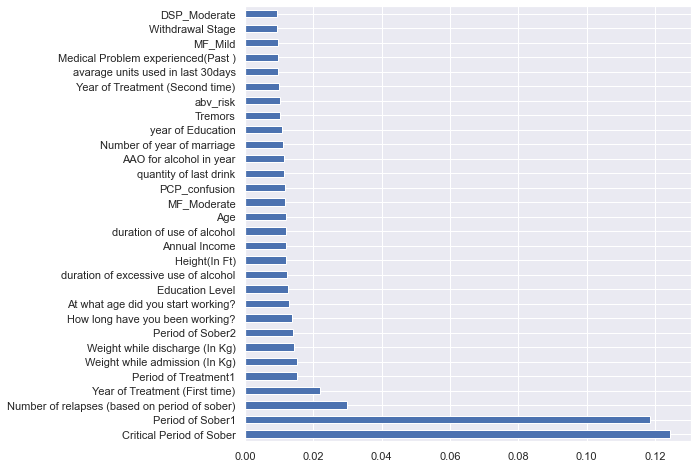

In [2203]:
X = data.iloc[:,1:]  #independent columns   
y = data_copy1["Period of Sober Group"]   #target column
from sklearn.ensemble import ExtraTreesClassifier
import matplotlib.pyplot as plt
model = ExtraTreesClassifier()
model.fit(X,y)
print(model.feature_importances_) #use inbuilt class feature_importances of tree based classifiers
#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
plt.figure(figsize = (8,8))
feat_importances.nlargest(30).plot(kind='barh')
plt.show()

In [2204]:
cols = list(data.columns)

x= data[cols]
data_copy1['Numeric Sober Group'] = 0
for i in data_copy1.index:
    if data_copy1['Period of Sober Group'][i] == '0-15':
        data_copy1['Numeric Sober Group'][i] = 0
    elif data_copy1['Period of Sober Group'][i] == '15-30':
        data_copy1['Numeric Sober Group'][i] = 1
    elif data_copy1['Period of Sober Group'][i] == '30-90':
        data_copy1['Numeric Sober Group'][i] = 2
    elif data_copy1['Period of Sober Group'][i] == '90-180':
        data_copy1['Numeric Sober Group'][i] = 3
    elif data_copy1['Period of Sober Group'][i] == '180-365':
        data_copy1['Numeric Sober Group'][i] = 4
    else:
        data_copy1['Numeric Sober Group'][i] = 5
data_copy1['Numeric Sober Group'].value_counts()
y = data_copy1['Numeric Sober Group']

In [2205]:
from sklearn.model_selection import train_test_split  
x_train, x_test, y_train, y_test= train_test_split(x, y, test_size= 1/3, random_state=0)  

In [2206]:
#RECURSIVE FEATURE ELIMINATION
#Feature ranking with recursive feature elimination and cross-validated selection of the best number of features

from sklearn.feature_selection import RFE
from sklearn.feature_selection import RFECV
from sklearn.linear_model import LinearRegression 
X = x_train
y = y_train
names=pd.DataFrame(x_train.columns)

#use linear regression as the model
lin_reg = LinearRegression()

#This is to select 5 variables: can be changed and checked in model for accuracy
rfe_mod = RFE(lin_reg, step=1) #RFECV(lin_reg, step=1, cv=5) 
myvalues=rfe_mod.fit(X,y) #to fit
myvalues.support_#The mask of selected features.
myvalues.ranking_ #The feature ranking, such that ranking_[i] corresponds to the ranking position of the i-th feature. Selected (i.e., estimated best) features are assigned rank 1.

rankings=pd.DataFrame(myvalues.ranking_) #Make it into data frame
rankings

,0
0,58
1,24
2,65
3,1
4,23
5,25
6,43
7,64
8,61
9,1


In [2207]:
#Concat and name columns
ranked=pd.concat([names,rankings], axis=1)
ranked.columns = ["Feature", "Rank"]
ranked

#Select most important (Only 1's)
most_important = ranked.loc[ranked['Rank'] <= 5]
print(most_important)

most_important['Rank'].count()

                                               Feature  Rank
3                                       Marital Status     1
9                                    Nicotine (yes/NO)     1
10                                   smoking/smokeless     1
17   Family history of alcoholism / drug abuse, if ...     1
22           RSA_to feel better and confident or happy     1
23                   RSA_to avoid problems and sadness     1
24                 RSA_heavy cold in his working place     1
25                                   RSA_other reasons     1
27                           RSA_other reason-accident     1
29                                       RSA_happiness     1
30                               RSA_friendship issues     1
31                             RSA_work related stress     1
32                                           RSA_other     1
36                          Stress_work related stress     1
37                Stress_family or relationship issues     1
39                      

75

In [2208]:
most_important['Rank'].count()

75

In [2209]:
rank = pd.DataFrame(most_important)
rank

,Feature,Rank
3,Marital Status,1
9,Nicotine (yes/NO),1
10,smoking/smokeless,1
17,"Family history of alcoholism / drug abuse, if ...",1
22,RSA_to feel better and confident or happy,1
23,RSA_to avoid problems and sadness,1
24,RSA_heavy cold in his working place,1
25,RSA_other reasons,1
27,RSA_other reason-accident,1
29,RSA_happiness,1


In [2210]:
rank.to_excel('rank.xlsx')

In [2211]:
# #Forward selection 
# import statsmodels.api as sm 
# def forward_selection(x, y, significance_level=0.05): 
#     initial_features = data.columns.tolist() 
#     best_features = [] 
#     while (len(initial_features)>0): 
#         remaining_features = list(set(initial_features)-set(best_features)) 
#         new_pval = pd.Series(index=remaining_features) 
#         for new_column in remaining_features: 
#             model = sm.OLS(y, sm.add_constant(df[best_features+[new_column]])).fit() 
#             new_pval[new_column] = model.pvalues[new_column] 
#         min_p_value = new_pval.min() 
#         if(min_p_value<significance_level): 
#             best_features.append(new_pval.idxmin()) 
#         else: 
#             break 
#     return best_features
# forward_selection(x,y)

In [1]:
bins= [365,3651]
label = ['365-3651']
data_copy1['Period of Sober Group(365-3651)'] = pd.cut(data_copy1['Critical Period of Sober'], bins=bins, labels=label, right=False)

NameError: name 'pd' is not defined

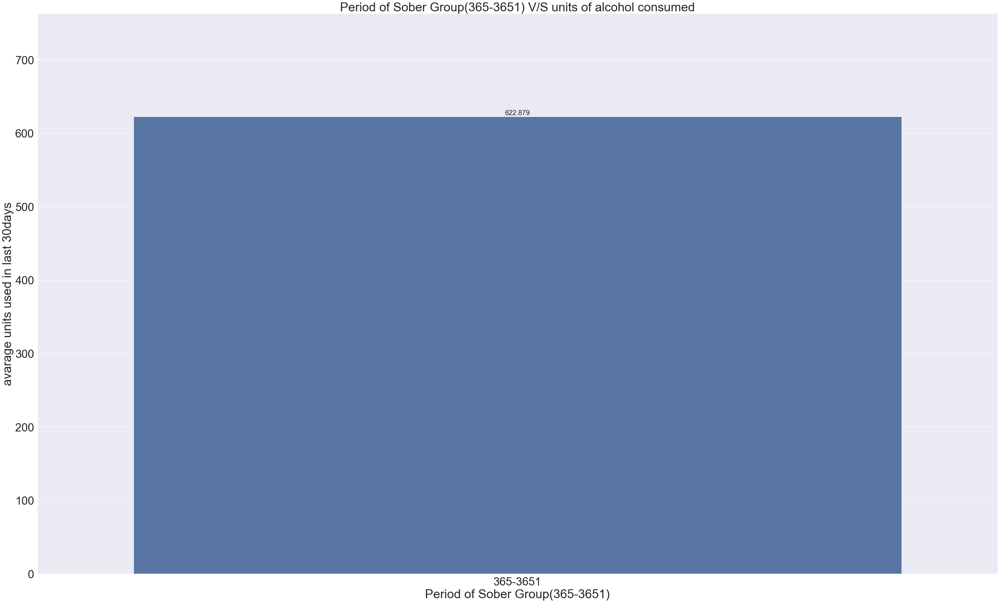

In [2245]:
ax = sns.barplot(x ='Period of Sober Group(365-3651)',y = 'avarage units used in last 30days', errwidth=0,data = data_copy1)
ax.bar_label(ax.containers[0],size = 20)
ax.set(title = 'Period of Sober Group(365-3651) V/S units of alcohol consumed')
sns.set(rc = {'figure.figsize':(20,8)})

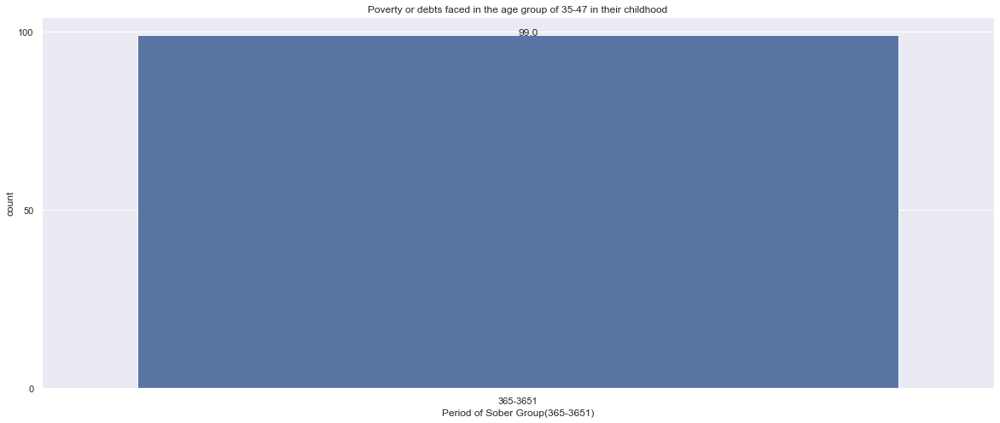

In [2246]:
ax2 = sns.countplot(data = data_copy1,x = 'Period of Sober Group(365-3651)')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.4, p.get_height()+0.01))
ax2.set(title = 'Poverty or debts faced in the age group of 35-47 in their childhood')
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 5)

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober group with their appropriate withdrawal stage')]

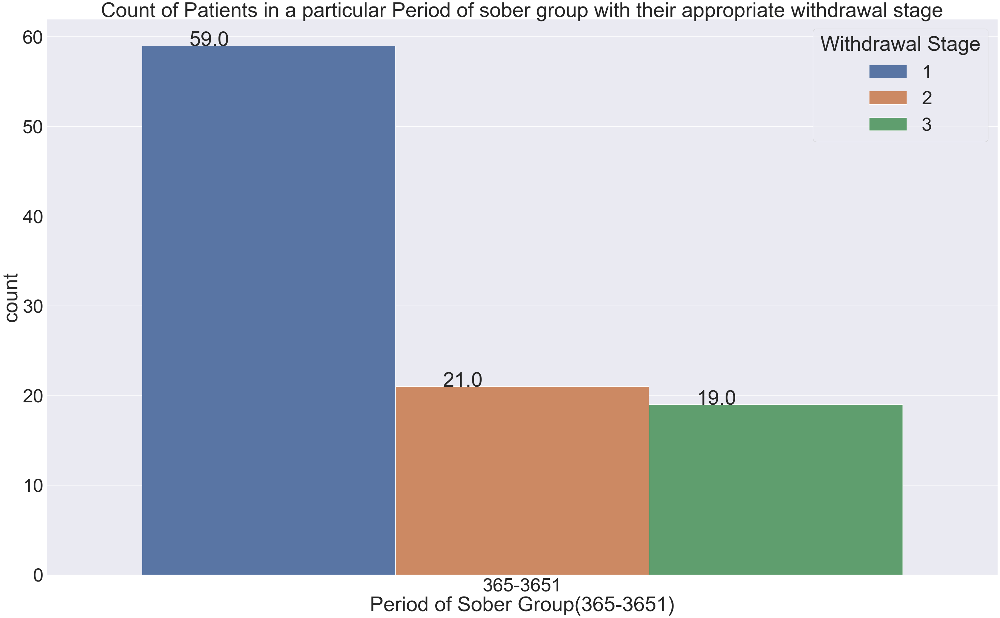

In [2247]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 5)
ax2 = sns.countplot(data = data_copy1,x = 'Period of Sober Group(365-3651)',hue = 'Withdrawal Stage')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober group with their appropriate withdrawal stage')

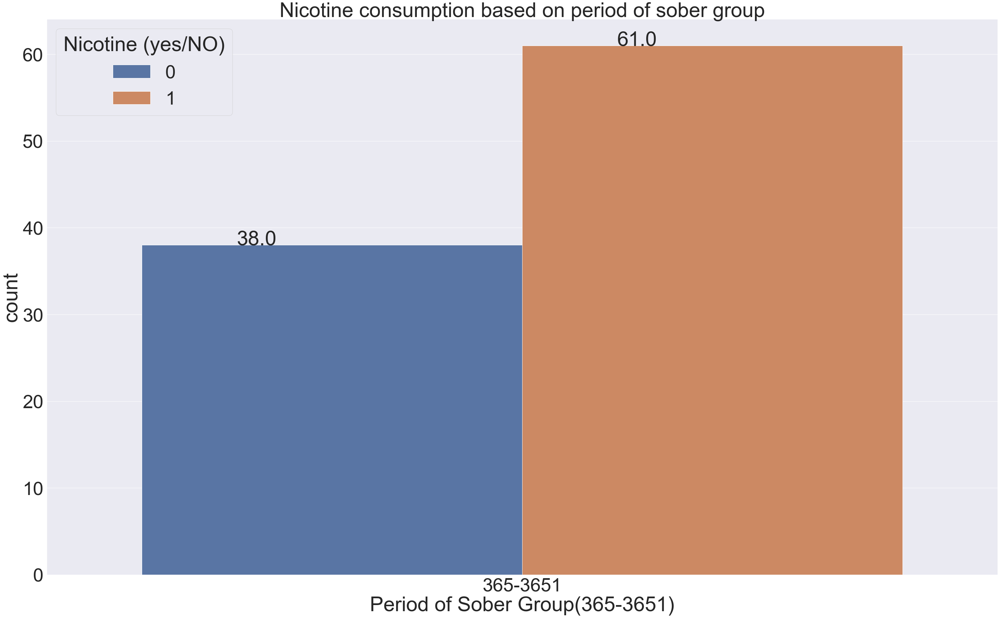

In [2248]:
ax2 = sns.countplot(data=data_copy1, x='Period of Sober Group(365-3651)', hue="Nicotine (yes/NO)")
ax2.set(title = 'Nicotine consumption based on period of sober group')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.1, p.get_height()+0.01))
sns.set(rc = {'figure.figsize':(20,8)})

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober who have experienced poverty and severe debts in their childhood')]

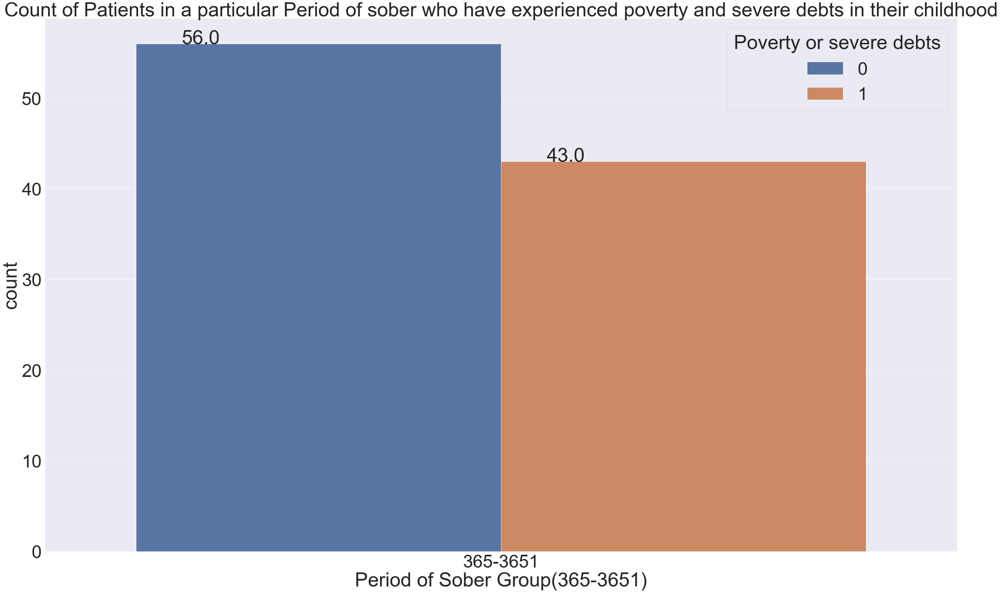

In [2249]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 5)
ax2 = sns.countplot(data = data_copy1,x = 'Period of Sober Group(365-3651)',hue = 'Poverty or severe debts')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober who have experienced poverty and severe debts in their childhood')

In [2250]:
data = data_copy1[data_copy1['Period of Sober Group(365-3651)'] == '365-3651']
data = data.select_dtypes(include='number')

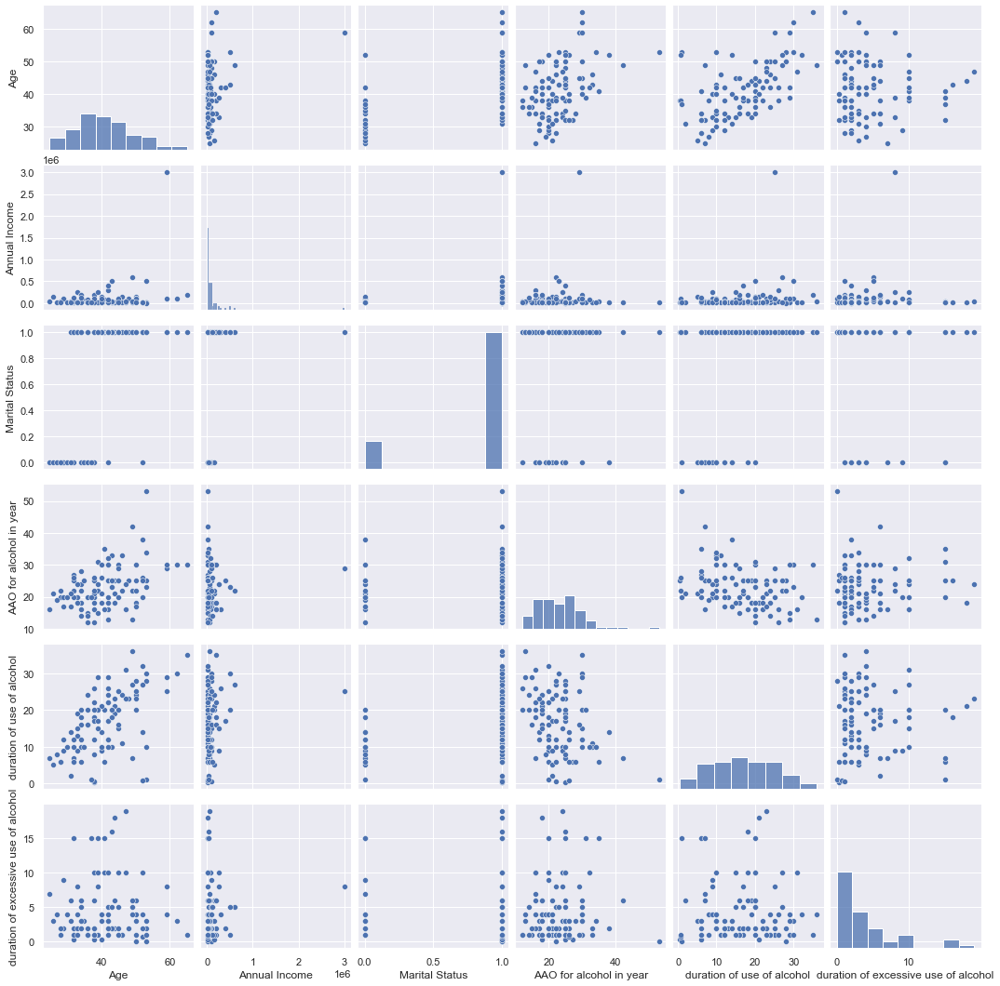

In [2251]:
sns.set(rc = {'figure.figsize':(20,8)},font_scale = 1)
sns.pairplot(data = data.iloc[:,1:7])

[Text(0.5, 1.0, 'Count of Patients in a particular Period of sober and their educational level')]

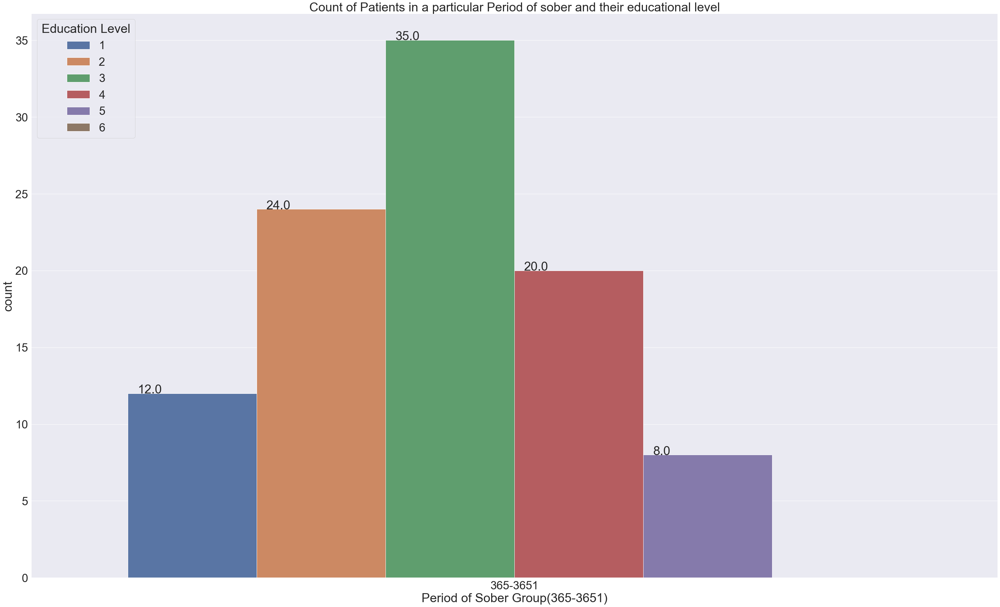

In [2252]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = data_copy1,x = 'Period of Sober Group(365-3651)',hue = 'Education Level')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in a particular Period of sober and their educational level')

[Text(0.5, 1.0, 'Count of Patients in Period of Sober Group(365-3651) and their marital status')]

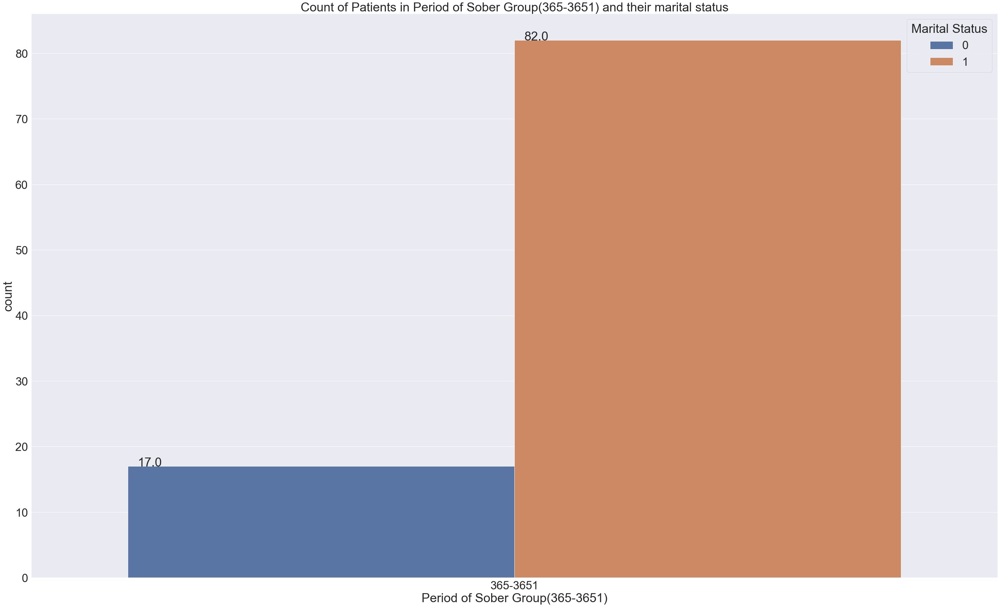

In [2254]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = data_copy1,x = 'Period of Sober Group(365-3651)',hue = 'Marital Status')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in Period of Sober Group(365-3651) and their marital status')

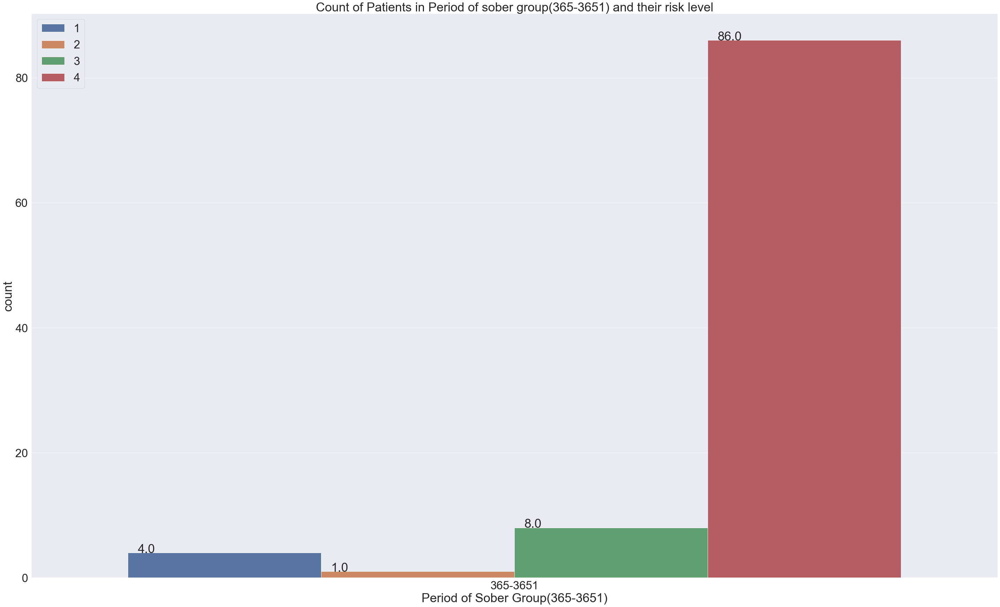

In [2256]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = data_copy1,x ='Period of Sober Group(365-3651)',hue = 'Risk Level')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in Period of sober group(365-3651) and their risk level')
plt.legend(loc = 'upper left')
plt.show()

[Text(0.5, 1.0, 'Count of Patients in Period of sober group(365-3651) and their religious beliefs')]

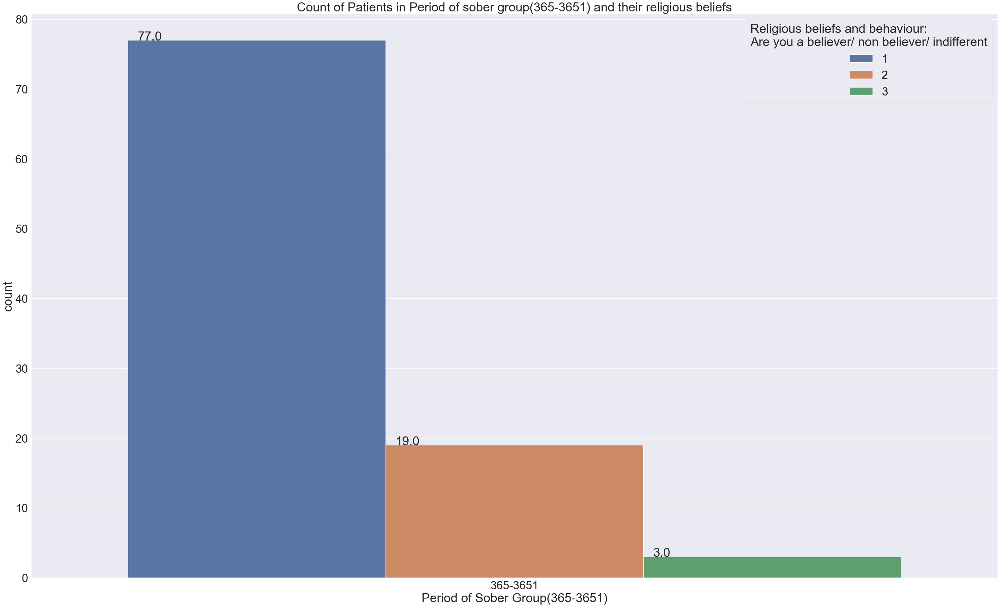

In [2259]:
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 3)
ax2 = sns.countplot(data = data_copy1,x = 'Period of Sober Group(365-3651)',hue = 'Religious beliefs and behaviour:\nAre you a believer/ non believer/ indifferent')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.01, p.get_height()+0.01))
ax2.set(title = 'Count of Patients in Period of sober group(365-3651) and their religious beliefs')

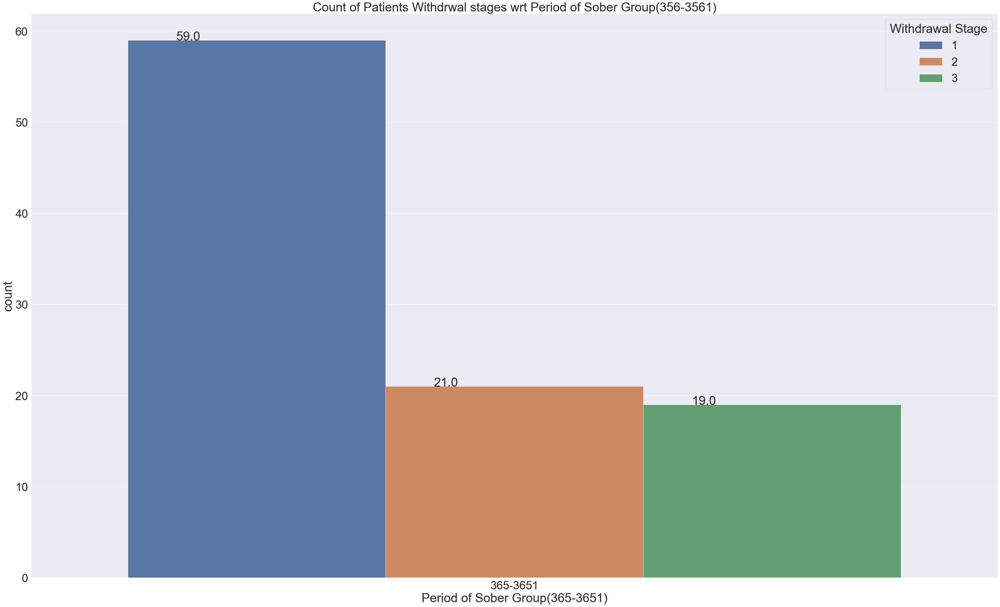

In [2262]:
ax2 = sns.countplot(data = data_copy1,x = 'Period of Sober Group(365-3651)', hue = 'Withdrawal Stage')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
ax2.set(title = 'Count of Patients Withdrwal stages wrt Period of Sober Group(356-3561)')
sns.set(rc = {'figure.figsize':(50,30)},font_scale = 5)

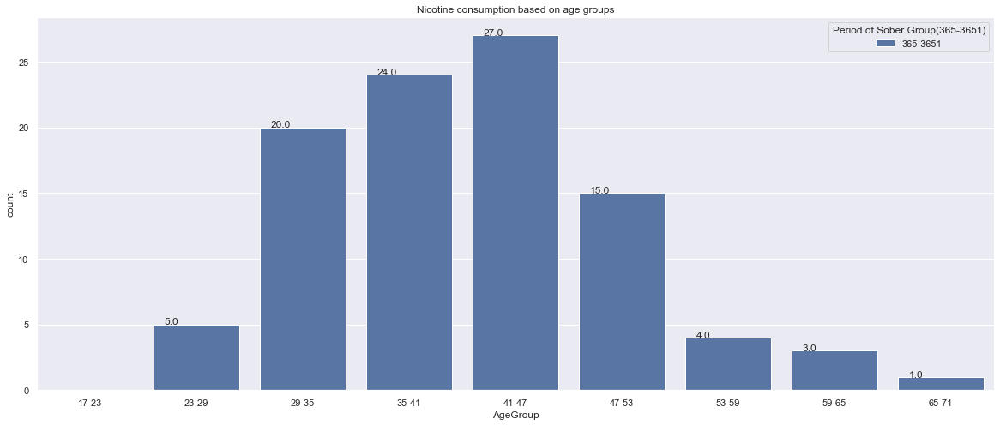

In [2263]:
sns.set(rc = {'figure.figsize':(20,8)})
ax2 = sns.countplot(data=data_copy1, x="AgeGroup", hue= 'Period of Sober Group(365-3651)')
ax2.set(title = 'Nicotine consumption based on age groups')
for p in ax2.patches:
   ax2.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.1, p.get_height()+0.01))

TypeError: The x variable is categorical, but one of ['numeric', 'datetime'] is required

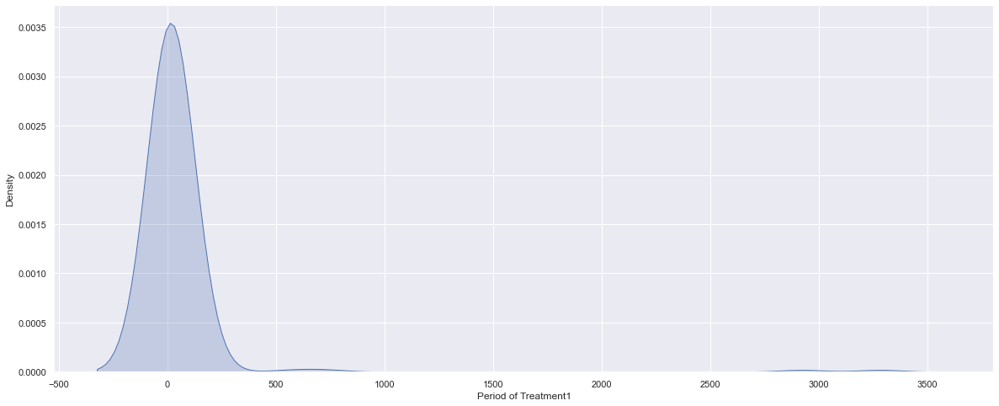

In [2265]:
sns.kdeplot(data = data_copy1,x = 'Period of Treatment1',fill = True)
sns.kdeplot(data = data_copy1,x = 'Period of Sober Group(365-3651)',fill = True)